**Goal**

- Predict the Greenhouse gaz emissions (in tons of carbon dioxyde equivalent) of buildings in Seattle.
- Evaluate the effect of adding the feature 'ENERGYSTARScore' in the inputs of the models.

In [1]:
import pandas as pd
pd.set_option("display.max_columns", 100)
pd.set_option("display.max_rows", 200)
pd.set_option("display.max_colwidth", None)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import data_science_functions as ds
import project_tools as pt

# import itertools

# from sklearn import set_config
# set_config(transform_output = "pandas")
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import QuantileTransformer
from sklearn.pipeline import Pipeline
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import HuberRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.compose import ColumnTransformer
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
from sklearn.metrics import r2_score
from sklearn.metrics import PredictionErrorDisplay

import xgboost as xgb

from math import sqrt
from math import log10
from math import floor

from joblib import dump
from joblib import load

from timeit import default_timer as timer


sns.set_style("ticks")

In [2]:
data = pd.read_csv("seattle.csv", index_col="OSEBuildingID")
display(data.head())
data.shape

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity,Age,ProportionPrincipalUseType,ProportionSecondaryUseType,ProportionThirdUseType,RiseType,AgeType,energies_sum,energy_ratio,SteamUseProportion,ElectricityProportion,NaturalGasProportion
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,7,DOWNTOWN,47.61220,-122.33799,1927,1,12,88434,0,88434,Hotel,Hotel,88434.0,NaN,NaN,NaN,NaN,NaN,60.0,81.699997,84.300003,182.500000,189.000000,7226362.5,7456910.0,2003882.00,3946027.0,1276453.0,Compliant,NaN,249.98,2.83,96,1.000000,NaN,NaN,Medium,Very_old,7226362.00,1.0,0.28,0.55,0.18
2,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,7,DOWNTOWN,47.61317,-122.33393,1996,1,11,103566,15064,88502,"Hotel, Parking, Restaurant",Hotel,83880.0,Parking,15064.0,Restaurant,4622.0,NaN,61.0,94.800003,97.900002,176.100006,179.399994,8387933.0,8664479.0,0.00,3242851.0,5145082.0,Compliant,NaN,295.86,2.86,27,0.809918,0.145453,0.044629,Medium,Modern,8387933.00,1.0,0.00,0.39,0.61
3,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,7,DOWNTOWN,47.61393,-122.33810,1969,1,41,956110,196718,759392,Hotel,Hotel,756493.0,NaN,NaN,NaN,NaN,NaN,43.0,96.000000,97.699997,241.899994,244.100006,72587024.0,73937112.0,21566554.00,49526664.0,1493800.0,Compliant,NaN,2089.28,2.19,54,0.791220,NaN,NaN,High,Old,72587018.00,1.0,0.30,0.68,0.02
5,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,7,DOWNTOWN,47.61412,-122.33664,1926,1,10,61320,0,61320,Hotel,Hotel,61320.0,NaN,NaN,NaN,NaN,NaN,56.0,110.800003,113.300003,216.199997,224.000000,6794584.0,6946800.5,2214446.25,2768924.0,1811213.0,Compliant,NaN,286.43,4.67,97,1.000000,NaN,NaN,Medium,Very_old,6794583.25,1.0,0.33,0.41,0.27
8,NonResidential,Hotel,WARWICK SEATTLE HOTEL (ID8),401 LENORA ST,Seattle,WA,98121.0,0659000970,7,DOWNTOWN,47.61375,-122.34047,1980,1,18,175580,62000,113580,"Hotel, Parking, Swimming Pool",Hotel,123445.0,Parking,68009.0,Swimming Pool,0.0,NaN,75.0,114.800003,118.699997,211.399994,215.600006,14172606.0,14656503.0,0.00,5368607.0,8803998.0,Compliant,NaN,505.01,2.88,43,0.703070,0.387339,0.000000,Medium,Modern,14172605.00,1.0,0.00,0.38,0.62


(1484, 51)

In [3]:
# Constant used as target in this notebook.
pt.GHG_TARGET

'TotalGHGEmissions'

**Table of contents**<a id='toc0_'></a>    
- 1. [Global preparation](#toc1_)    
  - 1.1. [One-Hot Encoding](#toc1_1_)    
    - 1.1.1. [Primary Property Type](#toc1_1_1_)    
    - 1.1.2. [Council District Code](#toc1_1_2_)    
  - 1.2. [Defining groups of features.](#toc1_2_)    
  - 1.3. [Plotting inputs distributions and some transformations](#toc1_3_)    
    - 1.3.1. [Defining transformers](#toc1_3_1_)    
  - 1.4. [Preparing the target and visualizing some transformations.](#toc1_4_)    
  - 1.5. [Splitting into test and train sets](#toc1_5_)    
  - 1.6. [Defining metrics](#toc1_6_)    
  - 1.7. [Defining regressors](#toc1_7_)    
  - 1.8. [Defining pre_processors](#toc1_8_)    
- 2. [ A Baseline : DummyRegressor](#toc2_)    
- 3. [Basic linear regressions.](#toc3_)    
  - 3.1. [Defining the unique input](#toc3_1_)    
  - 3.2. [Defining pre_processors](#toc3_2_)    
  - 3.3. [Fitting models and saving results](#toc3_3_)    
    - 3.3.1. [Without target transformation](#toc3_3_1_)    
    - 3.3.2. [With target transformers](#toc3_3_2_)    
    - 3.3.3. [Comparing 2 models among the bests.](#toc3_3_3_)    
    - 3.3.4. [Saving results](#toc3_3_4_)    
- 4. [Linear regressions with more inputs.](#toc4_)    
  - 4.1. [Defining the pre-processors relatively to inputs](#toc4_1_)    
  - 4.2. [fitting models](#toc4_2_)    
  - 4.3. [Visualizing predictions of some of the best models](#toc4_3_)    
    - 4.3.1. [Saving results](#toc4_3_1_)    
- 5. [Linear regressions with regularization.](#toc5_)    
  - 5.1. [ With MinMaxScaler pre-processing](#toc5_1_)    
    - 5.1.1. [Lasso](#toc5_1_1_)    
    - 5.1.2. [Rigde](#toc5_1_2_)    
    - 5.1.3. [Elastic-net](#toc5_1_3_)    
  - 5.2. [With log and min_max preprocessing, and log transformation on target](#toc5_2_)    
    - 5.2.1. [Lasso and Ridge](#toc5_2_1_)    
    - 5.2.2. [ElasticNet](#toc5_2_2_)    
    - 5.2.3. [Comments](#toc5_2_3_)    
- 6. [KNN-regressor](#toc6_)    
  - 6.1. [With a standard scaler on some features and KbestSelection](#toc6_1_)    
  - 6.2. [With a log_transformation before standard scaling.](#toc6_2_)    
  - 6.3. [With a log transformation on both inputs and target](#toc6_3_)    
- 7. [Random Forest Regressor](#toc7_)    
  - 7.1. [Only pre-processing](#toc7_1_)    
  - 7.2. [Adding target transformation](#toc7_2_)    
- 8. [Xgboost](#toc8_)    
  - 8.1. [No pre-processing](#toc8_1_)    
  - 8.2. [With pre-processing and target transformation.](#toc8_2_)    
- 9. [Summary](#toc9_)    
  - 9.1. [Models comparisons](#toc9_1_)    
    - 9.1.1. [Top scorer models](#toc9_1_1_)    
    - 9.1.2. [Plotting predictions vs actual values](#toc9_1_2_)    
- 10. [Adding ENERGYSTAR-Score to best models inputs](#toc10_)    
  - 10.1. [Observing the ENERGSTAR-score](#toc10_1_)    
  - 10.2. [Preparing the data for modelling](#toc10_2_)    
  - 10.3. [Preparing the pre-processors](#toc10_3_)    
  - 10.4. [ElasticNET](#toc10_4_)    
  - 10.5. [Xgboost regressor](#toc10_5_)    
  - 10.6. [Dummy regressor for comparison](#toc10_6_)    
  - 10.7. [Comparing models and observing the effect of the ENERGY STAR Score](#toc10_7_)    
    - 10.7.1. [Training time](#toc10_7_1_)    
    - 10.7.2. [Scores comparison and improvement thanks to the Energy Star Score?](#toc10_7_2_)    
- 11. [The Chosen model : log/minMax pre-processing + ElasticNet + log target transformer.](#toc11_)    
- 12. [ Adding total energy consumption predictions to inputs.](#toc12_)    
- 13. [Model explainability with SHAP (Bonus/first exporation)](#toc13_)    
  - 13.1. [ElasticNet](#toc13_1_)    
    - 13.1.1. [Global explainability](#toc13_1_1_)    
    - 13.1.2. [Local visualization](#toc13_1_2_)    
      - 13.1.2.1. [Random observation](#toc13_1_2_1_)    
      - 13.1.2.2. [One of the worst prediction](#toc13_1_2_2_)    
  - 13.2. [XGB model](#toc13_2_)    

<!-- vscode-jupyter-toc-config
	numbering=true
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# 1.  [&#9650;](#toc0_) <a id='toc1_'></a>Global preparation

## 1.1.  [&#9650;](#toc0_) <a id='toc1_1_'></a>One-Hot Encoding

### 1.1.1.  [&#9650;](#toc0_) <a id='toc1_1_1_'></a>Primary Property Type

In [4]:
# Formatting PPT
print("PRE-FORMATTING :\n")
display(data[pt.PPT].value_counts())
data[pt.PPT] = data[pt.PPT].str.split(" |/|-").str.join("")
print("POST-FORMATTING :\n")
display(data[pt.PPT].value_counts())

PRE-FORMATTING :



Small- and Mid-Sized Office    275
Other                          232
Warehouse                      182
Large Office                   164
Mixed Use Property              98
Retail Store                    82
Hotel                           73
Worship Facility                68
Distribution Center             53
K-12 School                     50
Medical Office                  37
Supermarket / Grocery Store     37
Self-Storage Facility           28
University                      24
Senior Care Community           20
Residence Hall                  20
Refrigerated Warehouse          11
Restaurant                      11
Hospital                         9
Laboratory                       8
Low-Rise Multifamily             2
Name: PrimaryPropertyType, dtype: int64

POST-FORMATTING :



SmallandMidSizedOffice     275
Other                      232
Warehouse                  182
LargeOffice                164
MixedUseProperty            98
RetailStore                 82
Hotel                       73
WorshipFacility             68
DistributionCenter          53
K12School                   50
MedicalOffice               37
SupermarketGroceryStore     37
SelfStorageFacility         28
University                  24
SeniorCareCommunity         20
ResidenceHall               20
RefrigeratedWarehouse       11
Restaurant                  11
Hospital                     9
Laboratory                   8
LowRiseMultifamily           2
Name: PrimaryPropertyType, dtype: int64

In [5]:
data.loc[data[pt.PPT] == "LowRiseMultifamily", ["LargestPropertyUseType"]]

,LargestPropertyUseType
OSEBuildingID,
19445,Multifamily Housing
21481,Multifamily Housing


In [6]:
data = data.drop(data.loc[data[pt.PPT] == "LowRiseMultifamily"].index, axis=0)
display(data[pt.PPT].value_counts())

SmallandMidSizedOffice     275
Other                      232
Warehouse                  182
LargeOffice                164
MixedUseProperty            98
RetailStore                 82
Hotel                       73
WorshipFacility             68
DistributionCenter          53
K12School                   50
MedicalOffice               37
SupermarketGroceryStore     37
SelfStorageFacility         28
University                  24
SeniorCareCommunity         20
ResidenceHall               20
RefrigeratedWarehouse       11
Restaurant                  11
Hospital                     9
Laboratory                   8
Name: PrimaryPropertyType, dtype: int64

In [7]:
PPT_encoder, data = ds.one_hot_encoding(data, [pt.PPT], drop="first")

### 1.1.2.  [&#9650;](#toc0_) <a id='toc1_1_2_'></a>Council District Code

In [8]:
data.CouncilDistrictCode.value_counts()

7    489
2    357
3    174
4    154
5    115
6     99
1     94
Name: CouncilDistrictCode, dtype: int64

In [9]:
geo_encoder, data = ds.one_hot_encoding(
    data, ["CouncilDistrictCode"], drop="first"
)
data.shape

(1482, 76)

In [10]:
# Check one hot encoded features names
data.columns[-25:]

Index(['PrimaryPropertyType_Hospital', 'PrimaryPropertyType_Hotel',
       'PrimaryPropertyType_K12School', 'PrimaryPropertyType_Laboratory',
       'PrimaryPropertyType_LargeOffice', 'PrimaryPropertyType_MedicalOffice',
       'PrimaryPropertyType_MixedUseProperty', 'PrimaryPropertyType_Other',
       'PrimaryPropertyType_RefrigeratedWarehouse',
       'PrimaryPropertyType_ResidenceHall', 'PrimaryPropertyType_Restaurant',
       'PrimaryPropertyType_RetailStore',
       'PrimaryPropertyType_SelfStorageFacility',
       'PrimaryPropertyType_SeniorCareCommunity',
       'PrimaryPropertyType_SmallandMidSizedOffice',
       'PrimaryPropertyType_SupermarketGroceryStore',
       'PrimaryPropertyType_University', 'PrimaryPropertyType_Warehouse',
       'PrimaryPropertyType_WorshipFacility', 'CouncilDistrictCode_2',
       'CouncilDistrictCode_3', 'CouncilDistrictCode_4',
       'CouncilDistrictCode_5', 'CouncilDistrictCode_6',
       'CouncilDistrictCode_7'],
      dtype='object')

## 1.2.  [&#9650;](#toc0_) <a id='toc1_2_'></a>Defining groups of features.

In [11]:
# Preparing groups of features for later convenience
PPT_categories = PPT_encoder.categories_[0]
PPT_fts = ["PrimaryPropertyType_" + cat for cat in PPT_categories[1:]]

geo_categories = geo_encoder.categories_[0]
geo_fts = ["CouncilDistrictCode_" + str(cat) for cat in geo_categories[1:]]

num_fts = [
    "PropertyGFABuilding(s)",
    "Age",
    "NumberofBuildings",
    "NumberofFloors"
]

source_prop_fts = [
    "SteamUseProportion",
    "ElectricityProportion",
    "NaturalGasProportion",
]

core_fts = [*num_fts, *source_prop_fts, *PPT_fts]
additional_fts = [*geo_fts, "ProportionPrincipalUseType"]

In [12]:
core_fts

['PropertyGFABuilding(s)',
 'Age',
 'NumberofBuildings',
 'NumberofFloors',
 'SteamUseProportion',
 'ElectricityProportion',
 'NaturalGasProportion',
 'PrimaryPropertyType_Hospital',
 'PrimaryPropertyType_Hotel',
 'PrimaryPropertyType_K12School',
 'PrimaryPropertyType_Laboratory',
 'PrimaryPropertyType_LargeOffice',
 'PrimaryPropertyType_MedicalOffice',
 'PrimaryPropertyType_MixedUseProperty',
 'PrimaryPropertyType_Other',
 'PrimaryPropertyType_RefrigeratedWarehouse',
 'PrimaryPropertyType_ResidenceHall',
 'PrimaryPropertyType_Restaurant',
 'PrimaryPropertyType_RetailStore',
 'PrimaryPropertyType_SelfStorageFacility',
 'PrimaryPropertyType_SeniorCareCommunity',
 'PrimaryPropertyType_SmallandMidSizedOffice',
 'PrimaryPropertyType_SupermarketGroceryStore',
 'PrimaryPropertyType_University',
 'PrimaryPropertyType_Warehouse',
 'PrimaryPropertyType_WorshipFacility']

In [13]:
additional_fts

['CouncilDistrictCode_2',
 'CouncilDistrictCode_3',
 'CouncilDistrictCode_4',
 'CouncilDistrictCode_5',
 'CouncilDistrictCode_6',
 'CouncilDistrictCode_7',
 'ProportionPrincipalUseType']

For further feature engineering, I might want to come back here, and try to weight the ones of the one-encoded PPT with its proportion of use.

For that, I might need to map each largest use type (more detailed) with primary type.

And I could do the same with second and third largest use type.

## 1.3.  [&#9650;](#toc0_) <a id='toc1_3_'></a>Plotting inputs distributions and some transformations

### 1.3.1.  [&#9650;](#toc0_) <a id='toc1_3_1_'></a>Defining transformers

In [14]:
# Quantile transformer targeting a normal distribution
normal_quantile_transformer = QuantileTransformer(
    n_quantiles=100, output_distribution="normal", random_state=0
)
# Quantile transformer targeting a uniform distribution
uniform_quantile_transformer = QuantileTransformer(
    n_quantiles=100, output_distribution="uniform", random_state=0
)
# Log tarnsformer.

# dataframes do not work with FunctionTransformer apparently...?
# Also the option 'pandas output' makes my function one_hot_encoding.
# It is in development and there are some issues handling sparse matrix and
# many more things.
#
# FOUND A SOLUTION WITH feature_names_out parameter!
log_transformer = FunctionTransformer(
    func=np.log1p,
    inverse_func=np.expm1,
    feature_names_out='one-to-one' 
)

transformers = {
    "normal_quantile_transformer": normal_quantile_transformer,
    "uniform_quantile_transformer" : uniform_quantile_transformer,
    "log_transformer": log_transformer
}


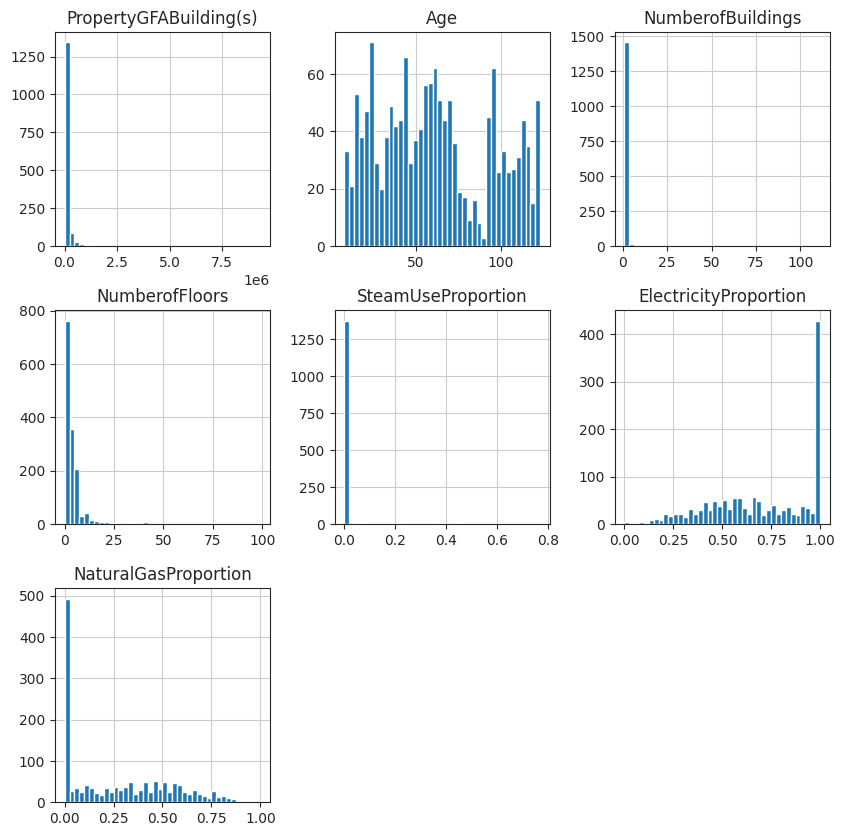

skewness :


PropertyGFABuilding(s)    21.469276
Age                        0.276967
NumberofBuildings         30.938935
NumberofFloors             5.888723
SteamUseProportion         4.485547
ElectricityProportion     -0.354307
NaturalGasProportion       0.514989
dtype: float64

In [15]:
# plotting distributions
fts = [*num_fts, *source_prop_fts]
data.hist(fts, bins=40, figsize=(10,10))
plt.show()
print("skewness :")
data[fts].skew()

Perhaps skewed features can be improved with a log transformation?

In [16]:
skewed_fts = list(
    data[fts].skew().to_frame()
    .rename(columns={0: "skew"})
    .query("skew > 1")
    .index
)
skewed_fts

['PropertyGFABuilding(s)',
 'NumberofBuildings',
 'NumberofFloors',
 'SteamUseProportion']

In [17]:
log_inputs = np.log1p(data[skewed_fts])

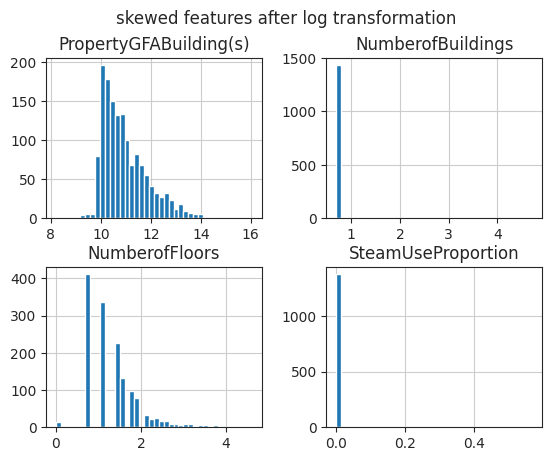

PropertyGFABuilding(s)    1.151732
NumberofBuildings         9.088150
NumberofFloors            1.264494
SteamUseProportion        4.271994
dtype: float64

In [18]:
log_inputs.hist(bins=40)
plt.suptitle("skewed features after log transformation")
plt.show()
log_inputs.skew()

May be I could also apply a log transformation followed by a MinMaxscaler.

Let's observe other possible transformations :

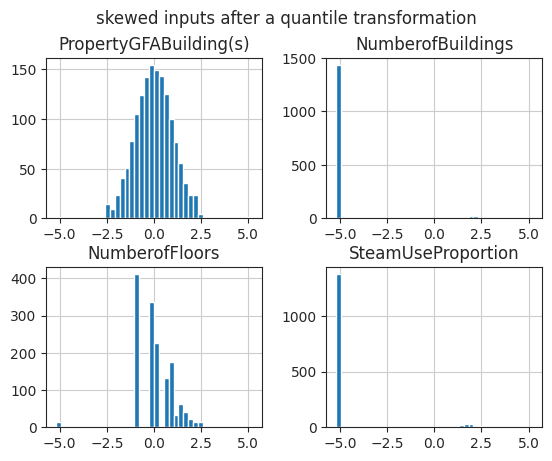

PropertyGFABuilding(s)   -0.013578
NumberofBuildings         5.154727
NumberofFloors           -0.813804
SteamUseProportion        3.280278
dtype: float64

In [19]:
qt_inputs = pd.DataFrame(
    normal_quantile_transformer.fit_transform(data[skewed_fts]),
    columns=skewed_fts
)

qt_inputs.hist(bins=40)
plt.suptitle('skewed inputs after a quantile transformation')
plt.show()
qt_inputs.skew()

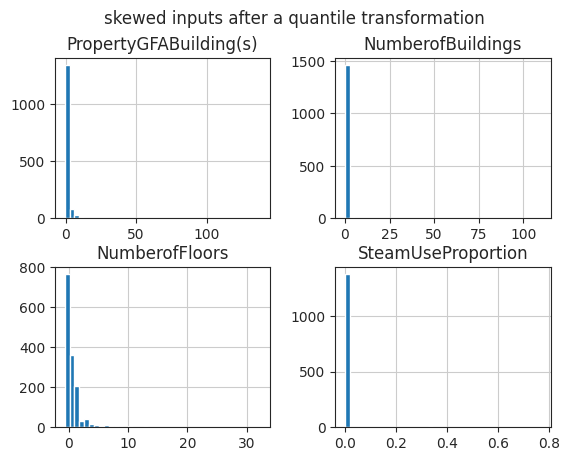

PropertyGFABuilding(s)    21.469276
NumberofBuildings         30.938935
NumberofFloors             5.888723
SteamUseProportion         4.485547
dtype: float64

In [20]:
robust_inputs = pd.DataFrame(
    RobustScaler().fit_transform(data[skewed_fts]),
    columns=skewed_fts
)

robust_inputs.hist(bins=40)
plt.suptitle('skewed inputs after a quantile transformation')
plt.show()
robust_inputs.skew()

We keep having skewed distributions after the robust scaling. We might want to stick the log and quantile transformation

## 1.4.  [&#9650;](#toc0_) <a id='toc1_4_'></a>Preparing the target and visualizing some transformations.

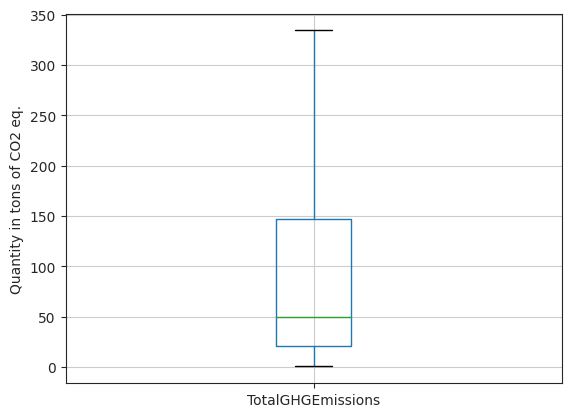

count     1482.000000
mean       194.121937
std        793.530218
min          0.400000
25%         20.307500
50%         49.580000
75%        147.105000
max      16870.980000
Name: TotalGHGEmissions, dtype: float64

In [21]:
y = data[pt.GHG_TARGET]
X_core = data.loc[:, core_fts]
X_core_with_additional = data.loc[:, [*core_fts, *additional_fts]]

y.to_frame().boxplot(showfliers=False)
plt.ylabel('Quantity in tons of CO2 eq.')
plt.show()
y.describe()

In [22]:
y.notnull().mean()

1.0

**Let's Verify if the provided values are consistent with the values of the energy consumption per sources.**

- The target should be calculated like this according the source :

> The total amount of greenhouse gas emissions, including carbon dioxide, methane, and nitrous oxide gases released into the atmosphere as a result of energy consumption at the property, measured in metric tons of carbon dioxide equivalent. This calculation uses a GHG emissions factor from Seattle CIty Light's portfolio of generating resources. This uses Seattle City Light's 2015 emissions factor of 52.44 lbs CO2e/MWh until the 2016 factor is available. Enwave steam factor = 170.17 lbs CO2e/MMBtu. Gas factor sourced from EPA Portfolio Manager = 53.11 kg CO2e/MBtu. 

- MM means million.
- kilo : 1000
- 1 kWh = 3.412 kBtu
- 1 lbs = 0.4536 kg

In [23]:
data['Electricity(MWh)'] = data["Electricity(kBtu)"] / 3.412 / 1000

In [24]:
data["GHGEmission_electricity_tons_CO2_eq"] = (
    data["Electricity(MWh)"]
    * 52.44 # lbs CO2e
    * 0.4536 # kg CO2e
    / 1000 # tons CO2e
)

data["GHGEmission_gas_tons_CO2_eq"] = (
    data["NaturalGas(kBtu)"]
    / 1000 # MBtu
    * 53.11 # kg CO2e
    / 1000 # tons CO2e
)

data["GHGEmission_steam_tons_CO2_eq"] = (
    data["SteamUse(kBtu)"]
    / 1000 # MBtu
    * 170.17 # lbs CO2e
    * 0.4536 # kg CO2e
    / 1000 # tons CO2e
)

data["TotalGHGEmission_tons_CO2eq_theory"] = (
    data.GHGEmission_electricity_tons_CO2_eq
    + data.GHGEmission_steam_tons_CO2_eq
    + data.GHGEmission_gas_tons_CO2_eq
)


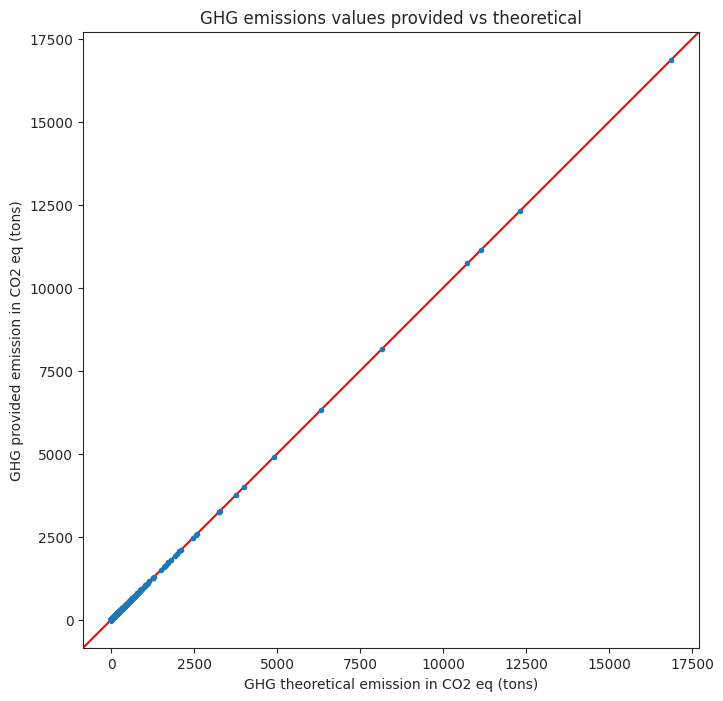

In [25]:
# Verifying provided values consistency
fix, ax = plt.subplots(figsize=(10,8))
# plot y = x
ax.axline((0, 0), slope=1, c='red')

plt.plot(
    data.TotalGHGEmission_tons_CO2eq_theory,
    data.TotalGHGEmissions, 
    'o',
    markersize=3,
)
ax.set_aspect('equal')
plt.title("GHG emissions values provided vs theoretical")
plt.xlabel("GHG theoretical emission in CO2 eq (tons)")
plt.ylabel("GHG provided emission in CO2 eq (tons)")
plt.show()

Everything is on the expected line. Consistent then !

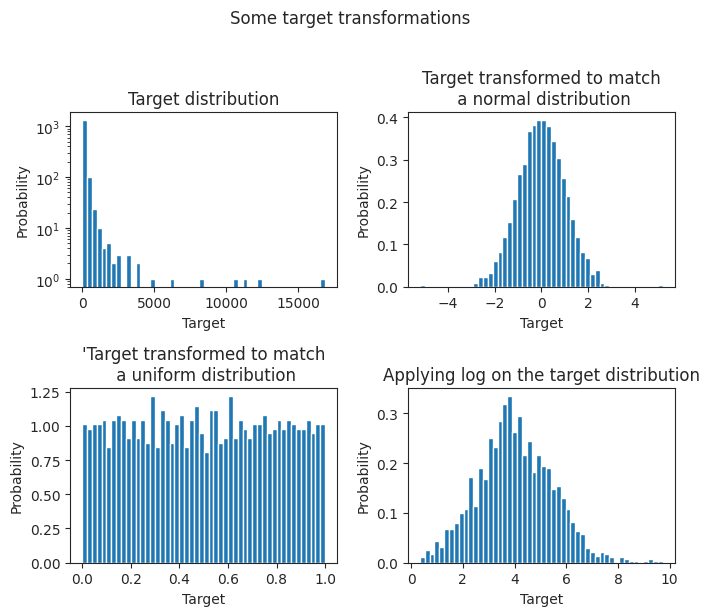

In [26]:
y_reshape = np.array(y).reshape(-1, 1)

# Transform target to match a normal distribution
y_n = normal_quantile_transformer.fit_transform(y_reshape)
# Transform target to match a uniform distribution
y_u = uniform_quantile_transformer.fit_transform(y_reshape)
# Transform target applying a log_transformer
y_log = log_transformer.fit_transform(y_reshape)

### Plots
f, axs = plt.subplots(2, 2, figsize=(7,6))
ax0, ax1 = axs[0]
ax2, ax3 = axs[1]
n_bins=50

ax0.hist(y, bins=n_bins, log=True)
ax0.set_ylabel("Probability")
ax0.set_xlabel("Target")
ax0.set_title("Target distribution")

ax1.hist(y_n, bins=n_bins, density=True)
ax1.set_ylabel("Probability")
ax1.set_xlabel("Target")
ax1.set_title("Target transformed to match\n a normal distribution")

ax2.hist(y_u, bins=n_bins, density=True)
ax2.set_ylabel("Probability")
ax2.set_xlabel("Target")
ax2.set_title("'Target transformed to match\n a uniform distribution")

ax3.hist(y_log, bins=n_bins, density=True)
ax3.set_ylabel("Probability")
ax3.set_xlabel("Target")
ax3.set_title("Applying log on the target distribution")

f.suptitle("Some target transformations", y=1.02)
plt.tight_layout()
plt.show()

In [27]:
# Top GHG emitters
data.loc[y > 2800]

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity,Age,ProportionPrincipalUseType,ProportionSecondaryUseType,ProportionThirdUseType,RiseType,AgeType,energies_sum,energy_ratio,SteamUseProportion,ElectricityProportion,NaturalGasProportion,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K12School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_LargeOffice,PrimaryPropertyType_MedicalOffice,PrimaryPropertyType_MixedUseProperty,PrimaryPropertyType_Other,PrimaryPropertyType_RefrigeratedWarehouse,PrimaryPropertyType_ResidenceHall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_RetailStore,PrimaryPropertyType_SelfStorageFacility,PrimaryPropertyType_SeniorCareCommunity,PrimaryPropertyType_SmallandMidSizedOffice,PrimaryPropertyType_SupermarketGroceryStore,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_WorshipFacility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7,Electricity(MWh),GHGEmission_electricity_tons_CO2_eq,GHGEmission_gas_tons_CO2_eq,GHGEmission_steam_tons_CO2_eq,TotalGHGEmission_tons_CO2eq_theory
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
43,Campus,MixedUseProperty,Plant 2 Site,7755 E MARGINAL WAY S,Seattle,WA,98108.0,0022000005,2,GREATER DUWAMISH,47.534930,-122.317880,1992,1,3,494835,0,494835,"Energy/Power Station, Laboratory, Manufacturing/Industrial Plant, Non-Refrigerated Warehouse, Office",Office,757027.0,Laboratory,639931.0,Non-Refrigerated Warehouse,459748.0,NaN,8.0,221.699997,233.100006,388.200012,400.299988,448385312.0,471613856.0,0.0,150476283.0,297909000.0,Compliant,NaN,16870.98,34.09,31,1.529857,1.293221,0.929094,Low,Modern,448385283.0,1.000000,0.00,0.34,0.66,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,44102.075909,1049.046554,15821.946990,0.000000,16870.993544
198,NonResidential,Hospital,Seattle Children's Hospital Main Campus,4800 Sand Point Way NE,Seattle,WA,98105.0,2982800005,4,NORTHEAST,47.662310,-122.281460,1953,6,10,879000,0,879000,Hospital (General Medical & Surgical),Hospital (General Medical & Surgical),879000.0,NaN,NaN,NaN,NaN,NaN,10.0,288.799988,293.200012,578.200012,576.599976,253832464.0,257764208.0,0.0,115641210.0,138191238.0,Compliant,NaN,8145.52,9.27,70,1.000000,NaN,NaN,Medium,Old,253832448.0,1.000000,0.00,0.46,0.54,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,33892.500000,806.193577,7339.336650,0.000000,8145.530227
268,NonResidential,Hospital,Swedish Cherry Hill,500 17th Ave,Seattle,WA,98122.0,7942600331,3,CENTRAL,47.607050,-122.309660,1990,6,5,597519,0,597519,"Hospital (General Medical & Surgical), Parking",Hospital (General Medical & Surgical),601615.0,Parking,48607.0,NaN,NaN,NaN,34.0,238.399994,244.800003,454.399994,459.200012,143423024.0,147299056.0,0.0,58754927.0,84668094.0,Compliant,NaN,4906.33,8.21,33,1.006855,0.081348,NaN,NaN,Modern,143423021.0,1.000000,0.00,0.41,0.59,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,17220.084115,409.610421,4496.722472,0.000000,4906.332894
276,NonResidential,Hospital,Harborview Medical Center,325 9th Ave.,Seattle,WA,98104.0,8590900220,3

Hospitals and universities. 

## 1.5.  [&#9650;](#toc0_) <a id='toc1_5_'></a>Splitting into test and train sets

In [28]:
# X is to be equal to X_core or X_core_with_additional
X = X_core

test_size = 0.25
seed = 2

X_train, X_test, y_train, y_test = train_test_split(
    X, y, shuffle=True, test_size=test_size, random_state=seed
)

## 1.6.  [&#9650;](#toc0_) <a id='toc1_6_'></a>Defining metrics

In [29]:
### A dataframe of the chosen metrics with 3 attributes:
# - the sklearn name function;
# - the alias for some sklearn functions scoring parameter;
# - eventually some kwargs to pass to the function so it has the desired
# behavior.
metrics = pd.DataFrame(
    {
        "name": ["R2", "MAE", "RMSE", "RMLSE"],
        "func": [
            r2_score,
            mean_absolute_error,
            mean_squared_error,
            mean_squared_log_error,
        ],
        "scoring_alias": [
            "r2",
            "neg_mean_absolute_error",
            "neg_root_mean_squared_error",
            "neg_root_mean_squared_log_error",
        ],
        "kwargs": [
            None,
            None,
            dict([("squared", False)]),
            dict([("squared", False)]),
        ],
    }
).set_index("name")

# Not using RMSLE for now because I have some negative values.
metrics = metrics.iloc[:-1, :]
metrics

,func,scoring_alias,kwargs
name,,,
R2,<function r2_score at 0x7f855c356ca0>,r2,None
MAE,<function mean_absolute_error at 0x7f855c356820>,neg_mean_absolute_error,None
RMSE,<function mean_squared_error at 0x7f855c3569d0>,neg_root_mean_squared_error,{'squared': False}


In [30]:
def apply_score_func(metric, y_true, y_pred, precision=5):
    """ Compute the score according the 'metric' 
    
    'metric' must be a series of the metrics dataframe I made
    to regroup scoring aliases and scoring function of sklearn.
    
    WARNING, ensure the y's are passed in this order, it is not always
    symmetric!"""
    if metric.kwargs is not None:
        return round(metric.func(y_true, y_pred, **metric.kwargs), precision)
    else:
        return round(metric.func(y_true, y_pred), precision)

## 1.7.  [&#9650;](#toc0_) <a id='toc1_7_'></a>Defining regressors

In [31]:
### A dataframe of the chosen Regressors with 3 attributes:
# - the sklearn Class;
# - eventually some kwargs to pass to the function so it has the desired
# behavior.
# - the params_grid for CV evaluation.
regressors = pd.DataFrame(
    {
        "name": [
            "linear_regression",
            "lasso",
            "ridge",
            "elastic_net",
            "huber",
            "knn",
            "random_forest",
            "xgboost",
        ],
        "regressor": [
            LinearRegression,
            Lasso,
            Ridge,
            ElasticNet,
            HuberRegressor,
            KNeighborsRegressor,
            RandomForestRegressor,
            np.NAN,
        ],
        "kwargs": [
            None,
            {"random_state": seed, "max_iter": 100_000},
            {"random_state": seed, "max_iter": 100_000},
            None,
            None,
            None,
            None,
            None,
        ],
        "params_grid": [
            None,
            None,
            None,
            None,
            None,
            None,
            None,
            None,
        ],
    }
).set_index("name")

In [32]:
def instantiate_regressor(regr):
    if regr.kwargs is not None:
        return regr.regressor(**regr.kwargs)
    else:
        return regr.regressor()
 

In [33]:
# test previous function
instantiate_regressor(regressors.loc['lasso'])

Lasso(max_iter=100000, random_state=2)

## 1.8.  [&#9650;](#toc0_) <a id='toc1_8_'></a>Defining pre_processors

In [34]:
def define_pre_processors_according_to_inputs(
    fts_to_transform, fts_to_scale_only, fts_passthrough
):
    """define which features goes in which pre_processing block

    Args:
        fts_to_transform (list): features with skewed distribution.
        fts_to_scale_only (list): features with an acceptable 
        distribution shape, but which need to be scaled.
        fts_passthrough (list): features good to go right in the model. 
    """
    num_fts = [*fts_to_transform, *fts_to_scale_only]
    # Note that those preprocessor automatically drop unmentioned 
    # features as the remainder parameter of ColumnTransformer default 
    # to 'drop'.
    # Thus, for example, for the min_max_pre_processor, fts not in 
    # 'num_fts' union 'fts_passthrough' are dropped.
    min_max_pre_processor = ColumnTransformer(
        transformers=[
            ("min_max_scaler", MinMaxScaler(feature_range=(0, 1)), num_fts),
            ("passthrough", "passthrough", fts_passthrough)
        ], remainder='drop'
    )

    standard_pre_processor = ColumnTransformer(
        transformers=[
            ("standard_scaler", StandardScaler(), num_fts),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )

    # Transform all numerical features
    log_pre_processor = ColumnTransformer(
        transformers=[
            ("log_transformer_only", log_transformer, num_fts),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )

    log_min_max_transformer = Pipeline(
        [
            ('log_transformer', log_transformer),
            ('min_max_scaler', MinMaxScaler())
        ]
    )

    # With a later possibility to not apply log on certain features
    mixed_log_min_max_pre_processor = ColumnTransformer(
        [
            ("log_into_min_max_scaler", log_min_max_transformer, fts_to_transform),
            ("min_max_scaler", MinMaxScaler(), fts_to_scale_only),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )

    log_standard_transformer = Pipeline(
        [
            ('log_transformer', log_transformer),
            ('min_max_scaler', StandardScaler())
        ]
    )

    mixed_log_standard_pre_processor = ColumnTransformer(
        [
            (
                "log_into_standard_scaler",
                log_standard_transformer,
                fts_to_transform
            ),
            ("standard_scaler", StandardScaler(), fts_to_scale_only),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )

    # No need to rescale after using quantile transformers because
    # the output is already in a decent range.
    normal_quantile_pre_processor = ColumnTransformer(
        [
            (
                "normal_quantile_transformer",
                normal_quantile_transformer,
                fts_to_transform
            ),
            ("min_max_scaler", MinMaxScaler(), fts_to_scale_only),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )

    uniform_quantile_pre_processor = ColumnTransformer(
        [
            (
                "uniform_quantile_transformer",
                uniform_quantile_transformer,
                fts_to_transform
            ),
            ("min_max_scaler", MinMaxScaler(), fts_to_scale_only),
            ("passthrough", "passthrough", fts_passthrough)
        ]
    )
    # Define a list of pre_processors
    return [
        min_max_pre_processor,
        standard_pre_processor,
        log_pre_processor,
        mixed_log_min_max_pre_processor,
        mixed_log_standard_pre_processor,
        normal_quantile_pre_processor,
        uniform_quantile_pre_processor
    ]

    

# 2.  [&#9650;](#toc0_) <a id='toc2_'></a> A Baseline : DummyRegressor

In [45]:
results = []
models = []
models_idx = 0

model = DummyRegressor(strategy="mean")
computation_time = np.NaN # Will have to investigate timeit
model.fit(X_train, y_train)
models_idx += 1
models.append(model)
pred_train =  model.predict(X_train)
pred_test =  model.predict(X_test)

for i, metric in metrics.iterrows():
    
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, scoring=metric.scoring_alias
    )
    print("-"*10)
 
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    
    hyperparameters='None'
    
    # add to results
    results.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "DummyRegressor",
            'None',
            metric.name,
            'None',
            models_idx          
        ]
    )
    

Cross-validation evaluation : 
    scores on folds:  [-0.    -0.002 -0.064 -0.001 -0.014]
    mean score:  -0.016
    std score deviation:  0.024
----------
Cross-validation evaluation : 
    scores on folds:  [202.644 217.745 170.188 221.793 185.675]
    mean score:  199.609
    std score deviation:  19.442
----------
Cross-validation evaluation : 
    scores on folds:  [ 763.432  860.348  227.669 1159.859  320.74 ]
    mean score:  666.409
    std score deviation:  347.13
----------


# 3.  [&#9650;](#toc0_) <a id='toc3_'></a>Basic linear regressions.

## 3.1.  [&#9650;](#toc0_) <a id='toc3_1_'></a>Defining the unique input

In [46]:
# Using only 1 input for a very simple model using the most correlated feature.
fts_to_transform = ['PropertyGFABuilding(s)']
fts_to_scale_only = []
fts_passthrough = []

## 3.2.  [&#9650;](#toc0_) <a id='toc3_2_'></a>Defining pre_processors

In [47]:
pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

for pp in pre_processors:
    display(pp)

ColumnTransformer(transformers=[('min_max_scaler', MinMaxScaler(),
                                 ['PropertyGFABuilding(s)']),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('standard_scaler', StandardScaler(),
                                 ['PropertyGFABuilding(s)']),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('log_transformer_only',
                                 FunctionTransformer(feature_names_out='one-to-one',
                                                     func=<ufunc 'log1p'>,
                                                     inverse_func=<ufunc 'expm1'>),
                                 ['PropertyGFABuilding(s)']),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)']),
                                ('min_max_scaler', MinMaxScaler(), []),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('log_into_standard_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  StandardScaler())]),
                                 ['PropertyGFABuilding(s)']),
                                ('standard_scaler', StandardScaler(), []),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('normal_quantile_transformer',
                                 QuantileTransformer(n_quantiles=100,
                                                     output_distribution='normal',
                                                     random_state=0),
                                 ['PropertyGFABuilding(s)']),
                                ('min_max_scaler', MinMaxScaler(), []),
                                ('passthrough', 'passthrough', [])])

ColumnTransformer(transformers=[('uniform_quantile_transformer',
                                 QuantileTransformer(n_quantiles=100,
                                                     random_state=0),
                                 ['PropertyGFABuilding(s)']),
                                ('min_max_scaler', MinMaxScaler(), []),
                                ('passthrough', 'passthrough', [])])

## 3.3.  [&#9650;](#toc0_) <a id='toc3_3_'></a>Fitting models and saving results

### 3.3.1.  [&#9650;](#toc0_) <a id='toc3_3_1_'></a>Without target transformation

In [38]:
regr = regressors.iloc[0, :]
regr

regressor      <class 'sklearn.linear_model._base.LinearRegression'>
kwargs                                                          None
params_grid                                                     None
Name: linear_regression, dtype: object

--------------------
 model's pre-processor:
    min_max_scaler
--------------------


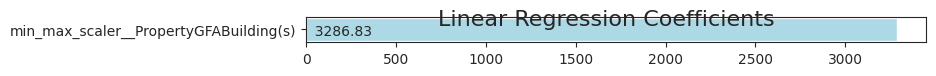

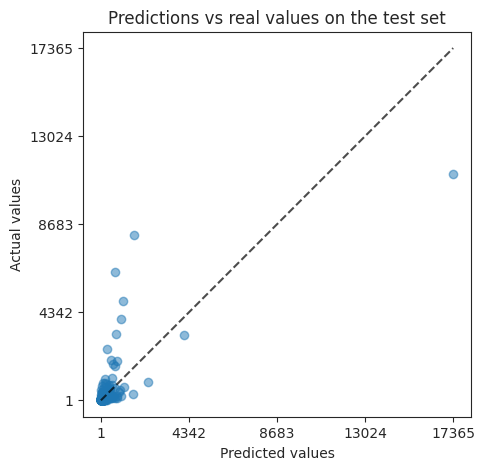

Cross-validation evaluation : 
    scores on folds:  [-0.852  0.049  0.342  0.168  0.269]
    mean score:  -0.005
    std score deviation:  0.435
Cross-validation evaluation : 
    scores on folds:  [175.465 208.437 149.907 128.336 183.233]
    mean score:  169.076
    std score deviation:  27.632
Cross-validation evaluation : 
    scores on folds:  [ 435.582 1108.29   677.438  304.924  670.402]
    mean score:  639.327
    std score deviation:  274.11
--------------------
 model's pre-processor:
    standard_scaler
--------------------


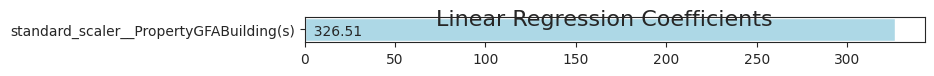

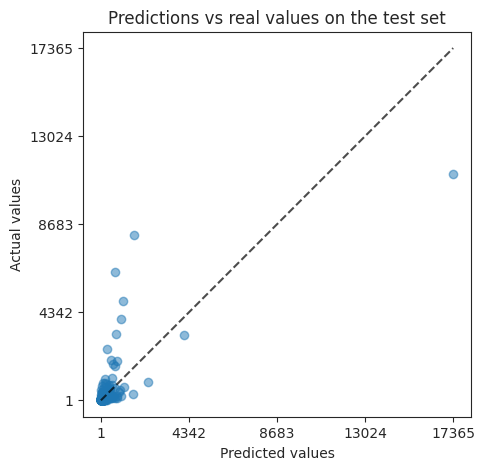

Cross-validation evaluation : 
    scores on folds:  [-0.852  0.049  0.342  0.168  0.269]
    mean score:  -0.005
    std score deviation:  0.435
Cross-validation evaluation : 
    scores on folds:  [175.465 208.437 149.907 128.336 183.233]
    mean score:  169.076
    std score deviation:  27.632
Cross-validation evaluation : 
    scores on folds:  [ 435.582 1108.29   677.438  304.924  670.402]
    mean score:  639.327
    std score deviation:  274.11
--------------------
 model's pre-processor:
    log_transformer_only
--------------------


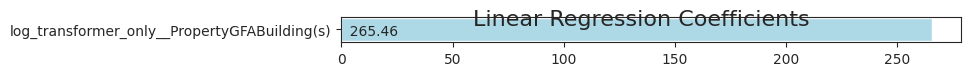

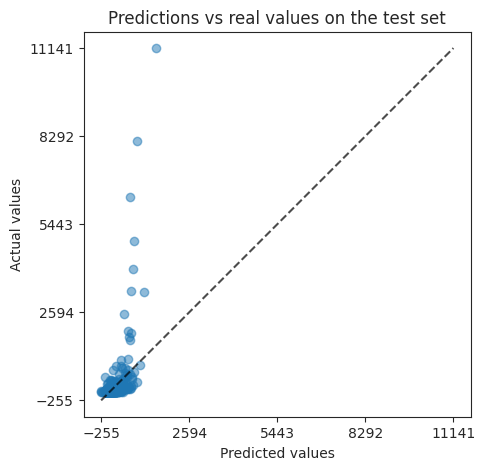

Cross-validation evaluation : 
    scores on folds:  [0.234 0.058 0.124 0.14  0.141]
    mean score:  0.14
    std score deviation:  0.056
Cross-validation evaluation : 
    scores on folds:  [181.775 228.022 188.128 187.351 220.739]
    mean score:  201.203
    std score deviation:  19.189
Cross-validation evaluation : 
    scores on folds:  [ 280.148 1103.069  781.816  309.929  726.703]
    mean score:  640.333
    std score deviation:  310.001
--------------------
 model's pre-processor:
    log_into_min_max_scaler
--------------------


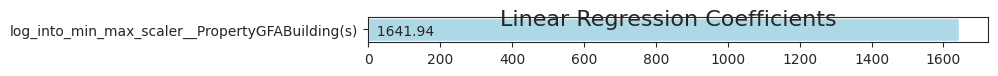

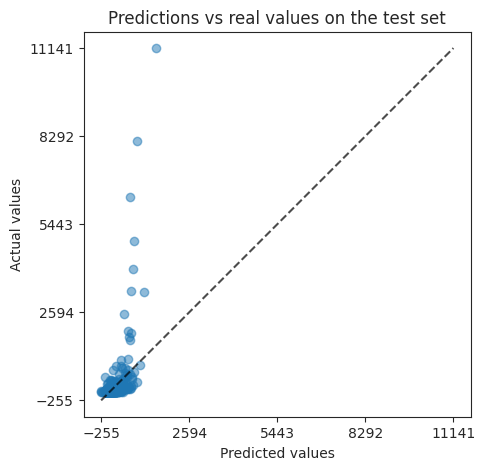

Cross-validation evaluation : 
    scores on folds:  [0.234 0.058 0.124 0.14  0.141]
    mean score:  0.14
    std score deviation:  0.056
Cross-validation evaluation : 
    scores on folds:  [181.775 228.022 188.128 187.351 220.739]
    mean score:  201.203
    std score deviation:  19.189
Cross-validation evaluation : 
    scores on folds:  [ 280.148 1103.069  781.816  309.929  726.703]
    mean score:  640.333
    std score deviation:  310.001
--------------------
 model's pre-processor:
    log_into_standard_scaler
--------------------


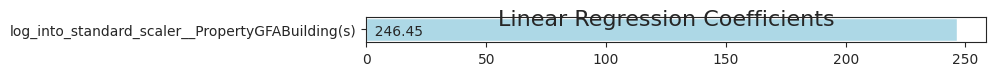

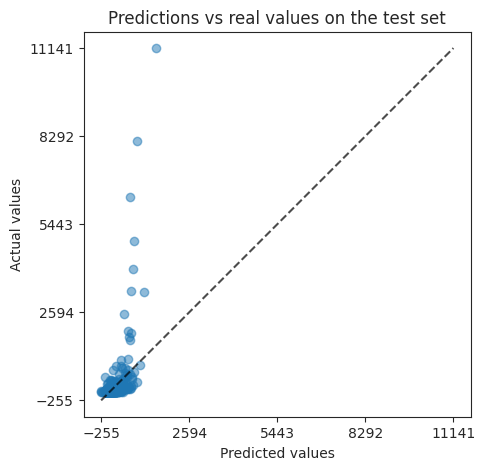

Cross-validation evaluation : 
    scores on folds:  [0.234 0.058 0.124 0.14  0.141]
    mean score:  0.14
    std score deviation:  0.056
Cross-validation evaluation : 
    scores on folds:  [181.775 228.022 188.128 187.351 220.739]
    mean score:  201.203
    std score deviation:  19.189
Cross-validation evaluation : 
    scores on folds:  [ 280.148 1103.069  781.816  309.929  726.703]
    mean score:  640.333
    std score deviation:  310.001
--------------------
 model's pre-processor:
    normal_quantile_transformer
--------------------


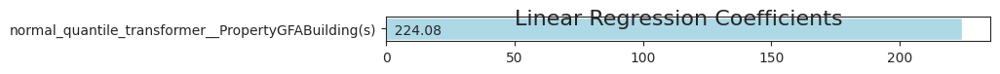

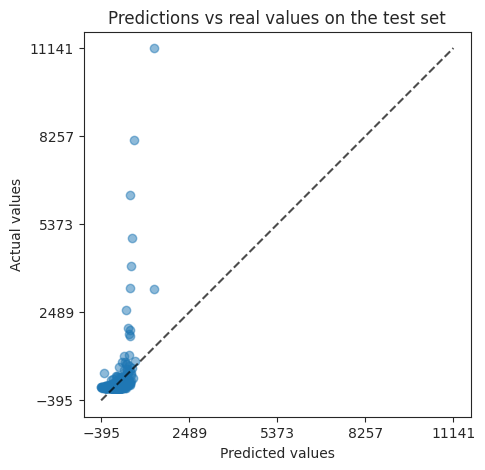

Cross-validation evaluation : 
    scores on folds:  [0.183 0.04  0.147 0.05  0.086]
    mean score:  0.101
    std score deviation:  0.055
Cross-validation evaluation : 
    scores on folds:  [196.377 238.994 192.987 204.912 241.64 ]
    mean score:  214.982
    std score deviation:  21.064
Cross-validation evaluation : 
    scores on folds:  [ 289.327 1113.721  771.382  325.73   749.573]
    mean score:  649.947
    std score deviation:  308.195
--------------------
 model's pre-processor:
    uniform_quantile_transformer
--------------------


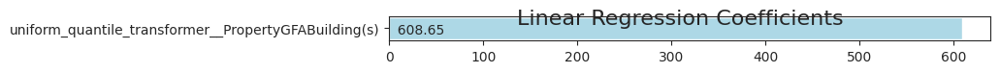

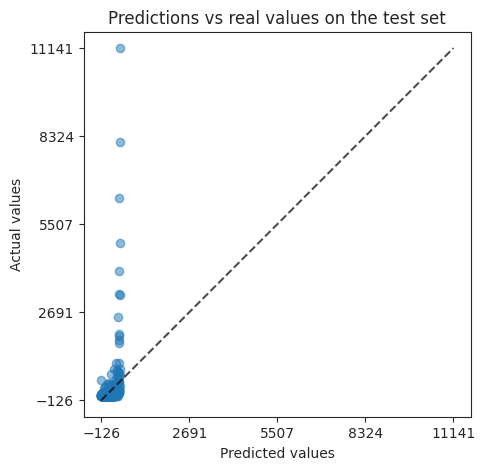

Cross-validation evaluation : 
    scores on folds:  [0.199 0.032 0.048 0.098 0.065]
    mean score:  0.088
    std score deviation:  0.059
Cross-validation evaluation : 
    scores on folds:  [174.074 213.438 195.785 182.644 221.791]
    mean score:  197.546
    std score deviation:  17.981
Cross-validation evaluation : 
    scores on folds:  [ 286.441 1118.278  815.163  317.525  758.184]
    mean score:  659.118
    std score deviation:  316.407


In [49]:
show_plot = True
show_regressor_input = False
show_scores = False
silent = False

for pp in pre_processors:
    # Define the model
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("regressor", instantiate_regressor(regr)),
        ]
    )
    # Print the pre_processor name
    print('-' * 20)
    print(
        f" model's pre-processor:\n    "
        f"{model['pre_processor'].transformers[0][0]}"
    )

    # Fine tuning the model, if there is hyperparameters grid search.
    if regr.params_grid is not None:
        pass
    else:
        hyperparameters = None
        
    print('-'*20)
    
    # Fit the model and predict both on train and test sets.
    computation_time = np.NaN # Will have to investigate timeit
    model.fit(X_train, y_train)
    pred_train =  model.predict(X_train)
    pred_test =  model.predict(X_test)
    # save the model
    models_idx += 1
    models.append(model)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model["regressor"], model[:-1].get_feature_names_out()
        )
            
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model[:-1].transform(X_train), 
            index=X_train.index,
            columns=model[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # evaluating according several metrics 
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")

        # add to results
        results.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                str(model.named_steps['regressor']).rstrip("()"),
                list(model['pre_processor'].named_transformers_.keys())[0],
                metric.name,
                'None',
                models_idx          
            ]
        )

In [50]:
# Create the results dataframe
cols = [
    "CV_train_score_mean",
    "CV_train_score_std",
    "test_score",
    "computation_time",
    "hyperparameters",
    "fold_scores",
    "train_score",
    "regressor",
    "pre_processor",
    "metric",
    "target_transformer",
    "models_idx"
]

df_results = pd.DataFrame(
    results, columns=cols
).set_index(["metric", "regressor", "pre_processor"])
display(df_results)        

,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,target_transformer,models_idx
metric,regressor,pre_processor,,,,,,,,,
R2,DummyRegressor,None,-0.016,0.024,-0.00716,NaN,None,"[-0.0, -0.002, -0.064, -0.001, -0.014]",0.00000,None,1
MAE,DummyRegressor,None,199.609,19.442,270.04658,NaN,None,"[202.644, 217.745, 170.188, 221.793, 185.675]",199.30060,None,1
RMSE,DummyRegressor,None,666.409,347.130,908.85408,NaN,None,"[763.432, 860.348, 227.669, 1159.859, 320.74]",751.03579,None,1
R2,LinearRegression,min_max_scaler,-0.005,0.435,0.44908,NaN,None,"[-0.852, 0.049, 0.342, 0.168, 0.269]",0.18901,None,2
MAE,LinearRegression,min_max_scaler,169.076,27.632,191.05297,NaN,None,"[175.465, 208.437, 149.907, 128.336, 183.233]",163.07404,None,2
RMSE,LinearRegression,min_max_scaler,639.327,274.110,672.18378,NaN,None,"[435.582, 1108.29, 677.438, 304.924, 670.402]",676.34525,None,2
R2,LinearRegression,standard_scaler,-0.005,0.435,0.44908,NaN,None,"[-0.852, 0.049, 0.342, 0.168, 0.269]",0.18901,None,3
MAE,LinearRegression,standard_scaler,169.076,27.632,191.05297,NaN,None,"[175.465, 208.437, 149.907, 128.336, 183.233]",163.07404,None,3
RMSE,LinearRegression,standard_scaler,639.327,274.110,672.18378,NaN,None,"[435.582, 1108.29, 677.438, 304.924, 670.402]",676.34525,None,3


In [51]:
(
    df_results
    .fillna('0')
    .sort_values(['metric', 'CV_train_score_mean'], ascending=[True, True])
    .style.format('{:.3f}', subset=['CV_train_score_mean'])
    .background_gradient(axis=0, cmap='Blues', subset='CV_train_score_mean')
)

### 3.3.2.  [&#9650;](#toc0_) <a id='toc3_3_2_'></a>With target transformers

--------------------
 model's pre-processor and target transformer :
    min_max_scaler - normal_quantile_transformer
--------------------


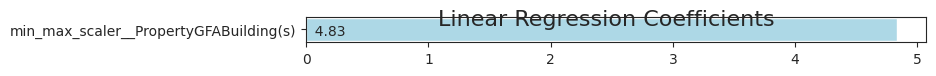

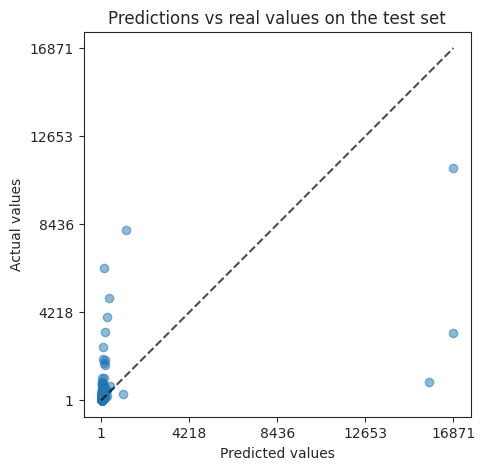

Cross-validation evaluation : 
    scores on folds:  [-4.2935e+01 -1.0220e+00  8.1900e-01 -5.0000e-03 -2.6730e+00]
    mean score:  -9.163
    std score deviation:  16.926
Cross-validation evaluation : 
    scores on folds:  [411.247 304.089 110.998 118.584 264.148]
    mean score:  241.813
    std score deviation:  114.353
Cross-validation evaluation : 
    scores on folds:  [2121.453 1616.456  355.757  335.042 1502.933]
    mean score:  1186.328
    std score deviation:  717.53
--------------------
 model's pre-processor and target transformer :
    min_max_scaler - uniform_quantile_transformer
--------------------


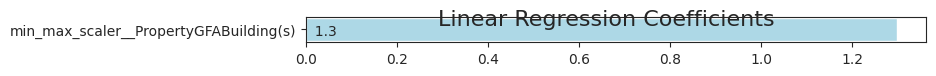

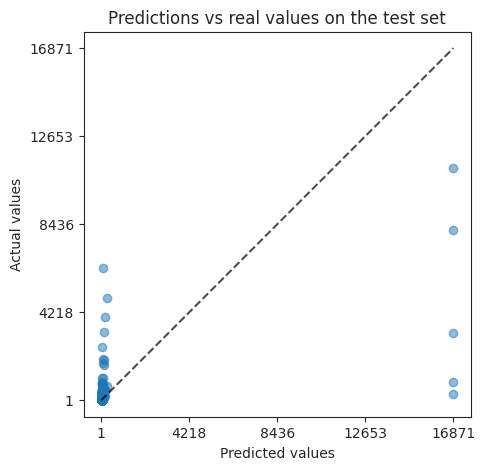

Cross-validation evaluation : 
    scores on folds:  [-75.403  -2.367   0.817 -22.111  -5.442]
    mean score:  -20.901
    std score deviation:  28.376
Cross-validation evaluation : 
    scores on folds:  [584.112 425.248 112.585 261.952 363.48 ]
    mean score:  349.475
    std score deviation:  157.968
Cross-validation evaluation : 
    scores on folds:  [2797.573 2085.878  357.651 1606.945 1990.39 ]
    mean score:  1767.687
    std score deviation:  803.187
--------------------
 model's pre-processor and target transformer :
    min_max_scaler - log_transformer
--------------------


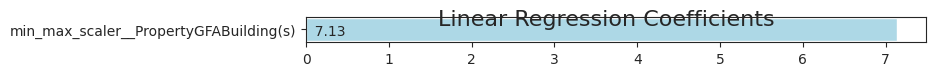

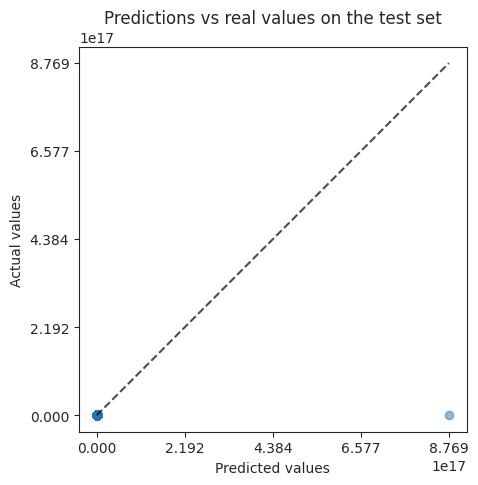

Cross-validation evaluation : 
    scores on folds:  [-1.58678e+02 -9.00000e-02 -3.33100e+00 -1.60000e-02  2.60000e-02]
    mean score:  -32.418
    std score deviation:  63.143
Cross-validation evaluation : 
    scores on folds:  [522.395 202.977 205.975 119.363 191.5  ]
    mean score:  248.442
    std score deviation:  140.588
Cross-validation evaluation : 
    scores on folds:  [4044.357 1186.899 1738.276  336.948  773.965]
    mean score:  1616.089
    std score deviation:  1299.307
--------------------
 model's pre-processor and target transformer :
    standard_scaler - normal_quantile_transformer
--------------------


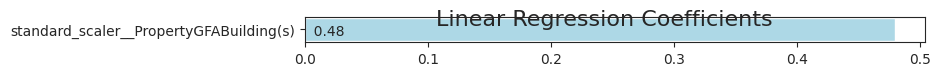

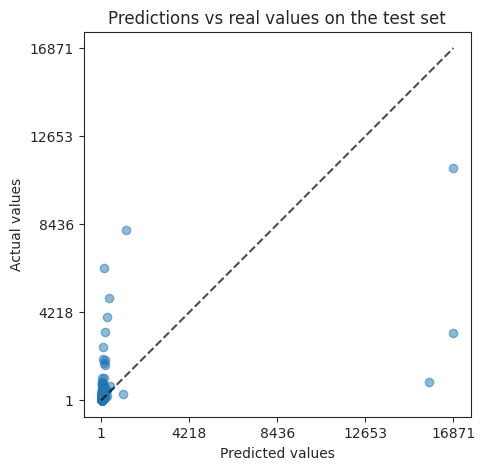

Cross-validation evaluation : 
    scores on folds:  [-4.2935e+01 -1.0220e+00  8.1900e-01 -5.0000e-03 -2.6730e+00]
    mean score:  -9.163
    std score deviation:  16.926
Cross-validation evaluation : 
    scores on folds:  [411.247 304.089 110.998 118.584 264.148]
    mean score:  241.813
    std score deviation:  114.353
Cross-validation evaluation : 
    scores on folds:  [2121.453 1616.456  355.757  335.042 1502.933]
    mean score:  1186.328
    std score deviation:  717.53
--------------------
 model's pre-processor and target transformer :
    standard_scaler - uniform_quantile_transformer
--------------------


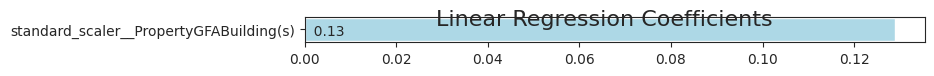

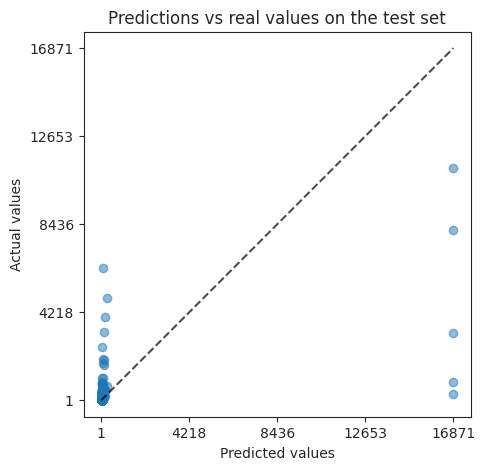

Cross-validation evaluation : 
    scores on folds:  [-75.403  -2.367   0.817 -22.111  -5.442]
    mean score:  -20.901
    std score deviation:  28.376
Cross-validation evaluation : 
    scores on folds:  [584.112 425.248 112.585 261.952 363.48 ]
    mean score:  349.475
    std score deviation:  157.968
Cross-validation evaluation : 
    scores on folds:  [2797.573 2085.878  357.651 1606.945 1990.39 ]
    mean score:  1767.687
    std score deviation:  803.187
--------------------
 model's pre-processor and target transformer :
    standard_scaler - log_transformer
--------------------


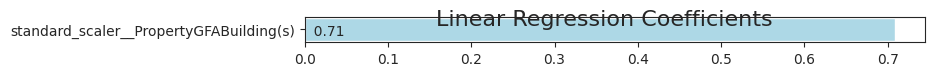

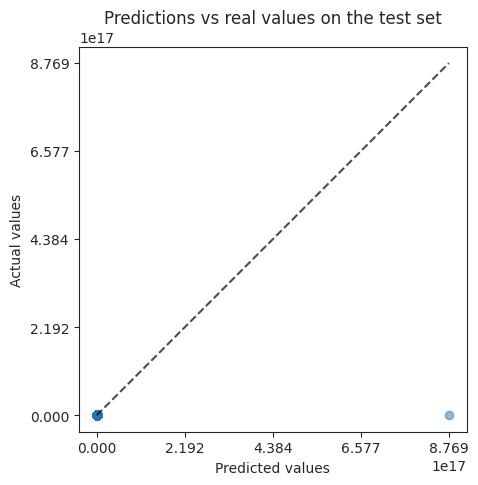

Cross-validation evaluation : 
    scores on folds:  [-1.58678e+02 -9.00000e-02 -3.33100e+00 -1.60000e-02  2.60000e-02]
    mean score:  -32.418
    std score deviation:  63.143
Cross-validation evaluation : 
    scores on folds:  [522.395 202.977 205.975 119.363 191.5  ]
    mean score:  248.442
    std score deviation:  140.588
Cross-validation evaluation : 
    scores on folds:  [4044.357 1186.899 1738.276  336.948  773.965]
    mean score:  1616.089
    std score deviation:  1299.307
--------------------
 model's pre-processor and target transformer :
    log_transformer_only - normal_quantile_transformer
--------------------


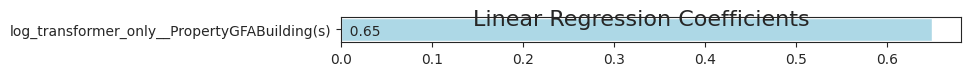

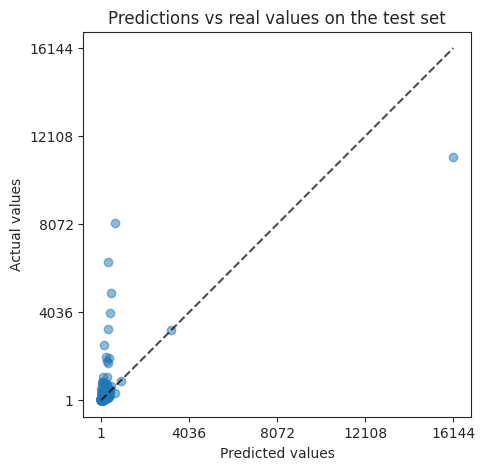

Cross-validation evaluation : 
    scores on folds:  [0.276 0.035 0.194 0.167 0.134]
    mean score:  0.161
    std score deviation:  0.079
Cross-validation evaluation : 
    scores on folds:  [108.736 165.211 133.498 108.783 155.678]
    mean score:  134.381
    std score deviation:  23.314
Cross-validation evaluation : 
    scores on folds:  [ 272.331 1116.466  749.732  305.069  729.887]
    mean score:  634.697
    std score deviation:  314.439
--------------------
 model's pre-processor and target transformer :
    log_transformer_only - uniform_quantile_transformer
--------------------


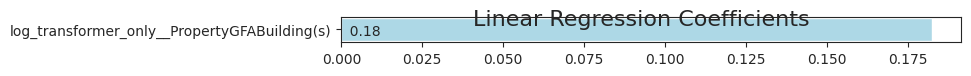

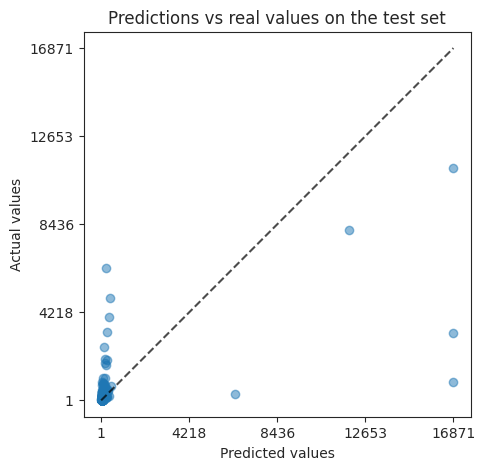

Cross-validation evaluation : 
    scores on folds:  [-56.826  -1.846   0.824 -19.015  -3.397]
    mean score:  -16.052
    std score deviation:  21.532
Cross-validation evaluation : 
    scores on folds:  [459.007 366.742 106.51  244.948 285.207]
    mean score:  292.483
    std score deviation:  118.443
Cross-validation evaluation : 
    scores on folds:  [2433.821 1917.591  349.934 1495.462 1644.504]
    mean score:  1568.262
    std score deviation:  687.991
--------------------
 model's pre-processor and target transformer :
    log_transformer_only - log_transformer
--------------------


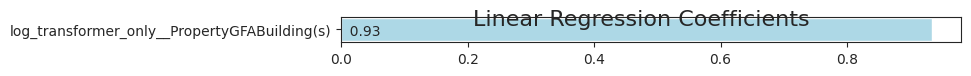

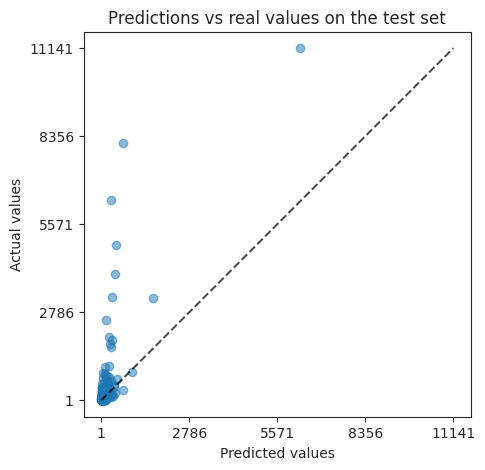

Cross-validation evaluation : 
    scores on folds:  [0.285 0.035 0.178 0.165 0.146]
    mean score:  0.162
    std score deviation:  0.08
Cross-validation evaluation : 
    scores on folds:  [109.436 164.01  134.21  109.725 155.613]
    mean score:  134.598
    std score deviation:  22.621
Cross-validation evaluation : 
    scores on folds:  [ 270.605 1116.498  757.13   305.384  724.771]
    mean score:  634.878
    std score deviation:  315.038
--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - normal_quantile_transformer
--------------------


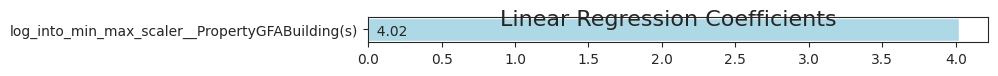

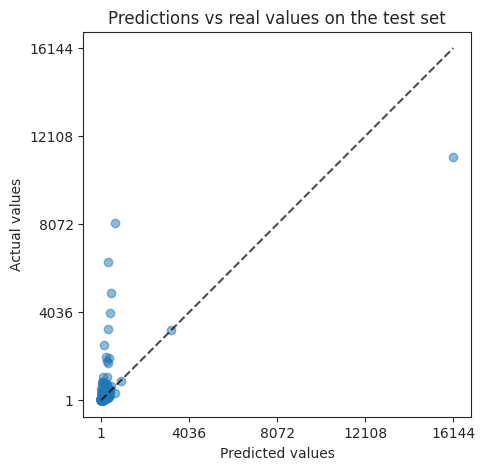

Cross-validation evaluation : 
    scores on folds:  [0.276 0.035 0.194 0.167 0.134]
    mean score:  0.161
    std score deviation:  0.079
Cross-validation evaluation : 
    scores on folds:  [108.736 165.211 133.498 108.783 155.678]
    mean score:  134.381
    std score deviation:  23.314
Cross-validation evaluation : 
    scores on folds:  [ 272.331 1116.466  749.732  305.069  729.887]
    mean score:  634.697
    std score deviation:  314.439
--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - uniform_quantile_transformer
--------------------


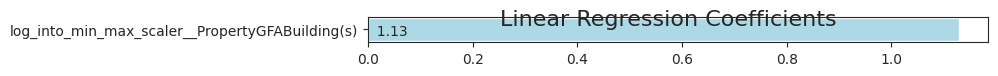

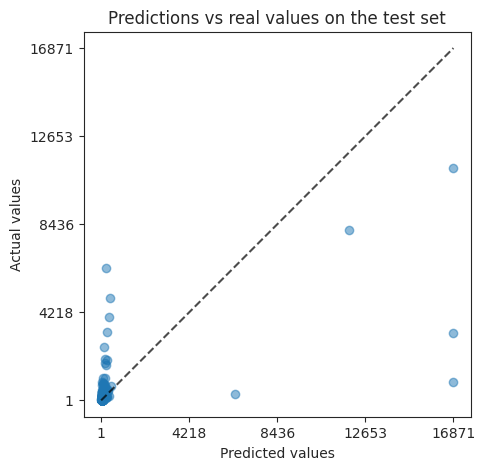

Cross-validation evaluation : 
    scores on folds:  [-56.826  -1.846   0.824 -19.015  -3.397]
    mean score:  -16.052
    std score deviation:  21.532
Cross-validation evaluation : 
    scores on folds:  [459.007 366.742 106.51  244.948 285.207]
    mean score:  292.483
    std score deviation:  118.443
Cross-validation evaluation : 
    scores on folds:  [2433.821 1917.591  349.934 1495.462 1644.504]
    mean score:  1568.262
    std score deviation:  687.991
--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - log_transformer
--------------------


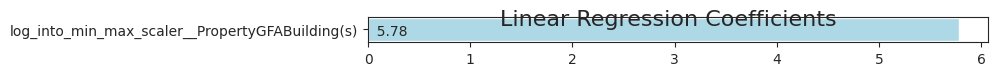

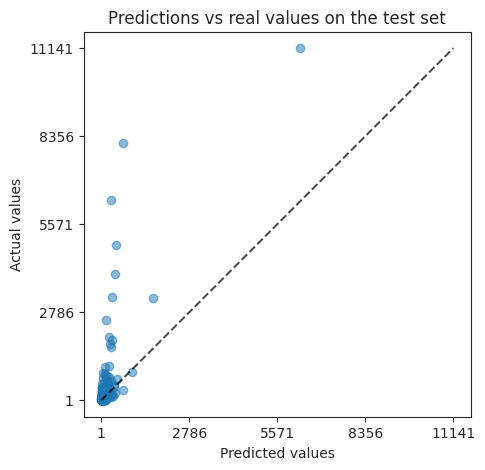

Cross-validation evaluation : 
    scores on folds:  [0.285 0.035 0.178 0.165 0.146]
    mean score:  0.162
    std score deviation:  0.08
Cross-validation evaluation : 
    scores on folds:  [109.436 164.01  134.21  109.725 155.613]
    mean score:  134.598
    std score deviation:  22.621
Cross-validation evaluation : 
    scores on folds:  [ 270.605 1116.498  757.13   305.384  724.771]
    mean score:  634.878
    std score deviation:  315.038
--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - normal_quantile_transformer
--------------------


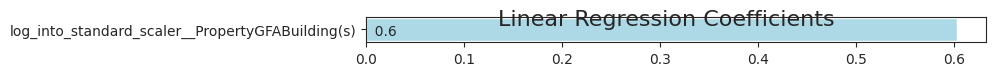

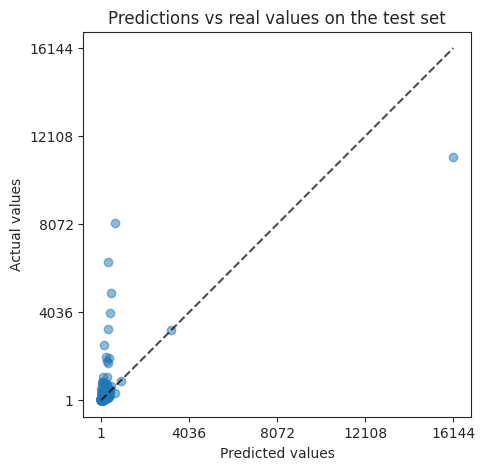

Cross-validation evaluation : 
    scores on folds:  [0.276 0.035 0.194 0.167 0.134]
    mean score:  0.161
    std score deviation:  0.079
Cross-validation evaluation : 
    scores on folds:  [108.736 165.211 133.498 108.783 155.678]
    mean score:  134.381
    std score deviation:  23.314
Cross-validation evaluation : 
    scores on folds:  [ 272.331 1116.466  749.732  305.069  729.887]
    mean score:  634.697
    std score deviation:  314.439
--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - uniform_quantile_transformer
--------------------


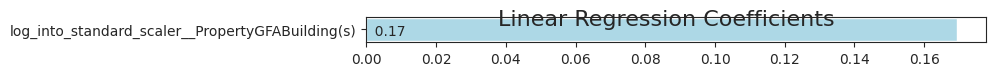

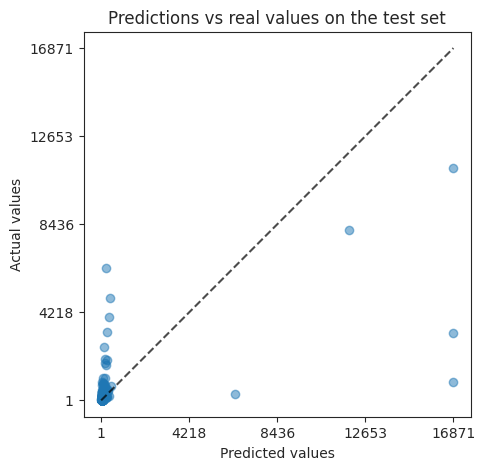

Cross-validation evaluation : 
    scores on folds:  [-56.826  -1.846   0.824 -19.015  -3.397]
    mean score:  -16.052
    std score deviation:  21.532
Cross-validation evaluation : 
    scores on folds:  [459.007 366.742 106.51  244.948 285.207]
    mean score:  292.483
    std score deviation:  118.443
Cross-validation evaluation : 
    scores on folds:  [2433.821 1917.591  349.934 1495.462 1644.504]
    mean score:  1568.262
    std score deviation:  687.991
--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - log_transformer
--------------------


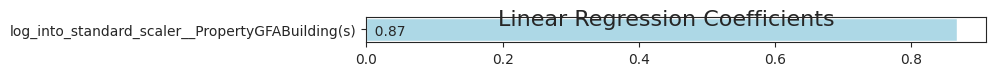

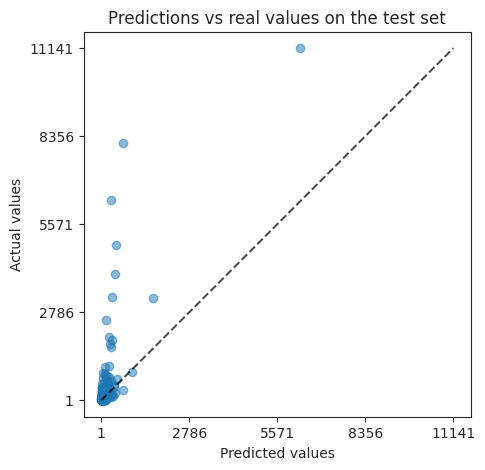

Cross-validation evaluation : 
    scores on folds:  [0.285 0.035 0.178 0.165 0.146]
    mean score:  0.162
    std score deviation:  0.08
Cross-validation evaluation : 
    scores on folds:  [109.436 164.01  134.21  109.725 155.613]
    mean score:  134.598
    std score deviation:  22.621
Cross-validation evaluation : 
    scores on folds:  [ 270.605 1116.498  757.13   305.384  724.771]
    mean score:  634.878
    std score deviation:  315.038
--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - normal_quantile_transformer
--------------------


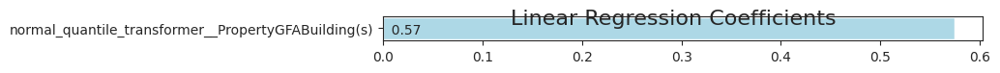

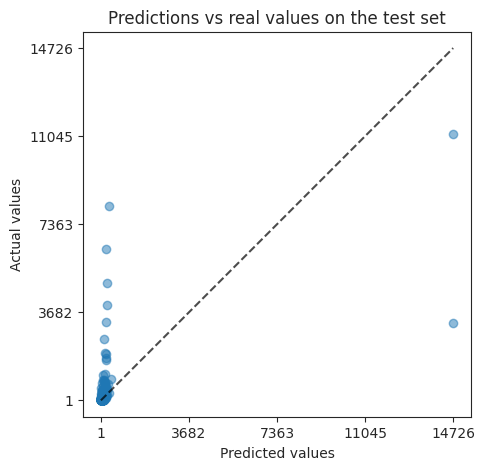

Cross-validation evaluation : 
    scores on folds:  [0.169 0.015 0.929 0.097 0.055]
    mean score:  0.253
    std score deviation:  0.342
Cross-validation evaluation : 
    scores on folds:  [107.693 161.08   93.36  107.641 156.079]
    mean score:  125.17
    std score deviation:  27.819
Cross-validation evaluation : 
    scores on folds:  [ 291.676 1127.998  222.916  317.645  762.149]
    mean score:  544.477
    std score deviation:  348.322
--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - uniform_quantile_transformer
--------------------


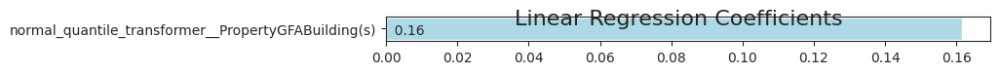

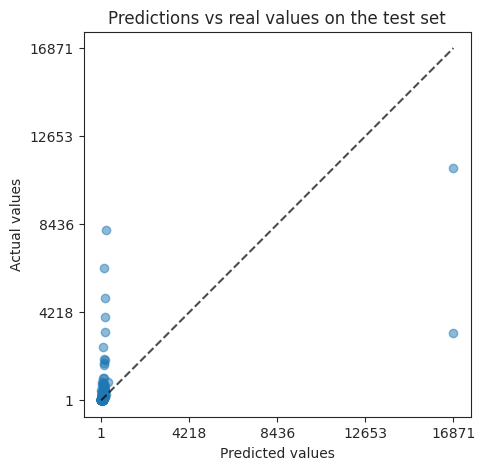

Cross-validation evaluation : 
    scores on folds:  [0.104 0.003 0.823 0.045 0.033]
    mean score:  0.202
    std score deviation:  0.313
Cross-validation evaluation : 
    scores on folds:  [111.573 166.025 105.502 109.134 159.139]
    mean score:  130.275
    std score deviation:  26.539
Cross-validation evaluation : 
    scores on folds:  [ 302.943 1135.282  350.968  326.628  771.342]
    mean score:  577.433
    std score deviation:  328.125
--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - log_transformer
--------------------


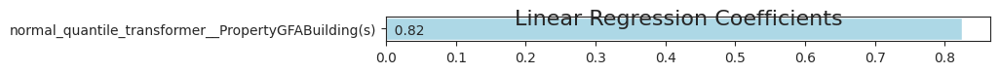

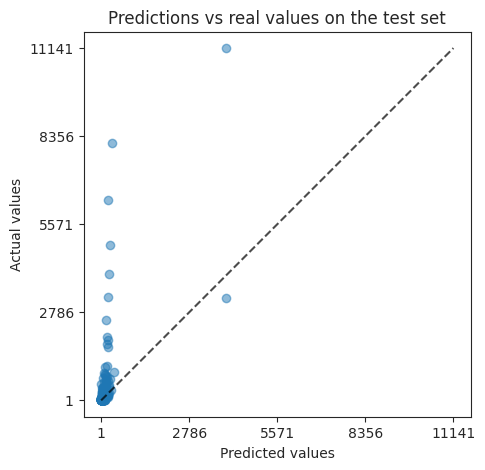

Cross-validation evaluation : 
    scores on folds:  [0.172 0.014 0.491 0.095 0.055]
    mean score:  0.165
    std score deviation:  0.171
Cross-validation evaluation : 
    scores on folds:  [107.76  161.43  121.812 108.035 156.76 ]
    mean score:  131.16
    std score deviation:  23.415
Cross-validation evaluation : 
    scores on folds:  [ 291.304 1128.766  596.027  318.017  762.424]
    mean score:  619.308
    std score deviation:  309.495
--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - normal_quantile_transformer
--------------------


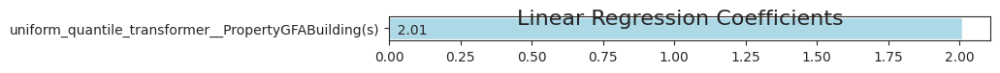

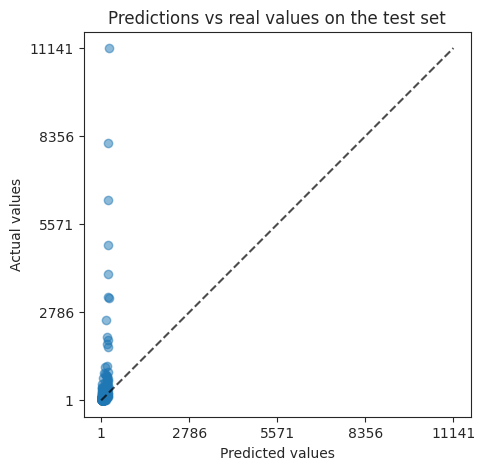

Cross-validation evaluation : 
    scores on folds:  [0.114 0.008 0.025 0.09  0.026]
    mean score:  0.053
    std score deviation:  0.042
Cross-validation evaluation : 
    scores on folds:  [113.349 165.149 137.11  108.876 160.225]
    mean score:  136.942
    std score deviation:  23.161
Cross-validation evaluation : 
    scores on folds:  [ 301.223 1132.038  824.914  318.836  774.142]
    mean score:  670.231
    std score deviation:  318.633
--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - uniform_quantile_transformer
--------------------


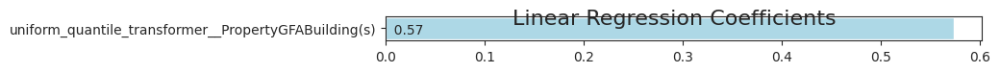

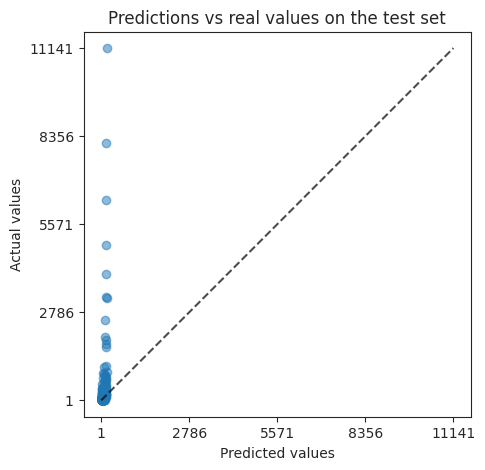

Cross-validation evaluation : 
    scores on folds:  [ 0.044 -0.002  0.009  0.042  0.008]
    mean score:  0.02
    std score deviation:  0.019
Cross-validation evaluation : 
    scores on folds:  [117.019 169.593 138.558 110.005 161.828]
    mean score:  139.4
    std score deviation:  23.581
Cross-validation evaluation : 
    scores on folds:  [ 312.888 1137.651  831.394  327.108  781.097]
    mean score:  678.028
    std score deviation:  316.818
--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - log_transformer
--------------------


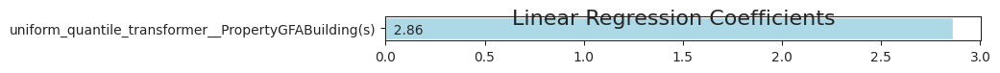

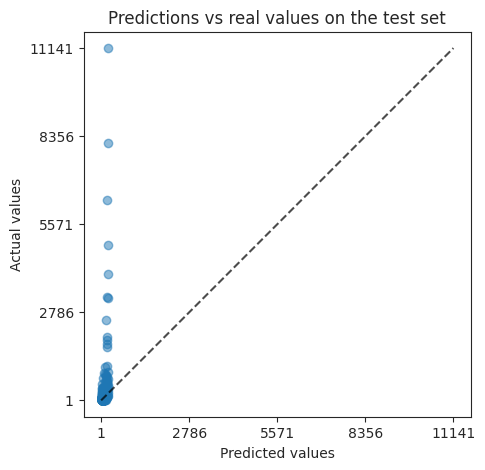

Cross-validation evaluation : 
    scores on folds:  [0.102 0.008 0.022 0.084 0.023]
    mean score:  0.048
    std score deviation:  0.038
Cross-validation evaluation : 
    scores on folds:  [114.315 165.642 137.606 109.552 160.813]
    mean score:  137.586
    std score deviation:  23.039
Cross-validation evaluation : 
    scores on folds:  [ 303.27  1132.336  825.926  319.846  775.04 ]
    mean score:  671.284
    std score deviation:  318.18


In [52]:
show_plot = True
show_regressor_input = False
show_scores = False
silent = False

for pp in pre_processors:
    # Define the model
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("regressor", instantiate_regressor(regr)),
        ]
    )
    
    for transformer_name in transformers.keys():
        
        full_model = TransformedTargetRegressor(
            regressor=model,
            transformer=transformers[transformer_name]
        )
        print('-' * 20)
        print(
                f" model's pre-processor and target transformer :\n    "
                f"{pp.transformers_[0][0]}"
                f" - {transformer_name}"
        )
        
        # Fine tuning the full_model, if there is hyperparameters grid search.
        if regr.params_grid is not None:
            pass
        else:
            hyperparameters = None
            
        print('-'*20)
        
        # Fit the full_model and predict on both train and test sets.
        computation_time = np.NaN # Will have to investigate timeit
        full_model.fit(X_train, y_train)
        pred_train =  full_model.predict(X_train)
        pred_test =  full_model.predict(X_test)
        # save the model
        models_idx += 1
        models.append(full_model)
        
        if show_plot:
            # Observing the coefficients of the regression model
            ds.linearRegressionSummary(
                full_model.regressor_["regressor"],
                full_model.regressor_[:-1].get_feature_names_out()
            )
            
            # displaying predictions vs real values
            _, ax = plt.subplots(figsize=(5, 5))
            _ = PredictionErrorDisplay.from_predictions(
                y_test, pred_test, kind="actual_vs_predicted",
                ax=ax, scatter_kwargs={"alpha": 0.5}
            )
            ax.set_title("Predictions vs real values on the test set")
            plt.show()

        if show_regressor_input:
            # displaying the inputs after the preprocessing stage
            pre_processed_inputs = pd.DataFrame(
                full_model.regressor_[:-1].transform(X_train), 
                index=X_train.index,
                columns=full_model.regressor_[:-1].get_feature_names_out()
            )
            display(pre_processed_inputs)
            
        
        # evaluating according several metrics 
        for i, metric in metrics.iterrows():
            
            cv_output = ds.CV_evaluation(
                full_model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0, silent=silent
            )
            
            # Compute and print scores.
            score_train = apply_score_func(metric, y_train, pred_train)
            score_test = apply_score_func(metric, y_test, pred_test)
            if show_scores:
                print(f"\nTrain score : {score_train}")
                print(f"\nTest score : {score_test}")   

            # add to results
            results.append(
                [
                    cv_output[1],
                    cv_output[2],
                    score_test,
                    computation_time,
                    hyperparameters,
                    cv_output[0],
                    score_train,
                    str(
                        full_model.regressor_.named_steps['regressor']
                    ).rstrip("()"),
                    list(
                        full_model.regressor_['pre_processor']
                        .named_transformers_
                        .keys()
                    )[0],
                    metric.name,
                    transformer_name,
                    models_idx
                            
                ]
            )
        
        
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results = pd.DataFrame(
results, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    

In [53]:
(
    df_results
    .sort_values(["metric", "CV_train_score_mean"])
    .style.format("{:.3f}", subset="CV_train_score_mean")
)

In [54]:
f_col = "CV_train_score_mean"
for i, metric in metrics.iterrows():
    tdf = df_results.loc[df_results
                         .index
                         .get_level_values('metric') == metric.name]    
    display(
        tdf
        .sort_values(["metric", f_col])
        # .iloc[:10, :]
        .style.format("{:.3f}", f_col)
        .background_gradient(
            cmap="Blues",
            subset=[
                "CV_train_score_mean",
                "CV_train_score_std",
                "test_score"
            ]
        )
    )

From those first results, whatever the metric, we can see a slight improvement when using a log transformer on both the input and the target. 

A direct regression gave decent results too. Much better than the dummy regressor.

### 3.3.3.  [&#9650;](#toc0_) <a id='toc3_3_3_'></a>Comparing 2 models among the bests.

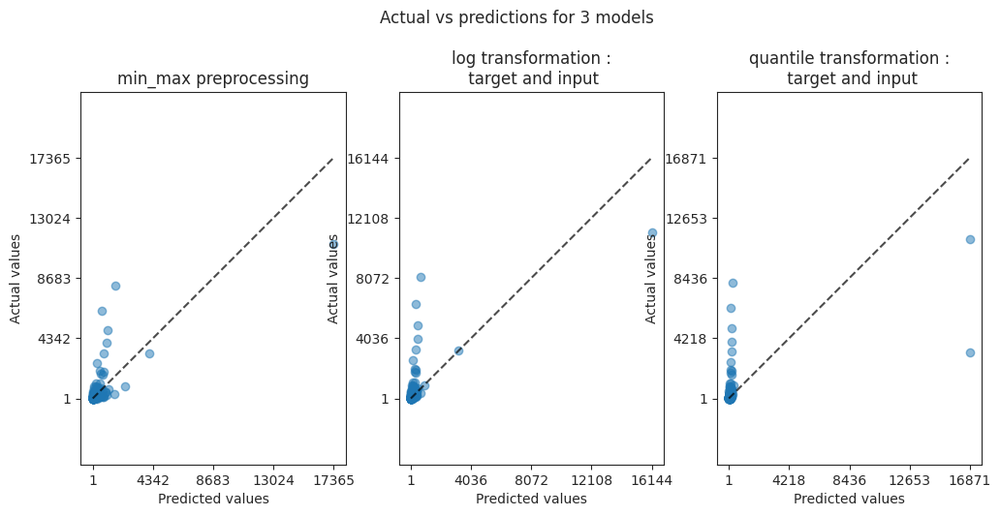

In [65]:
# Getting index visually
idxs = [2, 17, 24]
titles = [
    'min_max preprocessing',
    'log transformation :\n target and input',
    'quantile transformation :\n target and input'
]
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="actual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    eval(this_ax).set_title(titles[n])
fig.suptitle('Actual vs predictions for 3 models', y=1.05)
plt.show()
    

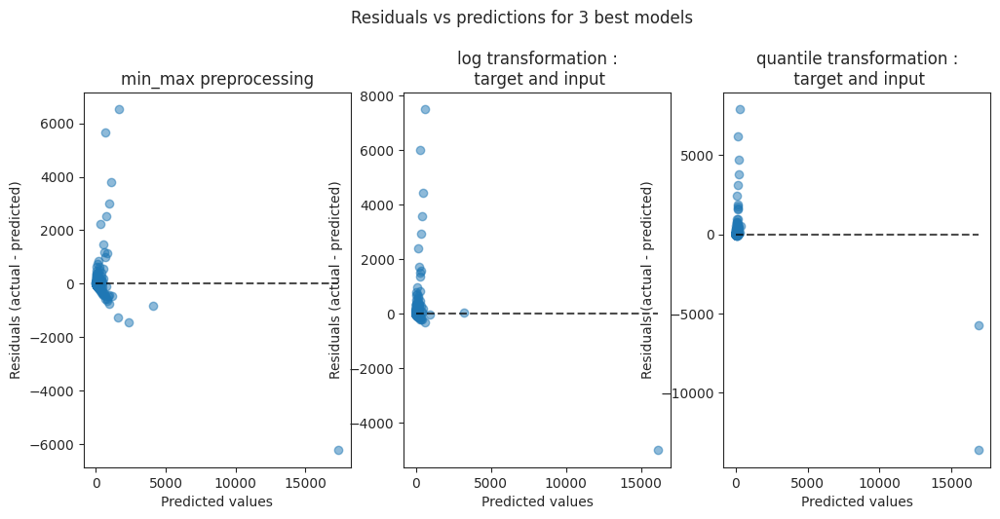

In [67]:
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="residual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    eval(this_ax).set_title(titles[n])
fig.suptitle('Residuals vs predictions for 3 best models', y=1.05)
plt.show()

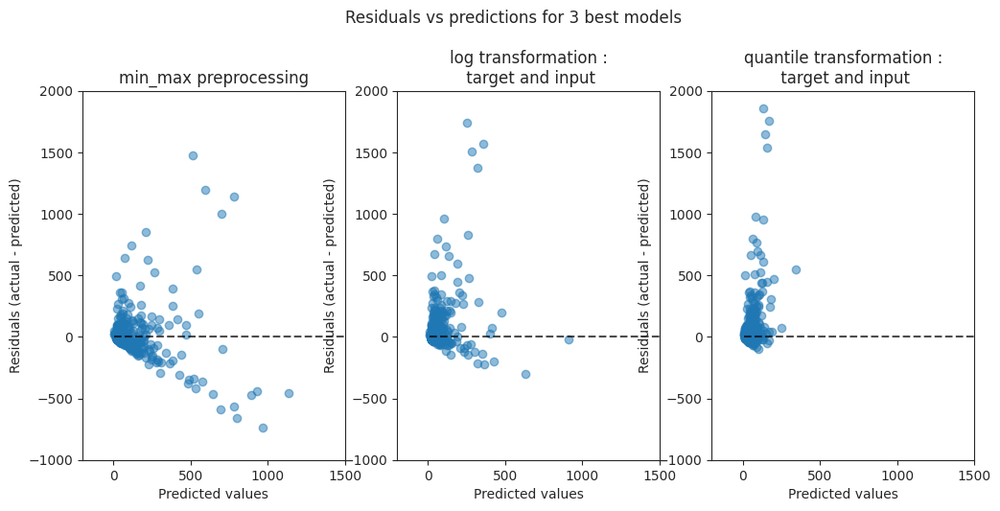

In [77]:
# Zoom to see "well predicted values".
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="residual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    eval(this_ax).axis([-200, 1500, -1000, 2000])
    eval(this_ax).set_title(titles[n])
fig.suptitle('Residuals vs predictions for 3 best models', y=1.05)
plt.show()

It seems that with transformations, we manage to limit/ almost avoid over-estimation as seen in the first plot. With the quantile transformation, under-estimation are reduced.

Nevertheless, with the quantile transformation, there are two enormous over-estimations.

In [78]:
# Printing some almost 'non-emitters' which were predicted as huge emitters
# (over-estimated) with the quantile transformation model.
pred_test = models[24].predict(X_test)
display(data.loc[X_test.loc[(y_test-pred_test) < -5000].index])
display(X.loc[X_test.loc[(y_test-pred_test) < -5000].index])

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity,Age,ProportionPrincipalUseType,ProportionSecondaryUseType,ProportionThirdUseType,RiseType,AgeType,energies_sum,energy_ratio,SteamUseProportion,ElectricityProportion,NaturalGasProportion,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K12School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_LargeOffice,PrimaryPropertyType_MedicalOffice,PrimaryPropertyType_MixedUseProperty,PrimaryPropertyType_Other,PrimaryPropertyType_RefrigeratedWarehouse,PrimaryPropertyType_ResidenceHall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_RetailStore,PrimaryPropertyType_SelfStorageFacility,PrimaryPropertyType_SeniorCareCommunity,PrimaryPropertyType_SmallandMidSizedOffice,PrimaryPropertyType_SupermarketGroceryStore,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_WorshipFacility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
22062,Campus,University,Entire Campus,901 12th Avenue,Seattle,WA,98122.0,2254500880,3,EAST,47.61065,-122.31711,1939,1,2,2200000,0,2200000,"College/University, Parking",College/University,1719643.0,Parking,318960.0,NaN,NaN,NaN,NaN,66.699997,71.599998,145.000000,151.300003,114648520.0,123205560.0,0.0,61672821.0,52975694.0,Compliant,NaN,3243.48,1.47,84,0.781656,0.144982,NaN,Low,Old,114648515.0,1.000000,0.0,0.54,0.46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
49967,Campus,University,University of Washington - Seattle Campus,NE 45th St & Brooklyn Ave,Seattle,WA,98105.0,1625049001,4,NORTHEAST,47.65644,-122.31041,1900,111,0,9320156,0,9320156,College/University,College/University,9320156.0,NaN,NaN,NaN,NaN,NaN,NaN,93.800003,0.000000,246.600006,0.000000,873923712.0,0.0,84985240.0,657074389.0,0.0,Compliant,NaN,11140.56,1.20,123,1.000000,NaN,NaN,NaN,Very_old,742059629.0,0.849113,0.1,0.75,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


,PropertyGFABuilding(s),Age,NumberofBuildings,NumberofFloors,SteamUseProportion,ElectricityProportion,NaturalGasProportion,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K12School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_LargeOffice,PrimaryPropertyType_MedicalOffice,PrimaryPropertyType_MixedUseProperty,PrimaryPropertyType_Other,PrimaryPropertyType_RefrigeratedWarehouse,PrimaryPropertyType_ResidenceHall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_RetailStore,PrimaryPropertyType_SelfStorageFacility,PrimaryPropertyType_SeniorCareCommunity,PrimaryPropertyType_SmallandMidSizedOffice,PrimaryPropertyType_SupermarketGroceryStore,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_WorshipFacility
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,
22062,2200000,84,1,2,0.0,0.54,0.46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
49967,9320156,123,111,0,0.1,0.75,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [68]:
# Printing points under-estimated
pred_test = models[17].predict(X_test)
data.loc[X_test.loc[abs(pred_test - y_test)> 1500].index]

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity,Age,ProportionPrincipalUseType,ProportionSecondaryUseType,ProportionThirdUseType,RiseType,AgeType,energies_sum,energy_ratio,SteamUseProportion,ElectricityProportion,NaturalGasProportion,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K12School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_LargeOffice,PrimaryPropertyType_MedicalOffice,PrimaryPropertyType_MixedUseProperty,PrimaryPropertyType_Other,PrimaryPropertyType_RefrigeratedWarehouse,PrimaryPropertyType_ResidenceHall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_RetailStore,PrimaryPropertyType_SelfStorageFacility,PrimaryPropertyType_SeniorCareCommunity,PrimaryPropertyType_SmallandMidSizedOffice,PrimaryPropertyType_SupermarketGroceryStore,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_WorshipFacility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
198,NonResidential,Hospital,Seattle Children's Hospital Main Campus,4800 Sand Point Way NE,Seattle,WA,98105.0,2982800005,4,NORTHEAST,47.66231,-122.28146,1953,6,10,879000,0,879000,Hospital (General Medical & Surgical),Hospital (General Medical & Surgical),879000.0,NaN,NaN,NaN,NaN,NaN,10.0,288.799988,293.200012,578.200012,576.599976,253832464.0,257764208.0,0.0,115641210.0,138191238.0,Compliant,NaN,8145.52,9.27,70,1.000000,NaN,NaN,Medium,Old,253832448.0,1.000000,0.00,0.46,0.54,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
45927,NonResidential,Laboratory,Reasearch and Training Building,300 Ninth Avenue,Seattle,WA,98104.0,8590900220,3,EAST,47.60427,-122.32311,2000,1,8,178000,0,178000,Laboratory,Laboratory,181930.0,NaN,NaN,NaN,NaN,NaN,NaN,292.200012,302.700012,587.200012,594.400024,53166156.0,55068016.0,31030194.0,22135959.0,0.0,Compliant,NaN,2549.47,14.32,23,1.022079,NaN,NaN,Medium,Modern,53166153.0,1.000000,0.58,0.42,0.00,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
753,NonResidential,Other,WestinBuilding,2001 6th Ave,Seattle,WA,98121.0,0659000950,7,DOWNTOWN,47.61438,-122.33871,1981,1,33,429405,0,429405,"Data Center, Office",Data Center,218997.0,Office,210409.0,NaN,NaN,NaN,98.0,639.700012,639.799988,2007.900024,2008.000000,274682208.0,274725984.0,0.0,274532495.0,149672.0,Compliant,NaN,1921.82,4.48,42,0.510001,0.490001,NaN,High,Modern,274682167.0,1.000000,0.00,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
49967,Campus,University,University of Washington - Seattle Campus,NE 45th St & Brooklyn Ave,Seattle,WA,98105.0,1625049001,4,NORTHEAST,47.65644,-122.31041,1900,111,0,9320156,0,9320156,College/University,College/University,9320156.0,NaN,NaN,NaN,NaN,NaN,NaN,93.800003,0.000000,246.600006,0.000000,873923712.0,0.0,84985240.0,657074389.0,0.0,Compliant,NaN,11140.56,1.20,123,1.000000,NaN,NaN,NaN,Very_old,742059629.0,0.849113,0.10,0.75,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
23071,NonResidential,Hospital,Main Hospital - All Wings,Facilities Management MS: B-1

Hospitals and Uni are the one messing up apparently.

### 3.3.4.  [&#9650;](#toc0_) <a id='toc3_3_4_'></a>Saving results

In [79]:
!mkdir -p GHG_predictions_models_and_results/basic_models

In [80]:
# Save scores of basic models
dir_path = "./GHG_predictions_models_and_results/basic_models"
df_results.to_csv(dir_path + "/scores.csv")

# 4.  [&#9650;](#toc0_) <a id='toc4_'></a>Linear regressions with more inputs.

## 4.1.  [&#9650;](#toc0_) <a id='toc4_1_'></a>Defining the pre-processors relatively to inputs

In [36]:
# features with a skewed distribution
fts_to_transform = [
    'PropertyGFABuilding(s)',
    'NumberofBuildings',
    'NumberofFloors'
]
fts_to_scale_only = ['Age']

# Already pre_processed
fts_passthrough = [
    'PrimaryPropertyType_Hospital',
    'PrimaryPropertyType_Hotel',
    'PrimaryPropertyType_K12School',
    'PrimaryPropertyType_Laboratory',
    'PrimaryPropertyType_LargeOffice',
    'PrimaryPropertyType_MedicalOffice',
    'PrimaryPropertyType_MixedUseProperty',
    'PrimaryPropertyType_Other',
    'PrimaryPropertyType_RefrigeratedWarehouse',
    'PrimaryPropertyType_ResidenceHall',
    'PrimaryPropertyType_Restaurant',
    'PrimaryPropertyType_RetailStore',
    'PrimaryPropertyType_SelfStorageFacility',
    'PrimaryPropertyType_SeniorCareCommunity',
    'PrimaryPropertyType_SmallandMidSizedOffice',
    'PrimaryPropertyType_SupermarketGroceryStore',
    'PrimaryPropertyType_University',
    'PrimaryPropertyType_Warehouse',
    'PrimaryPropertyType_WorshipFacility',
    'SteamUseProportion',
    'ElectricityProportion',
    'NaturalGasProportion'
]

pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

for pp in pre_processors:
    display(pp)

ColumnTransformer(transformers=[('min_max_scaler', MinMaxScaler(),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors', 'Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPropertyType_K12School',
                                  'PrimaryPropertyType_Laboratory',
                                  'PrimaryPropertyType_LargeOffice',
                                  'PrimaryPropertyType_Medic...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('standard_scaler', StandardScaler(),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors', 'Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPropertyType_K12School',
                                  'PrimaryPropertyType_Laboratory',
                                  'PrimaryPropertyType_LargeOffice',
                                  'PrimaryPropertyType_Me...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_transformer_only',
                                 FunctionTransformer(feature_names_out='one-to-one',
                                                     func=<ufunc 'log1p'>,
                                                     inverse_func=<ufunc 'expm1'>),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors', 'Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPropertyType_K12School',
                                  'P...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthroug...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_into_standard_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  StandardScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('standard_scaler', StandardScaler(), ['Age']),
                                ('pass...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('normal_quantile_transformer',
                                 QuantileTransformer(n_quantiles=100,
                                                     output_distribution='normal',
                                                     random_state=0),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPr...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('uniform_quantile_transformer',
                                 QuantileTransformer(n_quantiles=100,
                                                     random_state=0),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPropertyType_K12School',
                                  'Prima...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

## 4.2.  [&#9650;](#toc0_) <a id='toc4_2_'></a>fitting models

--------------------
 model's pre-processor:
    min_max_scaler
--------------------


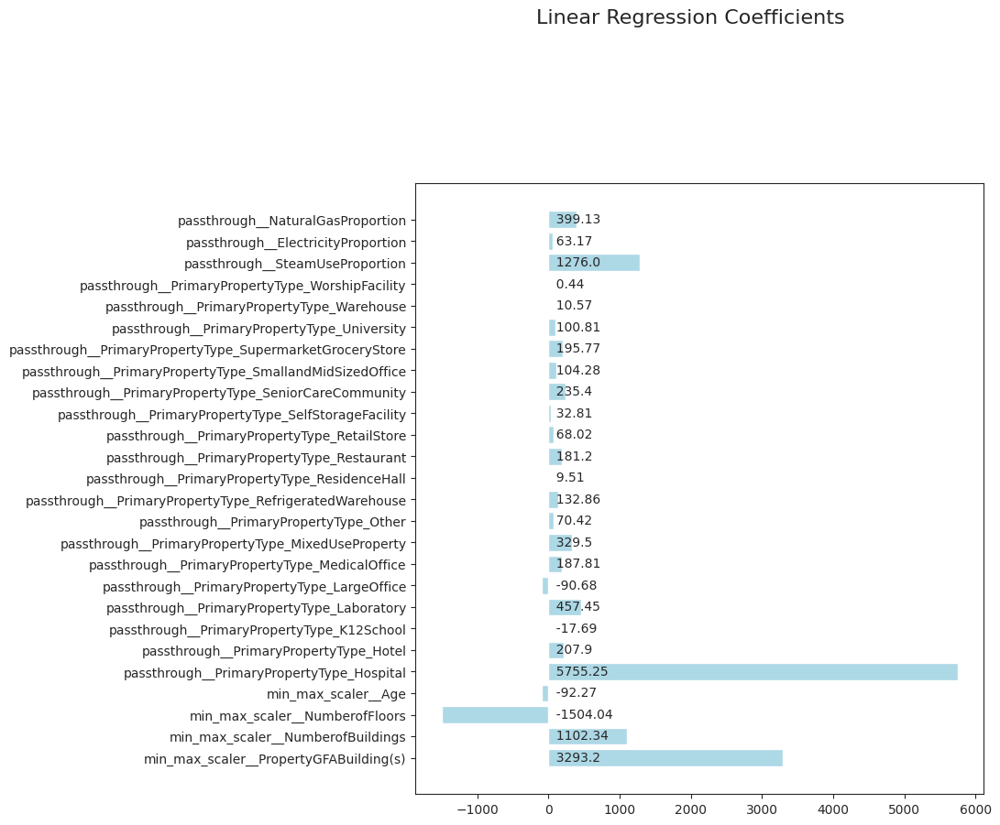

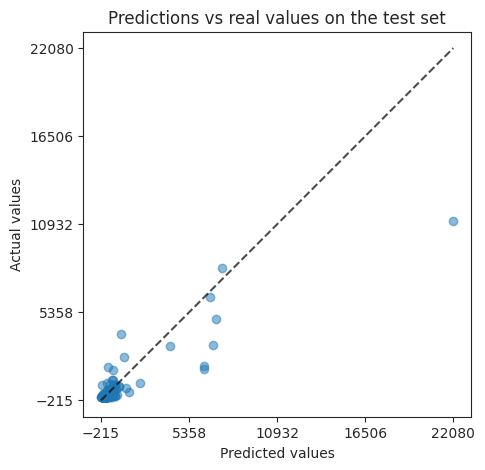

--------------------
 model's pre-processor:
    standard_scaler
--------------------


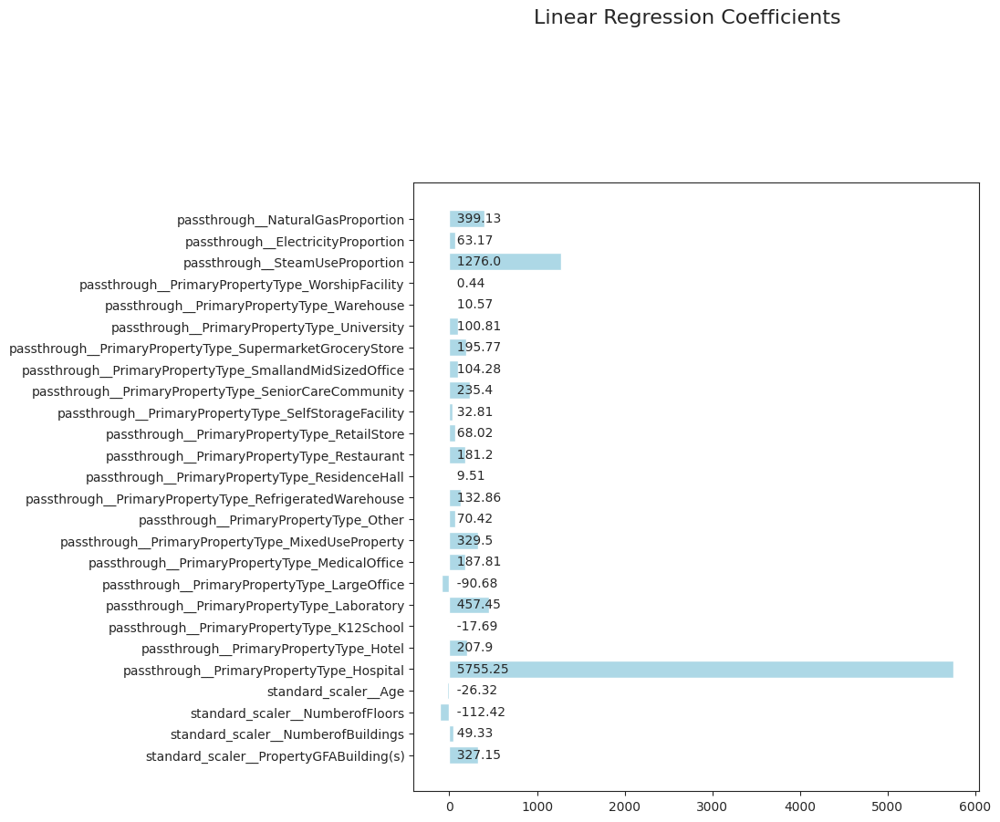

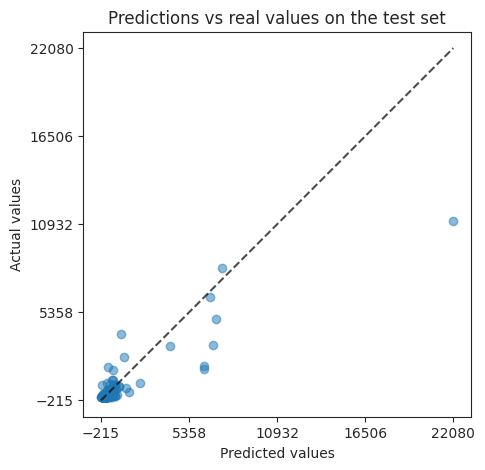

--------------------
 model's pre-processor:
    log_transformer_only
--------------------


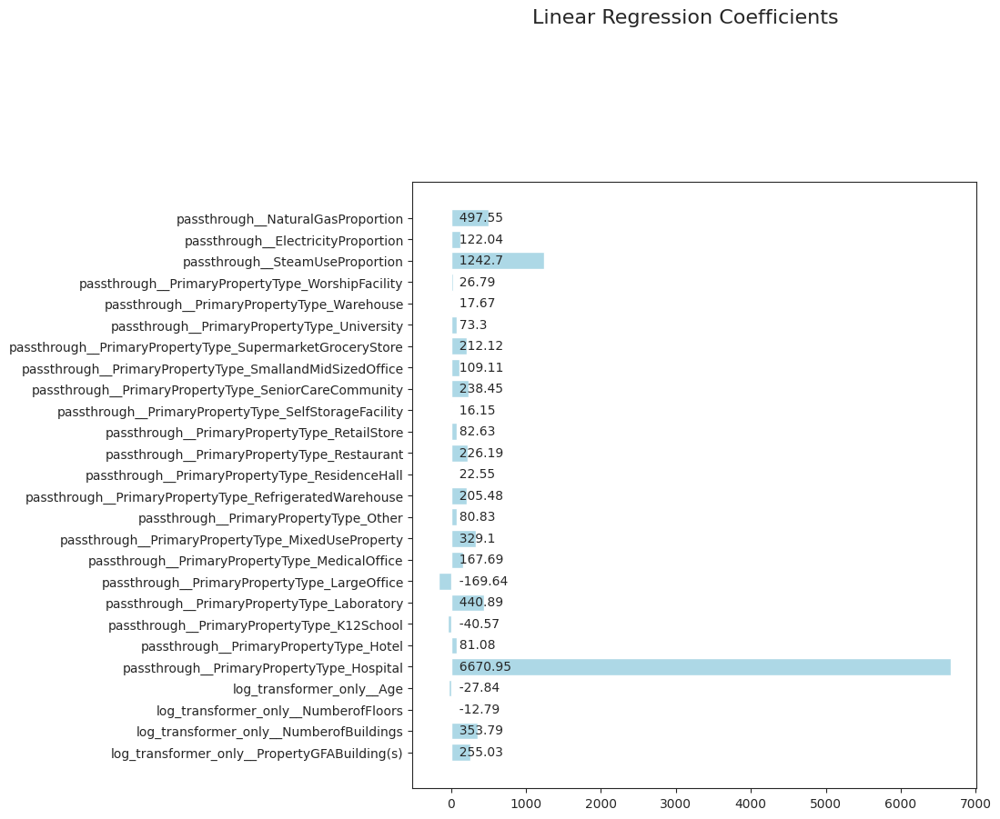

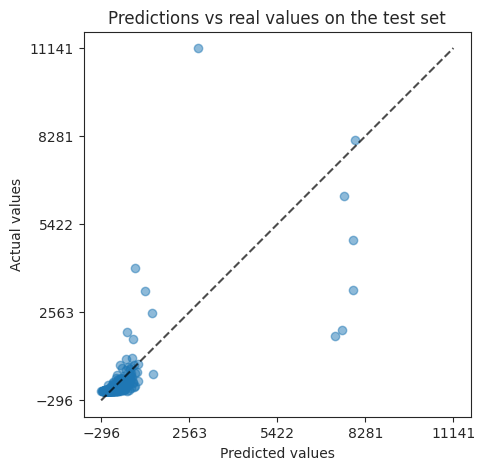

--------------------
 model's pre-processor:
    log_into_min_max_scaler
--------------------


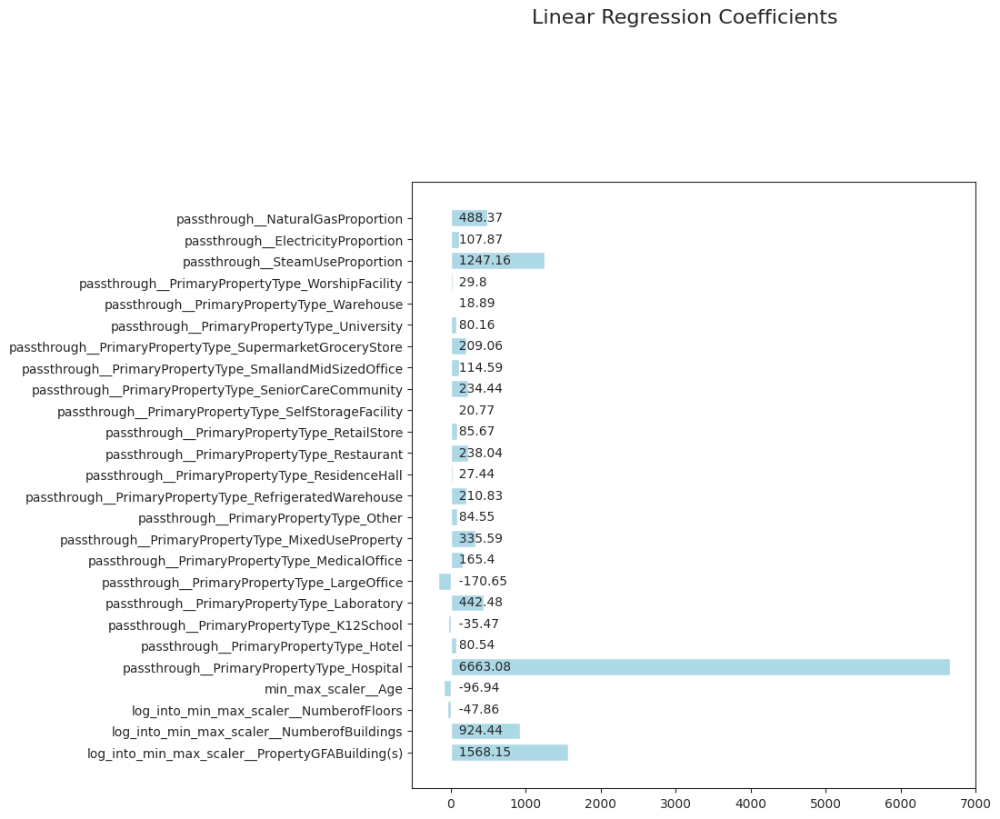

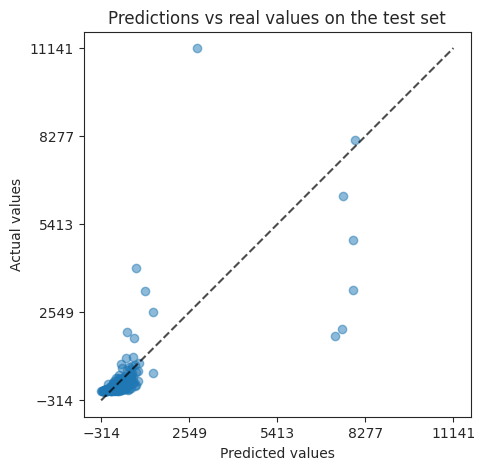

--------------------
 model's pre-processor:
    log_into_standard_scaler
--------------------


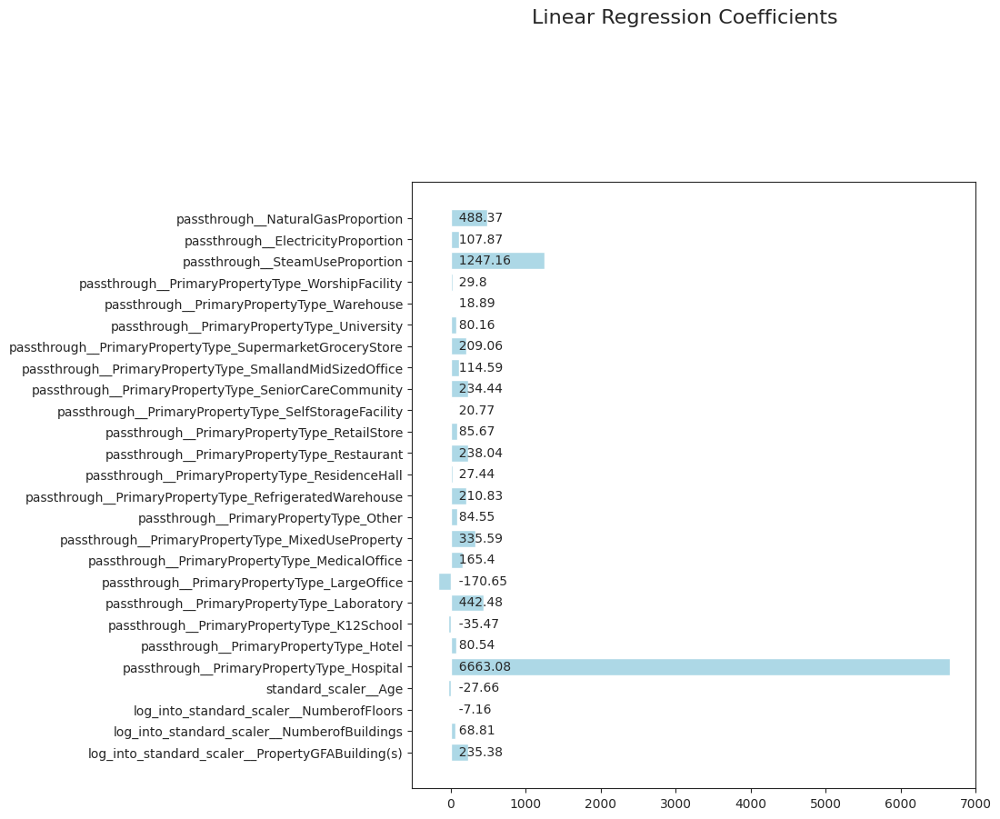

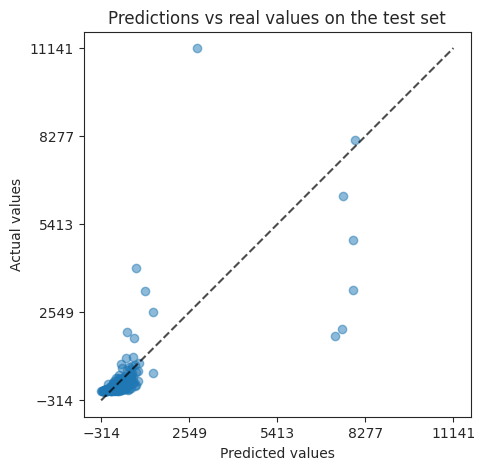

--------------------
 model's pre-processor:
    normal_quantile_transformer
--------------------


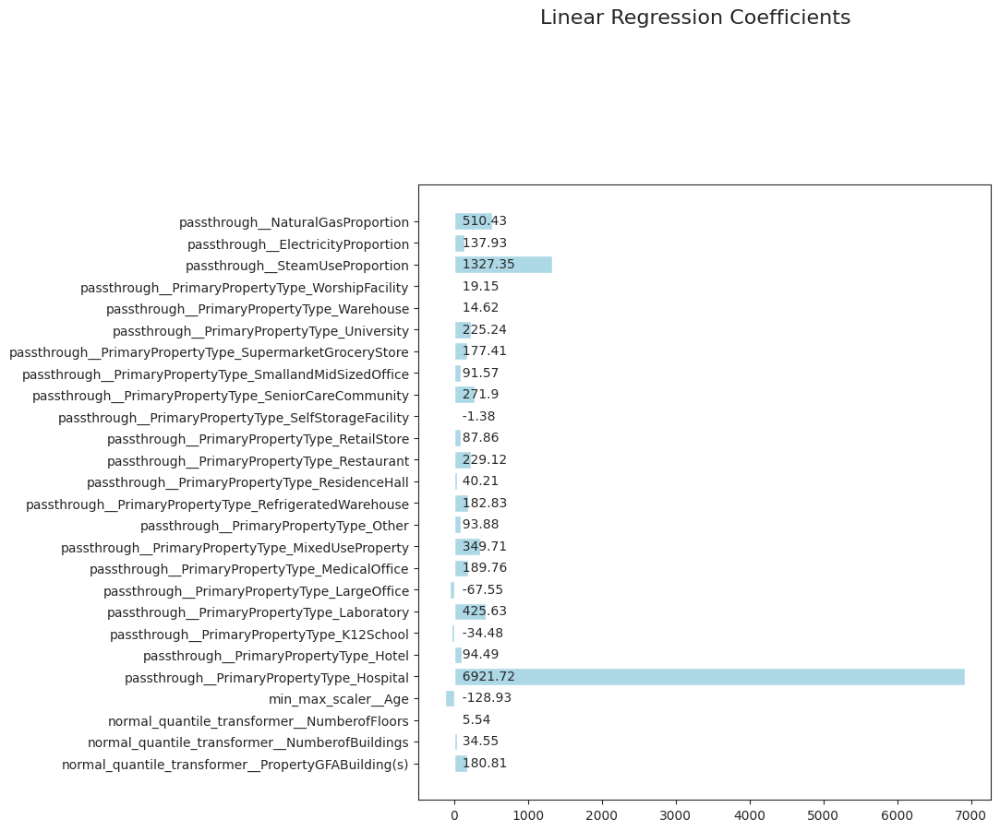

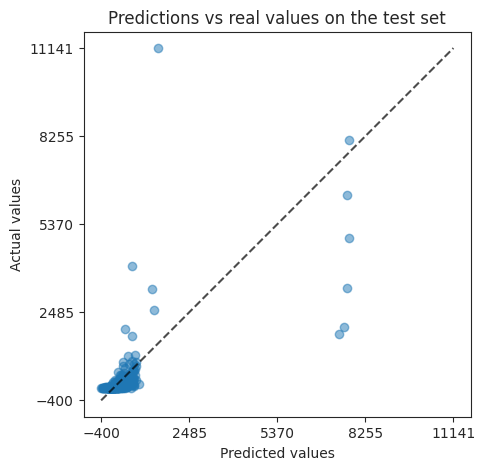

--------------------
 model's pre-processor:
    uniform_quantile_transformer
--------------------


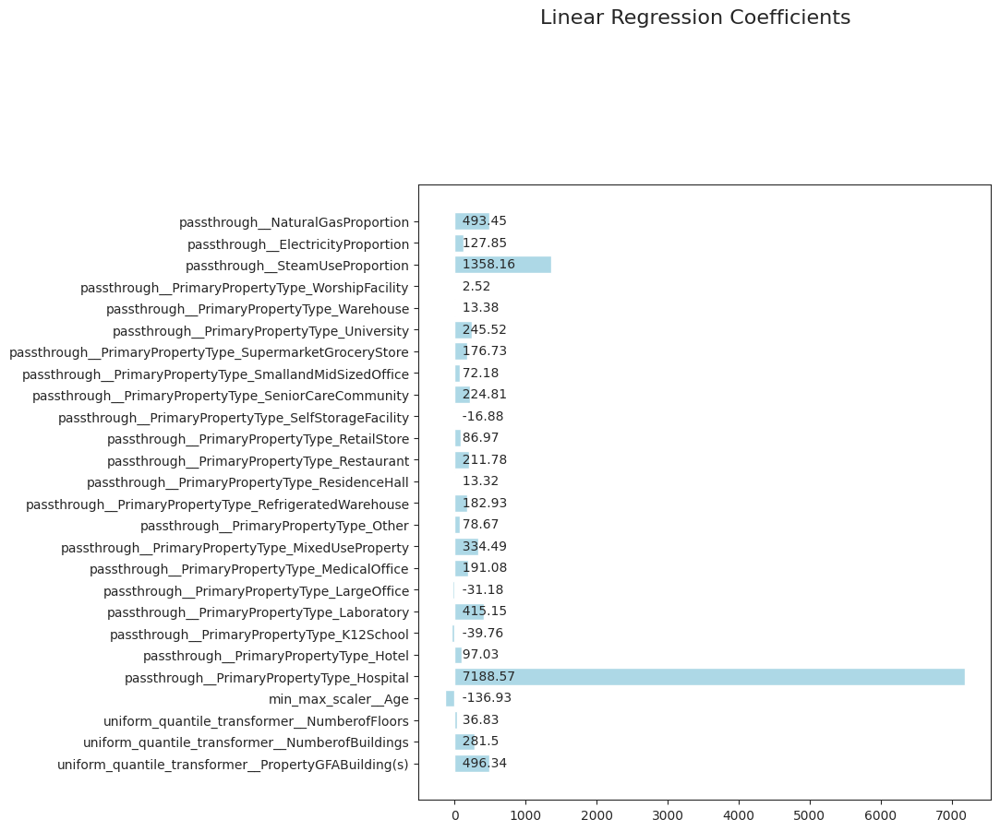

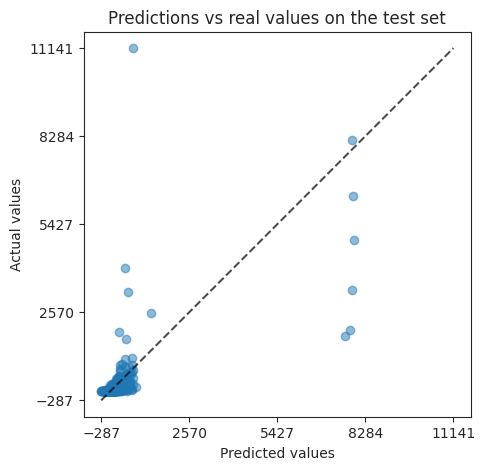

--------------------
 model's pre-processor and target transformer :
    min_max_scaler - normal_quantile_transformer
--------------------


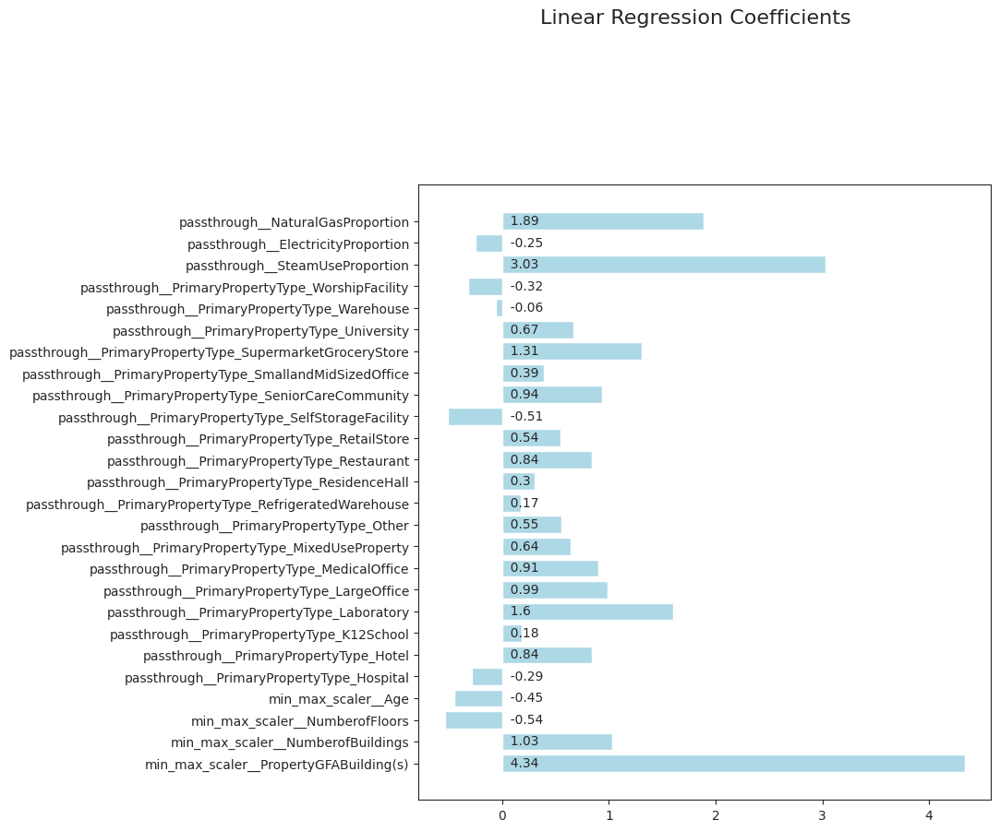

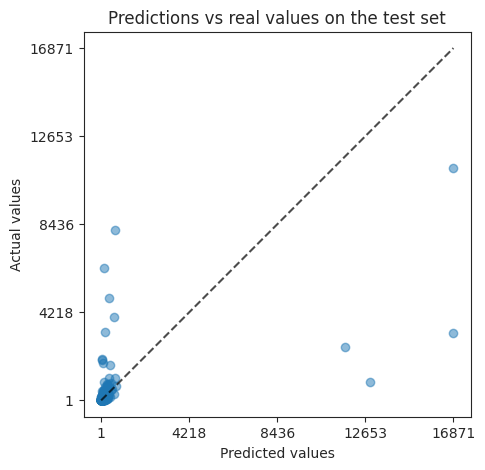

--------------------
 model's pre-processor and target transformer :
    min_max_scaler - uniform_quantile_transformer
--------------------


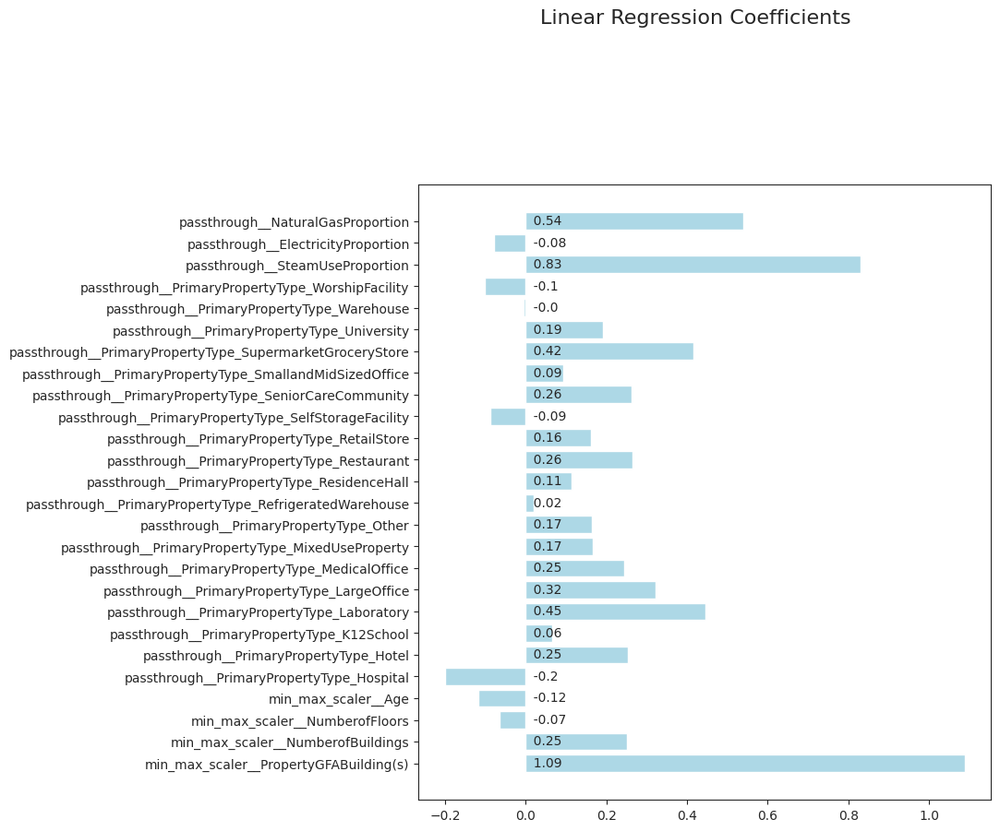

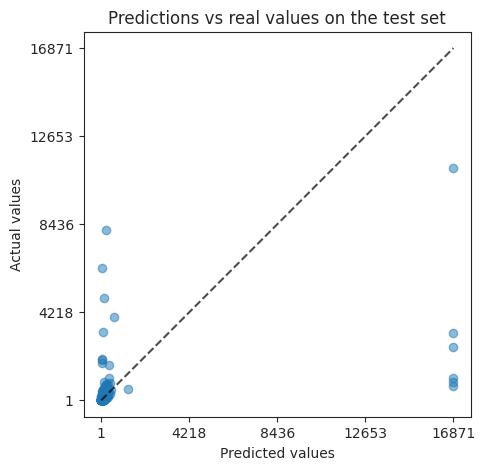

--------------------
 model's pre-processor and target transformer :
    min_max_scaler - log_transformer
--------------------


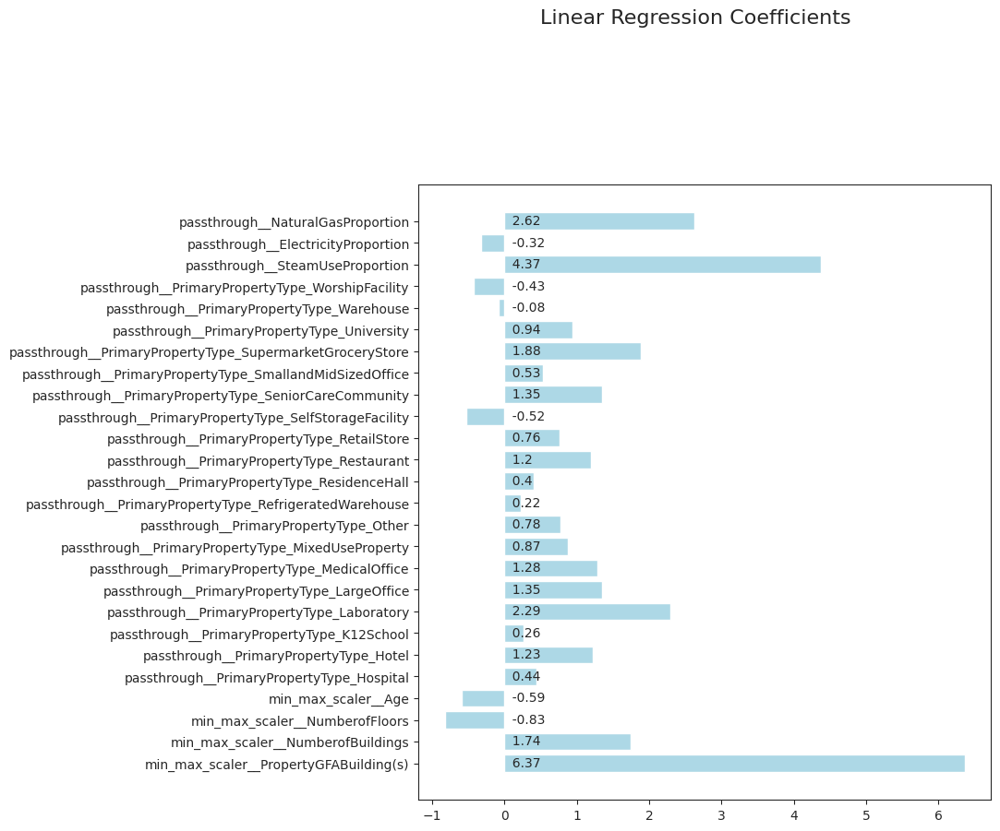

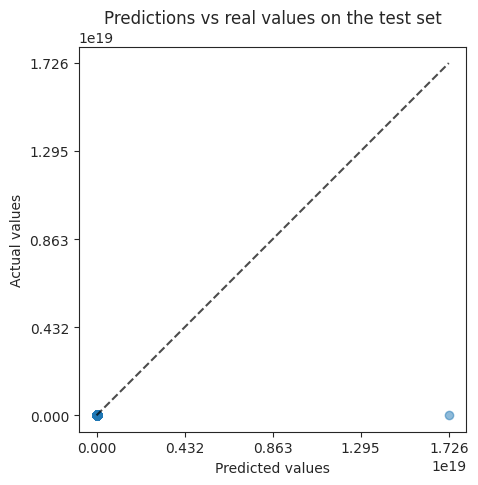

--------------------
 model's pre-processor and target transformer :
    standard_scaler - normal_quantile_transformer
--------------------


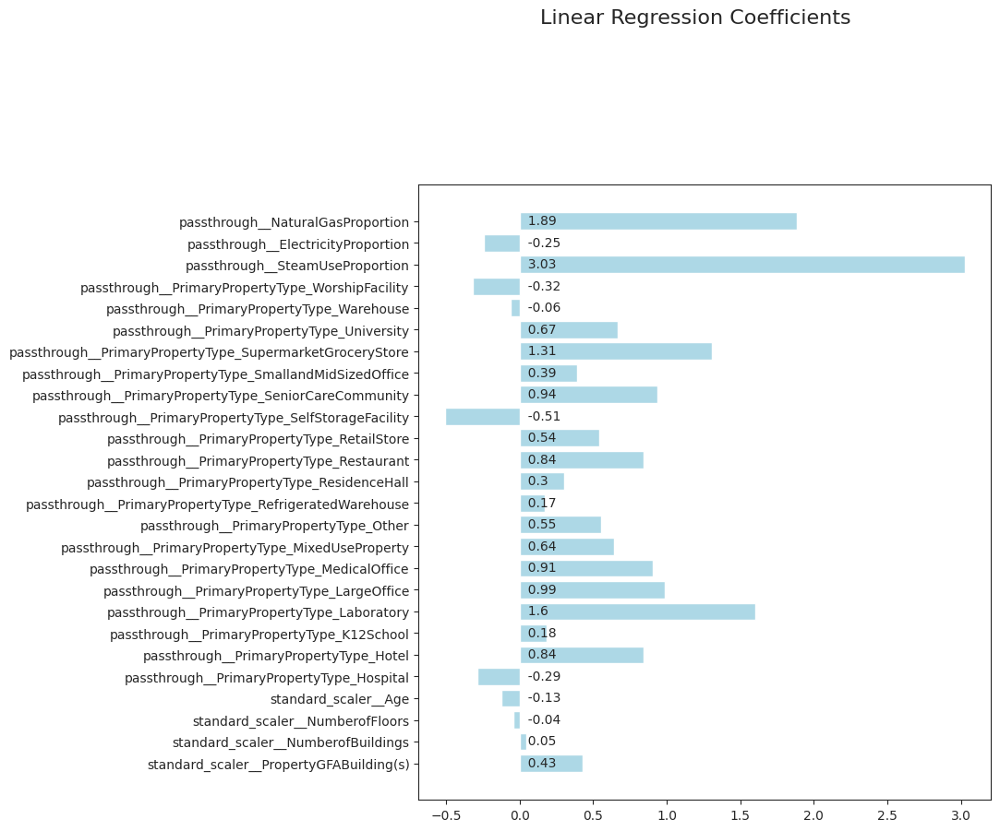

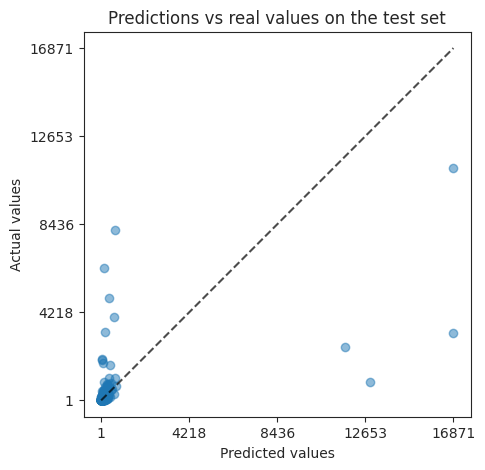

--------------------
 model's pre-processor and target transformer :
    standard_scaler - uniform_quantile_transformer
--------------------


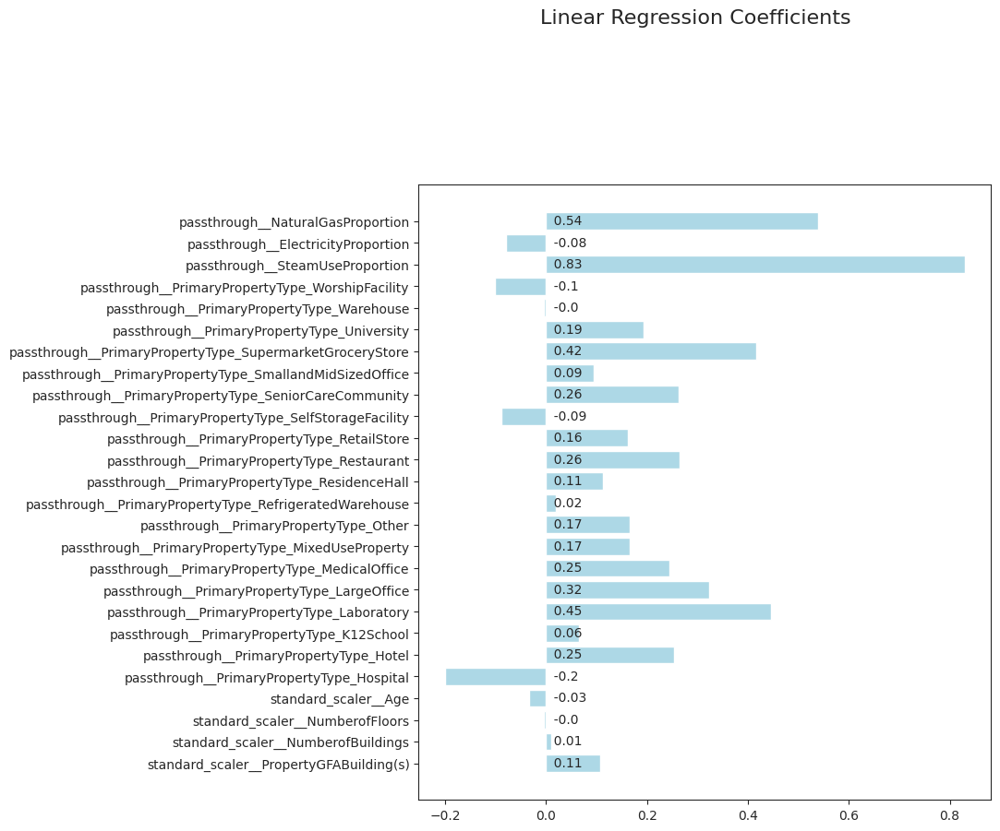

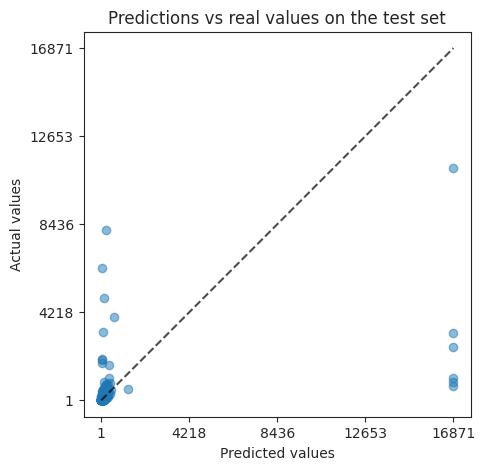

--------------------
 model's pre-processor and target transformer :
    standard_scaler - log_transformer
--------------------


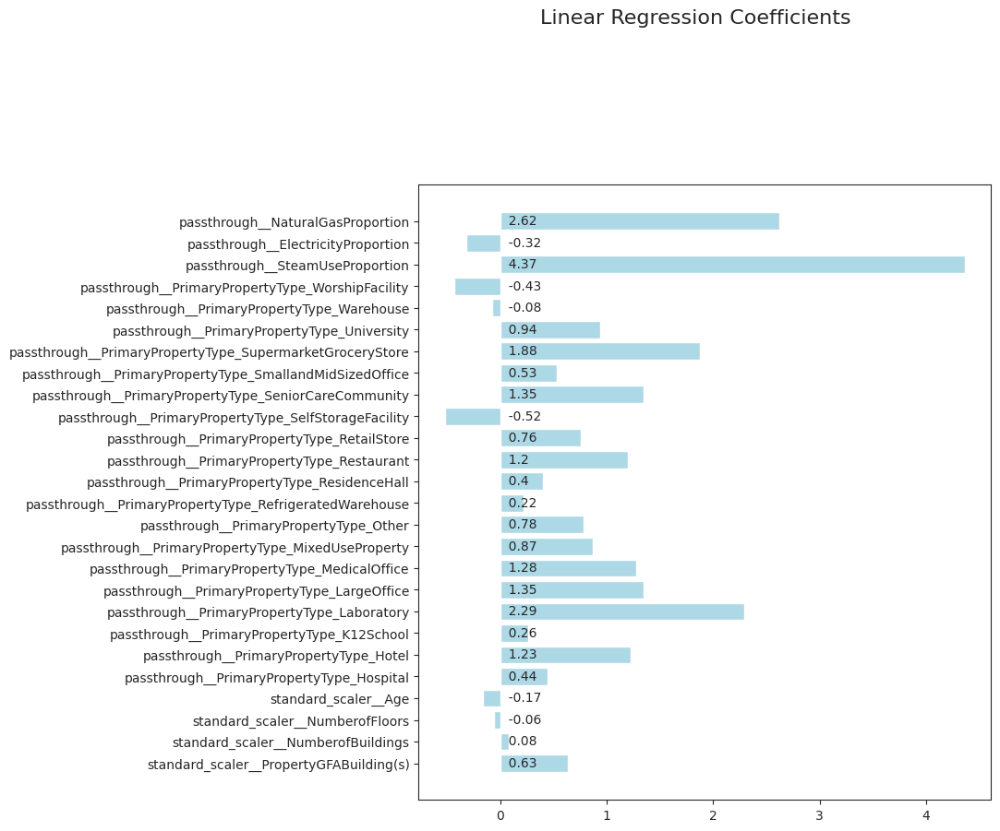

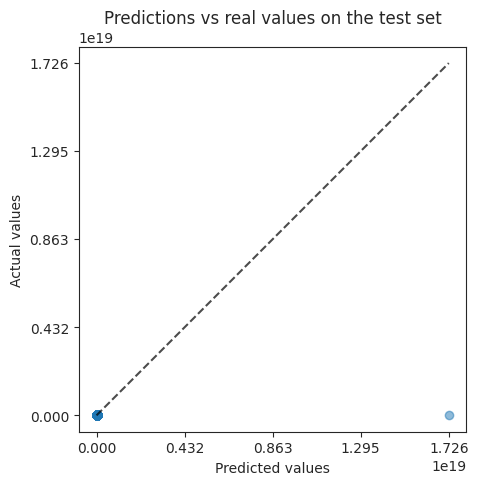

--------------------
 model's pre-processor and target transformer :
    log_transformer_only - normal_quantile_transformer
--------------------


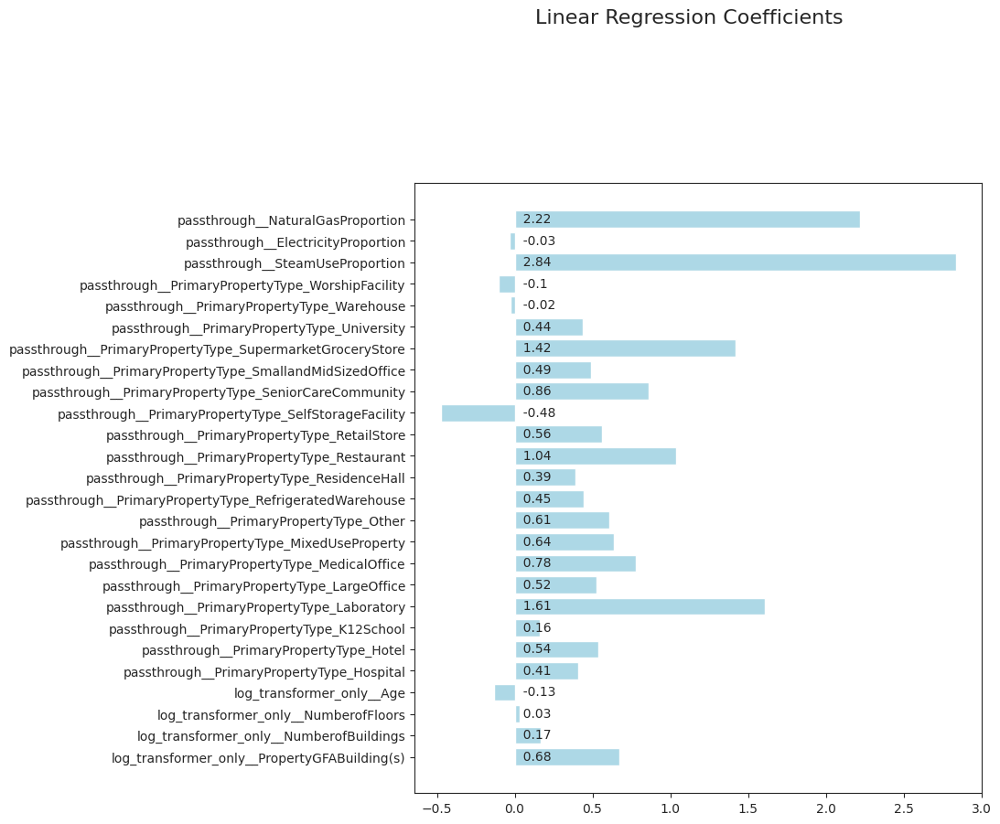

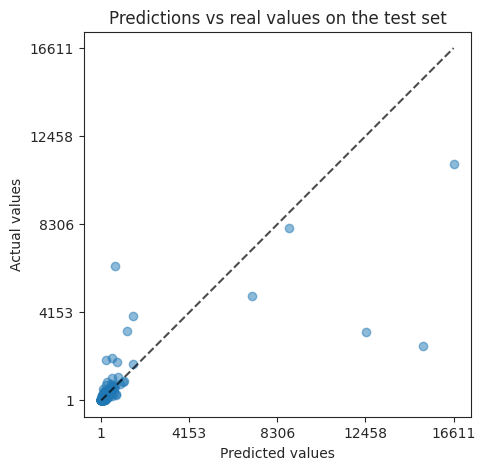

--------------------
 model's pre-processor and target transformer :
    log_transformer_only - uniform_quantile_transformer
--------------------


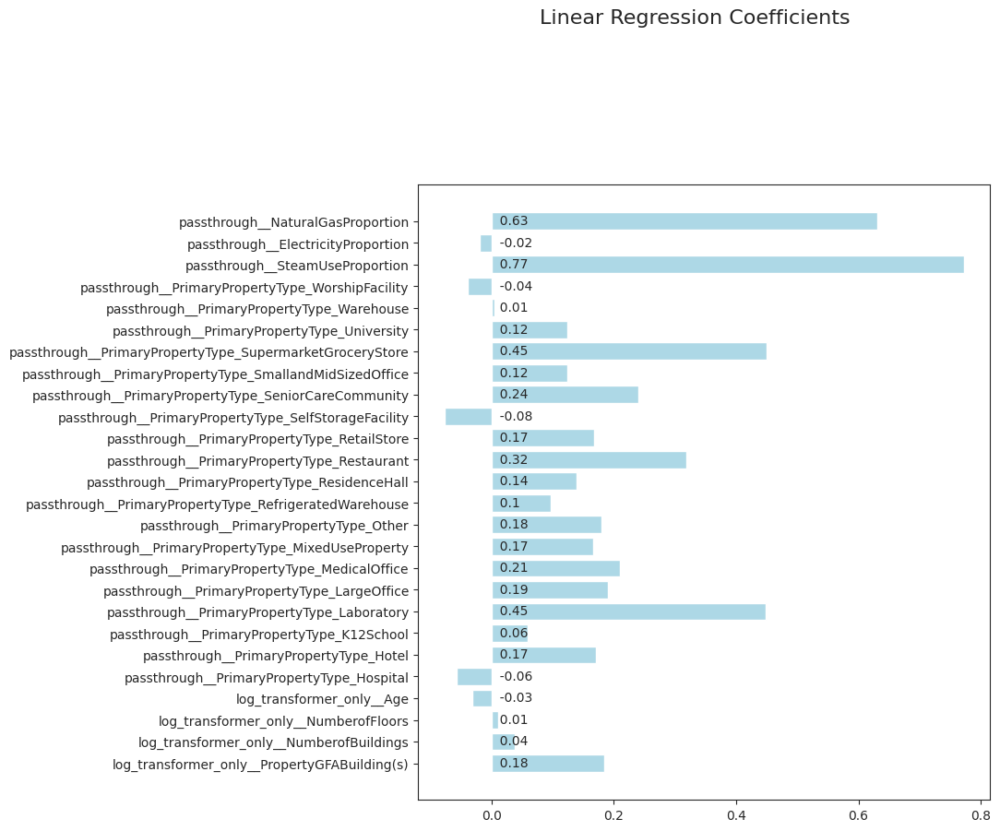

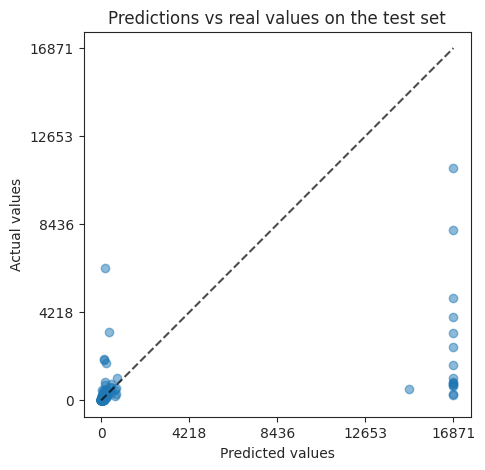

--------------------
 model's pre-processor and target transformer :
    log_transformer_only - log_transformer
--------------------


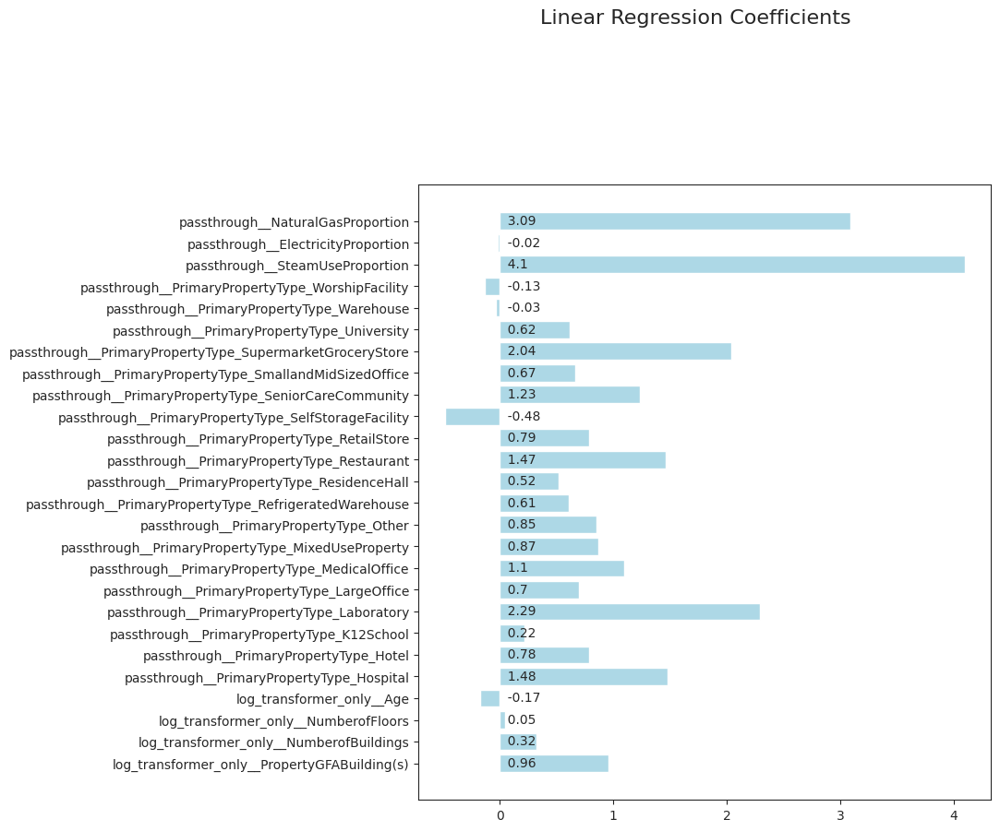

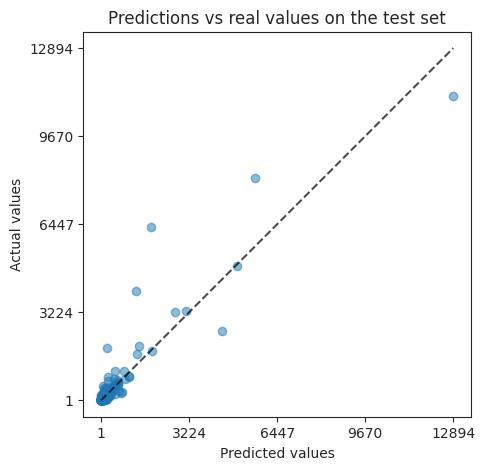

--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - normal_quantile_transformer
--------------------


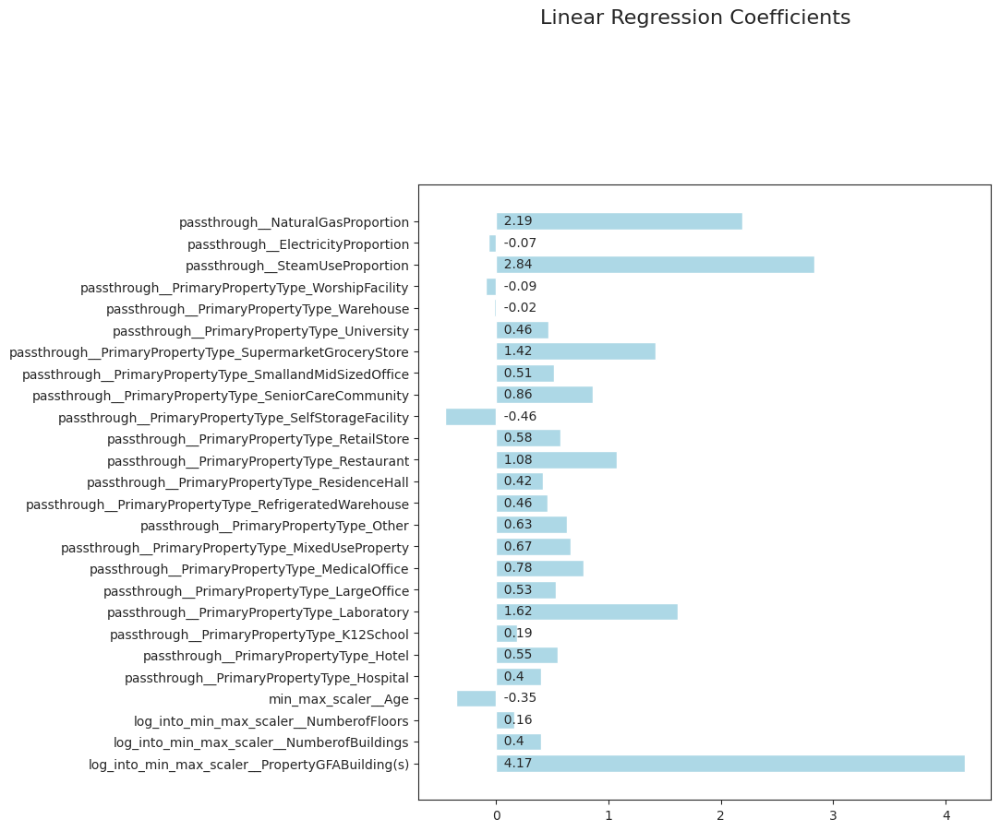

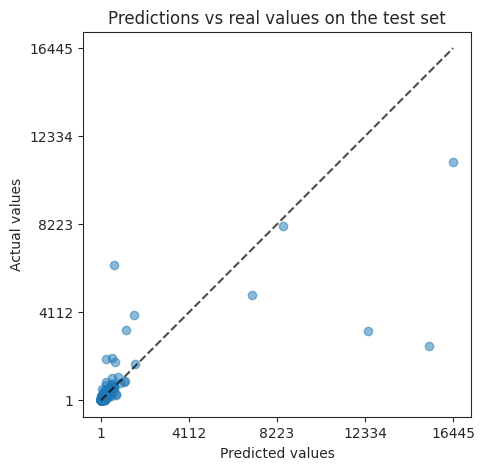

--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - uniform_quantile_transformer
--------------------


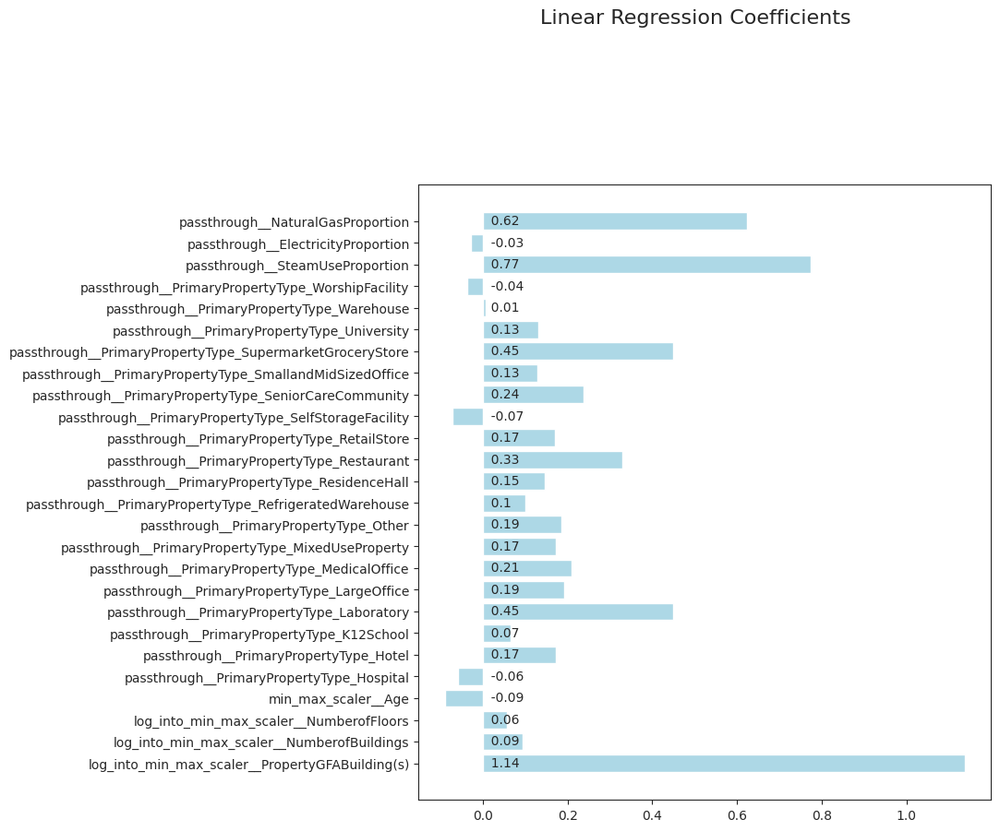

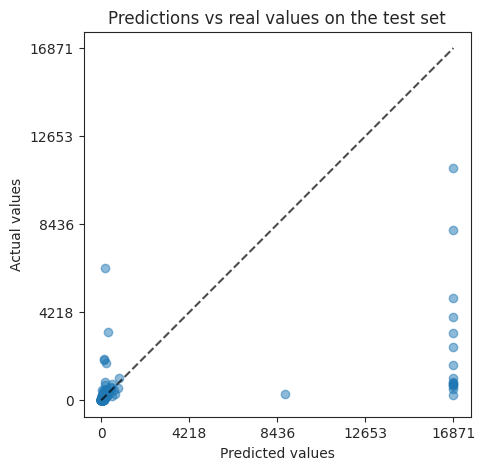

--------------------
 model's pre-processor and target transformer :
    log_into_min_max_scaler - log_transformer
--------------------


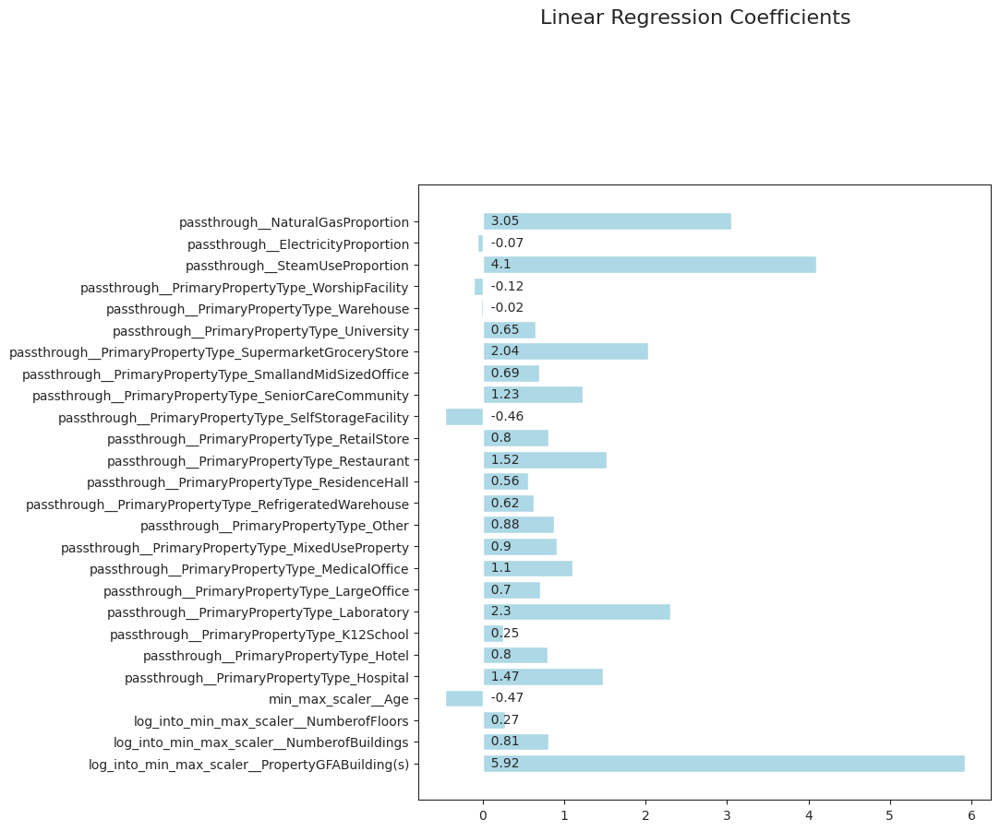

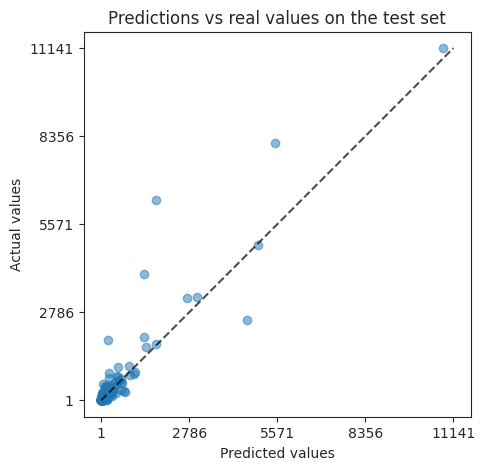

--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - normal_quantile_transformer
--------------------


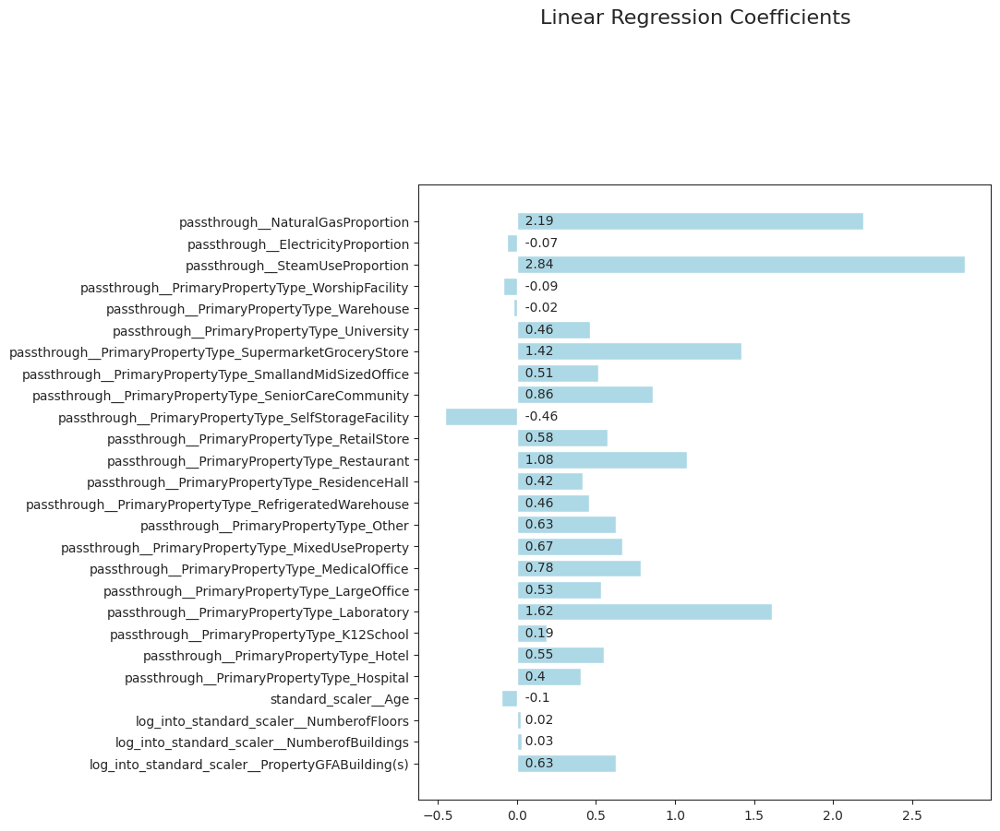

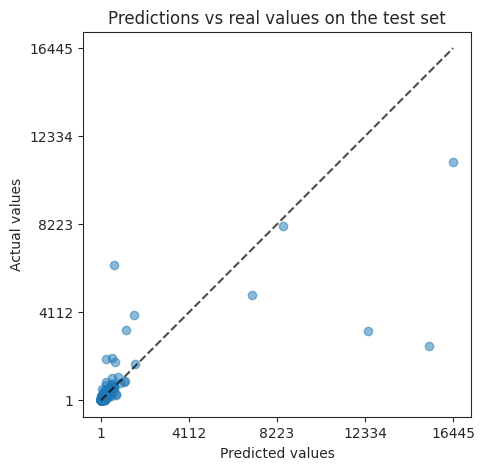

--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - uniform_quantile_transformer
--------------------


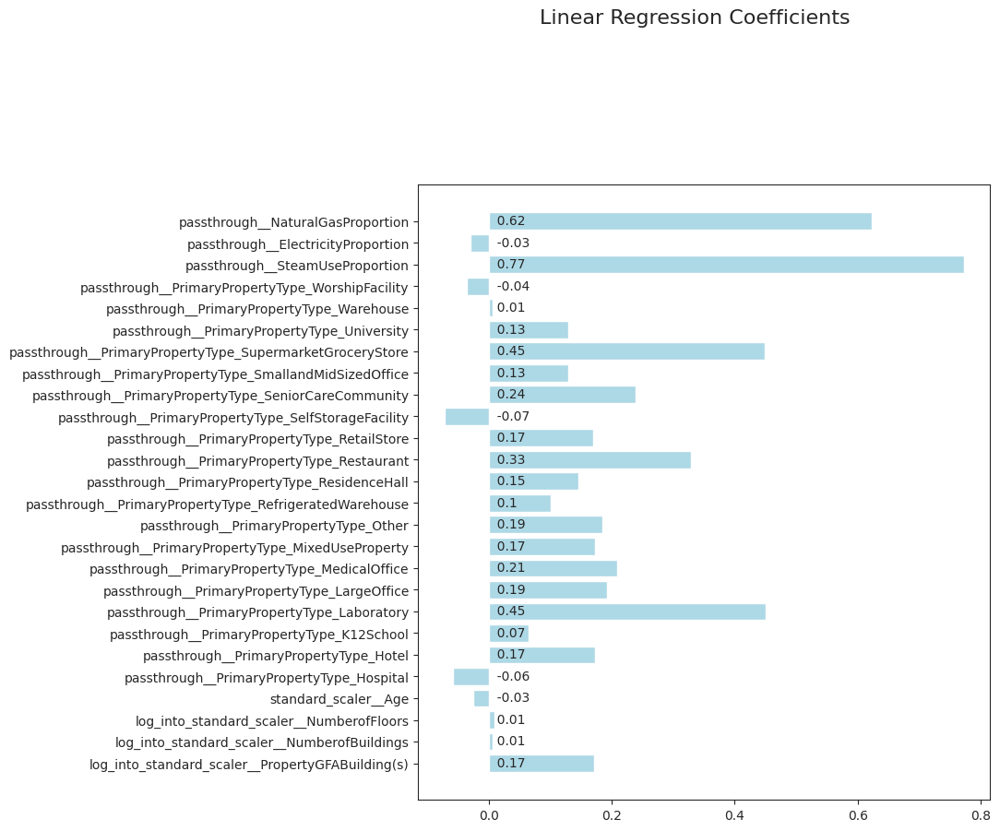

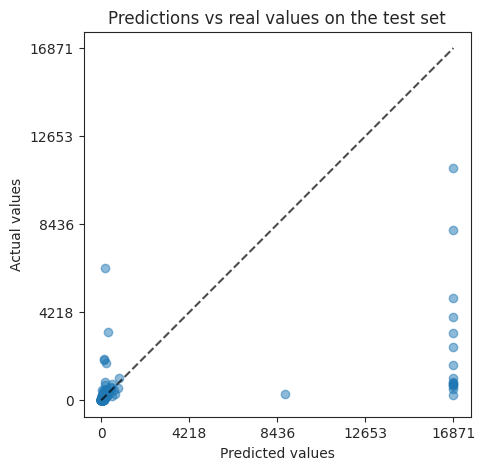

--------------------
 model's pre-processor and target transformer :
    log_into_standard_scaler - log_transformer
--------------------


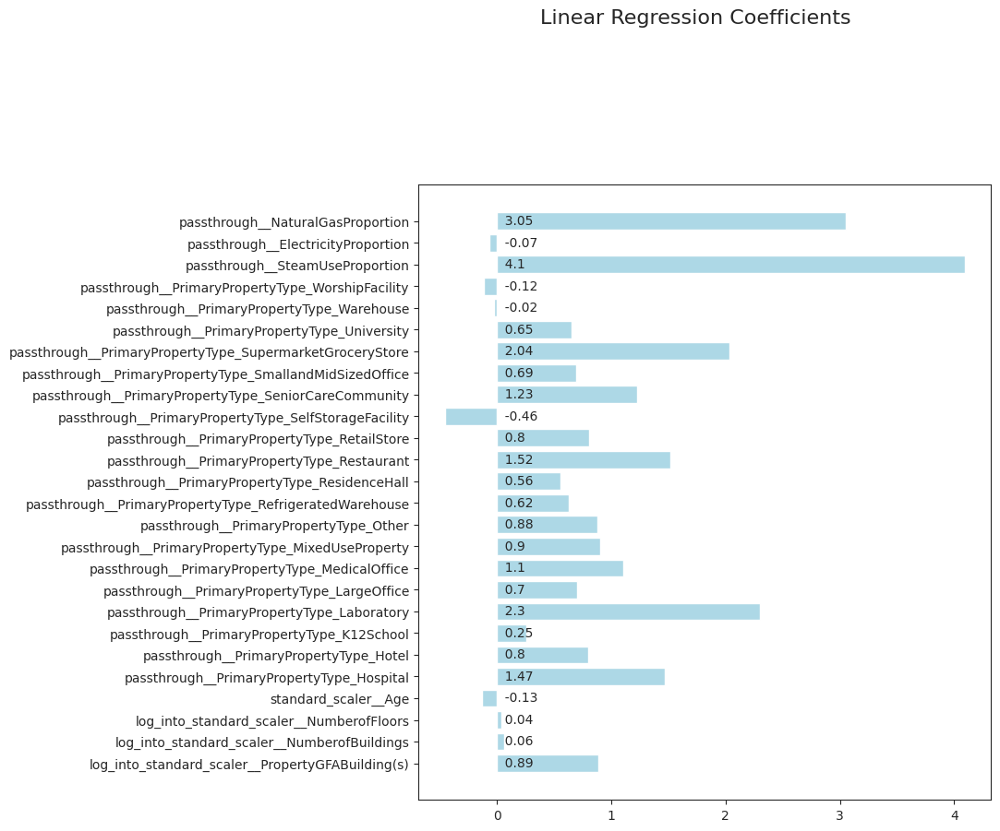

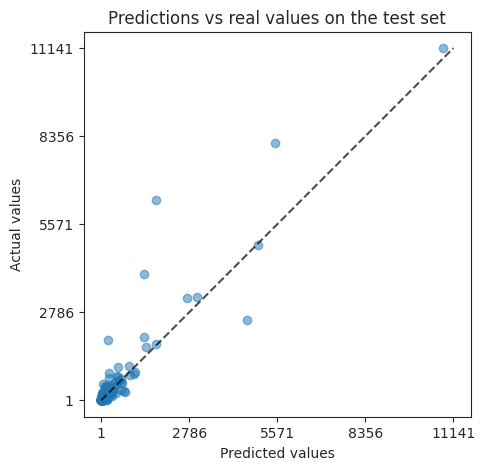

--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - normal_quantile_transformer
--------------------


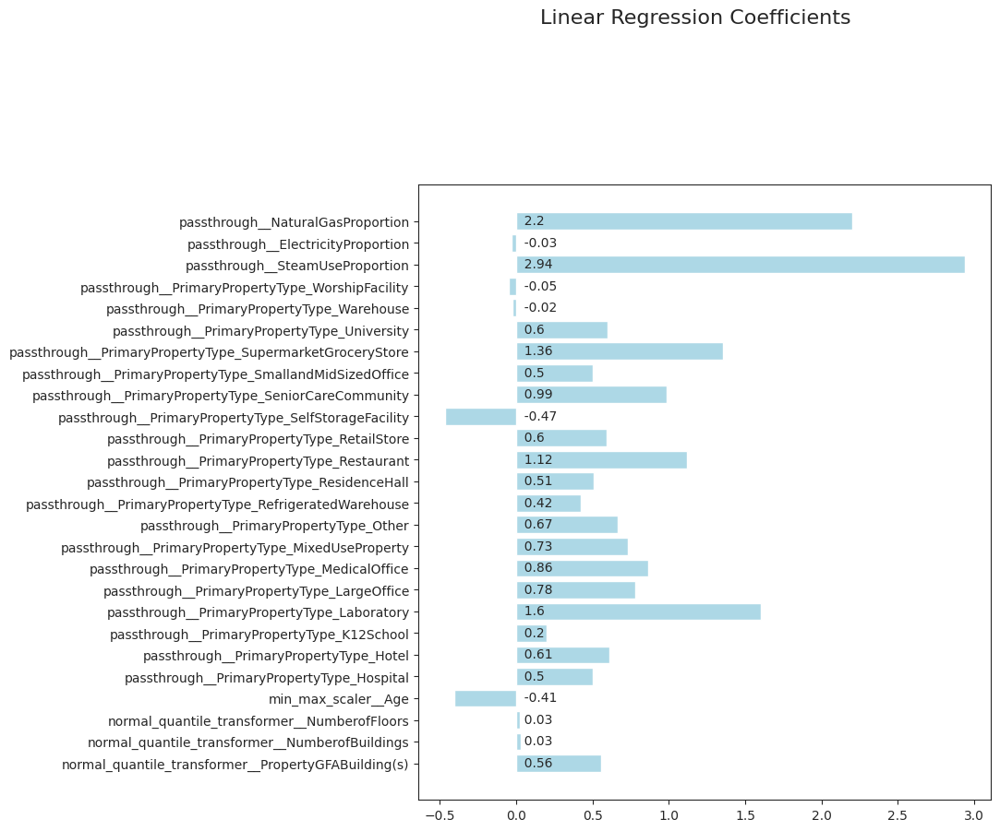

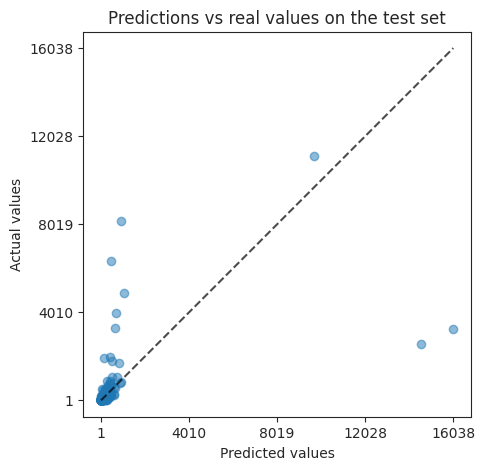

--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - uniform_quantile_transformer
--------------------


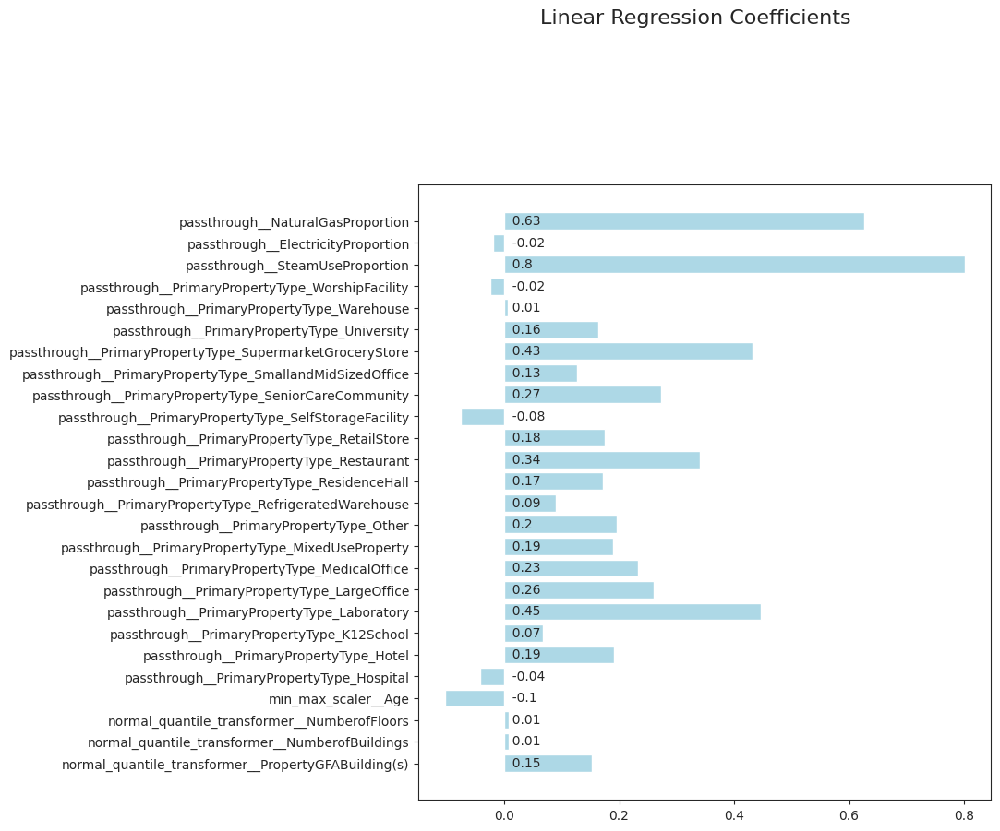

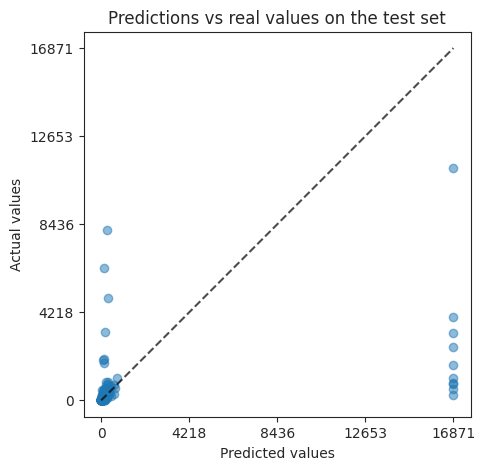

--------------------
 model's pre-processor and target transformer :
    normal_quantile_transformer - log_transformer
--------------------


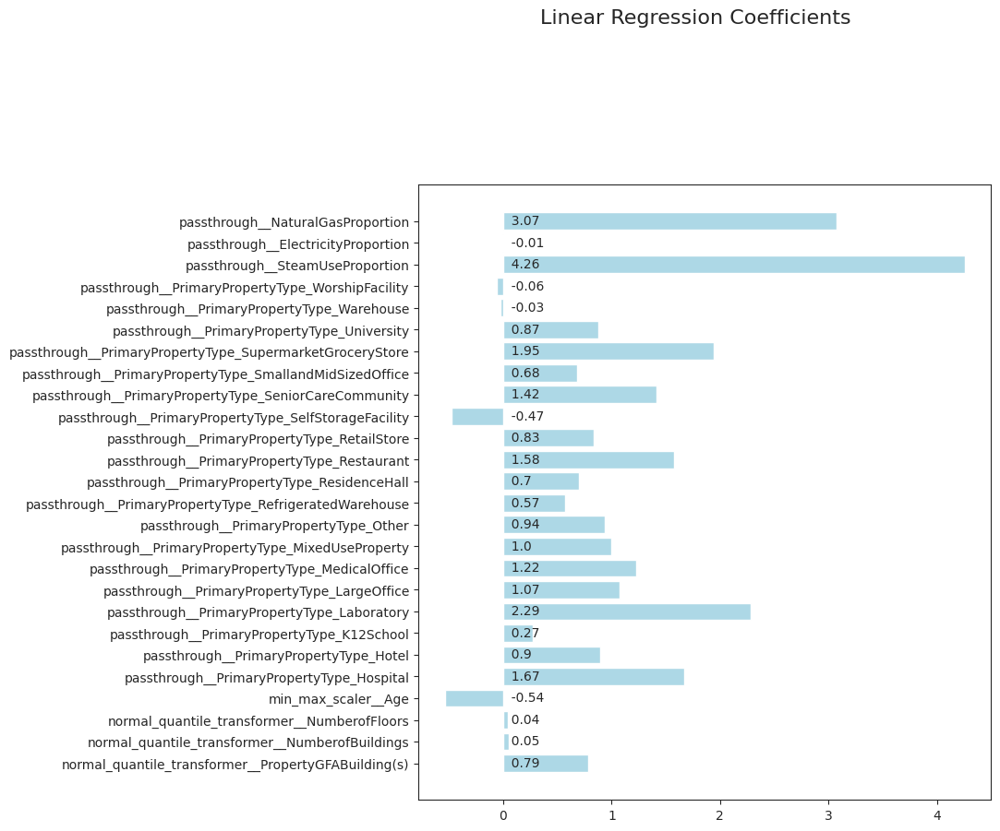

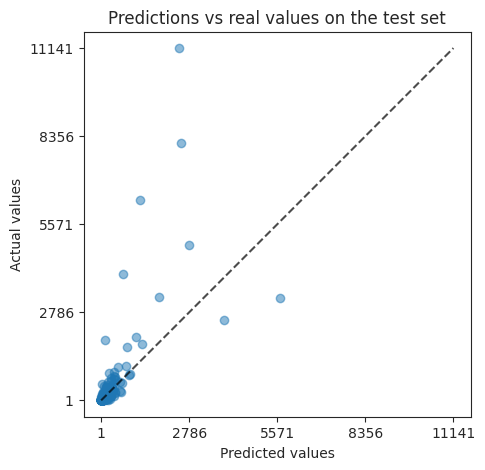

--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - normal_quantile_transformer
--------------------


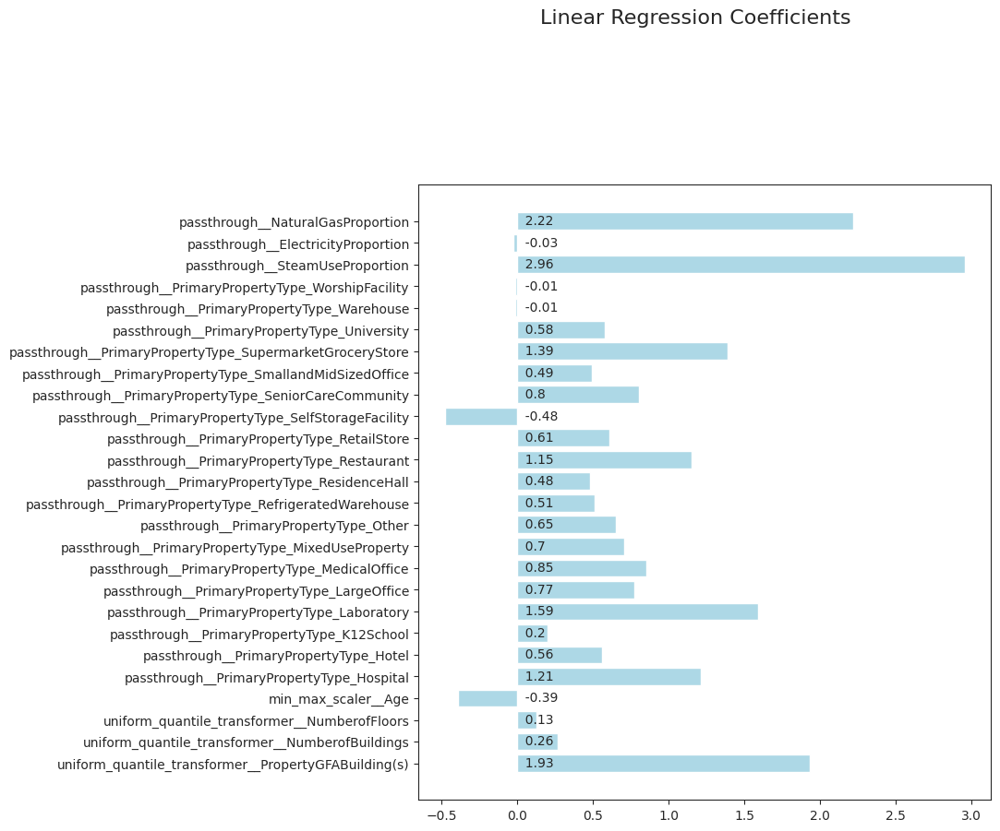

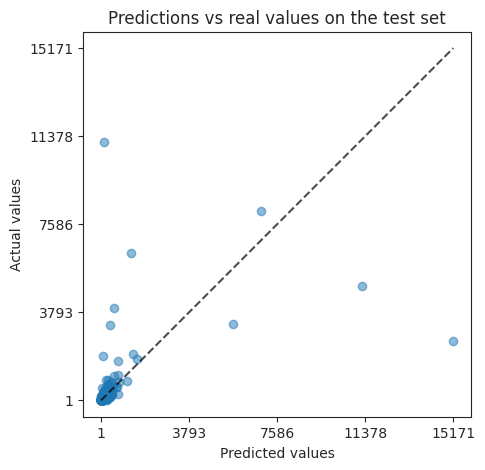

--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - uniform_quantile_transformer
--------------------


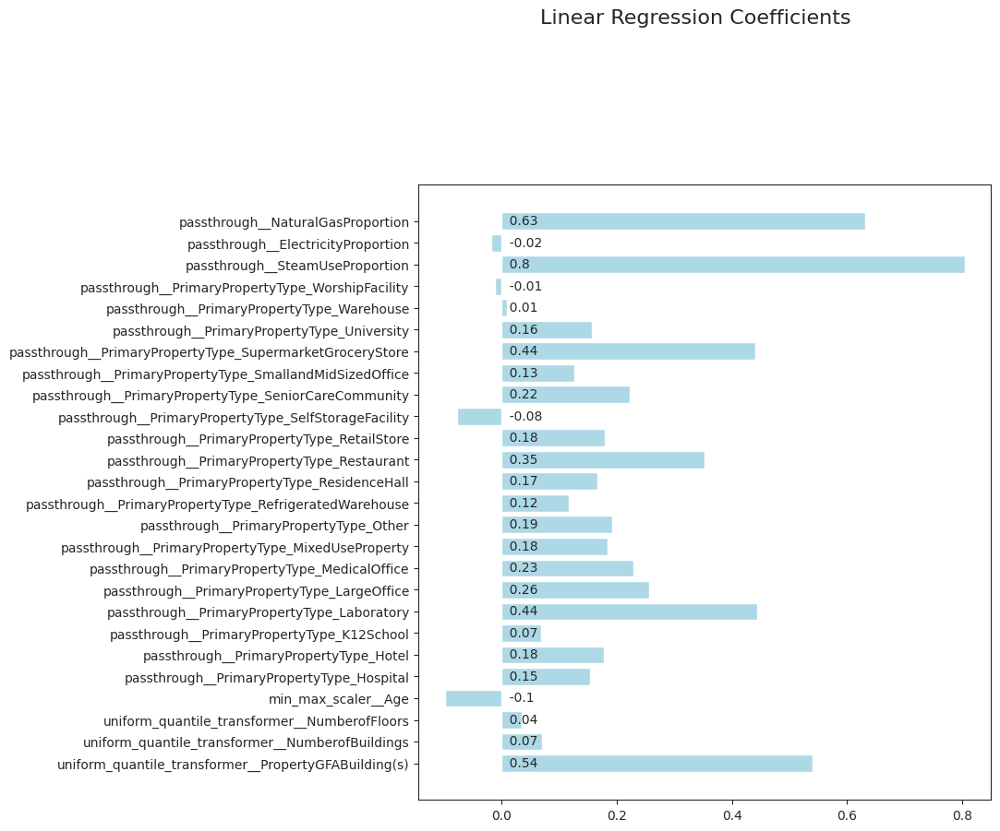

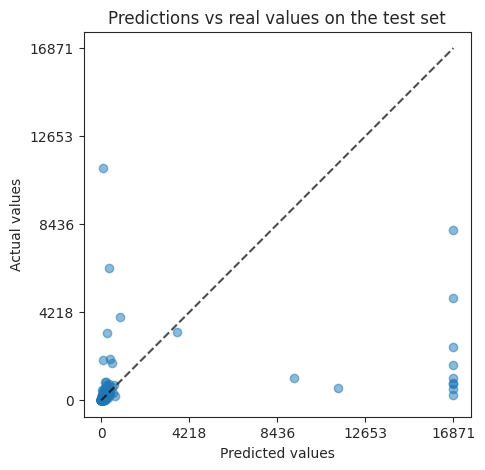

--------------------
 model's pre-processor and target transformer :
    uniform_quantile_transformer - log_transformer
--------------------


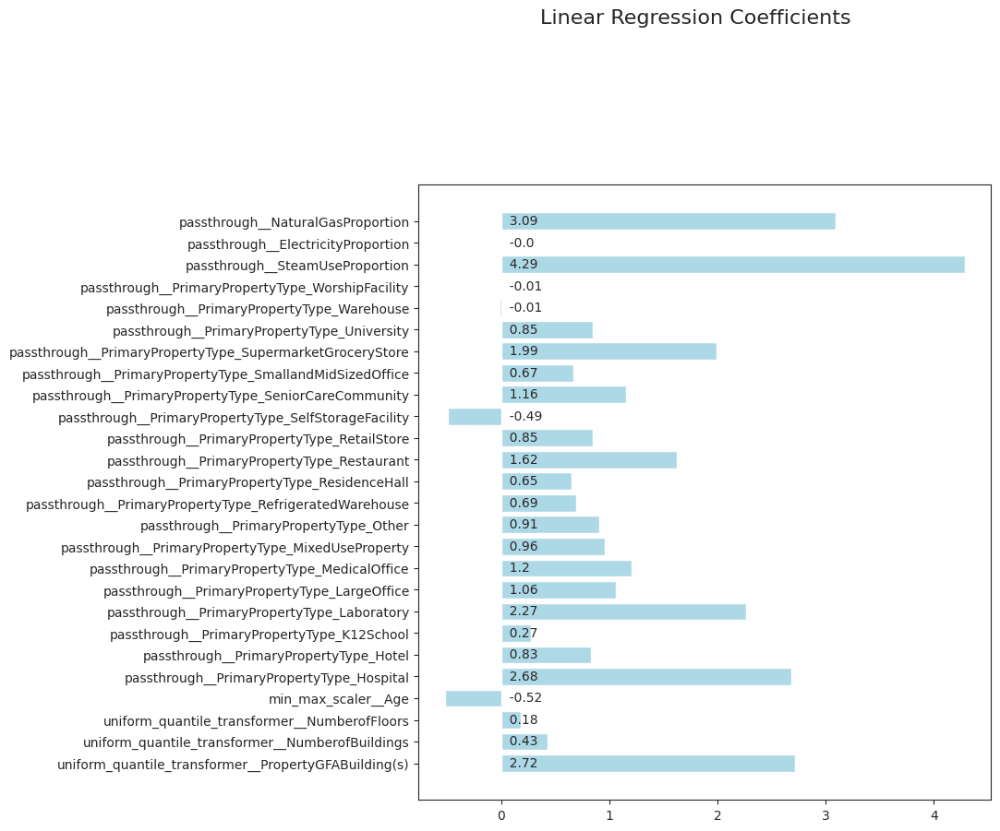

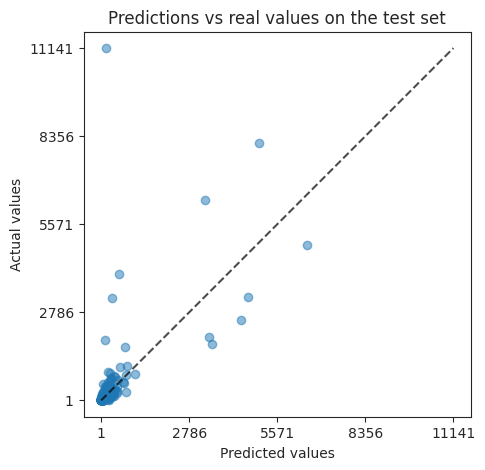

In [46]:
regr = regressors.iloc[0, :]

show_plot = True
show_regressor_input = False
show_scores = False
silent = True

# Create a list to save results and models with the first element being
# the dummy regresspr
results_full_input = [results[0]]
models_full_input = [models[0]]
models_idx = 0

### WITHOUT TARGET TRANSFORMATION
#################################
for pp in pre_processors:
    # Define the model
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("regressor", instantiate_regressor(regr)),
        ]
    )
    # Print the pre_processor name
    print('-' * 20)
    print(
        f" model's pre-processor:\n    "
        f"{model['pre_processor'].transformers[0][0]}"
    )

    # Fine tuning the model, if there is hyperparameters grid search.
    if regr.params_grid is not None:
        pass
    else:
        hyperparameters = None
        
    print('-'*20)
    
    # Fit the model and predict both on train and test sets.
    computation_time = np.NaN # Will have to investigate timeit
    model.fit(X_train, y_train)
    pred_train =  model.predict(X_train)
    pred_test =  model.predict(X_test)
    # save the model
    models_idx += 1
    models_full_input.append(model)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model["regressor"], model[:-1].get_feature_names_out()
        )
            
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model[:-1].transform(X_train), 
            index=X_train.index,
            columns=model[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # evaluating according several metrics 
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")

        # add to results
        results_full_input.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                str(model.named_steps['regressor']).rstrip("()"),
                list(model['pre_processor'].named_transformers_.keys())[0],
                metric.name,
                'None',
                models_idx          
            ]
        )
        
### WITH TARGET TRANSFORMATION
#################################

for pp in pre_processors:
    # Define the model
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("regressor", instantiate_regressor(regr)),
        ]
    )
    
    for transformer_name in transformers.keys():
        
        full_model = TransformedTargetRegressor(
            regressor=model,
            transformer=transformers[transformer_name]
        )
        print('-' * 20)
        print(
                f" model's pre-processor and target transformer :\n    "
                f"{pp.transformers_[0][0]}"
                f" - {transformer_name}"
        )
        
        # Fine tuning the full_model, if there is hyperparameters grid search.
        if regr.params_grid is not None:
            pass
        else:
            hyperparameters = None
            
        print('-'*20)
        
        # Fit the full_model and predict on both train and test sets.
        computation_time = np.NaN # Will have to investigate timeit
        full_model.fit(X_train, y_train)
        pred_train =  full_model.predict(X_train)
        pred_test =  full_model.predict(X_test)
        # save the model
        models_idx += 1
        models_full_input.append(full_model)
        
        if show_plot:
            # Observing the coefficients of the regression model
            ds.linearRegressionSummary(
                full_model.regressor_["regressor"],
                full_model.regressor_[:-1].get_feature_names_out()
            )
            
            # displaying predictions vs real values
            _, ax = plt.subplots(figsize=(5, 5))
            _ = PredictionErrorDisplay.from_predictions(
                y_test, pred_test, kind="actual_vs_predicted",
                ax=ax, scatter_kwargs={"alpha": 0.5}
            )
            ax.set_title("Predictions vs real values on the test set")
            plt.show()

        if show_regressor_input:
            # displaying the inputs after the preprocessing stage
            pre_processed_inputs = pd.DataFrame(
                full_model.regressor_[:-1].transform(X_train), 
                index=X_train.index,
                columns=full_model.regressor_[:-1].get_feature_names_out()
            )
            display(pre_processed_inputs)
            
        
        # evaluating according several metrics 
        for i, metric in metrics.iterrows():
            
            cv_output = ds.CV_evaluation(
                full_model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0, silent=silent
            )
            
            # Compute and print scores.
            score_train = apply_score_func(metric, y_train, pred_train)
            score_test = apply_score_func(metric, y_test, pred_test)
            if show_scores:
                print(f"\nTrain score : {score_train}")
                print(f"\nTest score : {score_test}")   

            # add to results
            results_full_input.append(
                [
                    cv_output[1],
                    cv_output[2],
                    score_test,
                    computation_time,
                    hyperparameters,
                    cv_output[0],
                    score_train,
                    str(
                        full_model.regressor_.named_steps['regressor']
                    ).rstrip("()"),
                    list(
                        full_model.regressor_['pre_processor']
                        .named_transformers_
                        .keys()
                    )[0],
                    metric.name,
                    transformer_name,
                    models_idx
                            
                ]
            )
        


In [47]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_full_input = pd.DataFrame(
    results_full_input, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])

In [48]:
df_results_full_input

CV_train_score_mean  \
metric pre_processor                regressor        target_transformer                                  
R2     None                         DummyRegressor   None                                       -0.016   
       min_max_scaler               LinearRegression None                                        0.234   
MAE    min_max_scaler               LinearRegression None                                      166.861   
RMSE   min_max_scaler               LinearRegression None                                      545.360   
R2     standard_scaler              LinearRegression None                                        0.234   
MAE    standard_scaler              LinearRegression None                                      166.861   
RMSE   standard_scaler              LinearRegression None                                      545.360   
R2     log_transformer_only         LinearRegression None                                        0.329   
MAE    log_transformer_only         LinearRegression None                                      183.212   
RMSE   log_transformer_only         LinearRegression None                                      560.561   
R2     log_into_min_max_scaler      LinearRegression None                                        0.329   
MAE    log_into_min_max_scaler      LinearRegression None                                      183.393   
RMSE   log_into_min_max_scaler      LinearRegression None                                      560.330   
R2     log_into_standard_scaler     LinearRegression None                                        0.329   
MAE    log_into_standard_scaler     LinearRegression None                                      183.393   
RMSE   log_into_standard_scaler     LinearRegression None                                      560.330   
R2     normal_quantile_transformer  LinearRegression None                                        0.275   
MAE    normal_quantile_transformer  LinearRegression None                                      184.665   
RMSE   normal_quantile_transformer  LinearRegression None                                      568.568   
R2     uniform_quantile_transformer LinearRegression None                                        0.227   
MAE    uniform_quantile_transformer LinearRegression None                                      183.873   
RMSE   uniform_quantile_transformer LinearRegression None                                      588.599   
R2     min_max_scaler               LinearRegression normal_quantile_transformer                -8.623   
MAE    min_max_scaler               LinearRegression normal_quantile_transformer               216.799   
RMSE   min_max_scaler               LinearRegression normal_quantile_transformer              1168.756   
R2     min_max_scaler               LinearRegression uniform_quantile_transformer              -22.122   
MAE    min_max_scaler               LinearRegression uniform_quantile_transformer              437.983   
RMSE   min_max_scaler               LinearRegression uniform_quantile_transformer             2208.242   
R2     min_max_scaler               LinearRegression log_transformer                          -233.017   
MAE    min_max_scaler               LinearRegression log_transformer                           517.759   
RMSE   min_max_scaler               LinearRegression log_transformer                          6350.616   
R2     standard_scaler              LinearRegression normal_quantile_transformer                -8.623   
MAE    standard_scaler              LinearRegression normal_quantile_transformer               216.799   
RMSE   standard_scaler              LinearRegression normal_quantile_transformer              1168.756   
R2     standard_scaler              LinearRegression uniform_quantile_transformer              -22.122   
MAE    standard_scaler              LinearRegression uniform_quantile_transformer              437.983   
RMSE   standard_scaler              LinearRegression un

In [49]:
f_cols = [
    "CV_train_score_mean",
    "CV_train_score_std",
    "test_score"
]
for i, metric in metrics.iterrows():
    tdf = df_results_full_input.loc[
        df_results_full_input
        .index
        .get_level_values('metric') == metric.name
    ]    
    display(
        tdf
        .sort_values(["metric", "CV_train_score_mean"])
        # .iloc[:10, :]
        .style.format("{:,.3f}", f_cols, thousands=" ")
        .background_gradient(
            cmap="Blues",
            subset=f_cols
        )
    )

## 4.3.  [&#9650;](#toc0_) <a id='toc4_3_'></a>Visualizing predictions of some of the best models

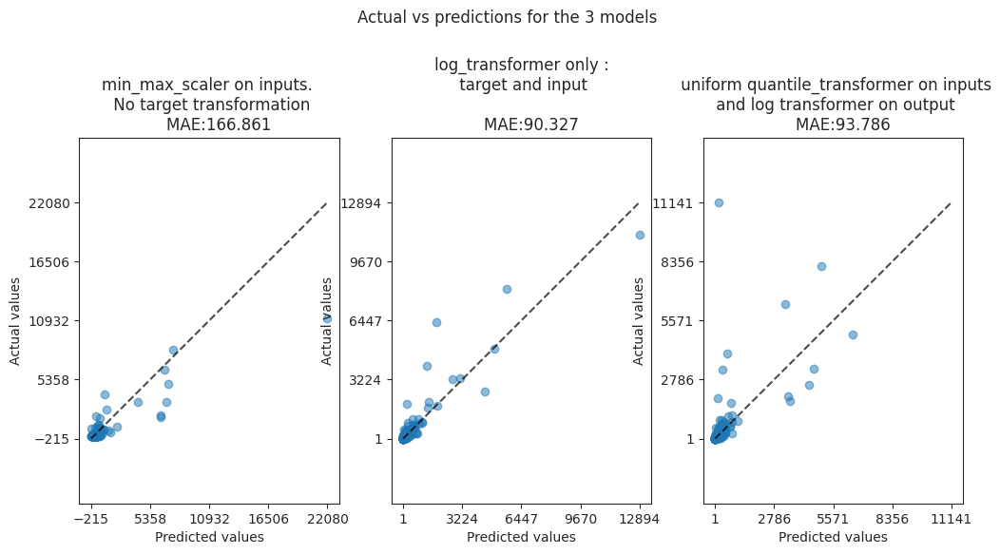

In [50]:
# Interestingly enough, log transformation on both inputs and target 
# give consistently good results. 
# Let's note that not scaling give slightly better results than 
# applying a minmax or a standard scaler.

# What is surprising is that, for the R2 and RMSE, it is not the best 
# model. Uniform quantile inputs to match a log target 
# give the best results.

# Getting the index visually in the above dataframe to visualize some 
# predictions
idxs = [1, 16, 28] 
titles = [
    'min_max_scaler on inputs. \n No target transformation',
    'log_transformer only :\n target and input\n ',
    ' uniform quantile_transformer on inputs\n and log transformer on output'
]
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models_full_input[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="actual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    
    # Dirty trick to print the MAE
    score = (
        df_results_full_input
        .loc[df_results_full_input.models_idx == idx]
        .query("metric == 'MAE'")
        .CV_train_score_mean
        .values[-1]
    )
    eval(this_ax).set_title(
        titles[n] 
        + f"\n    MAE:{score}"
    )
fig.suptitle('Actual vs predictions for the 3 models', y=1.15)
plt.show()
    

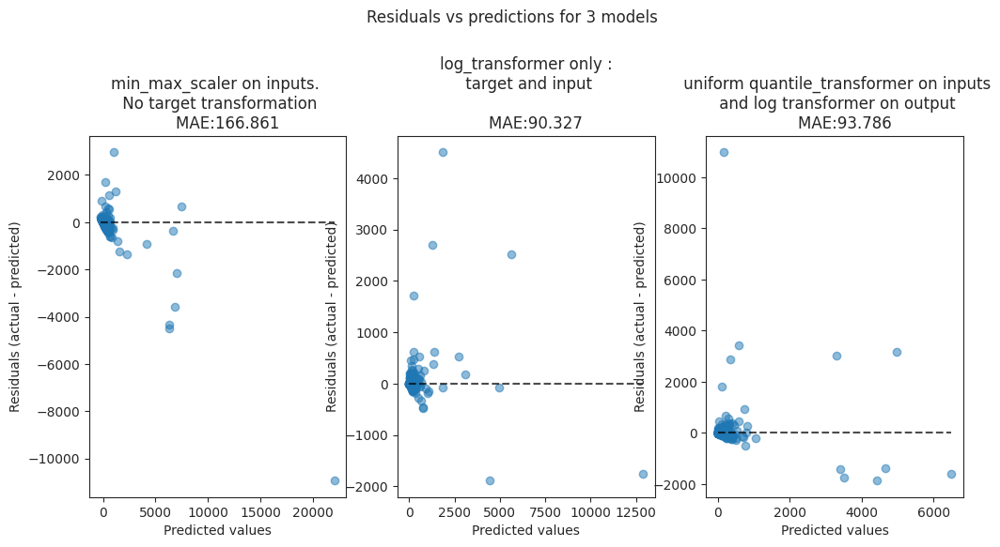

In [51]:
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models_full_input[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="residual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    
    # Dirty trick to print the MAE
    score = (
        df_results_full_input
        .loc[df_results_full_input.models_idx == idx]
        .query("metric == 'MAE'")
        .CV_train_score_mean
        .values[-1]
    )
    eval(this_ax).set_title(
        titles[n] 
        + f"\n    MAE:{score}"
    )
fig.suptitle('Residuals vs predictions for 3 models', y=1.15)
plt.show()
    

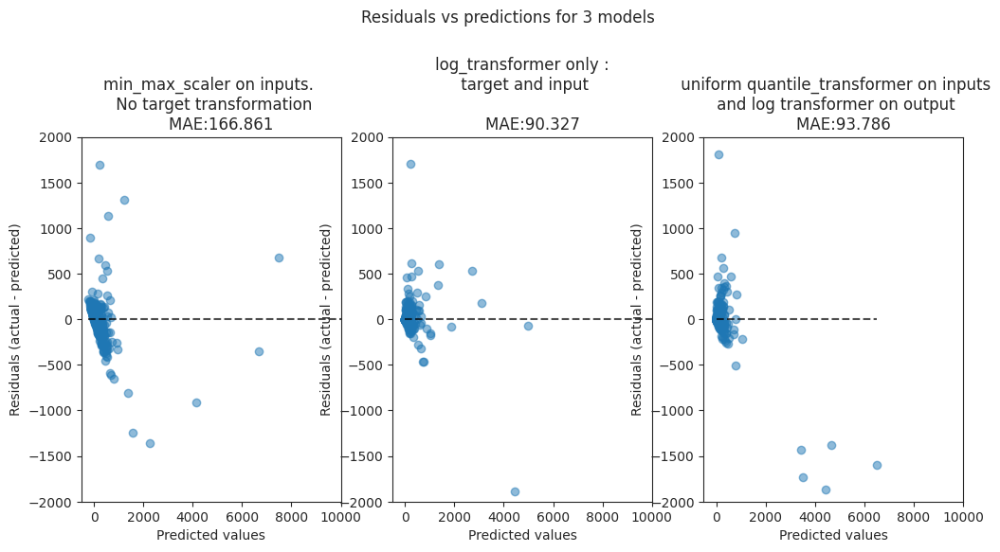

In [52]:
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models_full_input[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="residual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    
    # Dirty trick to print the MAE
    score = (
        df_results_full_input
        .loc[df_results_full_input.models_idx == idx]
        .query("metric == 'MAE'")
        .CV_train_score_mean
        .values[-1]
    )
    eval(this_ax).set_title(
        titles[n] 
        + f"\n    MAE:{score}"
    )
    eval(this_ax).axis([-500, 10000, -2000, 2000])
fig.suptitle('Residuals vs predictions for 3 models', y=1.15)
plt.show()
    

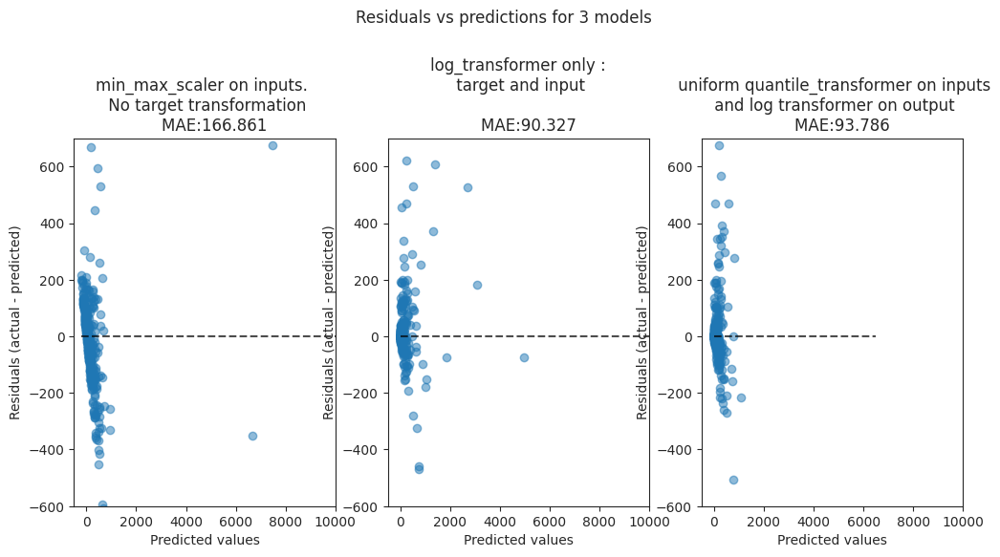

In [53]:
fig, axs = plt.subplots(1, 3, figsize=(12,5))
ax0, ax1, ax2 = axs
for n, idx in enumerate(idxs):
    pred_test = models_full_input[idx].predict(X_test)
    this_ax = 'ax' + str(n)
    PredictionErrorDisplay.from_predictions(
        y_test, pred_test, kind="residual_vs_predicted",
        ax=eval(this_ax), scatter_kwargs={"alpha": 0.5}
    )
    
    # Dirty trick to print the MAE
    score = (
        df_results_full_input
        .loc[df_results_full_input.models_idx == idx]
        .query("metric == 'MAE'")
        .CV_train_score_mean
        .values[-1]
    )
    eval(this_ax).set_title(
        titles[n] 
        + f"\n    MAE:{score}"
    )
    eval(this_ax).axis([-500, 10000, -600, 700])
fig.suptitle('Residuals vs predictions for 3 models', y=1.15)
plt.show()
    

For the MAE minimization, log transforming some inputs and the target improve results a lot.
We went for 200 (dummy regressor), to 166 with a min_max_scaler, to 90 tons of CO2 eq.

### 4.3.1.  [&#9650;](#toc0_) <a id='toc4_3_1_'></a>Saving results

In [99]:
!mkdir -p GHG_predictions_models_and_results/linear_regression_models_full_input

In [117]:
# Save scores of basic models
dir_path = (
    "./GHG_predictions_models_and_results"
    "/linear_regression_models_full_input"
)
df_results_full_input.to_csv(dir_path + "/scores.csv")

In [119]:
# Save each model in a joblib file.
count = 0
for n, row in enumerate(df_results_full_input.index):
    # As there are 3 evaluations per model (for each metric),
    # I select only one out of 3 lines in the df to name the model
    # saved in the list.
    if n % 3 == 0:
        filename = (
            dir_path
            + "/"
            + "_".join(list(row[1:]))
            + ".joblib"
        )
        dump(models_full_input[count], filename)
        count += 1
        

For the following models (linear regressions with regularization), i'll only use these two pre_processing/target processing.

I chose log_transformer followed by min_max rather than log_only which had better score on cv mean, but a higher variance and worst results on the test score.

# 5.  [&#9650;](#toc0_) <a id='toc5_'></a>Linear regressions with regularization.

In this part, the model definition depends on the metric.

Indeed, the metric is used to tune the model hyperparameters during the search grid, so I had to rearrange the order of the code.

## 5.1.  [&#9650;](#toc0_) <a id='toc5_1_'></a> With MinMaxScaler pre-processing

### 5.1.1.  [&#9650;](#toc0_) <a id='toc5_1_1_'></a>Lasso

In [35]:
# helper functions
def find_exp(number) -> int:
    """ return the value of the exponent of the scientific notation """
    base10 = log10(abs(number))
    return floor(base10)

def log_grid_around_previous_best(
    value
):
    """ generate a grid with logspace around the previous best value
    found. """
    exponent = find_exp(value)
    return np.logspace(
            exponent - 1,
            exponent +1,
            20
    )

Best parameter (CV score=0.283):
{'lasso__alpha': 2.2758459260747865}
Best parameter (CV score=0.362):
{'lasso__alpha': 6.158482110660261}
Best parameter (CV score=0.362):
{'lasso__alpha': 6.348484848484849}


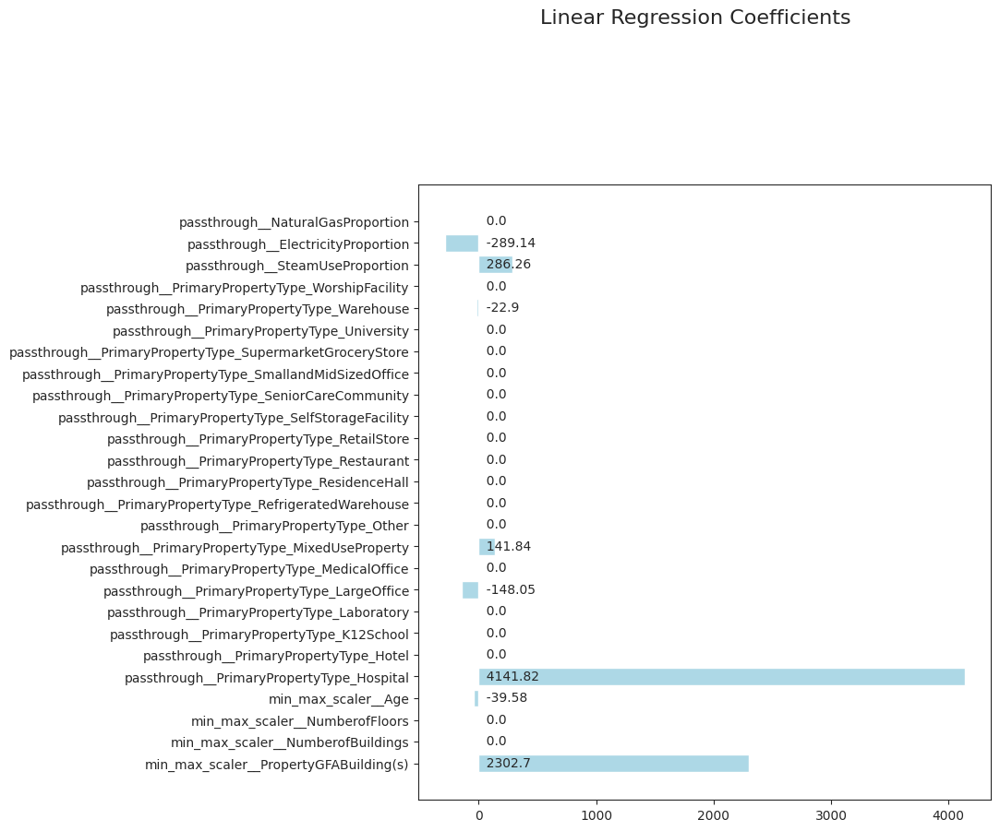

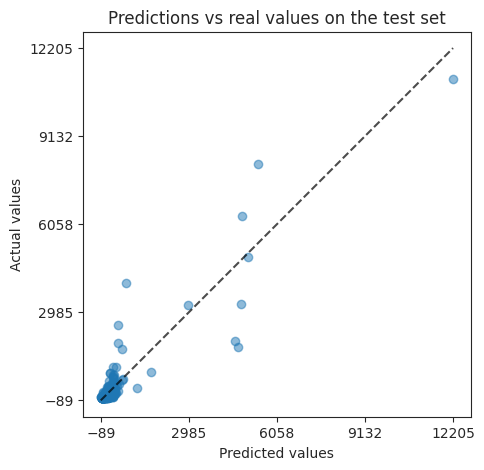

Cross-validation evaluation : 
    scores on folds:  [0.174 0.069 0.569 0.337 0.614]
    mean score:  0.353
    std score deviation:  0.213
Best parameter (CV score=-158.655):
{'lasso__alpha': 2.2758459260747865}
Best parameter (CV score=-145.676):
{'lasso__alpha': 10.0}
Best parameter (CV score=-145.628):
{'lasso__alpha': 9.606060606060606}


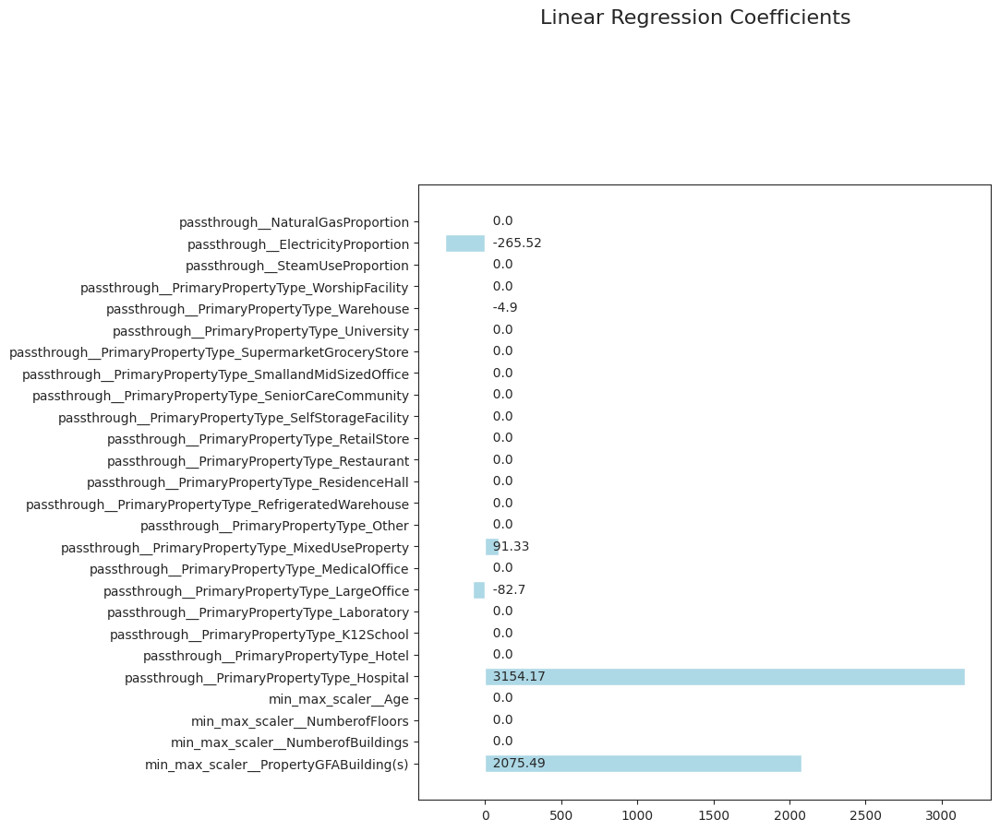

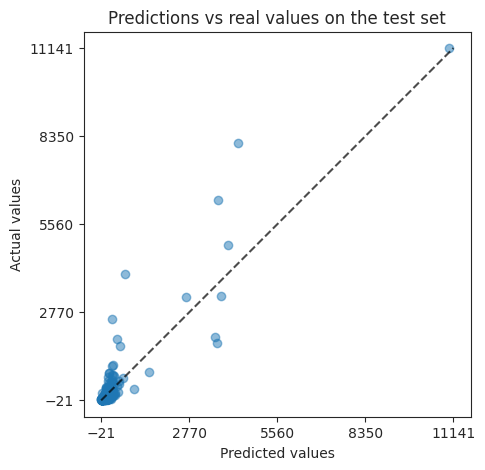

Cross-validation evaluation : 
    scores on folds:  [142.734 166.931 138.66  126.543 154.692]
    mean score:  145.912
    std score deviation:  13.833
Best parameter (CV score=-537.646):
{'lasso__alpha': 2.2758459260747865}
Best parameter (CV score=-530.980):
{'lasso__alpha': 4.832930238571752}
Best parameter (CV score=-530.592):
{'lasso__alpha': 4.242424242424242}


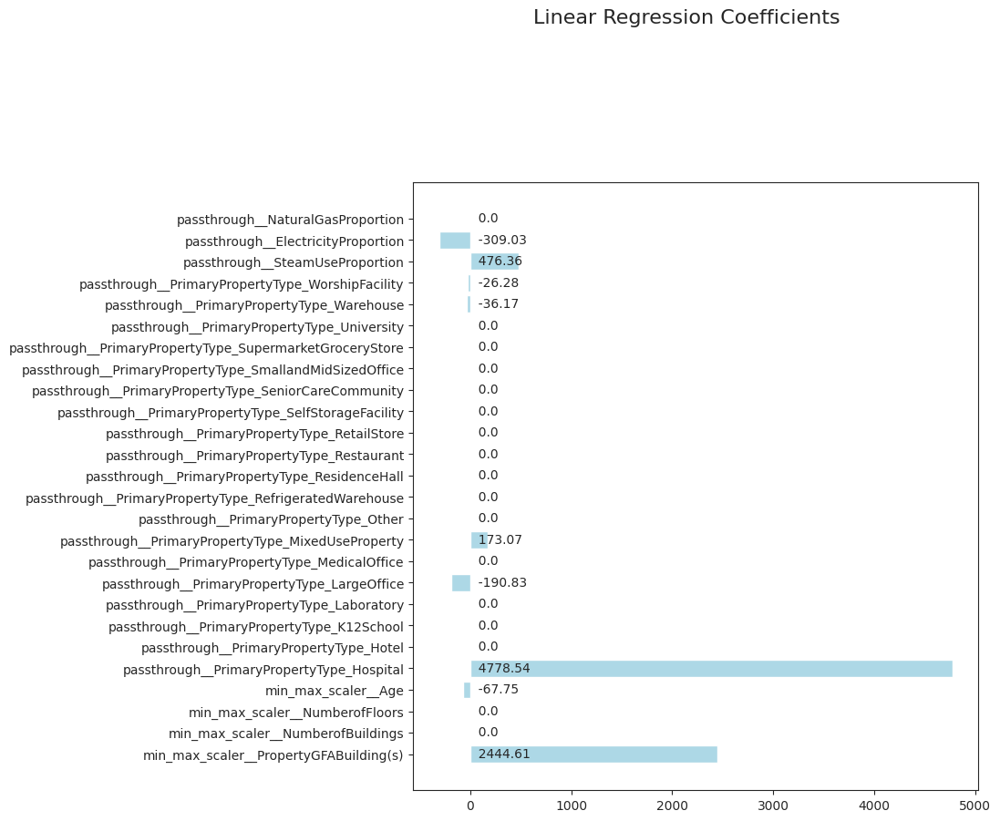

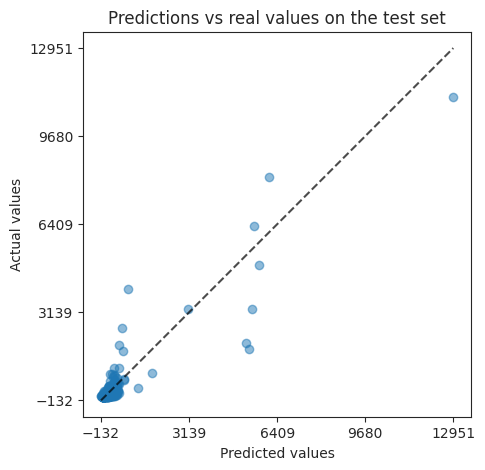

Cross-validation evaluation : 
    scores on folds:  [ 299.355 1096.168  478.393  271.11   485.562]
    mean score:  526.118
    std score deviation:  298.439


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,min_max,lasso,None,0.353,0.213,0.82439,NaN,{'lasso__alpha': 6.348484848484849},"[0.174, 0.069, 0.569, 0.337, 0.614]",0.39568,0
MAE,min_max,lasso,None,145.912,13.833,140.93527,NaN,{'lasso__alpha': 9.606060606060606},"[142.734, 166.931, 138.66, 126.543, 154.692]",141.74285,1
RMSE,min_max,lasso,None,526.118,298.439,407.49840,NaN,{'lasso__alpha': 4.242424242424242},"[299.355, 1096.168, 478.393, 271.11, 485.562]",573.51592,2


In [37]:
# Booleans to get the desired outputs.
show_plot = True
show_scores = False
show_regressor_input = False
silent = False

# Select the min_max_scaler pre_processor
pp = pre_processors[0]

# For saving results and models of this section.
results_regul = []
models_regul = []
models_idx = 0

# Create the full model
model = Pipeline(
    [
        ("pre_processor", pp),
        ("lasso", Lasso(random_state=0, max_iter=100_000)),
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    alphas = np.logspace(-5, 10, 15)
    param_grid = [{"lasso__alpha": alphas}]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    # Refining the gridsearch
    new_alphas = log_grid_around_previous_best(
        search.best_params_["lasso__alpha"]
    )
    param_grid = [{"lasso__alpha": new_alphas}]
    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    # Refining manually
    lower_bound = float(input("lower bound for alpha ?"))
    upper_bound = float(input("upper bound for alpha ?"))
    new_alphas = np.linspace(lower_bound, upper_bound, 100)
    param_grid = [{"lasso__alpha": new_alphas}]
    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Define, fit the best model with lasso
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("lasso", Lasso(
                    alpha=search.best_params_["lasso__alpha"],
                    random_state=0,
                    max_iter=100_000
                )
             ),
        ]
    )
    model.fit(X_train, y_train)
    # save the model
    models_regul.append(model)

    # Predict
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model["lasso"], model[:-1].get_feature_names_out()
        )

        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model[:-1].transform(X_train), 
            index=X_train.index,
            columns=model[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")

    # add to results
    results_regul.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "lasso",
            "min_max",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1   
    
 

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_regul = pd.DataFrame(
results_regul, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_regul


### 5.1.2.  [&#9650;](#toc0_) <a id='toc5_1_2_'></a>Rigde

Best parameter (CV score=0.280):
{'ridge__alpha': 2.2758459260747865}
Best parameter (CV score=0.298):
{'ridge__alpha': 6.158482110660261}
Best parameter (CV score=0.298):
{'ridge__alpha': 5.909090909090909}


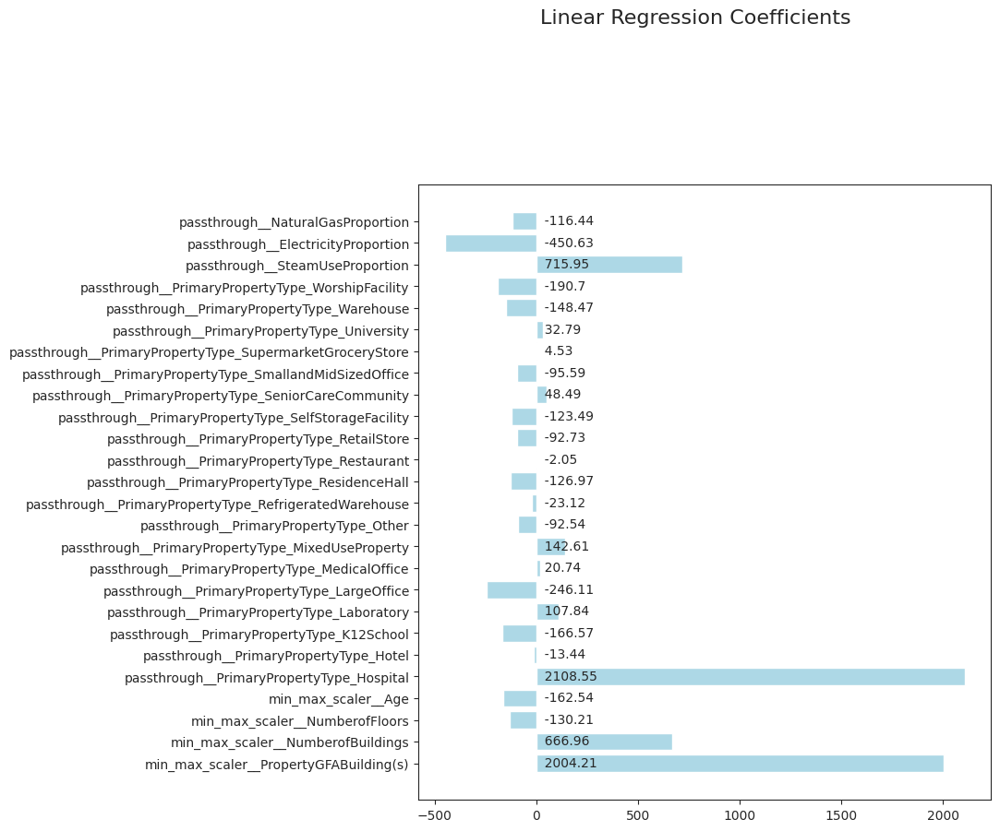

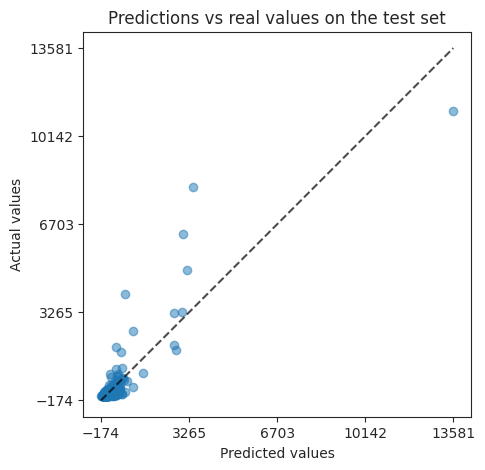

Cross-validation evaluation : 
    scores on folds:  [0.289 0.065 0.47  0.366 0.492]
    mean score:  0.336
    std score deviation:  0.154
Best parameter (CV score=-153.606):
{'ridge__alpha': 26.826957952797272}
Best parameter (CV score=-152.366):
{'ridge__alpha': 18.329807108324356}
Best parameter (CV score=-152.306):
{'ridge__alpha': 16.494949494949495}


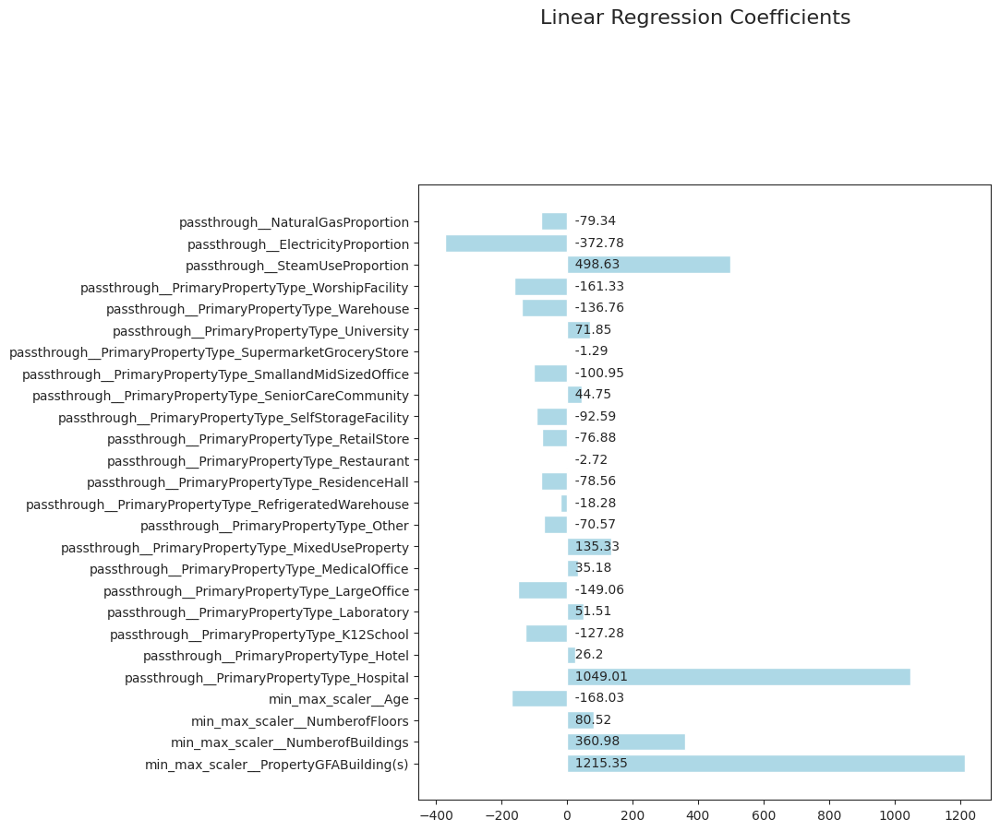

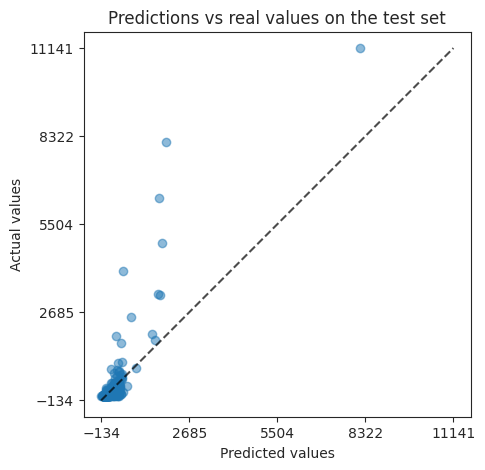

Cross-validation evaluation : 
    scores on folds:  [154.92  171.721 146.568 135.373 156.945]
    mean score:  153.106
    std score deviation:  12.015
Best parameter (CV score=-539.206):
{'ridge__alpha': 2.2758459260747865}
Best parameter (CV score=-525.615):
{'ridge__alpha': 0.6951927961775606}
Best parameter (CV score=-525.441):
{'ridge__alpha': 0.7878787878787878}


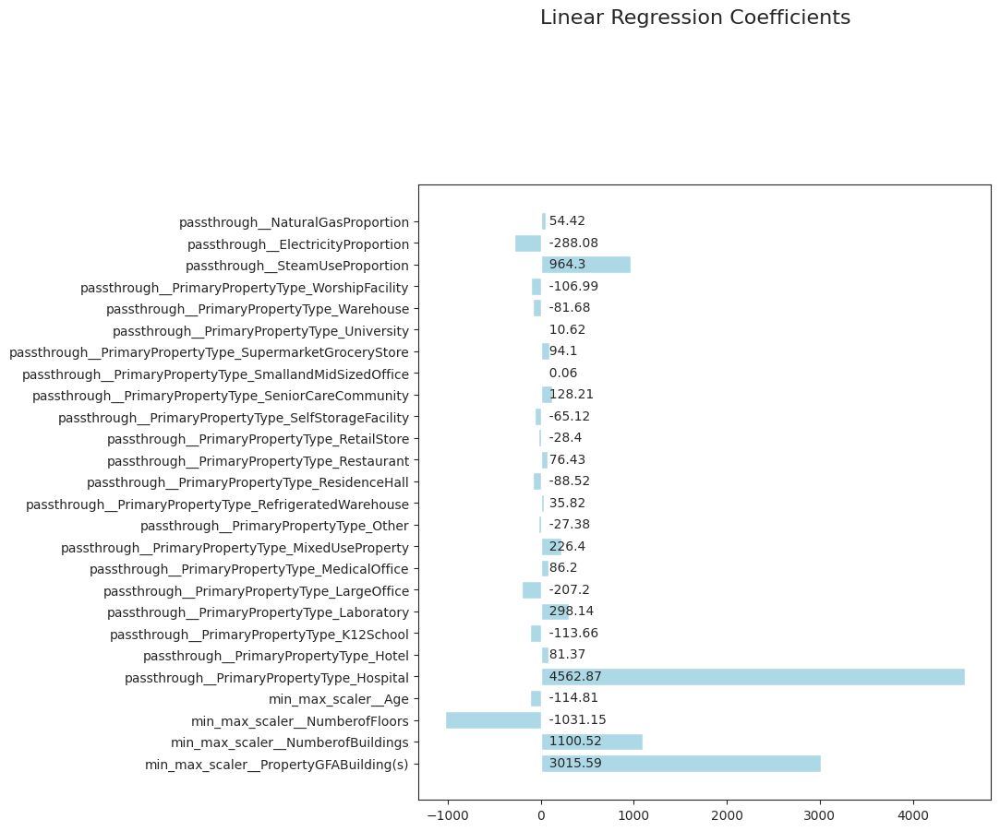

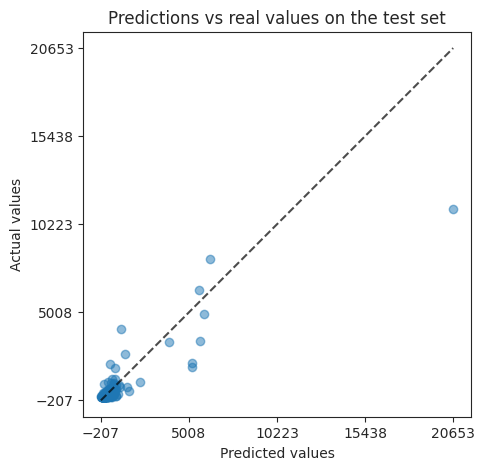

Cross-validation evaluation : 
    scores on folds:  [ 307.641 1093.091  418.921  297.502  450.557]
    mean score:  513.542
    std score deviation:  295.928


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,min_max,lasso,None,0.353,0.213,0.82439,NaN,{'lasso__alpha': 6.348484848484849},"[0.174, 0.069, 0.569, 0.337, 0.614]",0.39568,0
MAE,min_max,lasso,None,145.912,13.833,140.93527,NaN,{'lasso__alpha': 9.606060606060606},"[142.734, 166.931, 138.66, 126.543, 154.692]",141.74285,1
RMSE,min_max,lasso,None,526.118,298.439,407.49840,NaN,{'lasso__alpha': 4.242424242424242},"[299.355, 1096.168, 478.393, 271.11, 485.562]",573.51592,2
R2,min_max,ridge,None,0.336,0.154,0.77095,NaN,{'ridge__alpha': 5.909090909090909},"[0.289, 0.065, 0.47, 0.366, 0.492]",0.35378,3
MAE,min_max,ridge,None,153.106,12.015,178.53315,NaN,{'ridge__alpha': 16.494949494949495},"[154.92, 171.721, 146.568, 135.373, 156.945]",149.08165,4
RMSE,min_max,ridge,None,513.542,295.928,637.48581,NaN,{'ridge__alpha': 0.7878787878787878},"[307.641, 1093.091, 418.921, 297.502, 450.557]",559.07081,5


In [39]:
show_plot = True
show_scores = False
show_regressor_input = False
silent = False

regressor_name = "ridge"

# Create the full model
model = Pipeline(
    [
        ("pre_processor", pp),
        ("ridge", Ridge(random_state=0, max_iter=100_000)),
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    alphas = np.logspace(-5, 10, 15)
    param_grid = [{"ridge__alpha": alphas}]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    # Refining the gridsearch
    new_alphas = log_grid_around_previous_best(
        search.best_params_["ridge__alpha"]
    )
    param_grid = [{"ridge__alpha": new_alphas}]
    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    # Refining manually
    lower_bound = float(input("lower bound for alpha ?"))
    upper_bound = float(input("upper bound for alpha ?"))
    new_alphas = np.linspace(lower_bound, upper_bound, 100)
    param_grid = [{"ridge__alpha": new_alphas}]
    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Define, fit the best model with lasso
    model = Pipeline(
        [
            ("pre_processor", pp),
            ("ridge", Ridge(
                    alpha=search.best_params_["ridge__alpha"],
                    random_state=0,
                    max_iter=100_000
                )
             ),
        ]
    )
    model.fit(X_train, y_train)
    # save the model
    models_regul.append(model)

    # Predict
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model["ridge"], model[:-1].get_feature_names_out()
        )

        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model[:-1].transform(X_train), 
            index=X_train.index,
            columns=model[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")

    # add to results
    results_regul.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "ridge",
            "min_max",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1   
    
 

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_regul = pd.DataFrame(
results_regul, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_regul


### 5.1.3.  [&#9650;](#toc0_) <a id='toc5_1_3_'></a>Elastic-net

In [54]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False

regressor_name = "elastic_net"

# Create the full model
model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    param_grid = [
        {
            "elastic_net__alpha": np.logspace(-5, 5, 30),
            "elastic_net__l1_ratio": np.logspace(-5, 0, 5)
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


--------------------
metric : R2
--------------------
Best parameter (CV score=0.358):
{'elastic_net__alpha': 7.278953843983161, 'elastic_net__l1_ratio': 1.0}
--------------------
metric : MAE
--------------------
Best parameter (CV score=-147.497):
{'elastic_net__alpha': 7.278953843983161, 'elastic_net__l1_ratio': 1.0}
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-526.078):
{'elastic_net__alpha': 0.0011721022975334804, 'elastic_net__l1_ratio': 0.05623413251903491}


In [57]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False

regressor_name = "elastic_net"

# Create the full model
model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # More specific Gridsearch   
    param_grid = [
        {
            "elastic_net__alpha": np.logspace(-4, 2, 20),
            "elastic_net__l1_ratio": np.linspace(0.01, 1, 20)
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


--------------------
metric : R2
--------------------
Best parameter (CV score=0.358):
{'elastic_net__alpha': 5.455594781168514, 'elastic_net__l1_ratio': 1.0}
--------------------
metric : MAE
--------------------
Best parameter (CV score=-147.138):
{'elastic_net__alpha': 11.288378916846883, 'elastic_net__l1_ratio': 1.0}
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-525.437):
{'elastic_net__alpha': 0.01623776739188721, 'elastic_net__l1_ratio': 0.9478947368421053}


--------------------
metric : R2
--------------------
Best parameter (CV score=0.360):
{'elastic_net__alpha': 5.736152510448681, 'elastic_net__l1_ratio': 1.0}


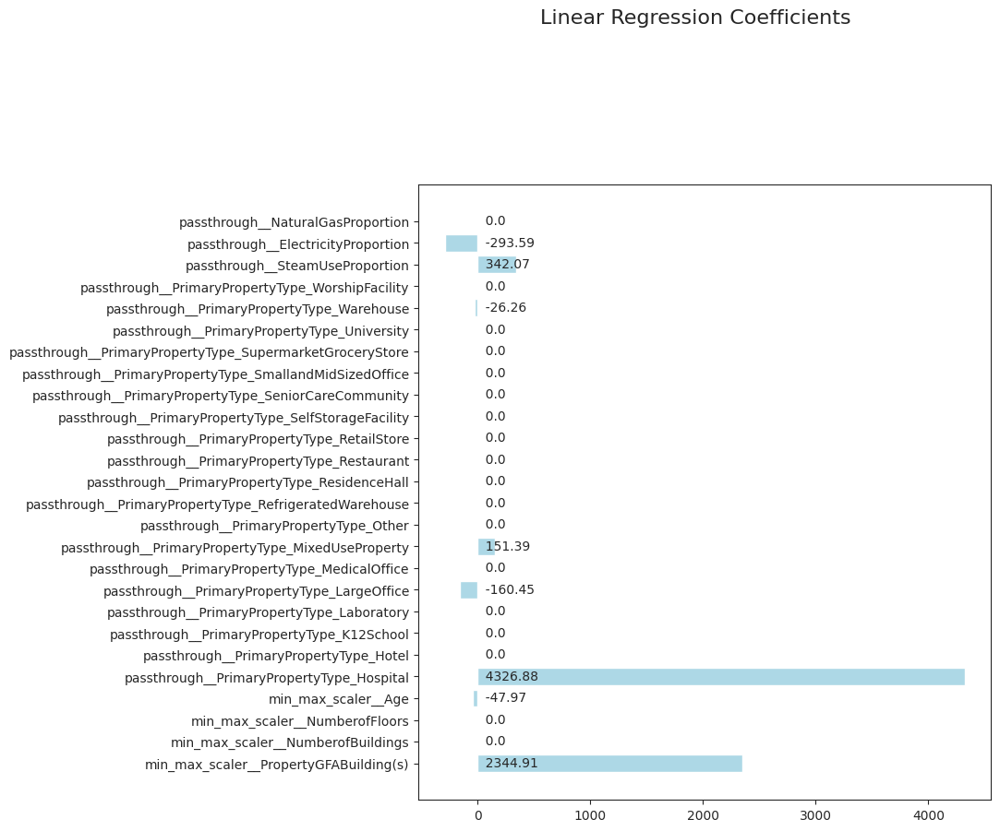

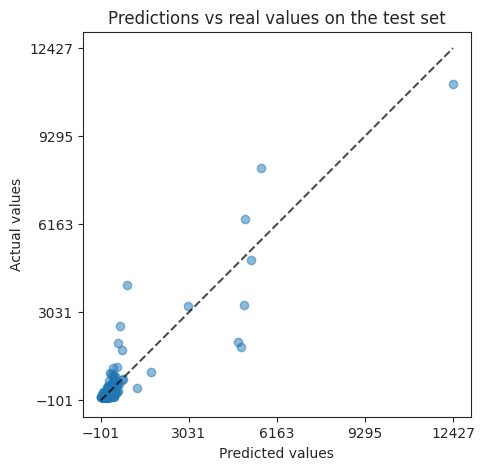

Cross-validation evaluation : 
    scores on folds:  [0.161 0.07  0.601 0.338 0.624]
    mean score:  0.359
    std score deviation:  0.225

Train score : 0.40257

Test score : 0.819
--------------------
metric : MAE
--------------------
Best parameter (CV score=-145.984):
{'elastic_net__alpha': 10.82636733874054, 'elastic_net__l1_ratio': 1.0}


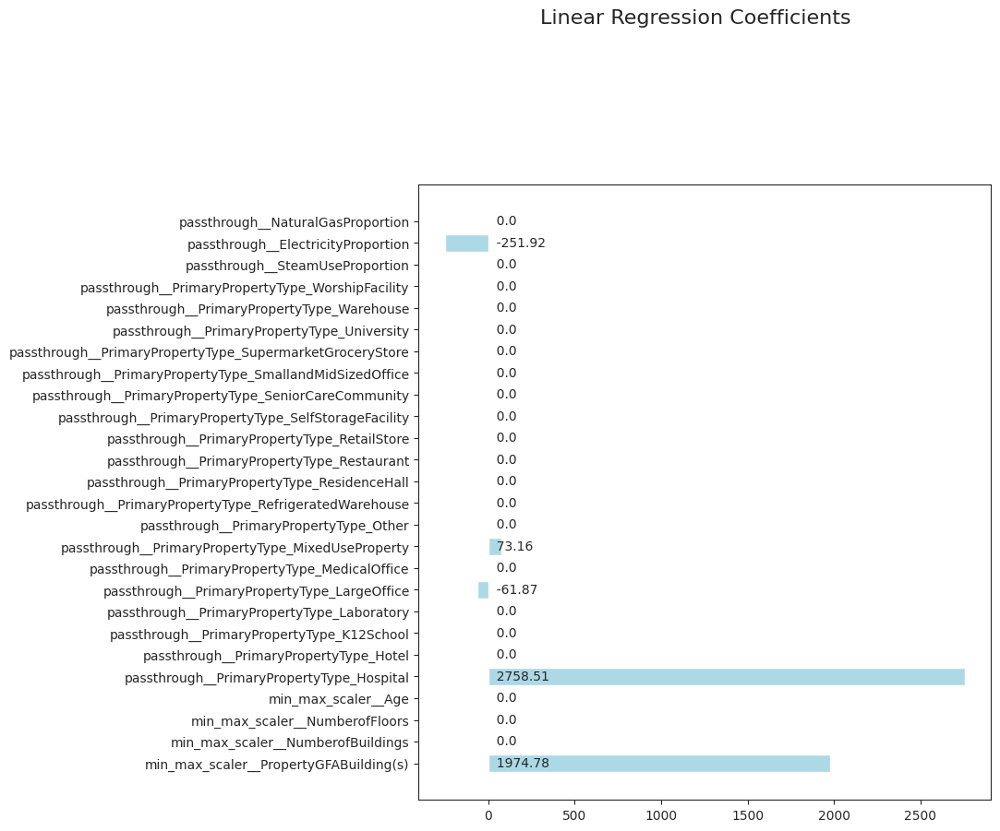

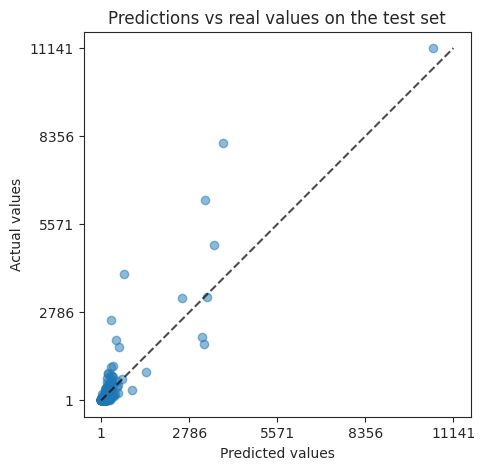

Cross-validation evaluation : 
    scores on folds:  [139.56  169.31  142.323 127.669 156.888]
    mean score:  147.15
    std score deviation:  14.466

Train score : 141.72623

Test score : 142.99941
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-525.403):
{'elastic_net__alpha': 0.02592943797404667, 'elastic_net__l1_ratio': 0.9666666666666667}


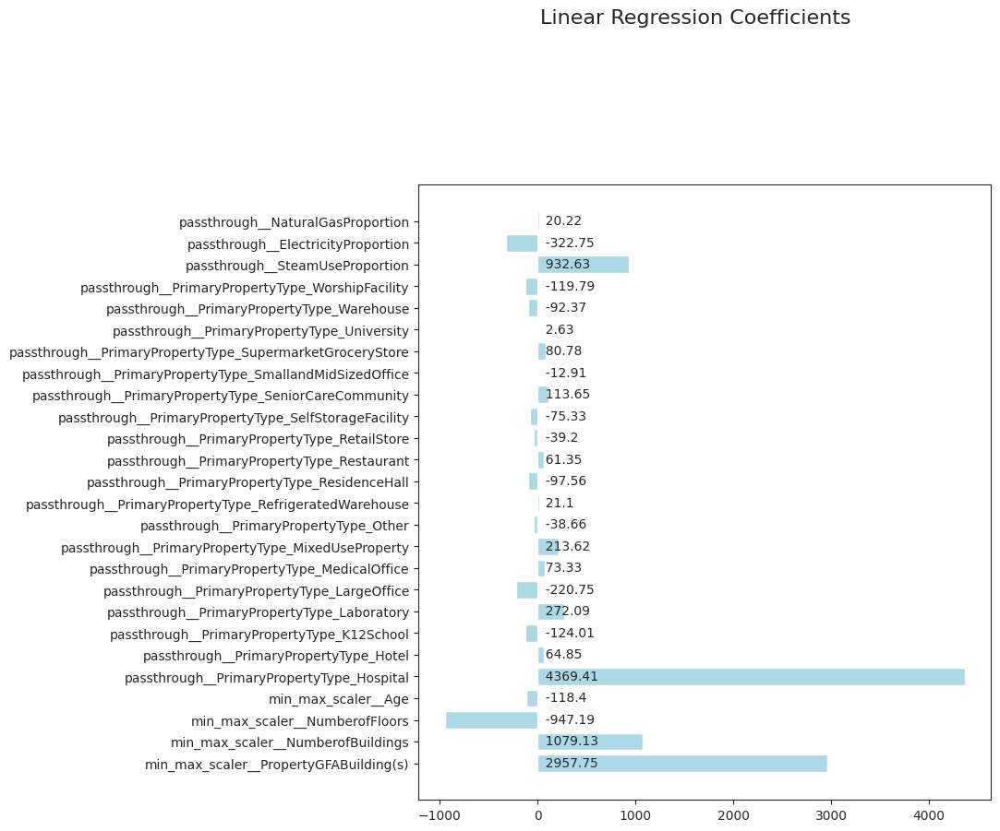

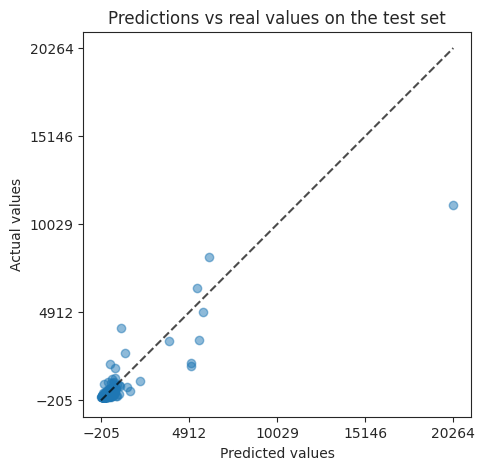

Cross-validation evaluation : 
    scores on folds:  [ 307.784 1093.006  417.922  297.759  451.085]
    mean score:  513.511
    std score deviation:  295.879

Train score : 560.7224

Test score : 615.87785


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,min_max,lasso,None,0.353,0.213,0.82439,NaN,{'lasso__alpha': 6.348484848484849},"[0.174, 0.069, 0.569, 0.337, 0.614]",0.39568,0
MAE,min_max,lasso,None,145.912,13.833,140.93527,NaN,{'lasso__alpha': 9.606060606060606},"[142.734, 166.931, 138.66, 126.543, 154.692]",141.74285,1
RMSE,min_max,lasso,None,526.118,298.439,407.49840,NaN,{'lasso__alpha': 4.242424242424242},"[299.355, 1096.168, 478.393, 271.11, 485.562]",573.51592,2
R2,min_max,ridge,None,0.336,0.154,0.77095,NaN,{'ridge__alpha': 5.909090909090909},"[0.289, 0.065, 0.47, 0.366, 0.492]",0.35378,3
MAE,min_max,ridge,None,153.106,12.015,178.53315,NaN,{'ridge__alpha': 16.494949494949495},"[154.92, 171.721, 146.568, 135.373, 156.945]",149.08165,4
RMSE,min_max,ridge,None,513.542,295.928,637.48581,NaN,{'ridge__alpha': 0.7878787878787878},"[307.641, 1093.091, 418.921, 297.502, 450.557]",559.07081,5
R2,min_max,elastic_net,None,0.354,0.216,0.82335,NaN,"{'elastic_net__alpha': 6.2101694189156165, 'elastic_net__l1_ratio': 1.0}","[0.171, 0.069, 0.577, 0.337, 0.616]",0.39730,6
MAE,min_max,elastic_net,None,146.101,13.784,141.53185,NaN,"{'elastic_net__alpha': 10.0, 'elastic_net__l1_ratio': 1.0}","[141.682, 167.538, 139.577, 127.192, 154.518]",141.61206,7
R2,min_max,elastic_net,None,0.359,0.225,0.81900,NaN,"{'elastic_net__alpha': 5.736152510448681, 'elastic_net__l1_ratio': 1.0}","[0.161, 0.07, 0.601, 0.338, 0.624]",0.40257,6


In [61]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False

regressor_name = "elastic_net"

# Create the full model
model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Final specific Gridsearch   
    param_grid = [
        {
            "elastic_net__alpha": np.logspace(-2, 2, 30),
            "elastic_net__l1_ratio": np.linspace(0.9, 1, 10)
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Extract the best model
    model = search.best_estimator_
    model.fit(X_train, y_train)
    # save the model
    models_regul.append(model)

    # Predict
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model[regressor_name], model[:-1].get_feature_names_out()
        )

        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model[:-1].transform(X_train), 
            index=X_train.index,
            columns=model[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")

    # add to results
    results_regul.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "elastic_net",
            "min_max",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_regul = pd.DataFrame(
results_regul, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_regul


It is much more longer to tune the hyperparameters of the elastic_net model (2min per metric) than it is for the lasso and ridge models (only a few seconds).

## 5.2.  [&#9650;](#toc0_) <a id='toc5_2_'></a>With log and min_max preprocessing, and log transformation on target

### 5.2.1.  [&#9650;](#toc0_) <a id='toc5_2_1_'></a>Lasso and Ridge

--------------------
lasso
--------------------


TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_SupermarketGroceryStore',
                                                                                        'PrimaryPropertyType_University',
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('lasso',
                                                      Lasso(max_iter=100000,
                                                            random_state=2))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

--------------------
metric : R2
--------------------
Best parameter (CV score=0.641):
{'regressor__lasso__alpha': 0.0013894954943731374}
Best parameter (CV score=0.642):
{'regressor__lasso__alpha': 0.0014384498882876629}
Best parameter (CV score=0.642):
{'regressor__lasso__alpha': 0.0014727272727272727}


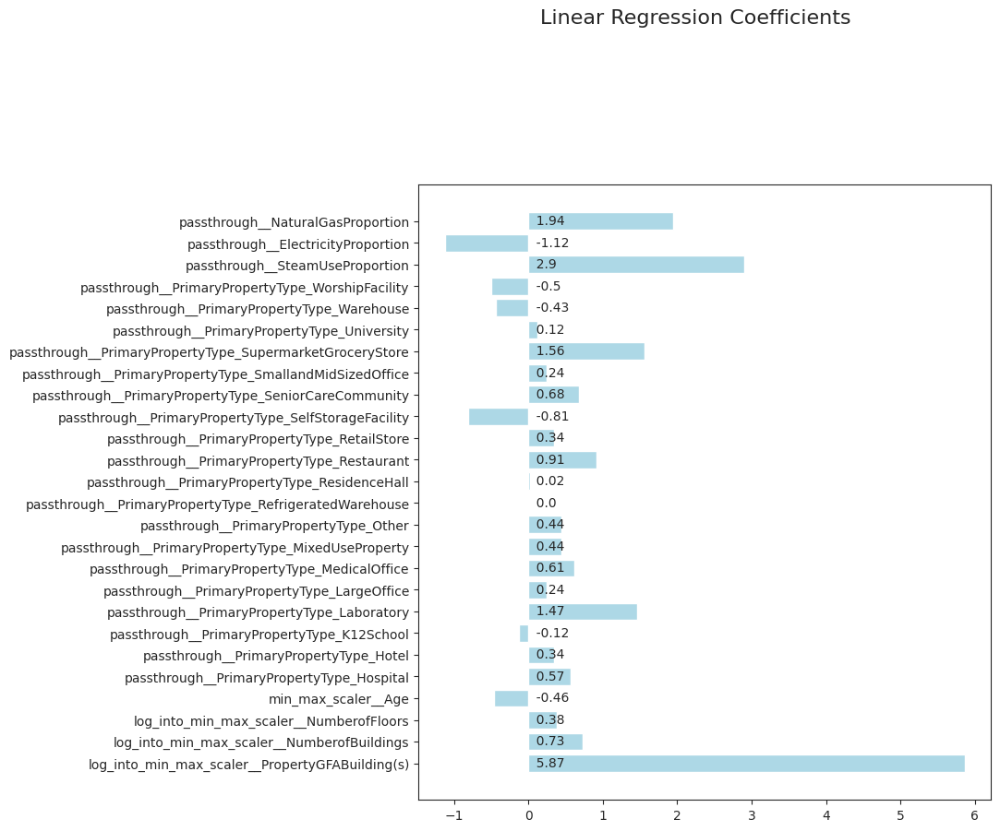

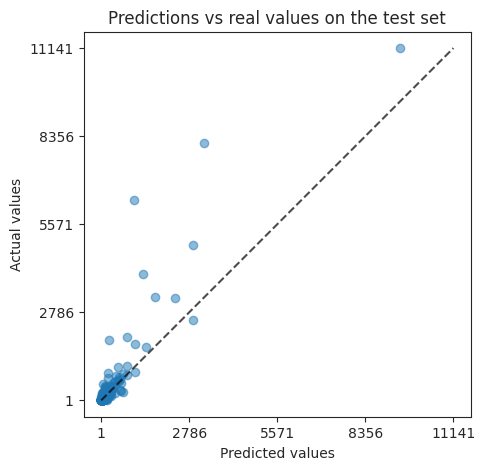

Cross-validation evaluation : 
    scores on folds:  [0.684 0.185 0.978 0.827 0.568]
    mean score:  0.648
    std score deviation:  0.27

Train score : 0.56036

Test score : 0.74571
--------------------
metric : MAE
--------------------
Best parameter (CV score=-84.342):
{'regressor__lasso__alpha': 0.0013894954943731374}
Best parameter (CV score=-84.168):
{'regressor__lasso__alpha': 0.0014384498882876629}
Best parameter (CV score=-83.636):
{'regressor__lasso__alpha': 0.0016}


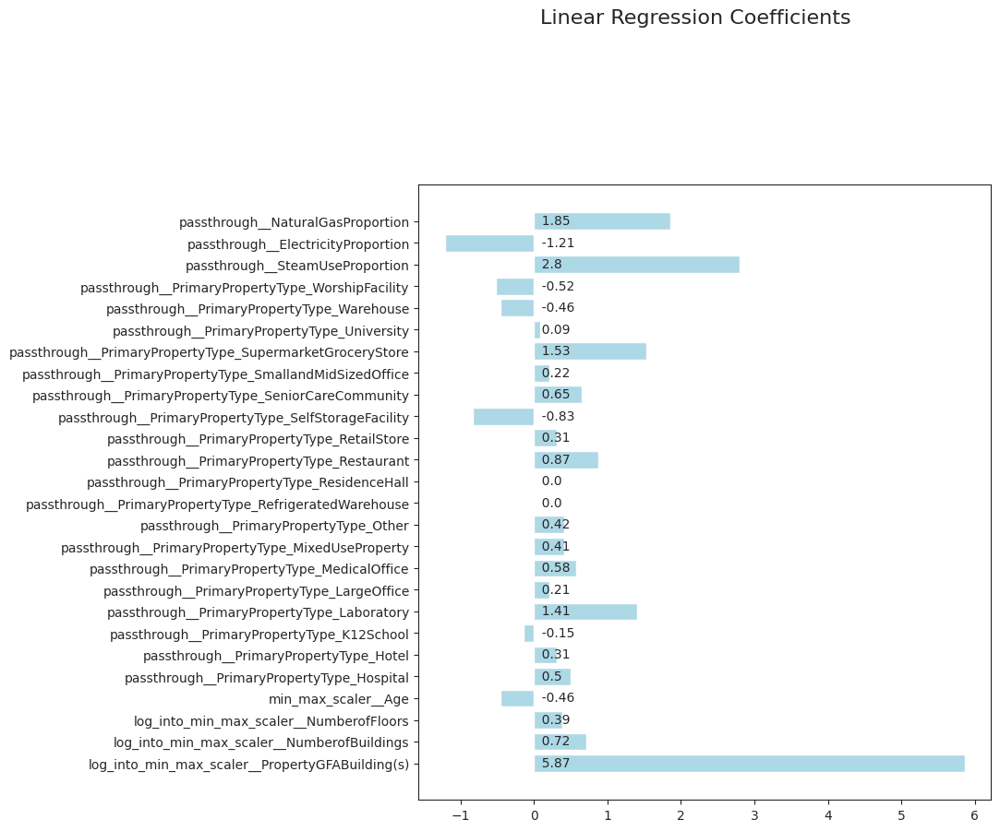

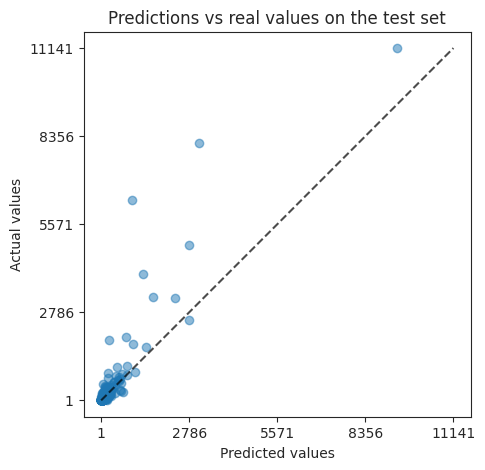

Cross-validation evaluation : 
    scores on folds:  [ 67.549 134.097  50.603  57.572  99.9  ]
    mean score:  81.944
    std score deviation:  31.067

Train score : 79.79409

Test score : 108.9636
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-404.906):
{'regressor__lasso__alpha': 0.0013894954943731374}
Best parameter (CV score=-401.823):
{'regressor__lasso__alpha': 0.0018329807108324356}
Best parameter (CV score=-397.196):
{'regressor__lasso__alpha': 0.0016414141414141414}


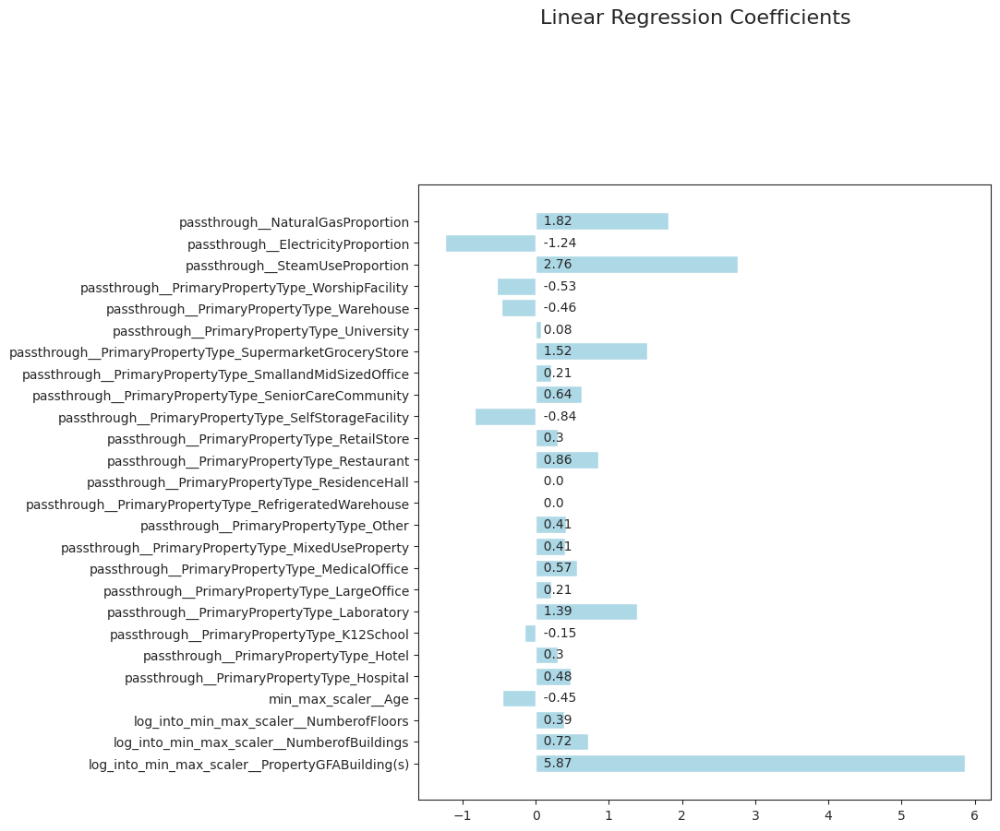

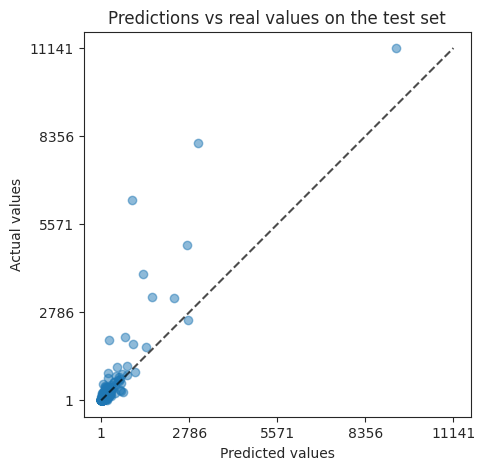

Cross-validation evaluation : 
    scores on folds:  [ 179.974 1027.172  101.239  142.424  512.636]
    mean score:  392.689
    std score deviation:  349.222

Train score : 503.57969

Test score : 469.01308
--------------------
ridge
--------------------


TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_SupermarketGroceryStore',
                                                                                        'PrimaryPropertyType_University',
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('ridge',
                                                      Ridge(max_iter=100000,
                                                            random_state=2))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

--------------------
metric : R2
--------------------
Best parameter (CV score=0.593):
{'regressor__ridge__alpha': 2.2758459260747865}
Best parameter (CV score=0.648):
{'regressor__ridge__alpha': 0.8858667904100825}
Best parameter (CV score=0.649):
{'regressor__ridge__alpha': 0.983838383838384}


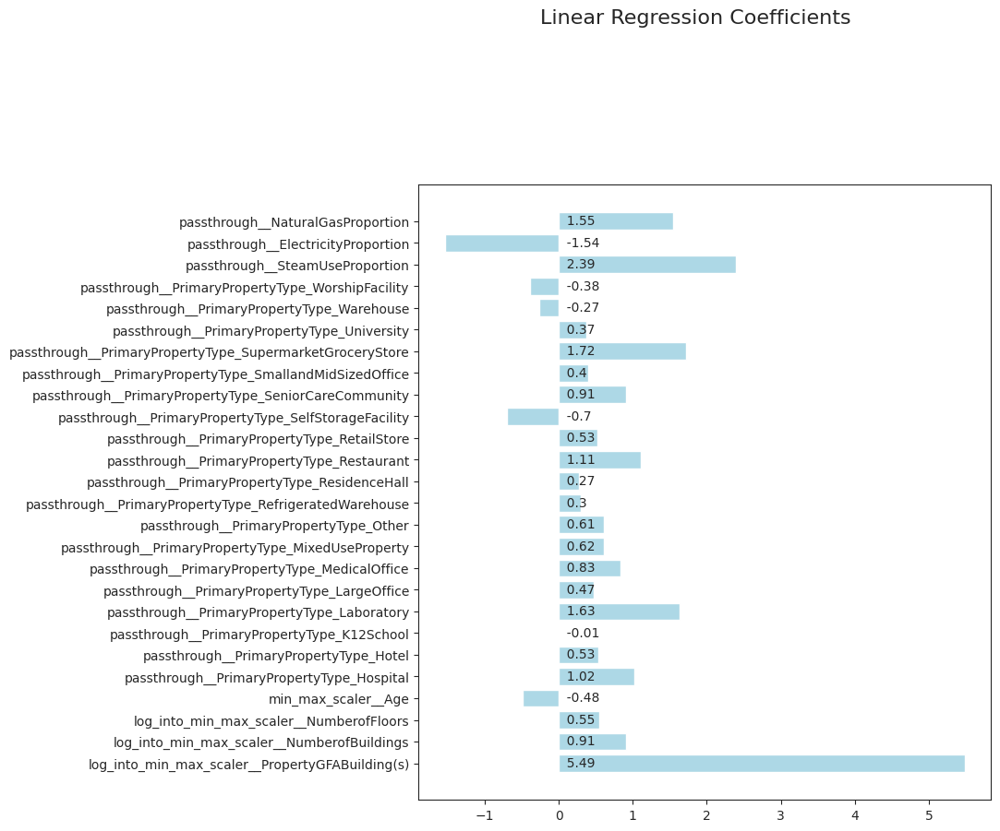

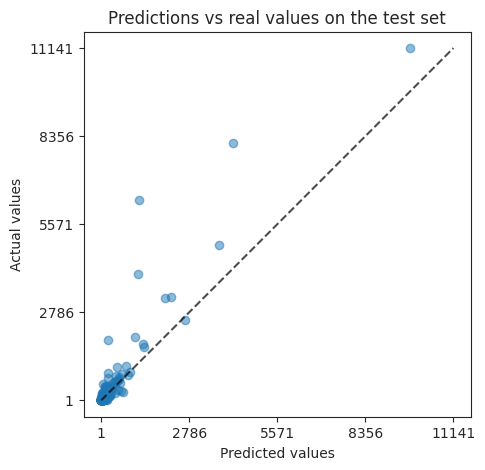

Cross-validation evaluation : 
    scores on folds:  [0.656 0.158 0.954 0.831 0.636]
    mean score:  0.647
    std score deviation:  0.271

Train score : 0.5646

Test score : 0.79166
--------------------
metric : MAE
--------------------
Best parameter (CV score=-88.812):
{'regressor__ridge__alpha': 0.19306977288832497}
Best parameter (CV score=-84.545):
{'regressor__ridge__alpha': 1.0}
Best parameter (CV score=-83.792):
{'regressor__ridge__alpha': 1.390909090909091}


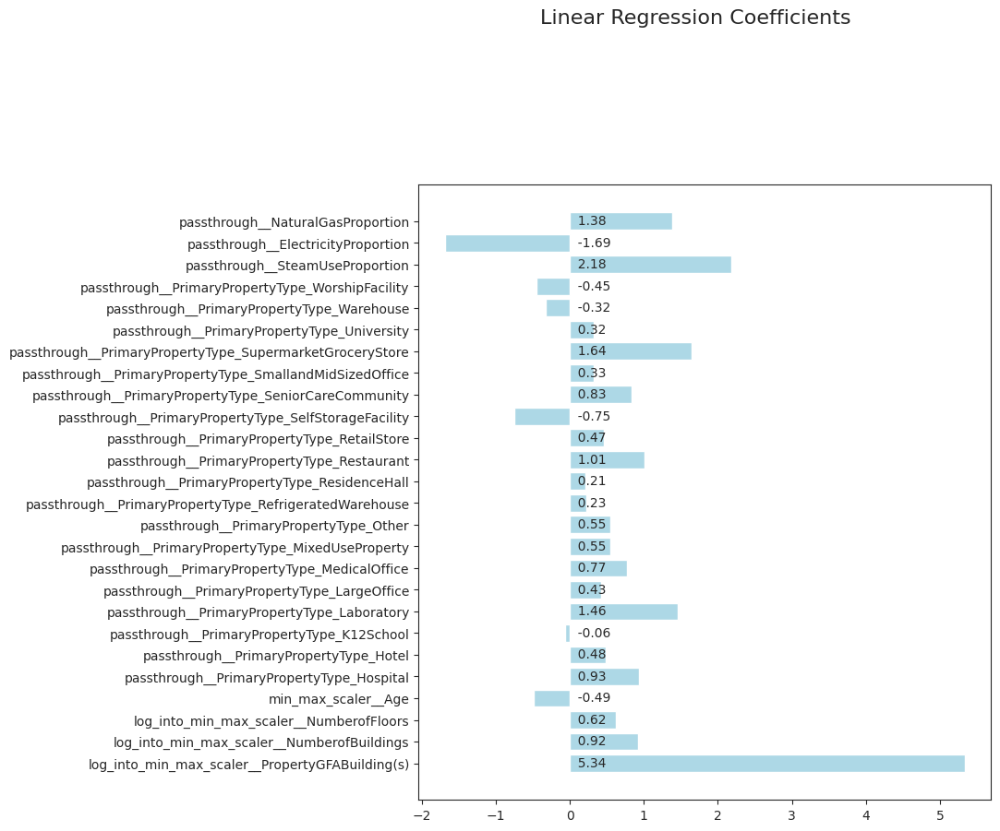

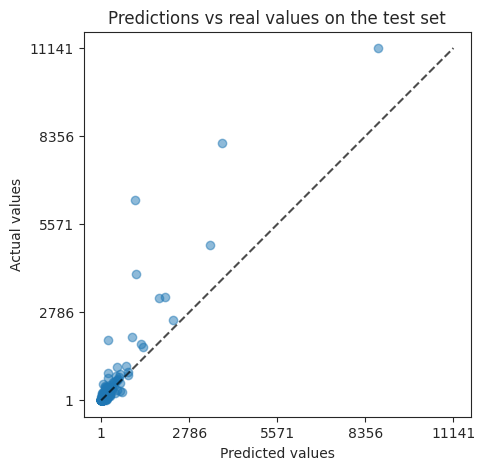

Cross-validation evaluation : 
    scores on folds:  [ 70.599 135.776  50.616  59.337 100.213]
    mean score:  83.308
    std score deviation:  31.124

Train score : 78.64983

Test score : 107.30543
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-440.489):
{'regressor__ridge__alpha': 2.2758459260747865}
Best parameter (CV score=-399.429):
{'regressor__ridge__alpha': 1.438449888287663}
Best parameter (CV score=-397.524):
{'regressor__ridge__alpha': 1.301010101010101}


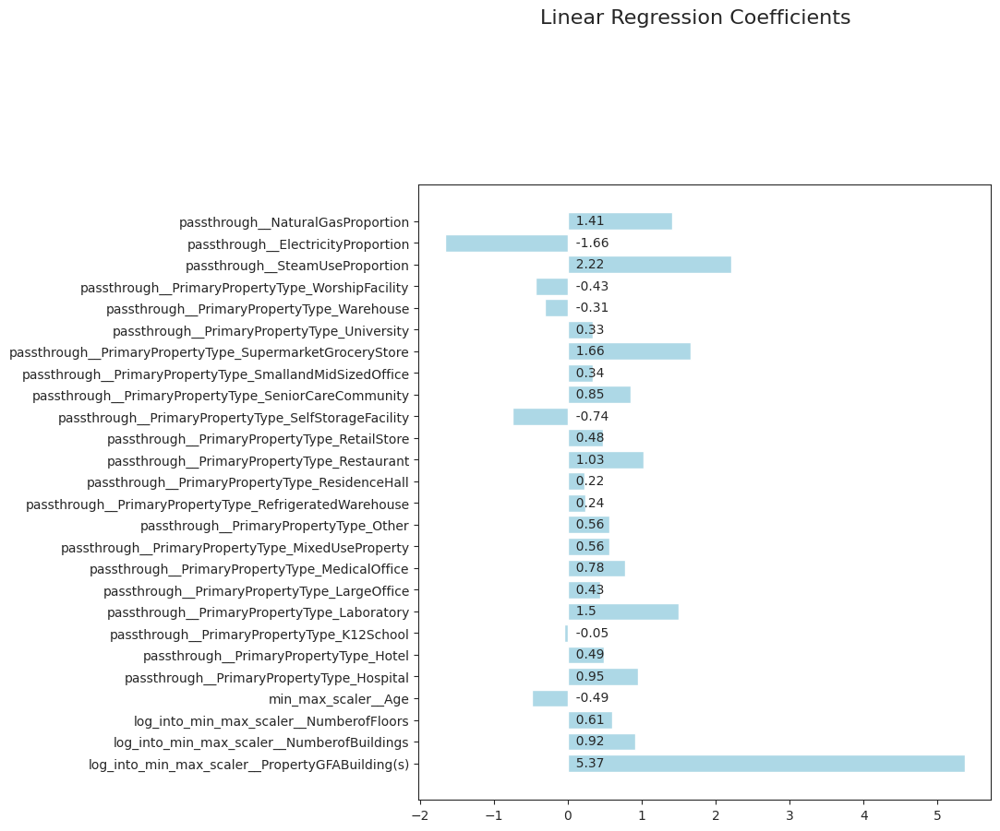

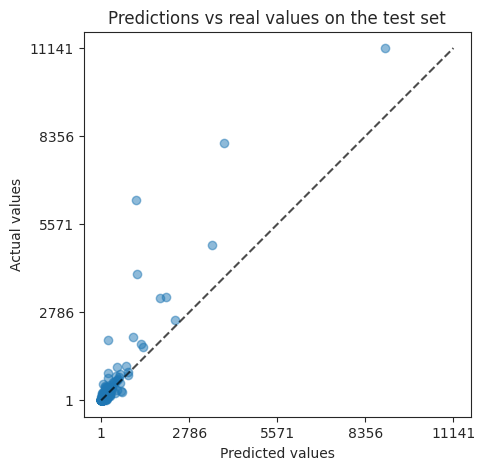

Cross-validation evaluation : 
    scores on folds:  [ 191.194 1048.325  106.589  145.496  491.599]
    mean score:  396.641
    std score deviation:  353.022

Train score : 500.95783

Test score : 437.98558


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,min_max,lasso,None,0.353,0.213,0.82439,NaN,{'lasso__alpha': 6.348484848484849},"[0.174, 0.069, 0.569, 0.337, 0.614]",0.39568,0
MAE,min_max,lasso,None,145.912,13.833,140.93527,NaN,{'lasso__alpha': 9.606060606060606},"[142.734, 166.931, 138.66, 126.543, 154.692]",141.74285,1
RMSE,min_max,lasso,None,526.118,298.439,407.49840,NaN,{'lasso__alpha': 4.242424242424242},"[299.355, 1096.168, 478.393, 271.11, 485.562]",573.51592,2
R2,min_max,ridge,None,0.336,0.154,0.77095,NaN,{'ridge__alpha': 5.909090909090909},"[0.289, 0.065, 0.47, 0.366, 0.492]",0.35378,3
MAE,min_max,ridge,None,153.106,12.015,178.53315,NaN,{'ridge__alpha': 16.494949494949495},"[154.92, 171.721, 146.568, 135.373, 156.945]",149.08165,4
RMSE,min_max,ridge,None,513.542,295.928,637.48581,NaN,{'ridge__alpha': 0.7878787878787878},"[307.641, 1093.091, 418.921, 297.502, 450.557]",559.07081,5
R2,min_max,elastic_net,None,0.354,0.216,0.82335,NaN,"{'elastic_net__alpha': 6.2101694189156165, 'elastic_net__l1_ratio': 1.0}","[0.171, 0.069, 0.577, 0.337, 0.616]",0.39730,6
MAE,min_max,elastic_net,None,146.101,13.784,141.53185,NaN,"{'elastic_net__alpha': 10.0, 'elastic_net__l1_ratio': 1.0}","[141.682, 167.538, 139.577, 127.192, 154.518]",141.61206,7
R2,min_max,elastic_net,None,0.359,0.225,0.81900,NaN,"{'elastic_net__alpha': 5.736152510448681, 'elastic_net__l1_ratio': 1.0}","[0.161, 0.07, 0.601, 0.338, 0.624]",0.40257,6


In [63]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False

# Select the mixed_log_min_max_scaler pre_processor
pp = pre_processors[3]

# Loop on regressors
regressors_names = ["lasso", "ridge"]
for regressor_name in regressors_names:
    print("-" * 20)
    print(regressor_name)
    print("-" * 20)
    # Create the model
    regressor = instantiate_regressor(regressors.loc[regressor_name])
    first_step_model = Pipeline(
        [
            ("pre_processor", pp),
            (regressor_name, regressor),
        ]
    )
    # Add target transformation
    model = TransformedTargetRegressor(
        regressor=first_step_model,
        transformer=log_transformer
    )
    display(model)

    # Define the metric for the grid search and the evaluation.
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)
            
        # Initial Gridsearch
        param_name = "regressor__" + regressor_name + "__alpha"
        alphas = np.logspace(-5, 10, 15)
        param_grid = [{param_name: alphas}]
        n_folds = 5

        search = GridSearchCV(
            model, param_grid=param_grid,
            scoring=metric.scoring_alias, cv=n_folds
        )
        search.fit(X_train, y_train)
        print("Best parameter (CV score=%0.3f):" % search.best_score_)
        print(search.best_params_)

        # Refining the gridsearch
        new_alphas = log_grid_around_previous_best(
            search.best_params_[param_name]
        )
        param_grid = [{param_name: new_alphas}]
        search = GridSearchCV(
            model, param_grid=param_grid,
            scoring=metric.scoring_alias, cv=n_folds
        )
        search.fit(X_train, y_train)
        print("Best parameter (CV score=%0.3f):" % search.best_score_)
        print(search.best_params_)

        # Refining manually
        lower_bound = float(input("lower bound for alpha ?"))
        upper_bound = float(input("upper bound for alpha ?"))
        new_alphas = np.linspace(lower_bound, upper_bound, 100)
        param_grid = [{param_name: new_alphas}]
        search = GridSearchCV(
            model, param_grid=param_grid,
            scoring=metric.scoring_alias, cv=n_folds
        )
        search.fit(X_train, y_train)
        print("Best parameter (CV score=%0.3f):" % search.best_score_)
        print(search.best_params_)
        
        # extract the best model of the grid search
        model = search.best_estimator_
        hyperparameters = search.best_params_
        computation_time = np.NaN

        # save the model
        models_regul.append(model)

        # Predict
        pred_train = model.predict(X_train)
        pred_test = model.predict(X_test)


        if show_plot:
            # Observing the coefficients of the regression model
            ds.linearRegressionSummary(
                model.regressor_[regressor_name], 
                model.regressor_[:-1].get_feature_names_out()
            )

            # displaying predictions vs real values
            _, ax = plt.subplots(figsize=(5, 5))
            _ = PredictionErrorDisplay.from_predictions(
                y_test, pred_test, kind="actual_vs_predicted",
                ax=ax, scatter_kwargs={"alpha": 0.5}
            )
            ax.set_title("Predictions vs real values on the test set")
            plt.show()

        if show_regressor_input:
            # displaying the inputs after the preprocessing stage
            pre_processed_inputs = pd.DataFrame(
                model.regressor_[:-1].transform(X_train), 
                index=X_train.index,
                columns=model.regressor_[:-1].get_feature_names_out()
            )
            display(pre_processed_inputs)   

        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0,
                silent=silent
            )    
        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")


        # add to results
        results_regul.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                regressor_name,
                "mixed_log_min_max",
                metric.name,
                "log",
                models_idx          
            ]
        )
        models_idx += 1   
        
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_regul = pd.DataFrame(
results_regul, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_regul

### 5.2.2.  [&#9650;](#toc0_) <a id='toc5_2_2_'></a>ElasticNet

In [69]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False
save_model = True

regressor_name = "elastic_net"

# Create the model
first_step_model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Add target transformation
model = TransformedTargetRegressor(
    regressor=first_step_model,
    transformer=log_transformer
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    param_name_alpha = "regressor__" + regressor_name + "__alpha"
    param_name_l1_ratio = "regressor__" + regressor_name + "__l1_ratio"
    param_grid = [
        {
            param_name_alpha: np.logspace(-5, 3, 15),
            param_name_l1_ratio: np.logspace(-5, 0, 10)
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


--------------------
metric : R2
--------------------
Best parameter (CV score=0.634):
{'regressor__elastic_net__alpha': 0.0019306977288832496, 'regressor__elastic_net__l1_ratio': 1.0}
--------------------
metric : MAE
--------------------
Best parameter (CV score=-85.249):
{'regressor__elastic_net__alpha': 0.0019306977288832496, 'regressor__elastic_net__l1_ratio': 1.0}
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-406.709):
{'regressor__elastic_net__alpha': 0.0019306977288832496, 'regressor__elastic_net__l1_ratio': 1.0}


In [70]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False
save_model = True

regressor_name = "elastic_net"

# Create the model
first_step_model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Add target transformation
model = TransformedTargetRegressor(
    regressor=first_step_model,
    transformer=log_transformer
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    param_name_alpha = "regressor__" + regressor_name + "__alpha"
    param_name_l1_ratio = "regressor__" + regressor_name + "__l1_ratio"
    param_grid = [
        {
            param_name_alpha: np.logspace(-3, -2, 20),
            param_name_l1_ratio: np.linspace(0.1, 1, 20)
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


--------------------
metric : R2
--------------------
Best parameter (CV score=0.647):
{'regressor__elastic_net__alpha': 0.0011288378916846896, 'regressor__elastic_net__l1_ratio': 0.1}
--------------------
metric : MAE
--------------------
Best parameter (CV score=-83.559):
{'regressor__elastic_net__alpha': 0.001623776739188721, 'regressor__elastic_net__l1_ratio': 1.0}
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-397.261):
{'regressor__elastic_net__alpha': 0.001623776739188721, 'regressor__elastic_net__l1_ratio': 1.0}


--------------------
metric : R2
--------------------
Best parameter (CV score=0.642):
{'regressor__elastic_net__alpha': 0.0014693877551020407, 'regressor__elastic_net__l1_ratio': 1}


TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('elastic_net',
                                                      ElasticNet(alpha=0.0014693877551020407,
                                                                 l1_ratio=1,
                                                                 max_iter=100000,
                                                                 random_state=0))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

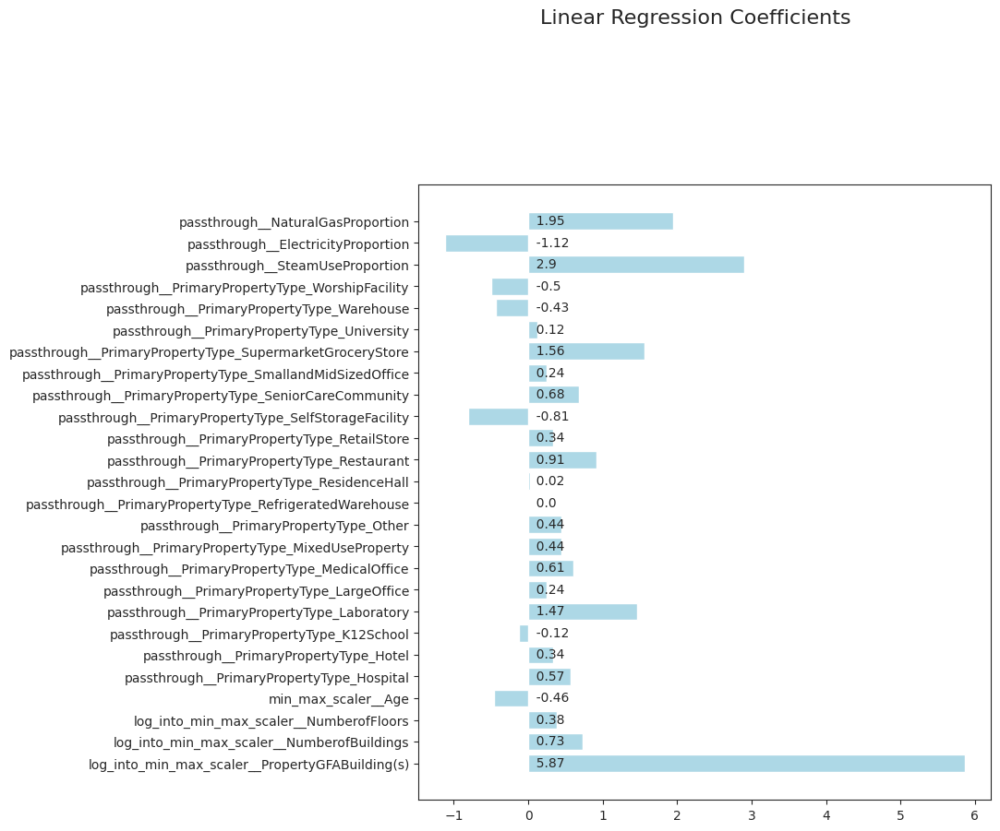

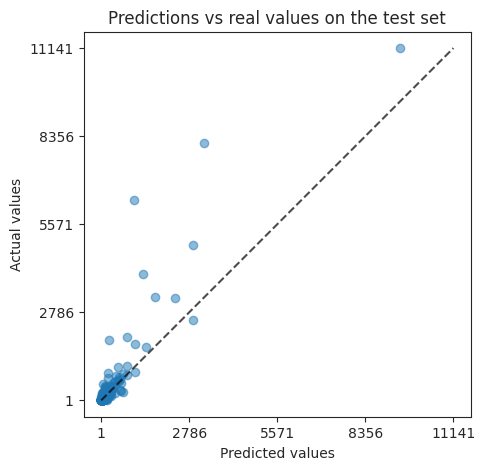

Cross-validation evaluation : 
    scores on folds:  [0.684 0.185 0.978 0.827 0.568]
    mean score:  0.648
    std score deviation:  0.27

Train score : 0.56054

Test score : 0.74599
--------------------
metric : MAE
--------------------
Best parameter (CV score=-83.435):
{'regressor__elastic_net__alpha': 0.001673469387755102, 'regressor__elastic_net__l1_ratio': 1}


TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('elastic_net',
                                                      ElasticNet(alpha=0.001673469387755102,
                                                                 l1_ratio=1,
                                                                 max_iter=100000,
                                                                 random_state=0))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

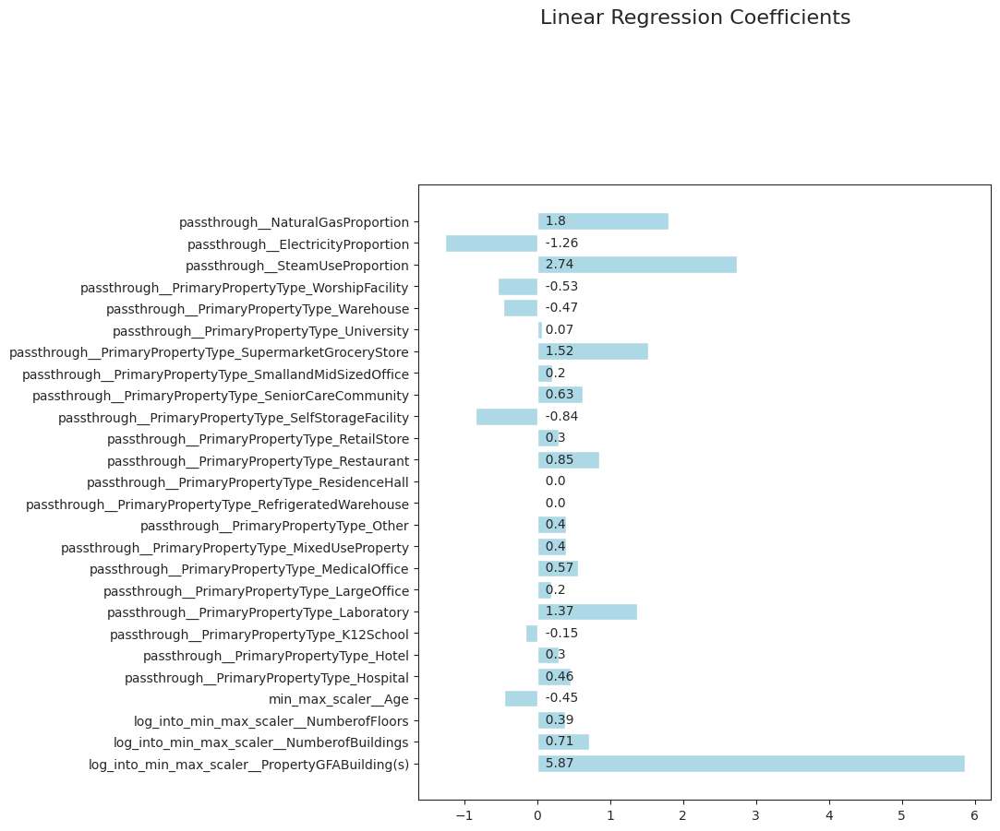

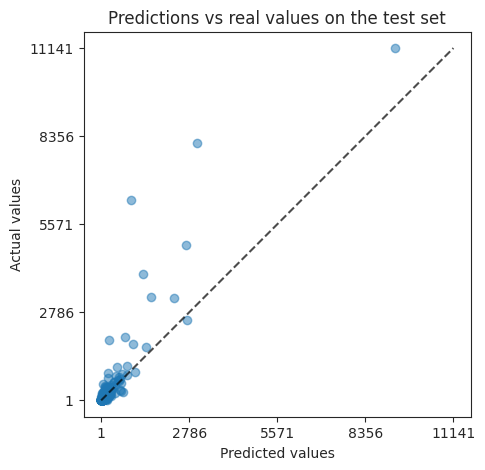

Cross-validation evaluation : 
    scores on folds:  [ 67.595 134.173  50.123  57.879  99.85 ]
    mean score:  81.924
    std score deviation:  31.132

Train score : 80.37409

Test score : 109.76719
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-397.204):
{'regressor__elastic_net__alpha': 0.001653061224489796, 'regressor__elastic_net__l1_ratio': 1}


TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('elastic_net',
                                                      ElasticNet(alpha=0.001653061224489796,
                                                                 l1_ratio=1,
                                                                 max_iter=100000,
                                                                 random_state=0))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

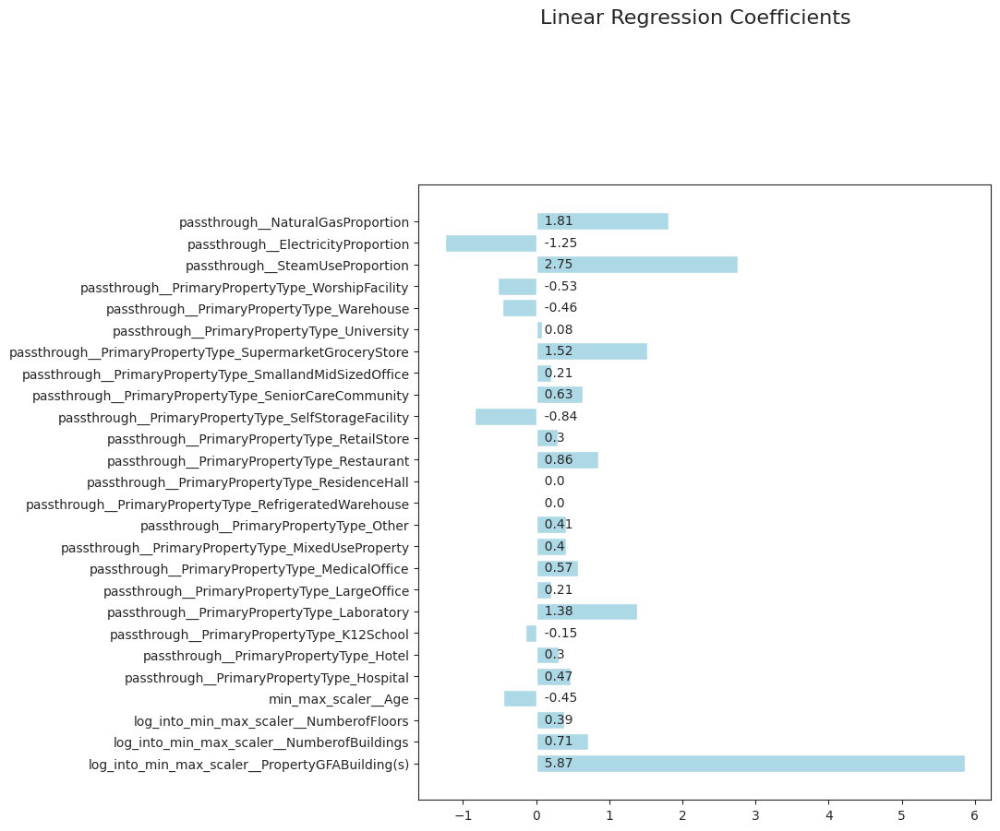

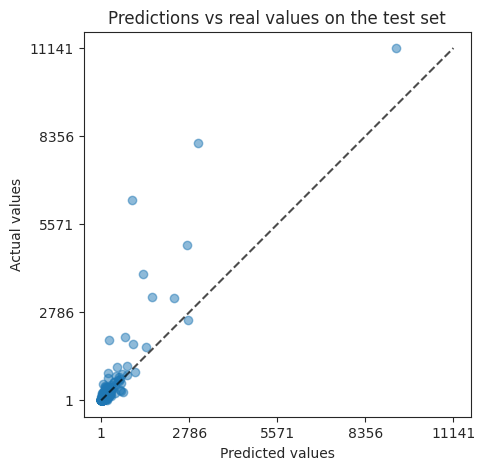

Cross-validation evaluation : 
    scores on folds:  [ 179.982 1027.227  101.257  142.669  512.428]
    mean score:  392.713
    std score deviation:  349.189

Train score : 503.99549

Test score : 469.84772


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,min_max,lasso,None,0.353,0.213,0.82439,NaN,{'lasso__alpha': 6.348484848484849},"[0.174, 0.069, 0.569, 0.337, 0.614]",0.39568,0
MAE,min_max,lasso,None,145.912,13.833,140.93527,NaN,{'lasso__alpha': 9.606060606060606},"[142.734, 166.931, 138.66, 126.543, 154.692]",141.74285,1
RMSE,min_max,lasso,None,526.118,298.439,407.49840,NaN,{'lasso__alpha': 4.242424242424242},"[299.355, 1096.168, 478.393, 271.11, 485.562]",573.51592,2
R2,min_max,ridge,None,0.336,0.154,0.77095,NaN,{'ridge__alpha': 5.909090909090909},"[0.289, 0.065, 0.47, 0.366, 0.492]",0.35378,3
MAE,min_max,ridge,None,153.106,12.015,178.53315,NaN,{'ridge__alpha': 16.494949494949495},"[154.92, 171.721, 146.568, 135.373, 156.945]",149.08165,4
RMSE,min_max,ridge,None,513.542,295.928,637.48581,NaN,{'ridge__alpha': 0.7878787878787878},"[307.641, 1093.091, 418.921, 297.502, 450.557]",559.07081,5
R2,min_max,elastic_net,None,0.354,0.216,0.82335,NaN,"{'elastic_net__alpha': 6.2101694189156165, 'elastic_net__l1_ratio': 1.0}","[0.171, 0.069, 0.577, 0.337, 0.616]",0.39730,6
MAE,min_max,elastic_net,None,146.101,13.784,141.53185,NaN,"{'elastic_net__alpha': 10.0, 'elastic_net__l1_ratio': 1.0}","[141.682, 167.538, 139.577, 127.192, 154.518]",141.61206,7
R2,min_max,elastic_net,None,0.359,0.225,0.81900,NaN,"{'elastic_net__alpha': 5.736152510448681, 'elastic_net__l1_ratio': 1.0}","[0.161, 0.07, 0.601, 0.338, 0.624]",0.40257,6


In [71]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False
save_model = True

regressor_name = "elastic_net"

# Create the model
first_step_model = Pipeline(
    [
        ("pre_processor", pp),
        ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
    ]
)

# Add target transformation
model = TransformedTargetRegressor(
    regressor=first_step_model,
    transformer=log_transformer
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    param_name_alpha = "regressor__" + regressor_name + "__alpha"
    param_name_l1_ratio = "regressor__" + regressor_name + "__l1_ratio"
    param_grid = [
        {
            param_name_alpha: np.linspace(0.001, 0.002, 50),
            param_name_l1_ratio: [0.98, 1]
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)


    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Extract the best model
    model = search.best_estimator_
    display(model)
    model.fit(X_train, y_train)
    # save the model
    if save_model:
        models_regul.append(model)

    # Predict
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # Observing the coefficients of the regression model
        ds.linearRegressionSummary(
            model.regressor_[regressor_name], 
            model.regressor_[:-1].get_feature_names_out()
        )

        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()

    if show_regressor_input:
        # displaying the inputs after the preprocessing stage
        pre_processed_inputs = pd.DataFrame(
            model.regressor_[:-1].transform(X_train), 
            index=X_train.index,
            columns=model.regressor_[:-1].get_feature_names_out()
        )
        display(pre_processed_inputs)   

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")

    # add to results
    results_regul.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "elastic_net",
            "mixed_log_min_max",
            metric.name,
            'log',
            models_idx          
        ]
    )
    if save_model:
        models_idx += 1

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_regul = pd.DataFrame(
results_regul, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_regul


In [79]:
!mkdir GHG_predictions_models_and_results/regularized_models

In [80]:
# Save scores
filename = (
    "GHG_predictions_models_and_results/"
    + "regularized_models/"
    + "scores.csv"
)
df_results_regul.to_csv(filename)

In [81]:
# Save each model of models_regul in a joblib file.
for n, row in enumerate(df_results_regul.index):
    filename = (
        "./GHG_predictions_models_and_results/"
        + "regularized_models/"
        + "_".join(list(row))
        + ".joblib"
    )
    dump(models_regul[n], filename)

In [82]:
!ls GHG_predictions_models_and_results/regularized_models

MAE_min_max_elastic_net_None.joblib
MAE_min_max_lasso_None.joblib
MAE_min_max_ridge_None.joblib
MAE_mixed_log_min_max_elastic_net_log.joblib
MAE_mixed_log_min_max_lasso_log.joblib
MAE_mixed_log_min_max_ridge_log.joblib
R2_min_max_elastic_net_None.joblib
R2_min_max_lasso_None.joblib
R2_min_max_ridge_None.joblib
R2_mixed_log_min_max_elastic_net_log.joblib
R2_mixed_log_min_max_lasso_log.joblib
R2_mixed_log_min_max_ridge_log.joblib
RMSE_min_max_elastic_net_None.joblib
RMSE_min_max_lasso_None.joblib
RMSE_min_max_ridge_None.joblib
RMSE_mixed_log_min_max_elastic_net_log.joblib
RMSE_mixed_log_min_max_lasso_log.joblib
RMSE_mixed_log_min_max_ridge_log.joblib
scores.csv


In [84]:
(
    df_results_regul
    .sort_values(['metric','CV_train_score_mean'])
    .style.format("{:.4f}", subset=df_results_regul.columns[0:4])
    .background_gradient(
            cmap="Blues",
            subset=[
                "CV_train_score_mean",
                "CV_train_score_std",
                "test_score"
            ]
        )
)

### 5.2.3.  [&#9650;](#toc0_) <a id='toc5_2_3_'></a>Comments

- Once again, pre-processing and transforming the target strongly improve the predictions.
- When trying to optimize the elasticNet Hyperparameters, it converges toward the lasso's best setting mostly.
- The coefficients values show that :
    - the surface is the most determining feature in pollution.
    - then comes the type of the source of energy.
    - In general, properties such as supermarkets or laboratories are the greater polluters.
    - Storage facilities are the less polluting structures.


# 6.  [&#9650;](#toc0_) <a id='toc6_'></a>KNN-regressor

## 6.1.  [&#9650;](#toc0_) <a id='toc6_1_'></a>With a standard scaler on some features and KbestSelection

--------------------
metric : R2
--------------------
Best parameter (CV score=0.345):
{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}


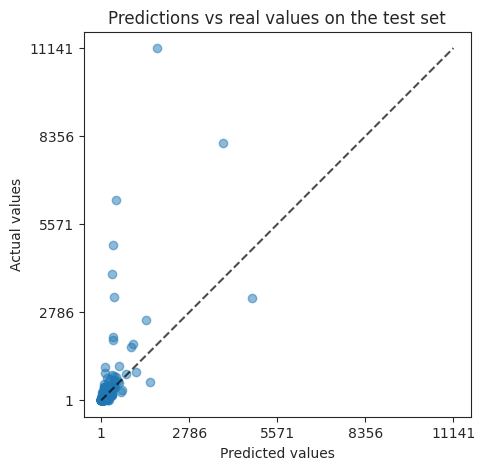

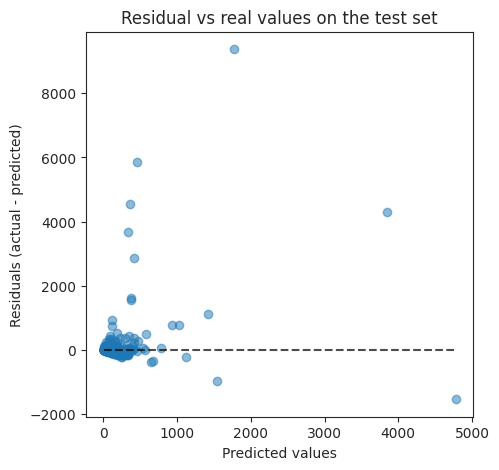

Cross-validation evaluation : 
    scores on folds:  [0.258 0.067 0.654 0.223 0.638]
    mean score:  0.368
    std score deviation:  0.236

Train score : 1.0

Test score : 0.34625
--------------------
metric : MAE
--------------------
Best parameter (CV score=-121.104):
{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'uniform', 'features_selector__k': 26}


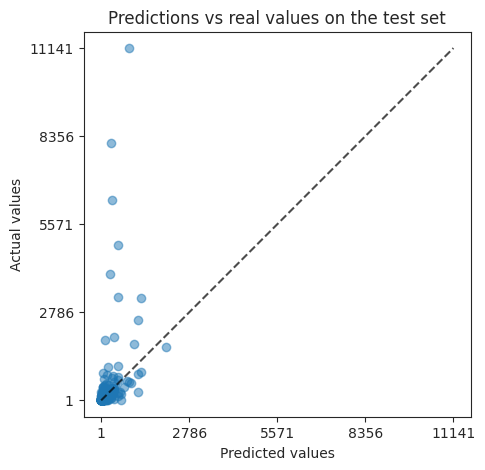

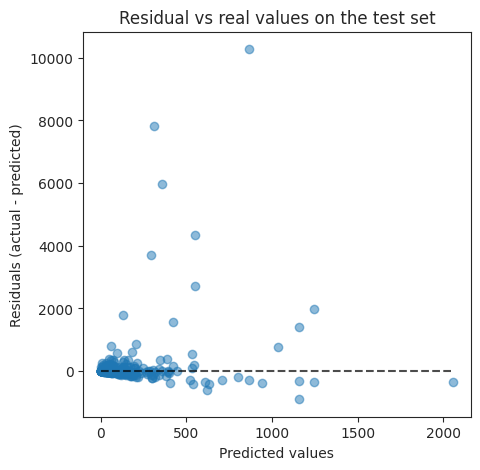

Cross-validation evaluation : 
    scores on folds:  [117.575 183.1    88.534 103.052 119.806]
    mean score:  122.414
    std score deviation:  32.36

Train score : 0.0

Test score : 187.22674
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-474.033):
{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}


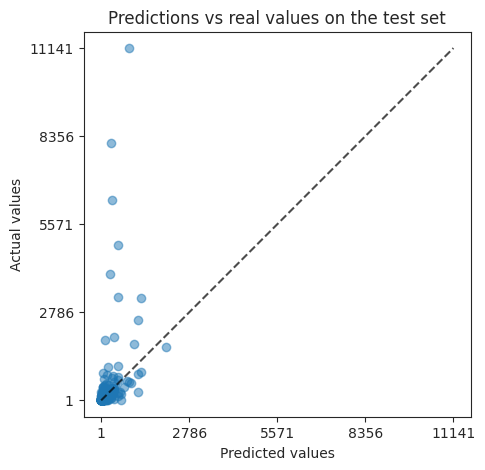

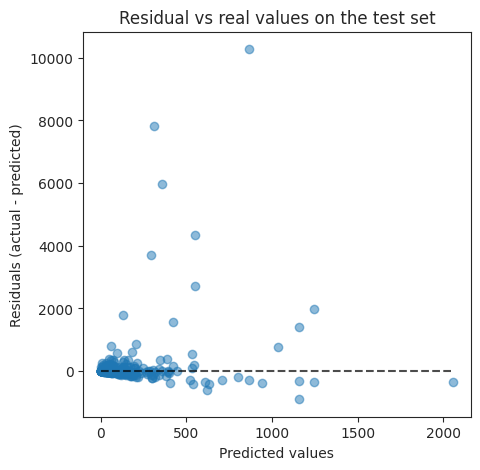

Cross-validation evaluation : 
    scores on folds:  [ 294.924 1098.712  206.578  302.865  343.216]
    mean score:  449.259
    std score deviation:  327.774

Train score : 0.0

Test score : 841.47652


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,standard_scaler,knn_regressor,None,0.368,0.236,0.34625,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[0.258, 0.067, 0.654, 0.223, 0.638]",1.0,0
MAE,standard_scaler,knn_regressor,None,122.414,32.360,187.22674,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'uniform', 'features_selector__k': 26}","[117.575, 183.1, 88.534, 103.052, 119.806]",0.0,1
RMSE,standard_scaler,knn_regressor,None,449.259,327.774,841.47652,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[294.924, 1098.712, 206.578, 302.865, 343.216]",0.0,2


In [87]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False

results_knn = []
models_knn = []
models_idx = 0
#  define a model which scales and then selects the best features for
# the knn regressor
regressor_name = "KNNregressor"

num_fts = [
    'PropertyGFABuilding(s)', 
    'Age',
    'NumberofFloors',
    'NumberofBuildings'
]

fts_passthrough = [elem for elem in X_train.columns if elem not in num_fts]

pre_processor = ColumnTransformer(
    [
        ('scaler', StandardScaler(), num_fts),
        ("passthrough", "passthrough", fts_passthrough)
    ]
)

model = Pipeline(
    [
        ('pre_processor', pre_processor),
        (
            'features_selector', 
            SelectKBest(mutual_info_regression).set_output(transform="pandas")
        ),
        (regressor_name, KNeighborsRegressor())
    ]
)

# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Yet a bit refined Gridsearch   
    param_grid = [
        {
            "features_selector__k": [1, 2, 5, 10, 15, 20, X_train.shape[1]],
            "KNNregressor__n_neighbors": [1, 2, 3, 4, 5],
            "KNNregressor__weights": ["uniform", "distance"]
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)
    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Extract the best model
    model = search.best_estimator_
    model.fit(X_train, y_train)
    # save the model
    models_knn.append(model)

    # Predict with search (as 'refit' defaults to True)
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()
        
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="residual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Residual vs real values on the test set")
        plt.show()

    if show_regressor_input:
        display(
            model[:-1]
            .transform(X_train)
            .set_axis(model[:-1].get_feature_names_out(), axis=1)
        )

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")
    
    # add to results
    results_knn.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "knn_regressor",
            "standard_scaler",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_knn = pd.DataFrame(
results_knn, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_knn

## 6.2.  [&#9650;](#toc0_) <a id='toc6_2_'></a>With a log_transformation before standard scaling.

--------------------
metric : R2
--------------------
Best parameter (CV score=0.498):
{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}


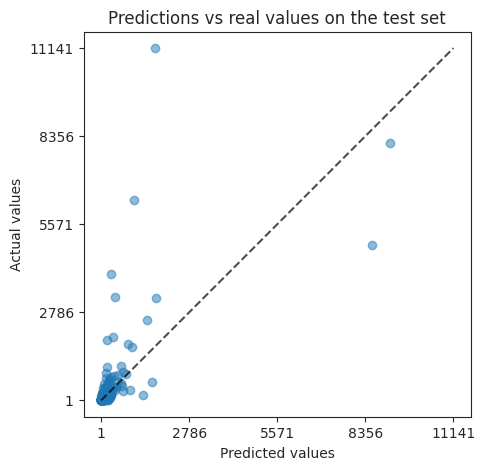

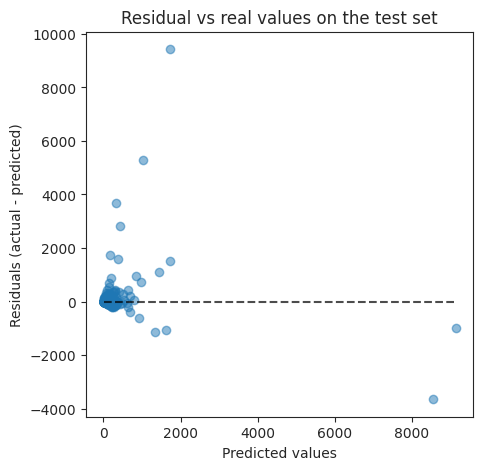

,log_standard_transformer__PropertyGFABuilding(s),log_standard_transformer__NumberofFloors,log_standard_transformer__NumberofBuildings,standard_scaler__Age,passthrough__SteamUseProportion,passthrough__ElectricityProportion,passthrough__NaturalGasProportion,passthrough__PrimaryPropertyType_Hospital,passthrough__PrimaryPropertyType_Hotel,passthrough__PrimaryPropertyType_K12School,passthrough__PrimaryPropertyType_Laboratory,passthrough__PrimaryPropertyType_LargeOffice,passthrough__PrimaryPropertyType_MedicalOffice,passthrough__PrimaryPropertyType_MixedUseProperty,passthrough__PrimaryPropertyType_Other,passthrough__PrimaryPropertyType_RefrigeratedWarehouse,passthrough__PrimaryPropertyType_ResidenceHall,passthrough__PrimaryPropertyType_Restaurant,passthrough__PrimaryPropertyType_RetailStore,passthrough__PrimaryPropertyType_SelfStorageFacility,passthrough__PrimaryPropertyType_SeniorCareCommunity,passthrough__PrimaryPropertyType_SmallandMidSizedOffice,passthrough__PrimaryPropertyType_SupermarketGroceryStore,passthrough__PrimaryPropertyType_University,passthrough__PrimaryPropertyType_Warehouse,passthrough__PrimaryPropertyType_WorshipFacility
0,0.061584,0.366526,-0.1557,-1.358831,0.0,0.74,0.26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.774952,3.456063,-0.1557,-0.231126,0.3,0.68,0.02,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.336255,0.366526,-0.1557,0.988014,0.0,0.86,0.14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-0.935901,-0.375036,-0.1557,0.134616,0.0,0.55,0.45,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.480196,-0.963646,-0.1557,-0.535911,0.0,0.75,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1106,-0.126151,-0.375036,-0.1557,-1.175960,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1107,0.885276,-0.963646,-0.1557,-1.084524,0.0,0.88,0.12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1108,-0.106951,0.042590,-0.1557,1.231842,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1109,1.681514,2.226047,-0.1557,-1.450266,0.0,1.00,0.00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Cross-validation evaluation : 
    scores on folds:  [0.33  0.072 0.741 0.12  0.757]
    mean score:  0.404
    std score deviation:  0.295

Train score : 1.0

Test score : 0.43849
--------------------
metric : MAE
--------------------
Best parameter (CV score=-108.984):
{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}


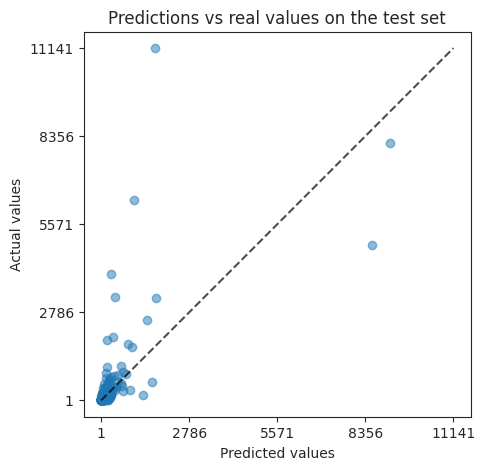

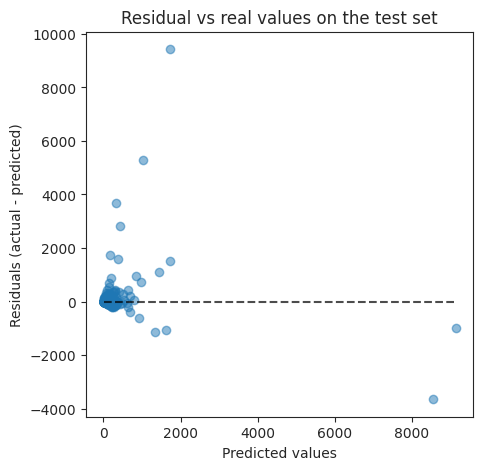

,log_standard_transformer__PropertyGFABuilding(s),log_standard_transformer__NumberofFloors,log_standard_transformer__NumberofBuildings,standard_scaler__Age,passthrough__SteamUseProportion,passthrough__ElectricityProportion,passthrough__NaturalGasProportion,passthrough__PrimaryPropertyType_Hospital,passthrough__PrimaryPropertyType_Hotel,passthrough__PrimaryPropertyType_K12School,passthrough__PrimaryPropertyType_Laboratory,passthrough__PrimaryPropertyType_LargeOffice,passthrough__PrimaryPropertyType_MedicalOffice,passthrough__PrimaryPropertyType_MixedUseProperty,passthrough__PrimaryPropertyType_Other,passthrough__PrimaryPropertyType_RefrigeratedWarehouse,passthrough__PrimaryPropertyType_ResidenceHall,passthrough__PrimaryPropertyType_Restaurant,passthrough__PrimaryPropertyType_RetailStore,passthrough__PrimaryPropertyType_SelfStorageFacility,passthrough__PrimaryPropertyType_SeniorCareCommunity,passthrough__PrimaryPropertyType_SmallandMidSizedOffice,passthrough__PrimaryPropertyType_SupermarketGroceryStore,passthrough__PrimaryPropertyType_University,passthrough__PrimaryPropertyType_Warehouse,passthrough__PrimaryPropertyType_WorshipFacility
0,0.061584,0.366526,-0.1557,-1.358831,0.0,0.74,0.26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.774952,3.456063,-0.1557,-0.231126,0.3,0.68,0.02,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.336255,0.366526,-0.1557,0.988014,0.0,0.86,0.14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-0.935901,-0.375036,-0.1557,0.134616,0.0,0.55,0.45,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.480196,-0.963646,-0.1557,-0.535911,0.0,0.75,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1106,-0.126151,-0.375036,-0.1557,-1.175960,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1107,0.885276,-0.963646,-0.1557,-1.084524,0.0,0.88,0.12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1108,-0.106951,0.042590,-0.1557,1.231842,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1109,1.681514,2.226047,-0.1557,-1.450266,0.0,1.00,0.00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Cross-validation evaluation : 
    scores on folds:  [ 95.604 163.257  99.527 102.792 111.367]
    mean score:  114.509
    std score deviation:  24.922

Train score : 0.0

Test score : 154.67996
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-458.454):
{'KNNregressor__n_neighbors': 2, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}


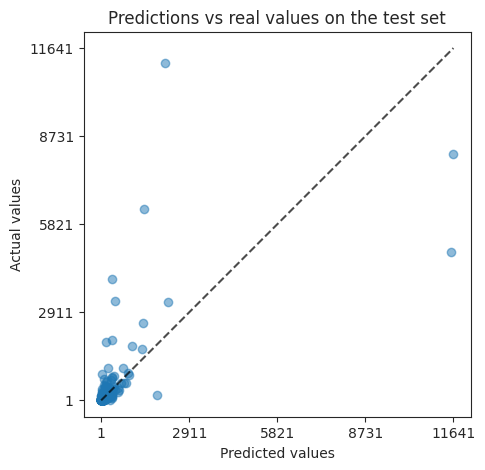

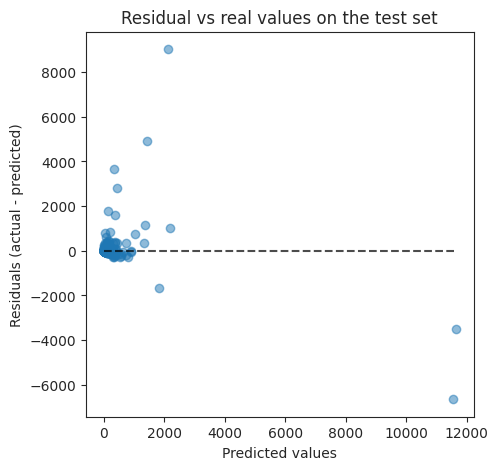

,log_standard_transformer__PropertyGFABuilding(s),log_standard_transformer__NumberofFloors,log_standard_transformer__NumberofBuildings,standard_scaler__Age,passthrough__SteamUseProportion,passthrough__ElectricityProportion,passthrough__NaturalGasProportion,passthrough__PrimaryPropertyType_Hospital,passthrough__PrimaryPropertyType_Hotel,passthrough__PrimaryPropertyType_K12School,passthrough__PrimaryPropertyType_Laboratory,passthrough__PrimaryPropertyType_LargeOffice,passthrough__PrimaryPropertyType_MedicalOffice,passthrough__PrimaryPropertyType_MixedUseProperty,passthrough__PrimaryPropertyType_Other,passthrough__PrimaryPropertyType_RefrigeratedWarehouse,passthrough__PrimaryPropertyType_ResidenceHall,passthrough__PrimaryPropertyType_Restaurant,passthrough__PrimaryPropertyType_RetailStore,passthrough__PrimaryPropertyType_SelfStorageFacility,passthrough__PrimaryPropertyType_SeniorCareCommunity,passthrough__PrimaryPropertyType_SmallandMidSizedOffice,passthrough__PrimaryPropertyType_SupermarketGroceryStore,passthrough__PrimaryPropertyType_University,passthrough__PrimaryPropertyType_Warehouse,passthrough__PrimaryPropertyType_WorshipFacility
0,0.061584,0.366526,-0.1557,-1.358831,0.0,0.74,0.26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.774952,3.456063,-0.1557,-0.231126,0.3,0.68,0.02,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.336255,0.366526,-0.1557,0.988014,0.0,0.86,0.14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-0.935901,-0.375036,-0.1557,0.134616,0.0,0.55,0.45,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.480196,-0.963646,-0.1557,-0.535911,0.0,0.75,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1106,-0.126151,-0.375036,-0.1557,-1.175960,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1107,0.885276,-0.963646,-0.1557,-1.084524,0.0,0.88,0.12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1108,-0.106951,0.042590,-0.1557,1.231842,0.0,1.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1109,1.681514,2.226047,-0.1557,-1.450266,0.0,1.00,0.00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Cross-validation evaluation : 
    scores on folds:  [ 257.454 1090.077  346.249  282.719  338.065]
    mean score:  462.913
    std score deviation:  315.346

Train score : 2e-05

Test score : 734.49194


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,standard_scaler,knn_regressor,None,0.368,0.236,0.34625,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[0.258, 0.067, 0.654, 0.223, 0.638]",1.00000,0
MAE,standard_scaler,knn_regressor,None,122.414,32.360,187.22674,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'uniform', 'features_selector__k': 26}","[117.575, 183.1, 88.534, 103.052, 119.806]",0.00000,1
RMSE,standard_scaler,knn_regressor,None,449.259,327.774,841.47652,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[294.924, 1098.712, 206.578, 302.865, 343.216]",0.00000,2
R2,log_standard_scaler,knn_regressor,None,0.404,0.295,0.43849,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[0.33, 0.072, 0.741, 0.12, 0.757]",1.00000,3
MAE,log_standard_scaler,knn_regressor,None,114.509,24.922,154.67996,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[95.604, 163.257, 99.527, 102.792, 111.367]",0.00000,4
RMSE,log_standard_scaler,knn_regressor,None,462.913,315.346,734.49194,NaN,"{'KNNregressor__n_neighbors': 2, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[257.454, 1090.077, 346.249, 282.719, 338.065]",0.00002,5


In [88]:
show_plot = True
show_scores = True
show_regressor_input = True
silent = False
fine_tuning = False

#  define a model which scales and then selects the best features for
# the knn regressor
regressor_name = "KNNregressor"

num_fts = [
    'PropertyGFABuilding(s)', 
    'Age',
    'NumberofFloors',
    'NumberofBuildings'
]

fts_to_log_transform = [
    'PropertyGFABuilding(s)', 
    'NumberofFloors',
    'NumberofBuildings'
]

fts_passthrough = [elem for elem in X_train.columns if elem not in num_fts]

log_standard_transformer = Pipeline(
    [
        ('log_transformer', log_transformer),
        ('scaler', StandardScaler())
    ]
)

pre_processor = ColumnTransformer(
    [
        (
            'log_standard_transformer',
            log_standard_transformer,
            fts_to_log_transform
        ),
        ("standard_scaler", StandardScaler(), ['Age']),
        ("passthrough", "passthrough", fts_passthrough)
    ]
)

model = Pipeline(
    [
        ('pre_processor', pre_processor),
        (
            'features_selector', 
            SelectKBest(mutual_info_regression).set_output(transform="pandas")
        ),
        (regressor_name, KNeighborsRegressor())
    ]
)


# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Gridsearch   
    param_grid = [
        {
            "features_selector__k": [10, 15, 20, X_train.shape[1]],
            "KNNregressor__n_neighbors": [1, 2, 3, 4, 5],
            "KNNregressor__weights": ["uniform", "distance"]
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Extract the best model
    model = search.best_estimator_
    model.fit(X_train, y_train)
    # save the model
    models_knn.append(model)

    # Predict with search (as 'refit' defaults to True)
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()
        
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="residual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Residual vs real values on the test set")
        plt.show()

    if show_regressor_input:
        display(
            model[:-1]
            .transform(X_train)
            .set_axis(model[:-1].get_feature_names_out(), axis=1)
        )

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = apply_score_func(metric, y_train, pred_train)
    score_test = apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")
    
    # add to results
    results_knn.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "knn_regressor",
            "log_standard_scaler",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_knn = pd.DataFrame(
results_knn, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_knn

## 6.3.  [&#9650;](#toc0_) <a id='toc6_3_'></a>With a log transformation on both inputs and target

--------------------
metric : R2
--------------------
Best parameter (CV score=0.412):
{'regressor__KNNregressor__n_neighbors': 2, 'regressor__KNNregressor__weights': 'distance', 'regressor__features_selector__k': 26}


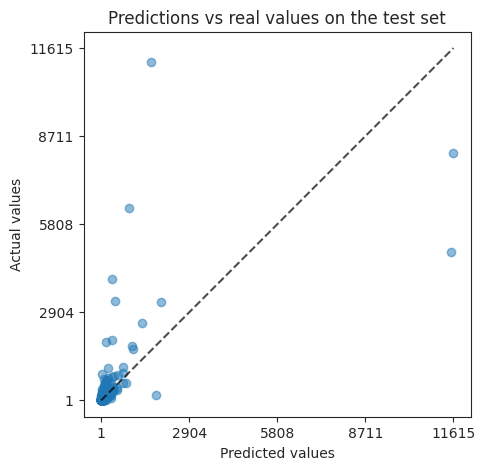

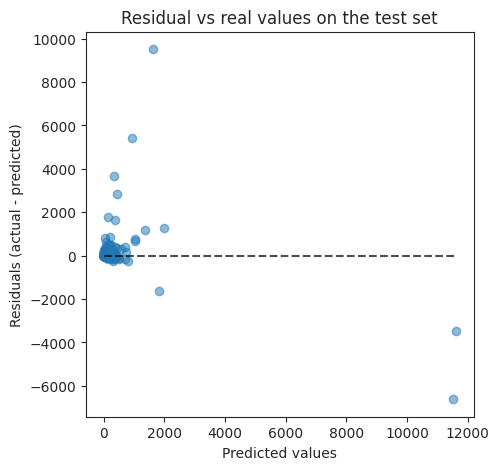

Cross-validation evaluation : 
    scores on folds:  [0.355 0.089 0.532 0.268 0.489]
    mean score:  0.347
    std score deviation:  0.16

Train score : 1.0

Test score : 0.29342
--------------------
metric : MAE
--------------------
Best parameter (CV score=-108.720):
{'regressor__KNNregressor__n_neighbors': 3, 'regressor__KNNregressor__weights': 'distance', 'regressor__features_selector__k': 20}


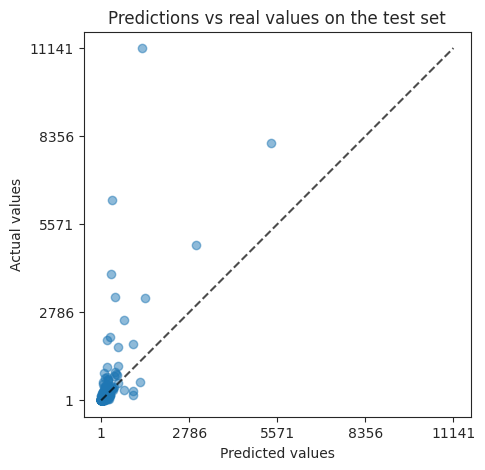

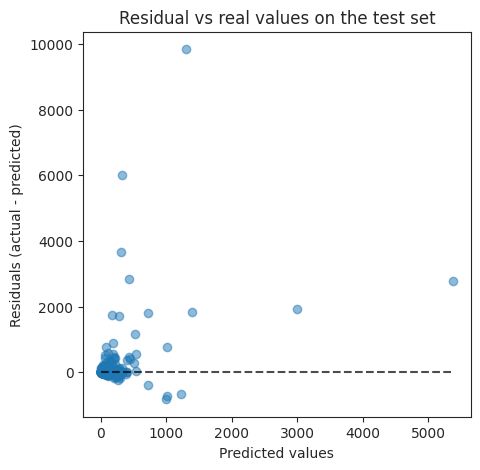

Cross-validation evaluation : 
    scores on folds:  [ 95.308 154.926 110.573  83.896 123.441]
    mean score:  113.629
    std score deviation:  24.62

Train score : 0.0

Test score : 162.29481
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-474.640):
{'regressor__KNNregressor__n_neighbors': 1, 'regressor__KNNregressor__weights': 'uniform', 'regressor__features_selector__k': 26}


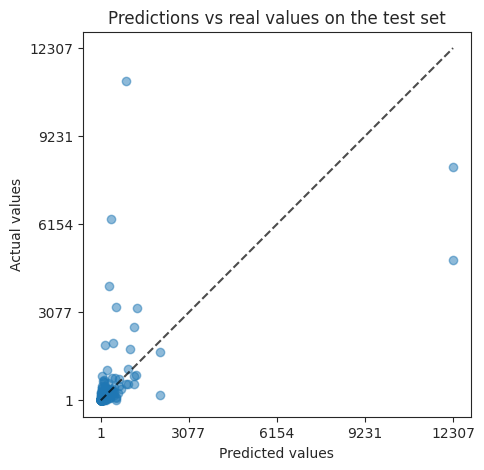

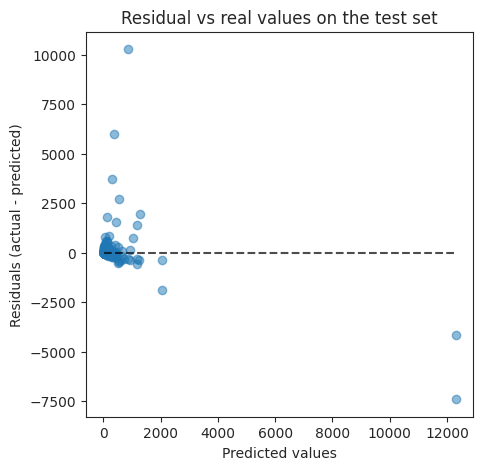

Cross-validation evaluation : 
    scores on folds:  [ 271.707 1103.503  202.475  311.76   349.333]
    mean score:  447.755
    std score deviation:  331.464

Train score : 0.0

Test score : 832.24987


,,,,CV_train_score_mean,CV_train_score_std,test_score,computation_time,hyperparameters,fold_scores,train_score,models_idx
metric,pre_processor,regressor,target_transformer,,,,,,,,
R2,standard_scaler,knn_regressor,None,0.368,0.236,0.34625,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[0.258, 0.067, 0.654, 0.223, 0.638]",1.00000,0
MAE,standard_scaler,knn_regressor,None,122.414,32.360,187.22674,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'uniform', 'features_selector__k': 26}","[117.575, 183.1, 88.534, 103.052, 119.806]",0.00000,1
RMSE,standard_scaler,knn_regressor,None,449.259,327.774,841.47652,NaN,"{'KNNregressor__n_neighbors': 1, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[294.924, 1098.712, 206.578, 302.865, 343.216]",0.00000,2
R2,log_standard_scaler,knn_regressor,None,0.404,0.295,0.43849,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[0.33, 0.072, 0.741, 0.12, 0.757]",1.00000,3
MAE,log_standard_scaler,knn_regressor,None,114.509,24.922,154.67996,NaN,"{'KNNregressor__n_neighbors': 3, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[95.604, 163.257, 99.527, 102.792, 111.367]",0.00000,4
RMSE,log_standard_scaler,knn_regressor,None,462.913,315.346,734.49194,NaN,"{'KNNregressor__n_neighbors': 2, 'KNNregressor__weights': 'distance', 'features_selector__k': 26}","[257.454, 1090.077, 346.249, 282.719, 338.065]",0.00002,5
R2,log_standard_scaler,knn_regressor,log,0.347,0.160,0.29342,NaN,"{'regressor__KNNregressor__n_neighbors': 2, 'regressor__KNNregressor__weights': 'distance', 'regressor__features_selector__k': 26}","[0.355, 0.089, 0.532, 0.268, 0.489]",1.00000,6
MAE,log_standard_scaler,knn_regressor,log,113.629,24.620,162.29481,NaN,"{'regressor__KNNregressor__n_neighbors': 3, 'regressor__KNNregressor__weights': 'distance', 'regressor__features_selector__k': 20}","[95.308, 154.926, 110.573, 83.896, 123.441]",0.00000,7
RMSE,log_standard_scaler,knn_regressor,log,447.755,331.464,832.24987,NaN,"{'regressor__KNNregressor__n_neighbors': 1, 'regressor__KNNregressor__weights': 'uniform', 'regressor__features_selector__k': 26}","[271.707, 1103.503, 202.475, 311.76, 349.333]",0.00000,8


In [89]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False

#  define a model which scales and then selects the best features for
# the knn regressor
regressor_name = "KNNregressor"

num_fts = [
    'PropertyGFABuilding(s)', 
    'Age',
    'NumberofFloors',
    'NumberofBuildings'
]

fts_to_log_transform = [
    'PropertyGFABuilding(s)', 
    'NumberofFloors',
    'NumberofBuildings'
]

fts_passthrough = [elem for elem in X_train.columns if elem not in num_fts]

log_standard_transformer = Pipeline(
    [
        ('log_transformer', log_transformer),
        ('scaler', StandardScaler())
    ]
)

pre_processor = ColumnTransformer(
    [
        (
            'log_standard_transformer',
            log_standard_transformer,
            fts_to_log_transform
        ),
        ("standard_scaler", StandardScaler(), ['Age']),
        ("passthrough", "passthrough", fts_passthrough)
    ]
)

model = Pipeline(
    [
        ('pre_processor', pre_processor),
        (
            'features_selector', 
            SelectKBest(mutual_info_regression).set_output(transform="pandas")
        ),
        (regressor_name, KNeighborsRegressor())
    ]
)

full_model = TransformedTargetRegressor(
    regressor=model,
    transformer=log_transformer
)


# Define the metric for the grid search and the evaluation.
# evaluating according several metrics 
for i, metric in metrics.iterrows():
    if show_scores:
        print('-'*20)
        print(f"metric : {metric.name}")
        print('-'*20)
        
    # Initial Gridsearch   
    param_grid = [
        {
            "regressor__features_selector__k":
                [15, 20, X_train.shape[1]],
            "regressor__KNNregressor__n_neighbors": [1, 2, 3, 4, 5],
            "regressor__KNNregressor__weights": ["uniform", "distance"]
        }
    ]
    n_folds = 5

    search = GridSearchCV(
        full_model, param_grid=param_grid,
        scoring=metric.scoring_alias, cv=n_folds
    )
    search.fit(X_train, y_train)
    print("Best parameter (CV score=%0.3f):" % search.best_score_)
    print(search.best_params_)

    hyperparameters = search.best_params_
    computation_time = np.NaN
    # Extract the best model
    model = search.best_estimator_
    model.fit(X_train, y_train)
    # save the model
    models_knn.append(model)

    # Predict with search (as 'refit' defaults to True)
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)

    if show_plot:
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()
        
        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="residual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Residual vs real values on the test set")
        plt.show()

    if show_regressor_input:
        display(
            model[:-1]
            .transform(X_train)
            .set_axis(model[:-1].get_feature_names_out(), axis=1)
        )

    # CV evaluation
    cv_output = ds.CV_evaluation(
        model, X_train, y_train, k=5,
            scoring=metric.scoring_alias, seed=0,
            silent=silent
        )    
    # Compute and print scores on train and test sets.
    score_train = ds.apply_score_func(metric, y_train, pred_train)
    score_test = ds.apply_score_func(metric, y_test, pred_test)
    if show_scores:
        print(f"\nTrain score : {score_train}")
        print(f"\nTest score : {score_test}")
    
    # add to results
    results_knn.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            computation_time,
            hyperparameters,
            cv_output[0],
            score_train,
            "knn_regressor",
            "log_standard_scaler",
            metric.name,
            'log',
            models_idx          
        ]
    )
    models_idx += 1

# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"models_idx"
]

df_results_knn = pd.DataFrame(
results_knn, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results_knn

In [90]:
!mkdir GHG_predictions_models_and_results/knn_models

In [91]:
# Save scores
filename = (
    "GHG_predictions_models_and_results/"
    + "knn_models/"
    + "scores.csv"
)
df_results_knn.to_csv(filename)


In [92]:
# Save each model of models_regul in a joblib file.
for n, row in enumerate(df_results_knn.index):
    filename = (
        "./GHG_predictions_models_and_results/"
        + "knn_models/"
        + "_".join(list(row))
        + ".joblib"
    )
    dump(models_knn[n], filename)


In [93]:
(
    df_results_knn
    .sort_values(['metric','CV_train_score_mean'])
    .style.format("{:.4f}", subset=df_results_knn.columns[0:4])
    .background_gradient(
            cmap="Blues",
            subset=[
                "CV_train_score_mean",
                "CV_train_score_std",
                "test_score"
            ]
        )
)

# 7.  [&#9650;](#toc0_) <a id='toc7_'></a>Random Forest Regressor

## 7.1.  [&#9650;](#toc0_) <a id='toc7_1_'></a>Only pre-processing

In [120]:
tmp_pre_processors = [pre_processors[0], pre_processors[3]]

In [95]:
for pp in tmp_pre_processors:
    display(pp)

ColumnTransformer(transformers=[('min_max_scaler', MinMaxScaler(),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors', 'Age']),
                                ('passthrough', 'passthrough',
                                 ['PrimaryPropertyType_Hospital',
                                  'PrimaryPropertyType_Hotel',
                                  'PrimaryPropertyType_K12School',
                                  'PrimaryPropertyType_Laboratory',
                                  'PrimaryPropertyType_LargeOffice',
                                  'PrimaryPropertyType_Medic...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthroug...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

Although pre_processing seem less important for a random forest. I am going to use the same ones used before.


--------------------
min_max_scaler


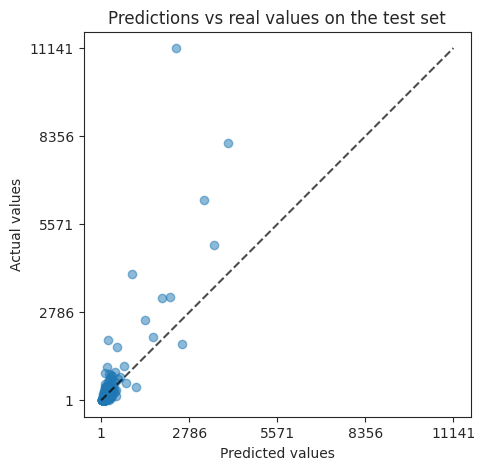

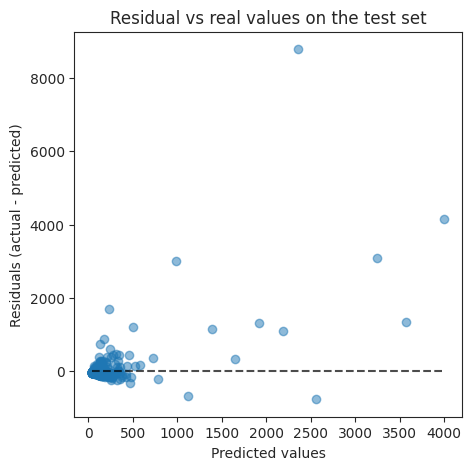

Cross-validation evaluation : 
    scores on folds:  [0.511 0.671 0.409 0.048 0.308]
    mean score:  0.389
    std score deviation:  0.209
Cross-validation evaluation : 
    scores on folds:  [126.991 143.808  91.434 164.8   123.696]
    mean score:  130.146
    std score deviation:  24.239
Cross-validation evaluation : 
    scores on folds:  [ 533.575  493.152  169.718 1131.154  265.022]
    mean score:  518.524
    std score deviation:  335.295

--------------------
log_into_min_max_scaler


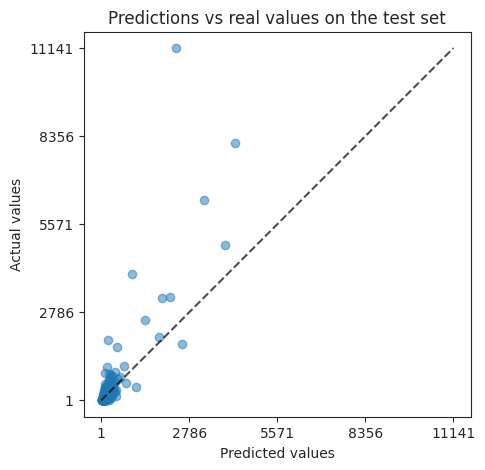

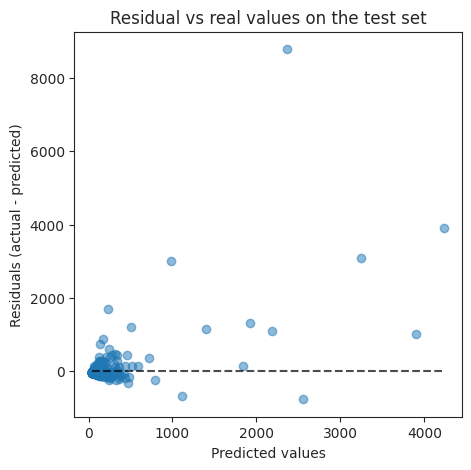

Cross-validation evaluation : 
    scores on folds:  [0.538 0.669 0.409 0.05  0.314]
    mean score:  0.396
    std score deviation:  0.21
Cross-validation evaluation : 
    scores on folds:  [125.686 144.164  91.407 164.798 123.673]
    mean score:  129.946
    std score deviation:  24.329
Cross-validation evaluation : 
    scores on folds:  [ 518.783  494.219  169.696 1129.516  263.9  ]
    mean score:  515.223
    std score deviation:  334.772


In [96]:
for pp in tmp_pre_processors:
    # defining baselines of this algorithm
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    n_estimators=100, # to be tuned
                    criterion='squared_error',
                    max_features='sqrt', #to be tuned
                    n_jobs=-1,
                    random_state=411,
                    max_depth=5 # to be tuned
                )
            )
        ]
    )
    
    # param_grid = {
    #     "regressor__n_estimators": [],
    #     "regressor__max_depth": [],
    #     "regressor__max_features": [],
    # }
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    # Print name of the pre-processor and display predictions
    print(
        f"\n"
        + "-"*20 + "\n"
        + model['pre_processor'].transformers_[0][0]
    )
    ds.plot_predictions_vs_real_values(y_test, y_pred)
    
    for i, metric in metrics.iterrows():
        ds.CV_evaluation(model, X_train, y_train, scoring=metric.scoring_alias)

        

The log transformation in pre_processing almost did not improve the scores.


--------------------
min_max_scaler--- metric : R2

{'regressor__n_estimators': 30}
Cross-validation evaluation : 
    scores on folds:  [0.517 0.615 0.581 0.139 0.676]
    mean score:  0.506
    std score deviation:  0.19


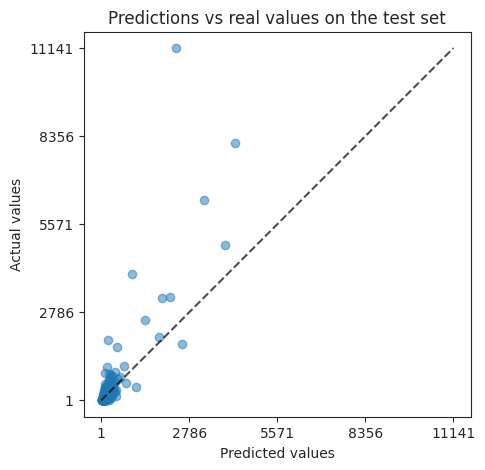

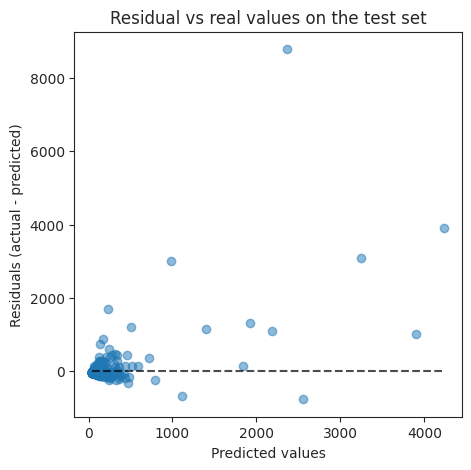


--------------------
min_max_scaler--- metric : MAE

{'regressor__n_estimators': 40}
Cross-validation evaluation : 
    scores on folds:  [107.474 146.719  63.278 150.647  70.906]
    mean score:  107.805
    std score deviation:  36.59


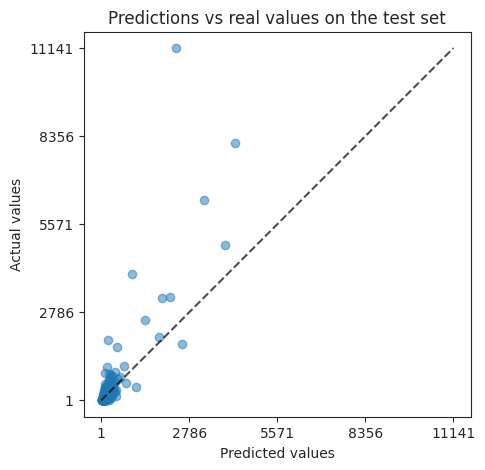

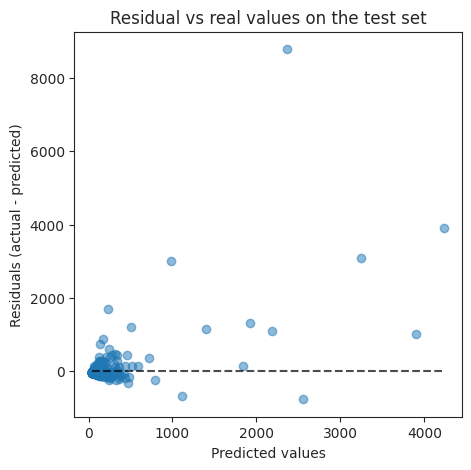


--------------------
min_max_scaler--- metric : RMSE

{'regressor__n_estimators': 50}
Cross-validation evaluation : 
    scores on folds:  [ 530.308  519.033  141.181 1078.914  189.165]
    mean score:  491.72
    std score deviation:  335.097


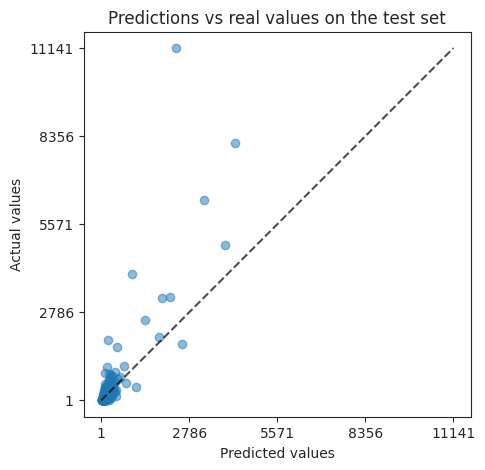

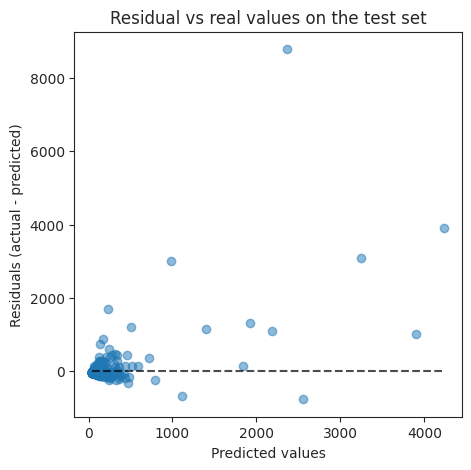


--------------------
log_into_min_max_scaler--- metric : R2

{'regressor__n_estimators': 30}
Cross-validation evaluation : 
    scores on folds:  [0.516 0.64  0.58  0.14  0.677]
    mean score:  0.511
    std score deviation:  0.193


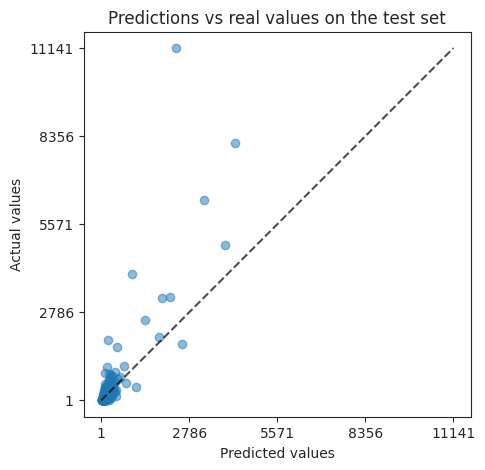

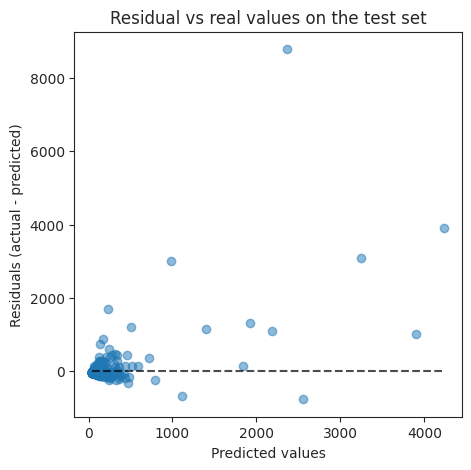


--------------------
log_into_min_max_scaler--- metric : MAE

{'regressor__n_estimators': 50}
Cross-validation evaluation : 
    scores on folds:  [107.978 145.188  62.067 150.851  72.679]
    mean score:  107.752
    std score deviation:  36.266


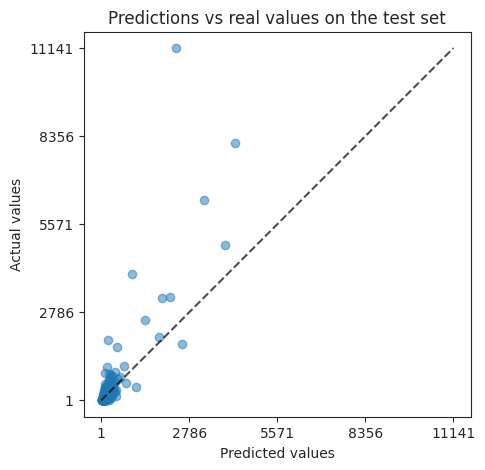

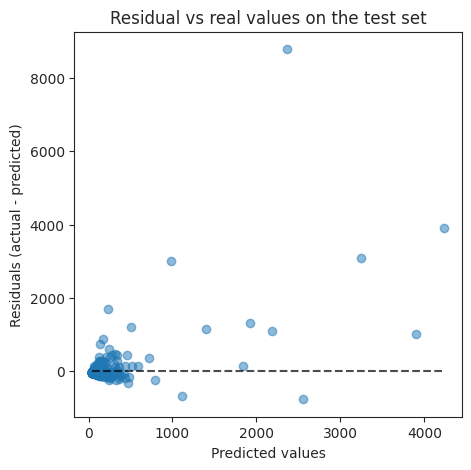


--------------------
log_into_min_max_scaler--- metric : RMSE

{'regressor__n_estimators': 30}
Cross-validation evaluation : 
    scores on folds:  [ 530.997  515.726  142.997 1074.934  181.06 ]
    mean score:  489.143
    std score deviation:  334.766


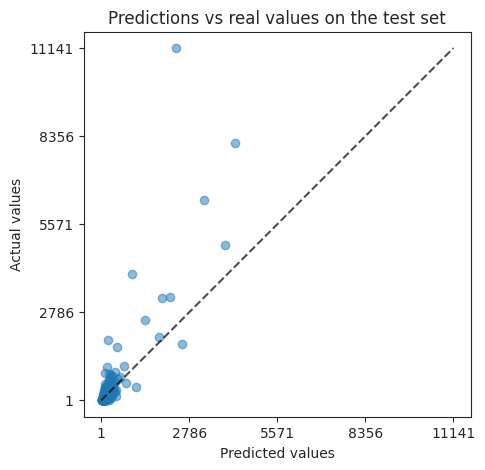

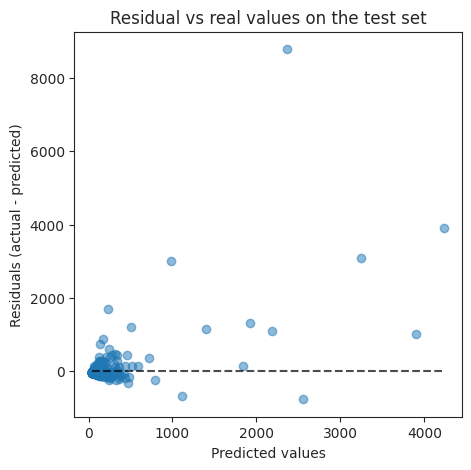

In [100]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": np.arange(10, 100, 10),
        # "regressor__max_depth": np.arange(50, 100),
        # "regressor__max_features": np.arange(4, 26),
        # "regressor__min_samples_leaf": np.arange(1, 3),
        # "regressor__min_samples_split": np.arange(1, 10),
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)
     
        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
        # Plotting
        ds.plot_predictions_vs_real_values(y_test, y_pred)
        
        # # add to results
        # results_random_forest.append(
        #     [
        #         cv_output[1],
        #         cv_output[2],
        #         score_test,
        #         np.NaN,
        #         hyperparameters,
        #         cv_output[0],
        #         score_train,
        #         "Random_forest_regressor",
        #         model['pre_processor'].transformers_[0][0],
        #         metric.name,
        #         'None',
        #         model_idx          
        #     ]
        # )
        # model_idx += 1


--------------------
min_max_scaler--- metric : R2

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.55  0.63  0.574 0.143 0.667]
    mean score:  0.513
    std score deviation:  0.189


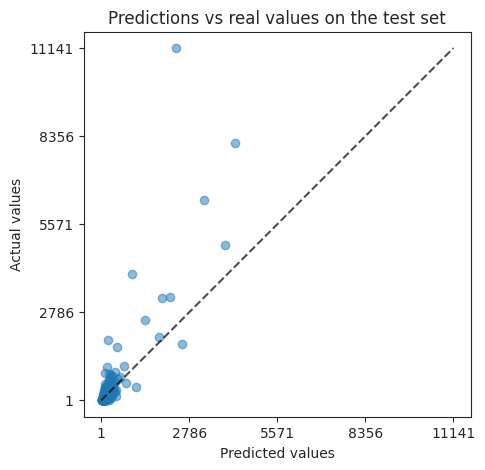

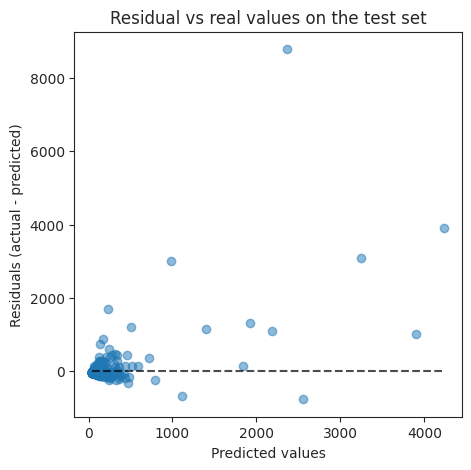


--------------------
min_max_scaler--- metric : MAE

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [106.131 147.318  63.737 151.334  70.874]
    mean score:  107.879
    std score deviation:  36.782


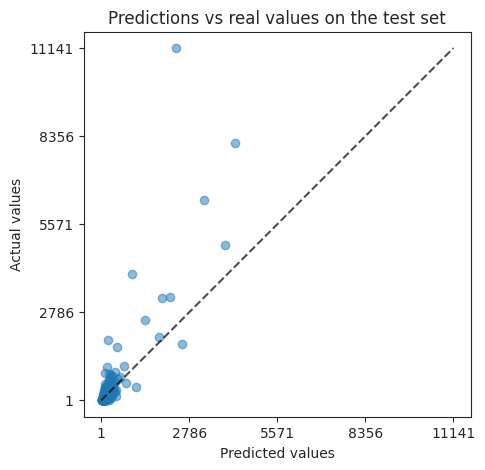

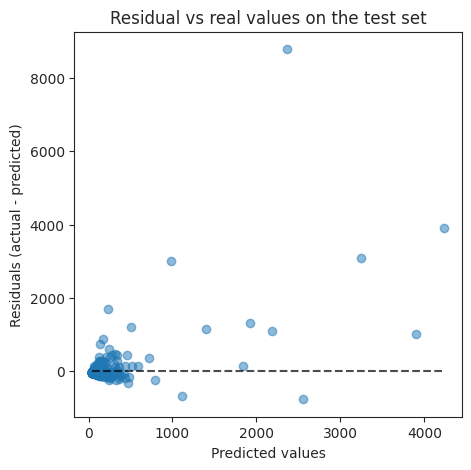


--------------------
min_max_scaler--- metric : RMSE

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 512.076  522.932  144.038 1072.775  183.771]
    mean score:  487.118
    std score deviation:  333.053


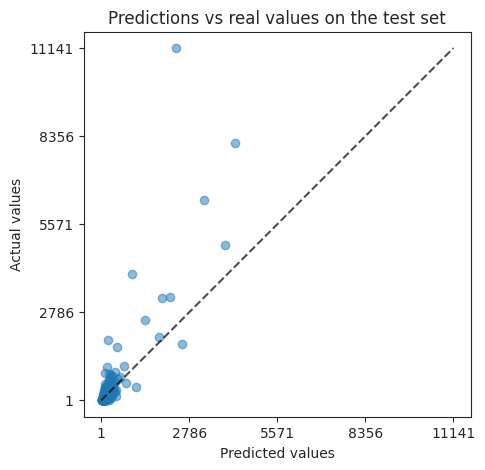

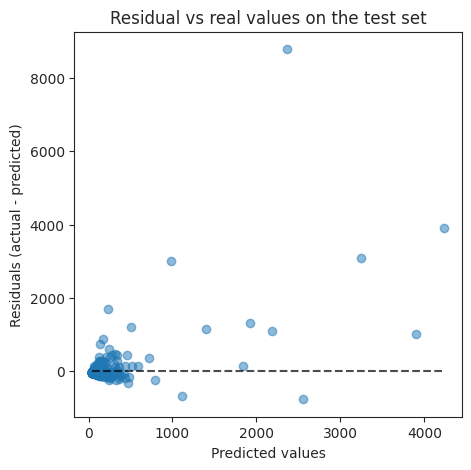


--------------------
log_into_min_max_scaler--- metric : R2

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.549 0.653 0.575 0.144 0.668]
    mean score:  0.518
    std score deviation:  0.192


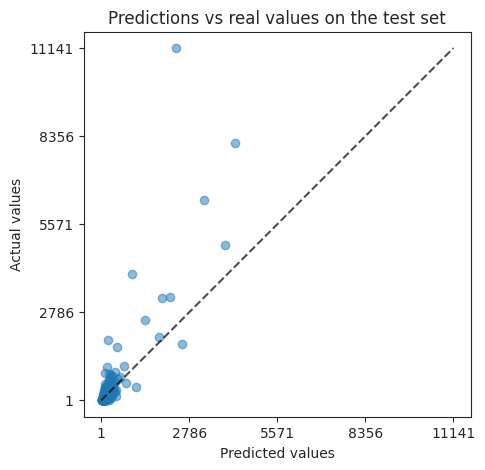

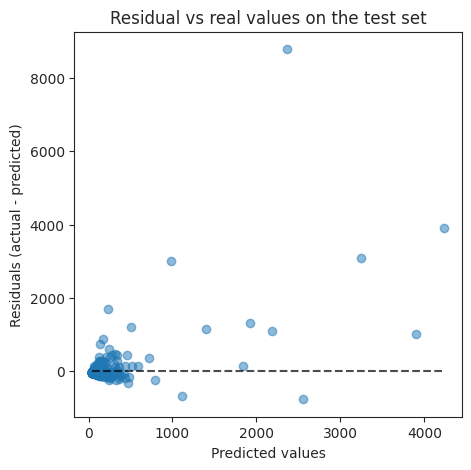


--------------------
log_into_min_max_scaler--- metric : MAE

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [107.041 146.208  63.507 151.294  70.995]
    mean score:  107.809
    std score deviation:  36.562


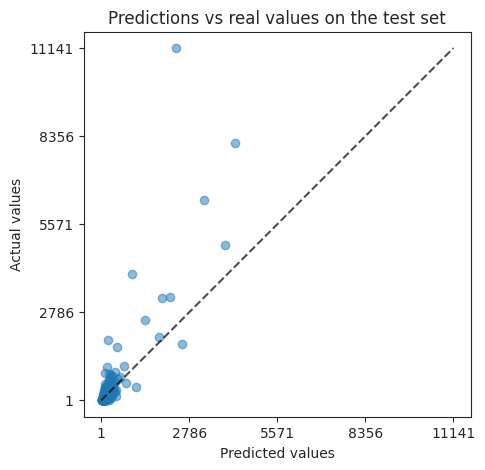

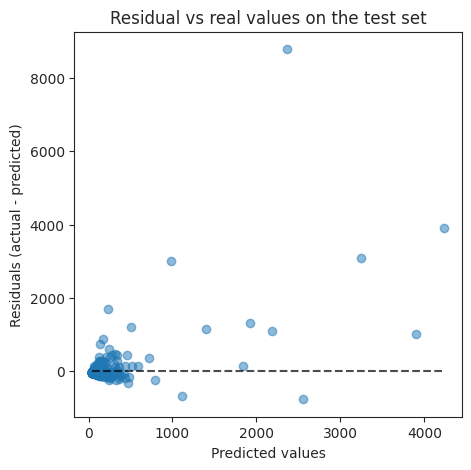


--------------------
log_into_min_max_scaler--- metric : RMSE

{'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 512.536  506.155  143.914 1072.37   183.502]
    mean score:  483.695
    std score deviation:  332.698


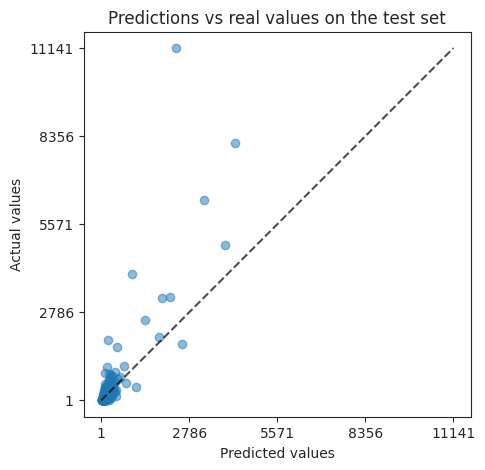

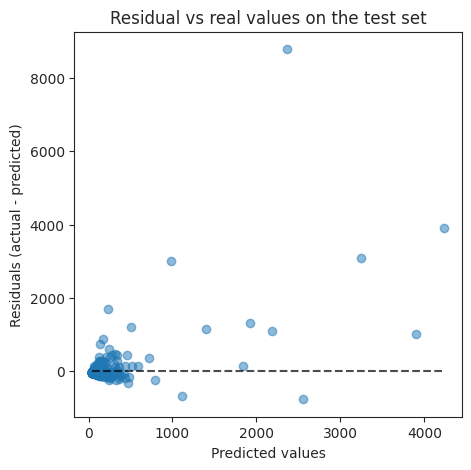

In [102]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": np.arange(20, 35, 2),
        # "regressor__max_depth": np.arange(50, 100),
        # "regressor__max_features": np.arange(4, 26),
        # "regressor__min_samples_leaf": np.arange(1, 3),
        # "regressor__min_samples_split": np.arange(1, 10),
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)
     
        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
        # Plotting
        ds.plot_predictions_vs_real_values(y_test, y_pred)
        


In [105]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": [32],
        # "regressor__max_depth": np.arange(50, 100),
        "regressor__max_features": np.arange(4, 26),
        # "regressor__min_samples_leaf": np.arange(1, 3),
        # "regressor__min_samples_split": np.arange(1, 10),
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)
     
        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )



--------------------
min_max_scaler--- metric : R2

{'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.58  0.783 0.567 0.126 0.642]
    mean score:  0.54
    std score deviation:  0.221

--------------------
min_max_scaler--- metric : MAE

{'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.097 118.272  63.355 149.41   74.517]
    mean score:  103.13
    std score deviation:  31.05

--------------------
min_max_scaler--- metric : RMSE

{'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 494.806  400.794  145.189 1083.827  190.506]
    mean score:  463.024
    std score deviation:  336.322

--------------------
log_into_min_max_scaler--- metric : R2

{'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.58  0.781 0.566 0.1

In [107]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": [32],
        "regressor__max_depth": np.arange(1, 50, 3),
        "regressor__max_features": [11],
        # "regressor__min_samples_leaf": np.arange(1, 3),
        # "regressor__min_samples_split": np.arange(1, 10),
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)

        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )



--------------------
min_max_scaler--- metric : R2

{'regressor__max_depth': 31, 'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.579 0.779 0.569 0.131 0.649]
    mean score:  0.541
    std score deviation:  0.219

--------------------
min_max_scaler--- metric : MAE

{'regressor__max_depth': 34, 'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.097 115.515  63.355 149.41   74.517]
    mean score:  102.579
    std score deviation:  30.799

--------------------
min_max_scaler--- metric : RMSE

{'regressor__max_depth': 34, 'regressor__max_features': 11, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 494.806  397.43   145.189 1083.827  190.506]
    mean score:  462.352
    std score deviation:  336.45

--------------------
log_into_min_max_scaler--- metric : R2

{'regressor__max_depth': 31, 'regressor__max_feature

In [109]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors: 
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": [32],
        "regressor__max_depth": np.arange(30, 35),
        "regressor__max_features": [11],
        "regressor__min_samples_leaf": np.arange(1, 3),
        "regressor__min_samples_split": np.arange(1, 10,2),
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)

        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
    break



--------------------
min_max_scaler--- metric : R2

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.584 0.785 0.569 0.131 0.659]
    mean score:  0.546
    std score deviation:  0.221

--------------------
min_max_scaler--- metric : MAE

{'regressor__max_depth': 33, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.097 115.058  63.355 149.745  74.517]
    mean score:  102.555
    std score deviation:  30.864

--------------------
min_max_scaler--- metric : RMSE

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 492.048  3

In [110]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0


for pp in tmp_pre_processors: 
    model = Pipeline(
        [
            ('pre_processor', pp),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    param_grid = {
        "regressor__n_estimators": [32],
        "regressor__max_depth": np.arange(25, 35),
        "regressor__max_features": [11],
        "regressor__min_samples_leaf": [1, 2],
        "regressor__min_samples_split": [1, 2],
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + model['pre_processor'].transformers_[0][0]
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        # models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)

        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
    break



--------------------
min_max_scaler--- metric : R2

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.584 0.785 0.569 0.131 0.659]
    mean score:  0.546
    std score deviation:  0.221

--------------------
min_max_scaler--- metric : MAE

{'regressor__max_depth': 33, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.097 115.058  63.355 149.745  74.517]
    mean score:  102.555
    std score deviation:  30.864

--------------------
min_max_scaler--- metric : RMSE

{'regressor__max_depth': 27, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 488.526  3

The gains are very very little so no need to go further in the tuning.


--------------------
min_max--- metric : R2

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.584 0.785 0.569 0.131 0.659]
    mean score:  0.546
    std score deviation:  0.221


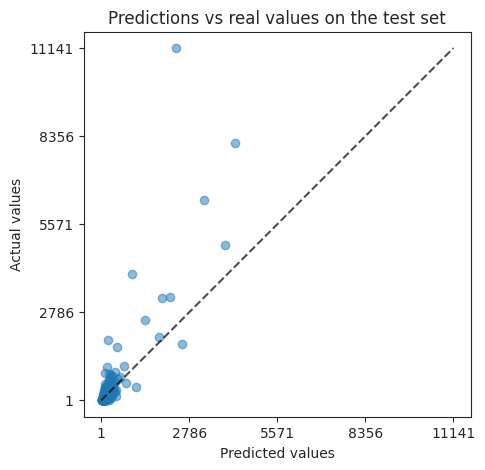

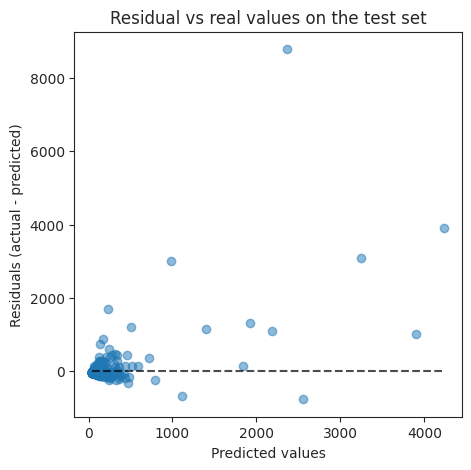


--------------------
min_max--- metric : MAE

{'regressor__max_depth': 33, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.097 115.058  63.355 149.745  74.517]
    mean score:  102.555
    std score deviation:  30.864


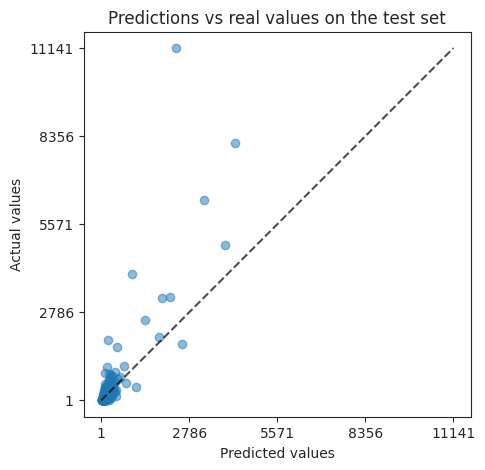

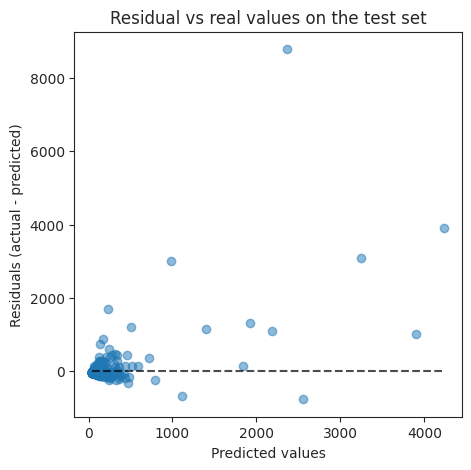


--------------------
min_max--- metric : RMSE

{'regressor__max_depth': 27, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 488.526  386.739  149.092 1087.689  189.788]
    mean score:  460.367
    std score deviation:  337.595


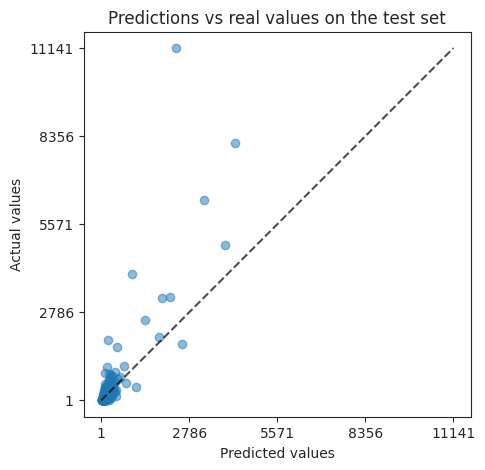

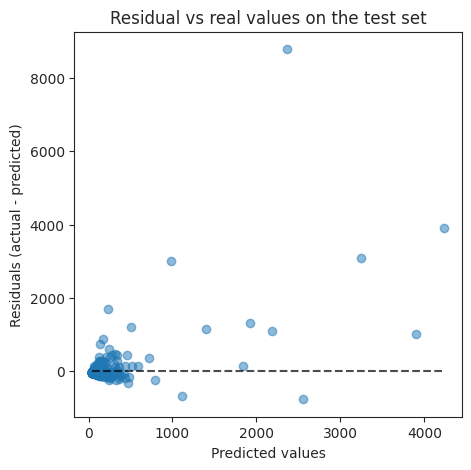


--------------------
mixed_log_min_max--- metric : R2

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [0.584 0.798 0.568 0.131 0.692]
    mean score:  0.555
    std score deviation:  0.227


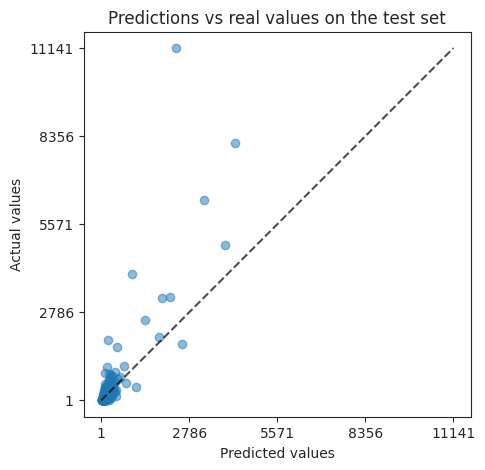

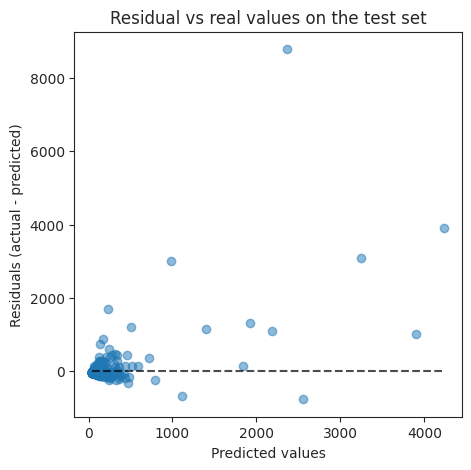


--------------------
mixed_log_min_max--- metric : MAE

{'regressor__max_depth': 33, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [110.713 114.85   63.75  149.774  73.073]
    mean score:  102.432
    std score deviation:  31.056


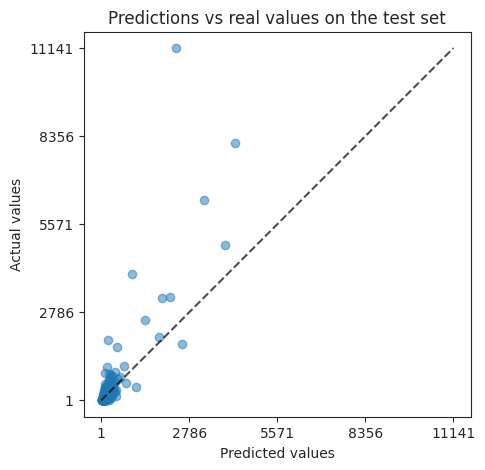

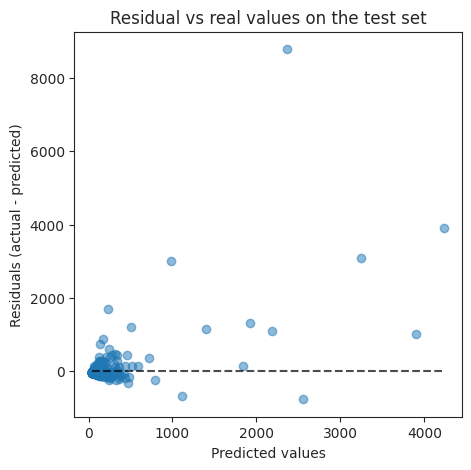


--------------------
mixed_log_min_max--- metric : RMSE

{'regressor__max_depth': 30, 'regressor__max_features': 11, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 1, 'regressor__n_estimators': 32}
Cross-validation evaluation : 
    scores on folds:  [ 492.137  385.892  145.113 1080.218  176.729]
    mean score:  456.018
    std score deviation:  337.791


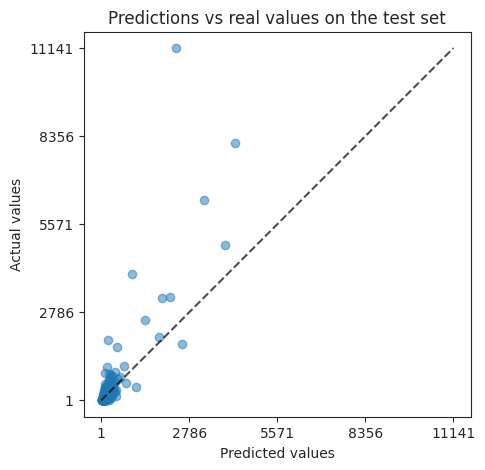

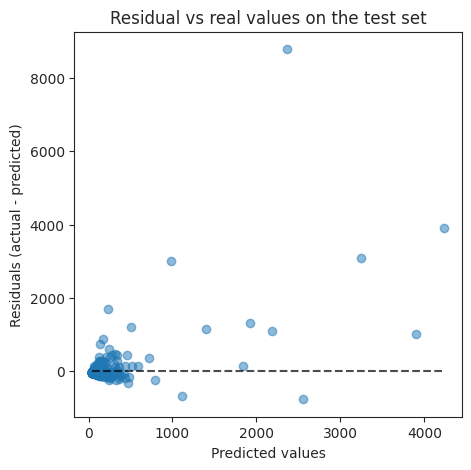

In [140]:
folds = KFold(n_splits=5, shuffle=True, random_state=2)
results_random_forest = []
models_random_forest = []
model_idx = 0

tmp_pre_processors = [pre_processors[0], pre_processors[3]]
# casting to a dictionary for an easier name accessibility
tmp_pre_processors = dict(
    min_max=tmp_pre_processors[0],
    mixed_log_min_max=tmp_pre_processors[-1]
)

for pp_name in tmp_pre_processors.keys(): 
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )

    param_grid = {
        "regressor__n_estimators": [31, 32, 33],
        "regressor__max_depth": [27, 30, 33],
        "regressor__max_features": [11],
        "regressor__min_samples_leaf": [1],
        "regressor__min_samples_split": [1],
    }
    
    for i, metric in metrics.iterrows():
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        # Tune
        search = GridSearchCV(
            model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        # Save best model and predict
        model = search.best_estimator_
        models_random_forest.append(model)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
        # Plotting
        ds.plot_predictions_vs_real_values(y_test, y_pred)
        # add to results
        results_random_forest.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                np.NaN,
                hyperparameters,
                cv_output[0],
                score_train,
                "Random_forest_regressor",
                pp_name,
                metric.name,
                'None',
                model_idx          
            ]
        )
        model_idx += 1
        

## 7.2.  [&#9650;](#toc0_) <a id='toc7_2_'></a>Adding target transformation

In [125]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": np.arange(10, 500, 25),
        # "regressor__regressor__max_depth": np.arange(50, 100, 1),
        # "regressor__regressor__max_features": np.arange(8, 13),
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_ , X_train, y_train,
            scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__n_estimators': 35}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__n_estimators': 135}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__n_estimators': 35}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__n_estimators': 10}
Cross-validation evaluation : 
    scores on folds:  [0.51  0.581 0.582 0.132 0.651]
    mean score:  0.491
    std score deviation:  0.185

--------------------
mixed_log_min_max

In [126]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [7, 9, 11, 13, 25, 30, 35, 120, 125, 130, 135, 140],
        # "regressor__regressor__max_depth": np.arange(50, 100, 1),
        # "regressor__regressor__max_features": np.arange(8, 13),
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__n_estimators': 13}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__n_estimators': 135}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__n_estimators': 13}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__n_estimators': 13}
Cross-validation evaluation : 
    scores on folds:  [0.51  0.581 0.582 0.132 0.651]
    mean score:  0.491
    std score deviation:  0.185

--------------------
mixed_log_min_max

In [127]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [13, 15, 17, 132, 135, 137],
        # "regressor__regressor__max_depth": np.arange(50, 100, 1),
        # "regressor__regressor__max_features": np.arange(8, 13),
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_, X_train, y_train,
            scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [0.51  0.581 0.582 0.132 0.651]
    mean score:  0.491
    std score deviation:  0.185

--------------------
mixed_log_min_max-

In [128]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [14, 15, 16],
        # "regressor__regressor__max_depth": np.arange(50, 100, 1),
        # "regressor__regressor__max_features": np.arange(8, 13),
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_, X_train, y_train,
            scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [0.51  0.581 0.582 0.132 0.651]
    mean score:  0.491
    std score deviation:  0.185

--------------------
mixed_log_min_max-

There is no point adding 100 more trees for almost no improvement. i'll keep it simple at 15 / 16 trees.

In [130]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [15, 16],
        # "regressor__regressor__max_depth": np.arange(50, 100, 1),
        "regressor__regressor__max_features": np.arange(8, 11),
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 15}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 15}
Cross-valida

In [132]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [15, 16],
        "regressor__regressor__max_depth": np.arange(3, 15),
        "regressor__regressor__max_features": [10],
        # "regressor__regressor__min_samples_split": np.arange(3, 7),
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_, X_train, y_train,
            scoring=metric.scoring_alias
        )
        


--------------------
min_max--- metric : R2

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [0.509 0.569 0.582 0.132 0.65 ]
    mean score:  0.488
    std score deviation:  0.184

--------------------
min_max--- metric : MAE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [106.885 151.551  64.133 150.514  71.986]
    mean score:  109.014
    std score deviation:  37.206

--------------------
min_max--- metric : RMSE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [ 535.061  564.029  142.724 1080.089  188.325]
    mean score:  502.046
    std score deviation:  336.63

--------------------
mixed_log_min_


--------------------
min_max--- metric : R2

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 1, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [0.436 0.841 0.458 0.089 0.565]
    mean score:  0.478
    std score deviation:  0.242


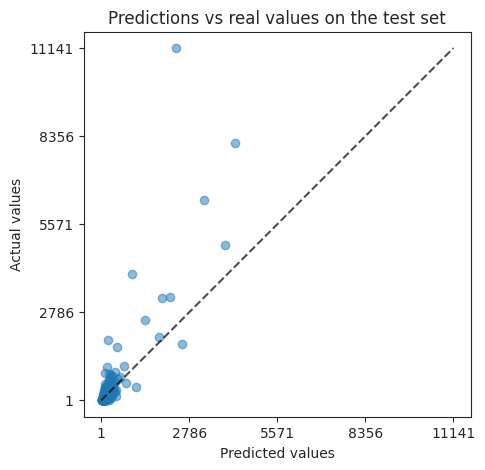

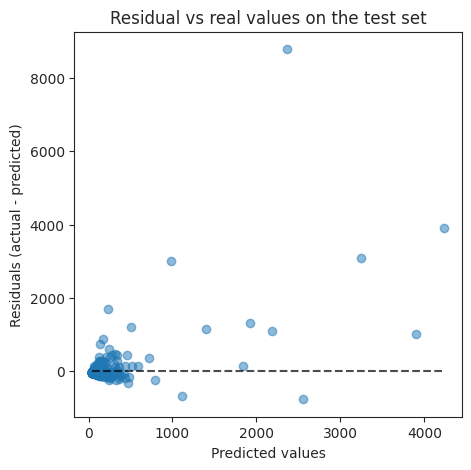


--------------------
min_max--- metric : MAE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 1, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [105.235  93.481  67.986 136.335  75.691]
    mean score:  95.746
    std score deviation:  24.147


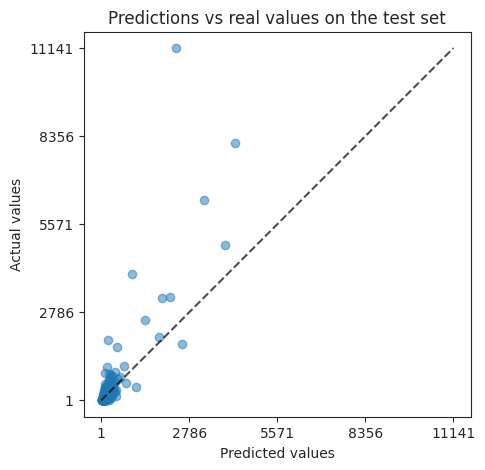

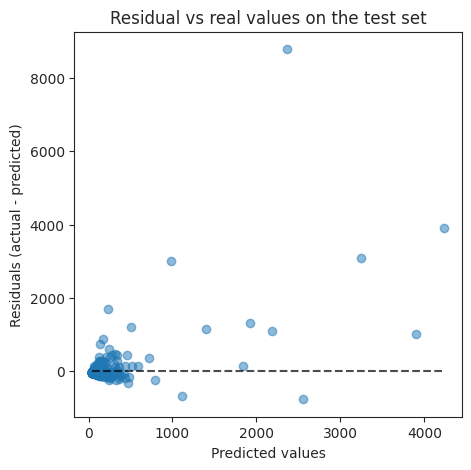


--------------------
min_max--- metric : RMSE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 2, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [ 572.996  342.938  162.485 1106.552  209.988]
    mean score:  478.992
    std score deviation:  344.592


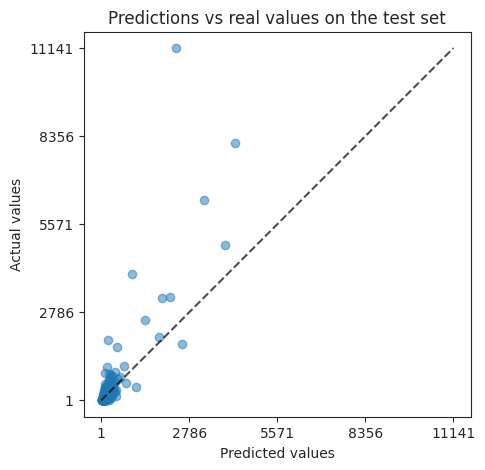

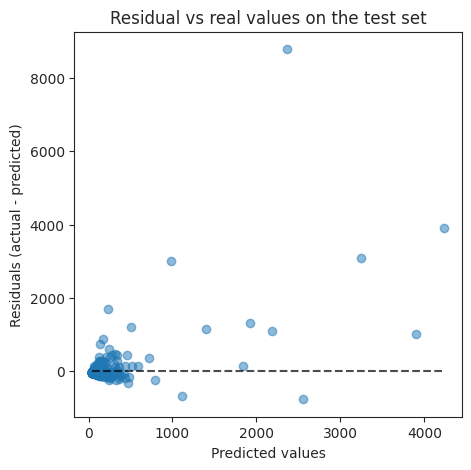


--------------------
mixed_log_min_max--- metric : R2

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 1, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [0.479 0.908 0.459 0.09  0.571]
    mean score:  0.502
    std score deviation:  0.262


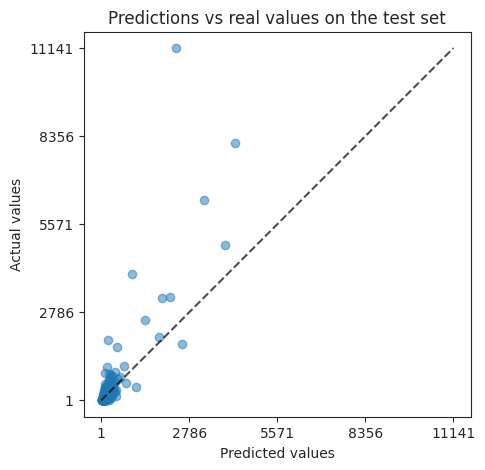

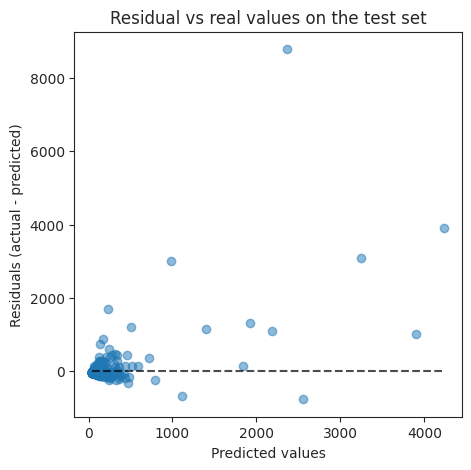


--------------------
mixed_log_min_max--- metric : MAE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 1, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [103.654  86.152  67.843 135.941  75.444]
    mean score:  93.807
    std score deviation:  24.258


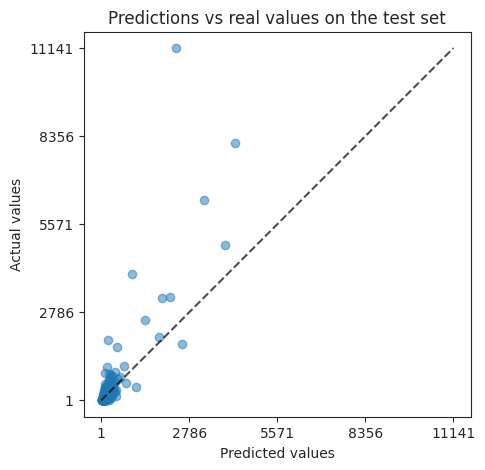

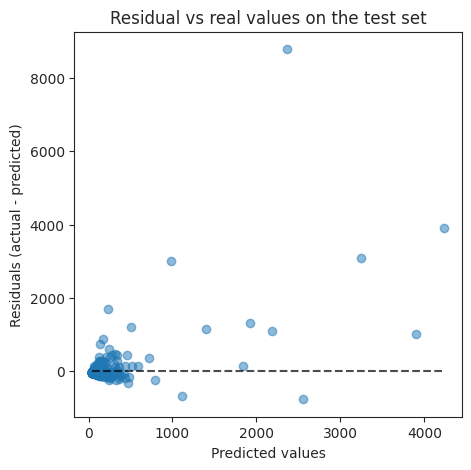


--------------------
mixed_log_min_max--- metric : RMSE

{'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regressor__min_samples_leaf': 1, 'regressor__regressor__min_samples_split': 1, 'regressor__regressor__n_estimators': 16}
Cross-validation evaluation : 
    scores on folds:  [ 550.835  260.264  162.286 1105.771  208.526]
    mean score:  457.536
    std score deviation:  351.285


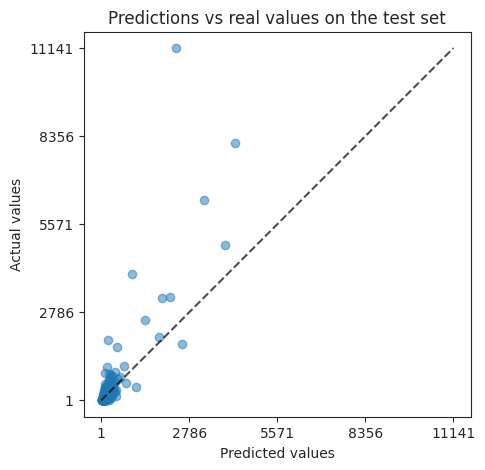

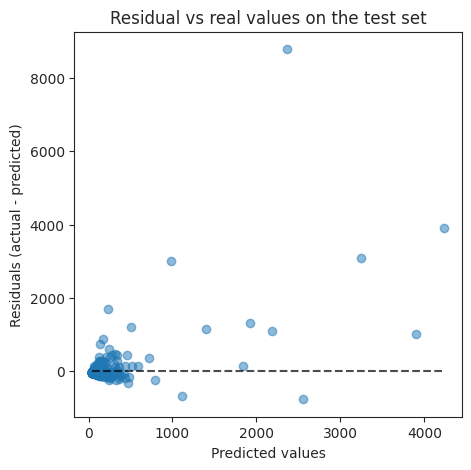

In [141]:
for pp_name in tmp_pre_processors:
    model = Pipeline(
        [
            ('pre_processor', tmp_pre_processors[pp_name]),
            (
                'regressor',
                RandomForestRegressor(
                    criterion='squared_error',
                    n_jobs=-1,
                    random_state=411,
                )
            )
        ]
    )
    
    full_model = TransformedTargetRegressor(
        regressor=model,
        transformer=log_transformer
    )


    param_grid = {
        "regressor__regressor__n_estimators": [15, 16],
        "regressor__regressor__max_depth": [11],
        "regressor__regressor__max_features": [10],
        "regressor__regressor__min_samples_leaf": [1, 2, 3],
        "regressor__regressor__min_samples_split": [1, 2, 3],
    }
    
    for i, metric in metrics.iterrows():

        # Tune
        search = GridSearchCV(
            full_model,
            param_grid=param_grid,
            cv=folds,
            scoring=metric.scoring_alias,
            refit=True
        )
        search.fit(X_train, y_train)
        
        # Print name of the pre-processor and metric
        print(
            f"\n"
            + "-"*20 + "\n"
            + pp_name
            + f"--- metric : {metric.name}"
            + "\n"
        )
        
        # Save best model and predict
        models_random_forest.append(search.best_estimator_)
        hyperparameters = search.best_params_
        print(hyperparameters)
        
                # CV evaluation
        cv_output = ds.CV_evaluation(
            search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
        )
                
        # Plotting
        ds.plot_predictions_vs_real_values(y_test, y_pred)
        # add to results
        results_random_forest.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                np.NaN,
                hyperparameters,
                cv_output[0],
                score_train,
                "Random_forest_regressor",
                pp_name,
                metric.name,
                'log',
                model_idx          
            ]
        )
        model_idx += 1
        

In [142]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"model_idx"
]

df_results_random_forest = pd.DataFrame(
results_random_forest, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    


In [143]:
df_results_random_forest.sort_values(['metric', 'CV_train_score_mean'])


CV_train_score_mean  \
metric pre_processor     regressor               target_transformer                        
MAE    mixed_log_min_max Random_forest_regressor log                              93.807   
       min_max           Random_forest_regressor log                              95.746   
       mixed_log_min_max Random_forest_regressor None                            102.432   
       min_max           Random_forest_regressor None                            102.555   
R2     min_max           Random_forest_regressor log                               0.478   
       mixed_log_min_max Random_forest_regressor log                               0.502   
       min_max           Random_forest_regressor None                              0.546   
       mixed_log_min_max Random_forest_regressor None                              0.555   
RMSE   mixed_log_min_max Random_forest_regressor None                            456.018   
                                                 log                             457.536   
       min_max           Random_forest_regressor None                            460.367   
                                                 log                             478.992   

                                                                     CV_train_score_std  \
metric pre_processor     regressor               target_transformer                       
MAE    mixed_log_min_max Random_forest_regressor log                             24.258   
       min_max           Random_forest_regressor log                             24.147   
       mixed_log_min_max Random_forest_regressor None                            31.056   
       min_max           Random_forest_regressor None                            30.864   
R2     min_max           Random_forest_regressor log                              0.242   
       mixed_log_min_max Random_forest_regressor log                              0.262   
       min_max           Random_forest_regressor None                             0.221   
       mixed_log_min_max Random_forest_regressor None                             0.227   
RMSE   mixed_log_min_max Random_forest_regressor None                           337.791   
                                                 log                            351.285   
       min_max           Random_forest_regressor None                           337.595   
                                                 log                            344.592   

                                                                     test_score  \
metric pre_processor     regressor               target_transformer               
MAE    mixed_log_min_max Random_forest_regressor log                  832.24987   
       min_max           Random_forest_regressor log                  832.24987   
       mixed_log_min_max Random_forest_regressor None                 832.24987   
       min_max           Random_forest_regressor None                 832.24987   
R2     min_max           Random_forest_regressor log                  832.24987   
       mixed_log_min_max Random_forest_regressor log                  832.24987   
       min_max           Random_forest_regressor None                 832.24987   
       mixed_log_min_max Random_forest_regressor None                 832.24987   
RMSE   mixed_log_min_max Random_forest_regressor None                 832.24987   
                                                 log                  832.24987   
       min_max           Random_forest_regressor None                 832.24987   
                                                 log                  832.24987   

                                                                     computation_time  \
metric pre_processor     regressor               target_transformer                     
MAE    mixed_log_min_max Random_forest_regressor log                              NaN   
       min_max           Random_forest_regressor log                       

The random Forest regressor is much less impacted by pre-processing and target transformation than other models see until now.

In [144]:
!mkdir GHG_predictions_models_and_results/random_forest_models

In [145]:
# Save scores
filename = (
    "GHG_predictions_models_and_results/"
    + "random_forest_models/"
    + "scores.csv"
)
df_results_random_forest.to_csv(filename)

# Save each model of models_regul in a joblib file.
for n, row in enumerate(df_results_random_forest.index):
    filename = (
        "./GHG_predictions_models_and_results/"
        + "random_forest_models/"
        + "_".join(list(row))
        + ".joblib"
    )
    dump(models_random_forest[n], filename)


# 8.  [&#9650;](#toc0_) <a id='toc8_'></a>Xgboost

## 8.1.  [&#9650;](#toc0_) <a id='toc8_1_'></a>No pre-processing

In [75]:
params_to_be_tuned = [
    'learning_rate',
    'n_estimators',
    'max_depth',
    'min_child_weight',
    "gamma",
    "colsample_bytree",
    "reg_lambda"
]

results_xgboost = []
models_xgboost = []
models_idx = 0

Above is a list of the hyperparameters i'm going to tune in order.

In [76]:
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
)

# Print and set the optimal number of estimators of the default XGBOOST regressor.
reg = ds.optimize_estimators_number(reg, X_train, y_train)

[0]	train-rmse:628.49035+68.49571	test-rmse:621.83795+318.22628
[1]	train-rmse:517.92326+62.34209	test-rmse:587.95395+309.21508
[2]	train-rmse:431.74712+55.67888	test-rmse:596.34615+283.38618
[3]	train-rmse:361.86055+49.38159	test-rmse:616.53751+261.32497
[4]	train-rmse:304.71117+43.90555	test-rmse:632.50655+245.12169
[5]	train-rmse:258.19079+38.50678	test-rmse:650.51469+243.37107
[6]	train-rmse:220.22445+33.01322	test-rmse:666.04065+246.39565
[7]	train-rmse:189.51291+27.93953	test-rmse:681.60599+254.18164
[8]	train-rmse:163.69116+23.74252	test-rmse:693.78577+263.21533
[9]	train-rmse:143.10740+19.87131	test-rmse:703.22163+270.99272
[10]	train-rmse:126.42342+16.65812	test-rmse:712.35084+280.67957
[11]	train-rmse:112.58027+13.64132	test-rmse:720.37319+288.52908


,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,628.490347,68.495715,621.837950,318.226282
1,517.923257,62.342086,587.953951,309.215079


In [151]:
# Print the number of estimators for controlling.
reg.get_params()['n_estimators']

2

In [152]:
ds.CV_evaluation(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train, scoring='neg_mean_absolute_error')

Cross-validation evaluation : 
    scores on folds:  [0.054 0.607 0.179 0.055 0.376]
    mean score:  0.254
    std score deviation:  0.212
Cross-validation evaluation : 
    scores on folds:  [139.205 121.628  90.995 153.162  91.136]
    mean score:  119.225
    std score deviation:  25.071


(array([139.205, 121.628,  90.995, 153.162,  91.136]), 119.225, 25.071)

In [153]:
# Decreasing the learning rate to see improvements ?
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
    learning_rate=0.2
)

# Print and set the optimal number of estimators of the default XGBOOST regressor.
reg = ds.optimize_estimators_number(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train, scoring='neg_mean_absolute_error')

[0]	train-rmse:674.50724+70.53564	test-rmse:646.62655+316.82942
[1]	train-rmse:594.46252+66.36251	test-rmse:608.58899+316.60629
[2]	train-rmse:524.89417+62.39772	test-rmse:588.12860+308.47215
[3]	train-rmse:466.32530+57.89540	test-rmse:593.59962+292.50150
[4]	train-rmse:415.03048+53.80808	test-rmse:602.19765+272.49600
[5]	train-rmse:370.28198+49.96913	test-rmse:612.77522+256.11477
[6]	train-rmse:330.91805+46.10194	test-rmse:626.14575+247.06073
[7]	train-rmse:296.51958+42.47909	test-rmse:637.72279+242.11650
[8]	train-rmse:266.31707+39.05973	test-rmse:649.39871+241.19812
[9]	train-rmse:239.59909+35.84247	test-rmse:658.53104+240.18382
[10]	train-rmse:216.21366+32.51790	test-rmse:668.30077+244.00471
[11]	train-rmse:195.74023+29.23004	test-rmse:676.89146+248.19507


,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,674.507243,70.535645,646.626554,316.829422
1,594.462520,66.362508,608.588993,316.606289
2,524.894168,62.397719,588.128600,308.472147


Cross-validation evaluation : 
    scores on folds:  [0.053 0.59  0.175 0.042 0.363]
    mean score:  0.245
    std score deviation:  0.208
Cross-validation evaluation : 
    scores on folds:  [138.083 122.648  90.755 155.657  91.897]
    mean score:  119.808
    std score deviation:  25.496


(array([138.083, 122.648,  90.755, 155.657,  91.897]), 119.808, 25.496)

In [77]:
# Decreasing the learning rate to see improvements ?
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
    learning_rate=0.1
)

# Print and set the optimal number of estimators of the default XGBOOST regressor.
reg = ds.optimize_estimators_number(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train, scoring='neg_mean_absolute_error')

[0]	train-rmse:720.82244+72.72894	test-rmse:675.24903+313.36382
[1]	train-rmse:677.47421+70.51676	test-rmse:648.90577+316.31849
[2]	train-rmse:637.11545+68.38326	test-rmse:627.21374+317.62508
[3]	train-rmse:599.44373+66.27303	test-rmse:611.56835+317.07463
[4]	train-rmse:564.30416+64.29124	test-rmse:599.49140+314.10788
[5]	train-rmse:532.45743+61.91094	test-rmse:596.09173+309.02844
[6]	train-rmse:502.64951+59.75276	test-rmse:596.05265+302.04200
[7]	train-rmse:474.71777+57.61704	test-rmse:597.94125+293.31019
[8]	train-rmse:448.51569+55.53082	test-rmse:601.90883+284.90243
[9]	train-rmse:423.91680+53.51296	test-rmse:606.21412+276.20712
[10]	train-rmse:400.87180+51.52898	test-rmse:611.84373+268.90124
[11]	train-rmse:379.22376+49.69686	test-rmse:616.84771+260.79303
[12]	train-rmse:358.95588+47.82586	test-rmse:623.15648+255.74330
[13]	train-rmse:339.97344+45.97043	test-rmse:629.24516+251.21770
[14]	train-rmse:322.05752+44.14539	test-rmse:634.34552+246.45299
[15]	train-rmse:305.31307+42.36342	

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,720.822444,72.728937,675.249026,313.363817
1,677.474212,70.516764,648.905772,316.318489
2,637.115453,68.383263,627.213738,317.625082
3,599.443731,66.273026,611.568350,317.074632
4,564.304161,64.291240,599.491396,314.107877
5,532.457426,61.910938,596.091727,309.028444
6,502.649510,59.752764,596.052654,302.042001


Cross-validation evaluation : 
    scores on folds:  [0.06  0.632 0.189 0.039 0.377]
    mean score:  0.26
    std score deviation:  0.222
Cross-validation evaluation : 
    scores on folds:  [137.638 118.642  88.27  154.846  90.387]
    mean score:  117.957
    std score deviation:  26.039


(array([137.638, 118.642,  88.27 , 154.846,  90.387]), 117.957, 26.039)

In [160]:
# Decreasing the learning rate to see improvements ?
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
    learning_rate=0.05
)

# Print and set the optimal number of estimators of the default XGBOOST regressor.
reg = ds.optimize_estimators_number(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train)
ds.CV_evaluation(reg, X_train, y_train, scoring='neg_mean_absolute_error')

[0]	train-rmse:744.07428+73.88143	test-rmse:690.78470+310.98366
[1]	train-rmse:721.58256+72.72745	test-rmse:676.00262+313.11340
[2]	train-rmse:699.86325+71.59853	test-rmse:662.24002+314.99873
[3]	train-rmse:678.88773+70.49809	test-rmse:649.93523+316.18337
[4]	train-rmse:658.63813+69.42000	test-rmse:638.73114+316.98131
[5]	train-rmse:639.05259+68.35214	test-rmse:628.72860+317.20847
[6]	train-rmse:620.13370+67.30712	test-rmse:620.30072+317.32296
[7]	train-rmse:601.82169+66.24839	test-rmse:612.83432+316.99294
[8]	train-rmse:584.13629+65.24758	test-rmse:606.13473+315.93139
[9]	train-rmse:567.02232+64.27036	test-rmse:600.58196+314.38253
[10]	train-rmse:551.00003+63.09802	test-rmse:597.89918+312.19787
[11]	train-rmse:535.46481+61.98349	test-rmse:596.66300+309.56462
[12]	train-rmse:520.44418+60.86785	test-rmse:596.15969+306.16438
[13]	train-rmse:505.89554+59.77383	test-rmse:596.15000+302.74145
[14]	train-rmse:491.79898+58.71486	test-rmse:596.96818+298.66517
[15]	train-rmse:478.14603+57.65862	

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
4,658.638130,69.420004,638.731143,316.981314
5,639.052594,68.352144,628.728599,317.208466
6,620.133704,67.307116,620.300724,317.322956
7,601.821686,66.248394,612.834316,316.992942
8,584.136294,65.247577,606.134735,315.931389
9,567.022320,64.270357,600.581957,314.382534
10,551.000030,63.098024,597.899183,312.197868
11,535.464806,61.983495,596.663005,309.564622
12,520.444182,60.867848,596.159687,306.164380
13,505.895538,59.773833,596.150002,302.741449


Cross-validation evaluation : 
    scores on folds:  [0.059 0.625 0.181 0.038 0.362]
    mean score:  0.253
    std score deviation:  0.219
Cross-validation evaluation : 
    scores on folds:  [137.418 119.979  88.513 155.402  91.046]
    mean score:  118.472
    std score deviation:  25.98


(array([137.418, 119.979,  88.513, 155.402,  91.046]), 118.472, 25.98)

learning_rate=0.1 seems a nice starting place because it minimizes variance while improving the mean score of the cross validation.

In [80]:
# Decreasing the learning rate to see improvements ?
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
    learning_rate=0.1
)

# Set the optimal number of estimators of the default XGBOOST regressor.
reg = ds.optimize_estimators_number(reg, X_train, y_train)

[0]	train-rmse:720.82244+72.72894	test-rmse:675.24903+313.36382
[1]	train-rmse:677.47421+70.51676	test-rmse:648.90577+316.31849
[2]	train-rmse:637.11545+68.38326	test-rmse:627.21374+317.62508
[3]	train-rmse:599.44373+66.27303	test-rmse:611.56835+317.07463
[4]	train-rmse:564.30416+64.29124	test-rmse:599.49140+314.10788
[5]	train-rmse:532.45743+61.91094	test-rmse:596.09173+309.02844
[6]	train-rmse:502.64951+59.75276	test-rmse:596.05265+302.04200
[7]	train-rmse:474.71777+57.61704	test-rmse:597.94125+293.31019
[8]	train-rmse:448.51569+55.53082	test-rmse:601.90883+284.90243
[9]	train-rmse:423.91680+53.51296	test-rmse:606.21412+276.20712
[10]	train-rmse:400.87180+51.52898	test-rmse:611.84373+268.90124
[11]	train-rmse:379.22376+49.69686	test-rmse:616.84771+260.79303
[12]	train-rmse:358.95588+47.82586	test-rmse:623.15648+255.74330
[13]	train-rmse:339.97344+45.97043	test-rmse:629.24516+251.21770
[14]	train-rmse:322.05752+44.14539	test-rmse:634.34552+246.45299
[15]	train-rmse:305.31307+42.36342	

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,720.822444,72.728937,675.249026,313.363817
1,677.474212,70.516764,648.905772,316.318489
2,637.115453,68.383263,627.213738,317.625082
3,599.443731,66.273026,611.568350,317.074632
4,564.304161,64.291240,599.491396,314.107877
5,532.457426,61.910938,596.091727,309.028444
6,502.649510,59.752764,596.052654,302.042001


In [79]:
# Current parameters of the XGBRegressor
{k: reg.get_params()[k] for k in params_to_be_tuned}

{'learning_rate': 0.1,
 'n_estimators': 7,
 'max_depth': None,
 'min_child_weight': None,
 'gamma': None,
 'colsample_bytree': None,
 'reg_lambda': None}

In [172]:
param_grid = {
    "max_depth": [3, 4, 5, 6, 7, 8],
    "min_child_weight": np.arange(1, 8, 2)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)


{'max_depth': 5, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [0.059 0.632 0.175 0.062 0.329]
    mean score:  0.251
    std score deviation:  0.214
{'max_depth': 7, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [134.712 120.068  87.071 154.568  89.091]
    mean score:  117.102
    std score deviation:  26.111
{'max_depth': 5, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [ 740.396  521.395  200.504 1122.423  260.958]
    mean score:  569.135
    std score deviation:  337.224


In [163]:
param_grid = {
    "max_depth": [5, 6, 7],
    "min_child_weight": [1],
    "gamma":np.arange(0, 0.6, 0.1)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)


{'gamma': 0.0, 'max_depth': 5, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [0.059 0.632 0.175 0.062 0.329]
    mean score:  0.251
    std score deviation:  0.214
{'gamma': 0.0, 'max_depth': 7, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [134.712 120.068  87.071 154.568  89.091]
    mean score:  117.102
    std score deviation:  26.111
{'gamma': 0.0, 'max_depth': 5, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [ 740.396  521.395  200.504 1122.423  260.958]
    mean score:  569.135
    std score deviation:  337.224


In [164]:
param_grid = {
    "max_depth": [5, 6, 7],
    "min_child_weight": [1],
    "gamma": [0],
    "colsample_bytree": [0.5, 0.7, 0.8, 0.9],
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)

{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [0.217 0.466 0.252 0.034 0.328]
    mean score:  0.259
    std score deviation:  0.141
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [125.43  133.543  82.725 151.953  91.663]
    mean score:  117.063
    std score deviation:  26.012
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 6, 'min_child_weight': 1}
Cross-validation evaluation : 
    scores on folds:  [ 675.775  628.324  190.871 1140.973  265.53 ]
    mean score:  580.295
    std score deviation:  339.562


Until now, I had improvements, but from now on, mae and rmse worsen. Only R2 improved a bit. I'm not going to use that sampling method.

In [167]:
param_grid = {
    "max_depth": [6, 7],
    "min_child_weight": [1],
    "gamma": [0],
    "colsample_bytree": [0.9],
    "reg_lambda": np.arange(0, 20, 10),
    "reg_alpha": np.logspace(-2, 2, 10)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)

{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 35.93813663804626, 'reg_lambda': 0}
Cross-validation evaluation : 
    scores on folds:  [0.44  0.539 0.306 0.011 0.358]
    mean score:  0.331
    std score deviation:  0.178
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 12.915496650148826, 'reg_lambda': 0}
Cross-validation evaluation : 
    scores on folds:  [122.111 133.517  79.857 156.959  91.671]
    mean score:  116.823
    std score deviation:  27.988
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 35.93813663804626, 'reg_lambda': 0}
Cross-validation evaluation : 
    scores on folds:  [ 571.31   583.707  183.844 1152.46   255.258]
    mean score:  549.316
    std score deviation:  342.196


In [168]:
param_grid = {
    "max_depth": [6, 7],
    "min_child_weight": [1],
    "gamma": [0],
    "colsample_bytree": [0.9],
    "reg_lambda": np.logspace(-10, -1, 10),
    "reg_alpha": np.logspace(1, 4, 10)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)

{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 21.544346900318832, 'reg_lambda': 0.001}
Cross-validation evaluation : 
    scores on folds:  [0.44  0.54  0.303 0.012 0.347]
    mean score:  0.328
    std score deviation:  0.178
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 21.544346900318832, 'reg_lambda': 0.0001}
Cross-validation evaluation : 
    scores on folds:  [121.93  133.594  79.889 156.97   91.672]
    mean score:  116.811
    std score deviation:  27.985
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 21.544346900318832, 'reg_lambda': 0.0001}
Cross-validation evaluation : 
    scores on folds:  [ 571.298  582.792  184.266 1152.175  257.385]
    mean score:  549.583
    std score deviation:  341.622


In [169]:
param_grid = {
    "max_depth": [6, 7],
    "min_child_weight": [1],
    "gamma": [0],
    "colsample_bytree": [0.9],
    "reg_lambda": np.logspace(-5, -3, 10),
    "reg_alpha": np.linspace(10, 40, 10)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)

{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 23.333333333333336, 'reg_lambda': 1e-05}
Cross-validation evaluation : 
    scores on folds:  [0.44  0.54  0.303 0.011 0.347]
    mean score:  0.328
    std score deviation:  0.178
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 23.333333333333336, 'reg_lambda': 1e-05}
Cross-validation evaluation : 
    scores on folds:  [121.737 133.517  79.898 156.745  91.693]
    mean score:  116.718
    std score deviation:  27.898
{'colsample_bytree': 0.9, 'gamma': 0, 'max_depth': 7, 'min_child_weight': 1, 'reg_alpha': 23.333333333333336, 'reg_lambda': 1e-05}
Cross-validation evaluation : 
    scores on folds:  [ 571.315  582.801  184.266 1152.457  257.432]
    mean score:  549.654
    std score deviation:  341.714


This did not help either. So best results were found with the following :

In [82]:
param_grid = {
    "max_depth": [6, 7],
    "min_child_weight": [1],
    "gamma": [0],
    "colsample_bytree": [0.9],
    "reg_lambda": np.logspace(-6, -5, 10),
    "reg_alpha": np.linspace(20, 30, 10)
}

for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        reg, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    treg = search.best_estimator_
    hyperparameters = {k: treg.get_params()[k] for k in params_to_be_tuned}
    print(hyperparameters)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)
    
    models_xgboost.append(search.best_estimator_)

    results_xgboost.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            np.NaN,
            hyperparameters,
            cv_output[0],
            score_train,
            "xgboost gbtree",
            "None",
            metric.name,
            'None',
            models_idx          
        ]
    )
    models_idx += 1

{'learning_rate': 0.1, 'n_estimators': 7, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0, 'colsample_bytree': 0.9, 'reg_lambda': 1e-06}
Cross-validation evaluation : 
    scores on folds:  [0.433 0.539 0.309 0.011 0.345]
    mean score:  0.328
    std score deviation:  0.177
{'learning_rate': 0.1, 'n_estimators': 7, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0, 'colsample_bytree': 0.9, 'reg_lambda': 1e-06}
Cross-validation evaluation : 
    scores on folds:  [121.938 133.605  79.962 156.927  91.678]
    mean score:  116.822
    std score deviation:  27.954
{'learning_rate': 0.1, 'n_estimators': 7, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0, 'colsample_bytree': 0.9, 'reg_lambda': 1e-06}
Cross-validation evaluation : 
    scores on folds:  [ 571.313  582.8    184.296 1152.168  257.405]
    mean score:  549.596
    std score deviation:  341.61


## 8.2.  [&#9650;](#toc0_) <a id='toc8_2_'></a>With pre-processing and target transformation.

In [83]:
pp = pre_processors[3]
pp

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthroug...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

In [84]:
# Transforming the target changes the scores?
reg = xgb.XGBRegressor(
    booster="gbtree",
    tree_method='gpu_hist',
    learning_rate=0.1
)

reg_part = Pipeline(
    [
        ('pre_processor', pp),
        ('regressor', reg),
    ]
)

full_model = TransformedTargetRegressor(
    regressor=reg_part,
    transformer=log_transformer
)

print('Default score reg_part:')
ds.CV_evaluation(reg_part, X_train, y_train)
ds.CV_evaluation(
    reg_part, X_train, y_train, scoring='neg_mean_absolute_error'
)

print('\nDefault score full_model:')
ds.CV_evaluation(full_model, X_train, y_train)
ds.CV_evaluation(
    full_model, X_train, y_train, scoring='neg_mean_absolute_error'
)

Default score reg_part:
Cross-validation evaluation : 
    scores on folds:  [0.294 0.223 0.566 0.154 0.726]
    mean score:  0.393
    std score deviation:  0.218
Cross-validation evaluation : 
    scores on folds:  [114.273 143.182  67.895 148.765  69.493]
    mean score:  108.722
    std score deviation:  34.72

Default score full_model:
Cross-validation evaluation : 
    scores on folds:  [0.543 0.73  0.552 0.114 0.766]
    mean score:  0.541
    std score deviation:  0.232
Cross-validation evaluation : 
    scores on folds:  [ 94.368 102.649  61.188 136.479  60.676]
    mean score:  91.072
    std score deviation:  28.368


(array([ 94.368, 102.649,  61.188, 136.479,  60.676]), 91.072, 28.368)

Contrary to the random forest regressor, here, pre_processing and transforming target helps!


In [85]:
# pre-processing apart to allow evaluation with the xgb_cv function.
X_train_pp = pd.DataFrame(
    data=reg_part[:-1].fit_transform(X_train),
    columns=reg_part[:-1].get_feature_names_out()
)

X_test_pp = reg_part[:-1].transform(X_test)

y_train_pp = log_transformer.transform(y_train)
y_test_pp = log_transformer.transform(y_test)

# Set the optimal number of trees
reg = ds.optimize_estimators_number(reg, X_train_pp, y_train_pp)

[0]	train-rmse:3.41974+0.01955	test-rmse:3.42216+0.08408
[1]	train-rmse:3.09995+0.01718	test-rmse:3.10525+0.08227
[2]	train-rmse:2.81260+0.01509	test-rmse:2.82284+0.07851
[3]	train-rmse:2.55390+0.01376	test-rmse:2.56835+0.07229
[4]	train-rmse:2.32194+0.01197	test-rmse:2.34284+0.06812
[5]	train-rmse:2.11356+0.01059	test-rmse:2.13885+0.06477
[6]	train-rmse:1.92670+0.00972	test-rmse:1.95664+0.06030
[7]	train-rmse:1.75924+0.00854	test-rmse:1.79851+0.05693
[8]	train-rmse:1.60907+0.00743	test-rmse:1.65352+0.05472
[9]	train-rmse:1.47454+0.00635	test-rmse:1.52564+0.05284
[10]	train-rmse:1.35452+0.00545	test-rmse:1.41357+0.04950
[11]	train-rmse:1.24732+0.00462	test-rmse:1.31534+0.04873
[12]	train-rmse:1.15179+0.00435	test-rmse:1.22901+0.04765
[13]	train-rmse:1.06646+0.00388	test-rmse:1.15357+0.04631
[14]	train-rmse:0.99085+0.00388	test-rmse:1.08657+0.04447
[15]	train-rmse:0.92359+0.00369	test-rmse:1.02901+0.04319
[16]	train-rmse:0.86368+0.00378	test-rmse:0.97976+0.04194
[17]	train-rmse:0.81043+

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
57,0.385174,0.006910,0.677770,0.029279
58,0.383644,0.006968,0.677259,0.029290
59,0.382043,0.006332,0.677146,0.029145
60,0.380632,0.006073,0.677023,0.028955
61,0.378578,0.006130,0.677418,0.029138
62,0.376427,0.006114,0.677048,0.028928
63,0.375175,0.005905,0.676359,0.028882
64,0.373706,0.005612,0.675925,0.029220
65,0.371824,0.005505,0.675983,0.029667
66,0.370806,0.005109,0.675721,0.029758


In [86]:
reg_part = Pipeline(
    [
        ('pre_processor', pp),
        ('regressor', reg),
    ]
)

full_model = TransformedTargetRegressor(
    regressor=reg_part,
    transformer=log_transformer
)

# Verifying n_estimators = 67
display(full_model)

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                   max_cat_threshold=None,
                                                                   max_cat_to_onehot=None,
                                                                   max_delta_step=None,
                                                                   max_depth=None,
                                                                   max_leaves=None,
                                                                   min_child_weight=None,
                                                                   missing=nan,
                                                                   monotone_constraints=None,
                                                                   n_estimators=67,
                                                                   n_jobs=None,
                                                                   num_parallel_tree=None,
                                                                   predictor=None,
                                                                   random_state=None, ...))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

In [87]:
# Initial score with the 0.1 learning rate and the optimal n_estimators
print('Default score :')
ds.CV_evaluation(full_model, X_train, y_train)
ds.CV_evaluation(
    full_model, X_train, y_train, scoring='neg_mean_absolute_error'
)
_ = ds.CV_evaluation(
    full_model, X_train, y_train, scoring='neg_root_mean_squared_error'
)


Default score :
Cross-validation evaluation : 
    scores on folds:  [0.501 0.651 0.522 0.121 0.76 ]
    mean score:  0.511
    std score deviation:  0.216
Cross-validation evaluation : 
    scores on folds:  [ 97.594 107.015  63.243 135.307  60.521]
    mean score:  92.736
    std score deviation:  28.098
Cross-validation evaluation : 
    scores on folds:  [ 539.262  507.575  152.571 1086.42   155.979]
    mean score:  488.361
    std score deviation:  341.721


In [182]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [4, 5, 6, 7],
    prefix + "min_child_weight": [1, 2, 3]
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.501 0.651 0.522 0.121 0.76 ]
    mean score:  0.511
    std score deviation:  0.216


{'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 97.594 107.015  63.243 135.307  60.521]
    mean score:  92.736
    std score deviation:  28.098


{'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 539.262  507.575  152.571 1086.42   155.979]
    mean score:  488.361
    std score deviation:  341.721


{'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1}

In [40]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5,6,7],
    prefix + "min_child_weight": [1],
    prefix + "gamma": [0, 0.001, 0.1, 0.2, 0.3, 0.5, 1]
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.511 0.66  0.521 0.097 0.773]
    mean score:  0.512
    std score deviation:  0.229


{'regressor__regressor__gamma': 0.2,
 'regressor__regressor__max_depth': 7,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 98.227 106.299  63.809 136.979  60.302]
    mean score:  93.123
    std score deviation:  28.494


{'regressor__regressor__gamma': 0.2,
 'regressor__regressor__max_depth': 7,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 539.262  507.575  152.571 1086.42   155.979]
    mean score:  488.361
    std score deviation:  341.721


{'regressor__regressor__gamma': 0,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1}

Gamma did not improve scores.

In [41]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "subsample": [0.5, 0.7, 0.8, 1],
    prefix + "colsample_bytree": [0.5, 0.7, 0.8, 1]
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.501 0.651 0.522 0.121 0.76 ]
    mean score:  0.511
    std score deviation:  0.216


{'regressor__regressor__colsample_bytree': 1,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__subsample': 1}

Cross-validation evaluation : 
    scores on folds:  [ 91.744  93.666  65.459 136.586  66.147]
    mean score:  90.72
    std score deviation:  25.905


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__subsample': 1}

Cross-validation evaluation : 
    scores on folds:  [ 539.262  507.575  152.571 1086.42   155.979]
    mean score:  488.361
    std score deviation:  341.721


{'regressor__regressor__colsample_bytree': 1,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__subsample': 1}

had a nice improvement with colsample_bytree for mae. What if I force that for the other metrics.

In [42]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "colsample_bytree": [0.6, 0.7]
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.581 0.664 0.493 0.093 0.687]
    mean score:  0.504
    std score deviation:  0.216


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 91.744  93.666  65.459 136.586  66.147]
    mean score:  90.72
    std score deviation:  25.905


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1}

Cross-validation evaluation : 
    scores on folds:  [ 493.779  498.243  157.215 1103.883  178.304]
    mean score:  486.285
    std score deviation:  341.984


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1}

It helps decreasing also the RMSE but worsen the R squared.
I will force it because it is known to lower over-fitting differentiating trees

In [44]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "colsample_bytree": [0.7],
    prefix + "reg_lambda": [0, 0.0001, 0.01, 1, 2, 4, 10],
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.581 0.664 0.493 0.093 0.687]
    mean score:  0.504
    std score deviation:  0.216


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 1}

Cross-validation evaluation : 
    scores on folds:  [104.199  72.09   65.915 137.142  67.12 ]
    mean score:  89.293
    std score deviation:  27.734


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 0.01}

Cross-validation evaluation : 
    scores on folds:  [ 625.599  249.184  154.829 1104.077  183.004]
    mean score:  463.339
    std score deviation:  362.354


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 0.01}

Improvements on RMSE and MAE.

In [45]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "colsample_bytree": [0.7],
    prefix + "reg_lambda": np.logspace(-3,-1, 10),
    prefix + "reg_alpha": np.logspace(-5, 5, 10),
}


print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.33  0.829 0.497 0.132 0.677]
    mean score:  0.493
    std score deviation:  0.246


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 0.0001291549665014884,
 'regressor__regressor__reg_lambda': 0.0027825594022071257}

Cross-validation evaluation : 
    scores on folds:  [101.313  84.076  66.803 136.142  64.558]
    mean score:  90.578
    std score deviation:  26.366


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 0.0016681005372000592,
 'regressor__regressor__reg_lambda': 0.004641588833612777}

Cross-validation evaluation : 
    scores on folds:  [ 612.65   244.501  159.017 1081.353  188.803]
    mean score:  457.265
    std score deviation:  352.114


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 1e-05,
 'regressor__regressor__reg_lambda': 0.01291549665014884}

In [46]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "colsample_bytree": [0.7],
    prefix + "reg_lambda": np.logspace(-3,-2, 10),
}

print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    hyperparameters = search.best_params_
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.31  0.882 0.503 0.163 0.682]
    mean score:  0.508
    std score deviation:  0.256


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 0.003593813663804626}

Cross-validation evaluation : 
    scores on folds:  [104.199  72.09   65.915 137.142  67.12 ]
    mean score:  89.293
    std score deviation:  27.734


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 0.01}

Cross-validation evaluation : 
    scores on folds:  [ 606.615  298.199  157.601 1078.899  183.748]
    mean score:  465.012
    std score deviation:  345.932


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_lambda': 0.005994842503189409}

In [43]:
full_model.regressor[-1]

XGBRegressor(base_score=None, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [88]:
prefix = "regressor__regressor__"

param_grid = {
    prefix + "max_depth": [5, 6],
    prefix + "min_child_weight": [1],
    prefix + "colsample_bytree": [0.7],
    prefix + "reg_lambda": [*np.logspace(-3,-2, 5), 1],
    prefix + "reg_alpha": [0, 1e-7, 1e-6, 1e-5],
}

print("Grid searches:")
for i, metric in metrics.iterrows():
    # Tune
    search = GridSearchCV(
        full_model, param_grid=param_grid, scoring=metric.scoring_alias
    )
    search.fit(X_train, y_train)
    # Predict, evaluate and prepare the results saving
    y_pred = search.predict(X_test)
    y_pred_train = search.predict(X_train)
    cv_output = ds.CV_evaluation(
        search.best_estimator_, X_train, y_train, scoring=metric.scoring_alias
    )
    display(search.best_params_)
    treg = search.best_estimator_.regressor[-1]
    hyperparameters = {k: treg.get_params()[k] 
                       for k in params_to_be_tuned}

    score_train = apply_score_func(metric, y_train, y_pred_train)
    score_test = apply_score_func(metric, y_test, y_pred)

    models_xgboost.append(search.best_estimator_)

    results_xgboost.append(
        [
            cv_output[1],
            cv_output[2],
            score_test,
            np.NaN,
            hyperparameters,
            cv_output[0],
            score_train,
            "xgboost_gbtree",
            "mixed_log_min_max",
            metric.name,
            'log',
            models_idx          
        ]
    )
    models_idx += 1

Grid searches:
Cross-validation evaluation : 
    scores on folds:  [0.324 0.756 0.502 0.112 0.669]
    mean score:  0.473
    std score deviation:  0.233


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 1e-07,
 'regressor__regressor__reg_lambda': 0.0017782794100389228}

Cross-validation evaluation : 
    scores on folds:  [ 91.744  93.666  65.459 136.586  66.147]
    mean score:  90.72
    std score deviation:  25.905


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 5,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 1e-06,
 'regressor__regressor__reg_lambda': 1}

Cross-validation evaluation : 
    scores on folds:  [ 625.6    249.186  154.829 1091.465  183.003]
    mean score:  460.817
    std score deviation:  357.901


{'regressor__regressor__colsample_bytree': 0.7,
 'regressor__regressor__max_depth': 6,
 'regressor__regressor__min_child_weight': 1,
 'regressor__regressor__reg_alpha': 1e-05,
 'regressor__regressor__reg_lambda': 0.01}

In [89]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"metric",
"target_transformer",
"model_idx"
]

df_results_xgboost = pd.DataFrame(
    results_xgboost, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           

df_results_xgboost.sort_values(['metric', 'CV_train_score_mean'])


CV_train_score_mean  \
metric pre_processor     regressor      target_transformer                        
MAE    mixed_log_min_max xgboost_gbtree log                              90.720   
       None              xgboost gbtree None                            116.822   
R2     None              xgboost gbtree None                              0.328   
       mixed_log_min_max xgboost_gbtree log                               0.473   
RMSE   mixed_log_min_max xgboost_gbtree log                             460.817   
       None              xgboost gbtree None                            549.596   

                                                            CV_train_score_std  \
metric pre_processor     regressor      target_transformer                       
MAE    mixed_log_min_max xgboost_gbtree log                             25.905   
       None              xgboost gbtree None                            27.954   
R2     None              xgboost gbtree None                             0.177   
       mixed_log_min_max xgboost_gbtree log                              0.233   
RMSE   mixed_log_min_max xgboost_gbtree log                            357.901   
       None              xgboost gbtree None                           341.610   

                                                            test_score  \
metric pre_processor     regressor      target_transformer               
MAE    mixed_log_min_max xgboost_gbtree log                  136.37782   
       None              xgboost gbtree None                 155.49020   
R2     None              xgboost gbtree None                   0.39529   
       mixed_log_min_max xgboost_gbtree log                    0.44682   
RMSE   mixed_log_min_max xgboost_gbtree log                  672.99508   
       None              xgboost gbtree None                 704.03294   

                                                            computation_time  \
metric pre_processor     regressor      target_transformer                     
MAE    mixed_log_min_max xgboost_gbtree log                              NaN   
       None              xgboost gbtree None                             NaN   
R2     None              xgboost gbtree None                             NaN   
       mixed_log_min_max xgboost_gbtree log                              NaN   
RMSE   mixed_log_min_max xgboost_gbtree log                              NaN   
       None              xgboost gbtree None                             NaN   

                                                                                                                                                                                                           hyperparameters  \
metric pre_processor     regressor      target_transformer                                                                                                                                                                   
MAE    mixed_log_min_max xgboost_gbtree log                                     {'learning_rate': 0.1, 'n_estimators': 67, 'max_depth': 5, 'min_child_weight': 1, 'gamma': None, 'colsample_bytree': 0.7, 'reg_lambda': 1}   
       None              xgboost gbtree None                                    {'learning_rate': 0.1, 'n_estimators': 7, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0, 'colsample_bytree': 0.9, 'reg_lambda': 1e-06}   
R2     None              xgboost gbtree None                                    {'learning_rate': 0.1, 'n_estimators': 7, 'max_depth': 7, 'min_child_weight': 1, 'gamma': 0, 'colsample_bytree': 0.9, 'reg_lambda': 1e-06}   
       mixed_log_min_max xgboost_gbtree log                 {'learning_rate': 0.1, 'n_estimators': 67, 'max_depth': 6, 'min_child_weight': 1, 'gamma': None, 'colsample_bytree': 0.7, 'reg_lambda': 0.0017782794100389228}   
RMSE   mixed_log_min_max xgboost_gbtree log                                  {'learning_rate': 0.1, 'n_estimators': 67, 'max_depth': 6, 'min_child_weight': 1, 'gamma': None

Let's verify if after all these tuning, if the model still has its optimal number of estimators

In [96]:
# Selecting the optimal regressor found for MAE
chosen_reg = models_xgboost[-2].regressor[-1]
chosen_reg

XGBRegressor(base_score=None, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.7, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=5, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             n_estimators=67, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [97]:
reg_part = Pipeline(
    [
        ('pre_processor', pp),
        ('regressor', chosen_reg),
    ]
)

full_model = TransformedTargetRegressor(
    regressor=reg_part,
    transformer=log_transformer
)

# pre-processing apart to allow evaluation with the xgb_cv function.
X_train_pp = pd.DataFrame(
    data=reg_part[:-1].fit_transform(X_train),
    columns=reg_part[:-1].get_feature_names_out()
)

X_test_pp = reg_part[:-1].transform(X_test)

y_train_pp = log_transformer.transform(y_train)
y_test_pp = log_transformer.transform(y_test)

# Set the optimal number of trees
reg = ds.optimize_estimators_number(reg, X_train_pp, y_train_pp)


[0]	train-rmse:3.41974+0.01955	test-rmse:3.42216+0.08408
[1]	train-rmse:3.09995+0.01718	test-rmse:3.10525+0.08227
[2]	train-rmse:2.81260+0.01509	test-rmse:2.82284+0.07851
[3]	train-rmse:2.55390+0.01376	test-rmse:2.56835+0.07229
[4]	train-rmse:2.32194+0.01197	test-rmse:2.34284+0.06812
[5]	train-rmse:2.11356+0.01059	test-rmse:2.13885+0.06477
[6]	train-rmse:1.92670+0.00972	test-rmse:1.95664+0.06030
[7]	train-rmse:1.75924+0.00854	test-rmse:1.79851+0.05693
[8]	train-rmse:1.60907+0.00743	test-rmse:1.65352+0.05472
[9]	train-rmse:1.47454+0.00635	test-rmse:1.52564+0.05284
[10]	train-rmse:1.35452+0.00545	test-rmse:1.41357+0.04950
[11]	train-rmse:1.24732+0.00462	test-rmse:1.31534+0.04873
[12]	train-rmse:1.15179+0.00435	test-rmse:1.22901+0.04765
[13]	train-rmse:1.06646+0.00388	test-rmse:1.15357+0.04631
[14]	train-rmse:0.99085+0.00388	test-rmse:1.08657+0.04447
[15]	train-rmse:0.92359+0.00369	test-rmse:1.02901+0.04319
[16]	train-rmse:0.86368+0.00378	test-rmse:0.97976+0.04194
[17]	train-rmse:0.81043+

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
57,0.385174,0.006910,0.677770,0.029279
58,0.383644,0.006968,0.677259,0.029290
59,0.382043,0.006332,0.677146,0.029145
60,0.380632,0.006073,0.677023,0.028955
61,0.378578,0.006130,0.677418,0.029138
62,0.376427,0.006114,0.677048,0.028928
63,0.375175,0.005905,0.676359,0.028882
64,0.373706,0.005612,0.675925,0.029220
65,0.371824,0.005505,0.675983,0.029667
66,0.370806,0.005109,0.675721,0.029758


The optimal N_estimators remains at 67

In [100]:
!mkdir GHG_predictions_models_and_results/xgboost_models

In [101]:
# Save scores
filename = (
    "./GHG_predictions_models_and_results/"
    + "xgboost_models/"
    + "scores.csv"
)
df_results_xgboost.to_csv(filename)

# Save each model of models_regul in a joblib file.
for n, row in enumerate(df_results_xgboost.index):
    filename = (
        "./GHG_predictions_models_and_results/"
        + "xgboost_models/"
        + "_".join(list(row))
        + ".joblib"
    )
    dump(models_xgboost[n], filename)

# 9.  [&#9650;](#toc0_) <a id='toc9_'></a>Summary

## 9.1.  [&#9650;](#toc0_) <a id='toc9_1_'></a>Models comparisons

### 9.1.1.  [&#9650;](#toc0_) <a id='toc9_1_1_'></a>Top scorer models

In [46]:
from glob import glob

# Collect and concat scores df
scores_filenames = glob("./GHG*/*/score*")
dfs = []
for fn in scores_filenames:
    results = pd.read_csv(fn)
    dfs.append(results)
    
evaluation = pd.concat(dfs, axis=0)

# Define one df per metric
for i, metric in metrics.iterrows():
    exec(f"{metric.name}" + "= evaluation.query('metric == @metric.name')")
    

In [47]:
# Sort by scores each df per metric
for metric in ["R2", "MAE", "RMSE"]:
    exec(
            metric
            + " = "
            + metric
            + ".set_index(['pre_processor', 'regressor', 'target_transformer'])"
            + ".sort_values(['CV_train_score_mean'])"
    )


 R2 



metric  \
pre_processor                regressor               target_transformer                   
mixed_log_min_max            lasso                   log                             R2   
                             elastic_net             log                             R2   
                             ridge                   log                             R2   
                             Random_forest_regressor None                            R2   
uniform_quantile_transformer LinearRegression        log_transformer                 R2   
min_max                      Random_forest_regressor None                            R2   
uniform_quantile_transformer LinearRegression        normal_quantile_transformer     R2   
mixed_log_min_max            Random_forest_regressor log                             R2   
min_max                      Random_forest_regressor log                             R2   
mixed_log_min_max            xgboost_gbtree          log                             R2   

                                                                                  CV_train_score_mean  \
pre_processor                regressor               target_transformer                                 
mixed_log_min_max            lasso                   log                                        0.648   
                             elastic_net             log                                        0.648   
                             ridge                   log                                        0.647   
                             Random_forest_regressor None                                       0.555   
uniform_quantile_transformer LinearRegression        log_transformer                            0.555   
min_max                      Random_forest_regressor None                                       0.546   
uniform_quantile_transformer LinearRegression        normal_quantile_transformer                0.538   
mixed_log_min_max            Random_forest_regressor log                                        0.502   
min_max                      Random_forest_regressor log                                        0.478   
mixed_log_min_max            xgboost_gbtree          log                                        0.473   

                                                                                  CV_train_score_std  \
pre_processor                regressor               target_transformer                                
mixed_log_min_max            lasso                   log                                       0.270   
                             elastic_net             log                                       0.270   
                             ridge                   log                                       0.271   
                             Random_forest_regressor None                                      0.227   
uniform_quantile_transformer LinearRegression        log_transformer                           0.321   
min_max                      Random_forest_regressor None                                      0.221   
uniform_quantile_transformer LinearRegression        normal_quantile_transformer               0.311   
mixed_log_min_max            Random_forest_regressor log                                       0.262   
min_max                      Random_forest_regressor log                                       0.242   
mixed_log_min_max            xgboost_gbtree          log                                       0.233   

                                                                                  test_score  \
pre_processor                regressor               target_transformer                        
mixed_log_min_max            lasso                   log                             0.74571   
                             elastic_net             log                             0.74599   
                             ridge                   log                             0.79166  


 MAE 



metric  \
pre_processor                regressor               target_transformer          
mixed_log_min_max            elastic_net             log                   MAE   
                             lasso                   log                   MAE   
                             ridge                   log                   MAE   
log_transformer_only         LinearRegression        log_transformer       MAE   
log_into_standard_scaler     LinearRegression        log_transformer       MAE   
log_into_min_max_scaler      LinearRegression        log_transformer       MAE   
mixed_log_min_max            xgboost_gbtree          log                   MAE   
uniform_quantile_transformer LinearRegression        log_transformer       MAE   
mixed_log_min_max            Random_forest_regressor log                   MAE   
min_max                      Random_forest_regressor log                   MAE   

                                                                         CV_train_score_mean  \
pre_processor                regressor               target_transformer                        
mixed_log_min_max            elastic_net             log                              81.924   
                             lasso                   log                              81.944   
                             ridge                   log                              83.308   
log_transformer_only         LinearRegression        log_transformer                  90.327   
log_into_standard_scaler     LinearRegression        log_transformer                  90.411   
log_into_min_max_scaler      LinearRegression        log_transformer                  90.411   
mixed_log_min_max            xgboost_gbtree          log                              90.720   
uniform_quantile_transformer LinearRegression        log_transformer                  93.786   
mixed_log_min_max            Random_forest_regressor log                              93.807   
min_max                      Random_forest_regressor log                              95.746   

                                                                         CV_train_score_std  \
pre_processor                regressor               target_transformer                       
mixed_log_min_max            elastic_net             log                             31.132   
                             lasso                   log                             31.067   
                             ridge                   log                             31.124   
log_transformer_only         LinearRegression        log_transformer                 30.354   
log_into_standard_scaler     LinearRegression        log_transformer                 30.157   
log_into_min_max_scaler      LinearRegression        log_transformer                 30.157   
mixed_log_min_max            xgboost_gbtree          log                             25.905   
uniform_quantile_transformer LinearRegression        log_transformer                 31.576   
mixed_log_min_max            Random_forest_regressor log                             24.258   
min_max                      Random_forest_regressor log                             24.147   

                                                                         test_score  \
pre_processor                regressor               target_transformer               
mixed_log_min_max            elastic_net             log                  109.76719   
                             lasso                   log                  108.96360   
                             ridge                   log                  107.30543   
log_transformer_only         LinearRegression        log_transformer       91.38361   
log_into_standard_scaler     LinearRegression        log_transformer       88.12554   
log_into_min_max_scaler      LinearRegression        log_transformer       88.12554   
mixed_log_min_max            xgboost_gbtree          log                  136.37782   
uniform_qu


 RMSE 



metric  \
pre_processor                regressor               target_transformer                   
mixed_log_min_max            lasso                   log                           RMSE   
                             elastic_net             log                           RMSE   
                             ridge                   log                           RMSE   
uniform_quantile_transformer LinearRegression        log_transformer               RMSE   
                                                     normal_quantile_transformer   RMSE   
log_standard_scaler          knn_regressor           log                           RMSE   
standard_scaler              knn_regressor           None                          RMSE   
mixed_log_min_max            Random_forest_regressor None                          RMSE   
                                                     log                           RMSE   
min_max                      Random_forest_regressor None                          RMSE   

                                                                                  CV_train_score_mean  \
pre_processor                regressor               target_transformer                                 
mixed_log_min_max            lasso                   log                                      392.689   
                             elastic_net             log                                      392.713   
                             ridge                   log                                      396.641   
uniform_quantile_transformer LinearRegression        log_transformer                          416.677   
                                                     normal_quantile_transformer              433.638   
log_standard_scaler          knn_regressor           log                                      447.755   
standard_scaler              knn_regressor           None                                     449.259   
mixed_log_min_max            Random_forest_regressor None                                     456.018   
                                                     log                                      457.536   
min_max                      Random_forest_regressor None                                     460.367   

                                                                                  CV_train_score_std  \
pre_processor                regressor               target_transformer                                
mixed_log_min_max            lasso                   log                                     349.222   
                             elastic_net             log                                     349.189   
                             ridge                   log                                     353.022   
uniform_quantile_transformer LinearRegression        log_transformer                         339.097   
                                                     normal_quantile_transformer             340.197   
log_standard_scaler          knn_regressor           log                                     331.464   
standard_scaler              knn_regressor           None                                    327.774   
mixed_log_min_max            Random_forest_regressor None                                    337.791   
                                                     log                                     351.285   
min_max                      Random_forest_regressor None                                    337.595   

                                                                                  test_score  \
pre_processor                regressor               target_transformer                        
mixed_log_min_max            lasso                   log                           469.01308   
                             elastic_net             log                           469.84772   
                             ridge                   log                           437.98558  

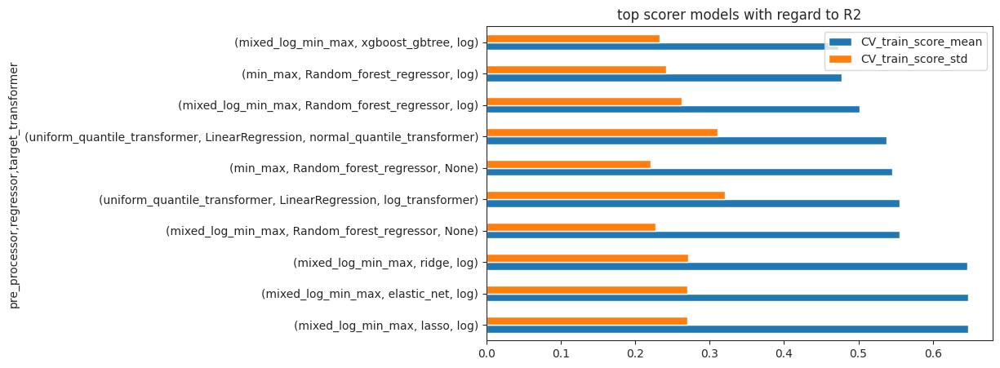

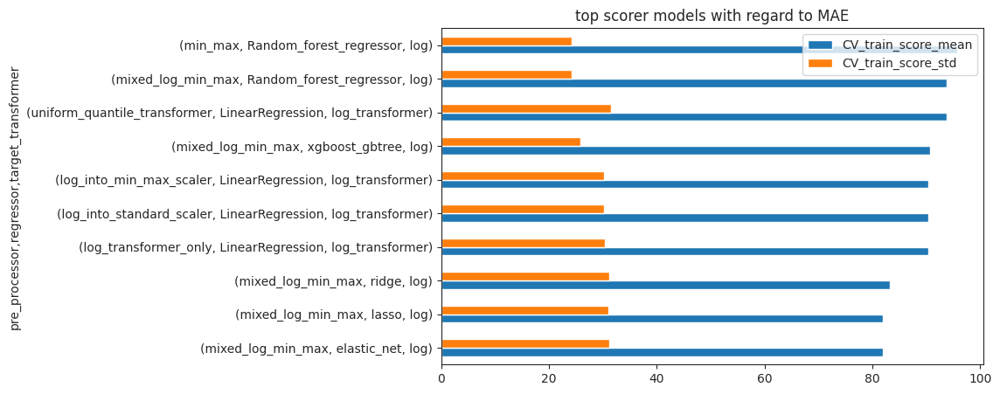

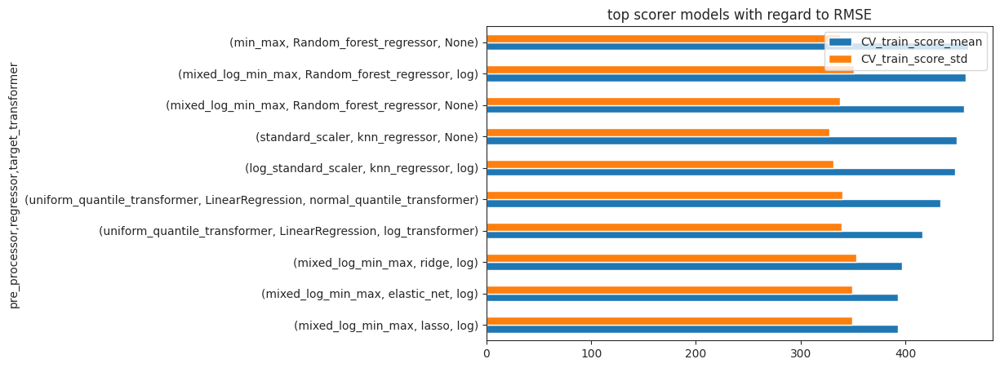

In [48]:
# Reverse R2
R2 = R2.sort_values('CV_train_score_mean', ascending=False)

# Print and plot top scorer models according each metric.
for metric in ["R2", "MAE", "RMSE"]:
    print(f"\n {metric} \n")
    display(eval(metric).head(10))
    (
        eval(metric)
        .head(10)
        .loc[:, ['CV_train_score_mean', 'CV_train_score_std']]
        .plot(
            kind='barh', figsize=(8,5),
            title=f"top scorer models with regard to {metric}")
    )


Pre-processing and transforming the target thanks to the log transformation has a powerful impact. It really helped to improve scores regardless of the model type.

Let's select some top models and plot their predictions to understand better those scores.

In [49]:
# Some top scorers with regard to the MAE
chosen_models = MAE.iloc[[0, 3, 6, 8], :]
chosen_models

metric  \
pre_processor        regressor               target_transformer          
mixed_log_min_max    elastic_net             log                   MAE   
log_transformer_only LinearRegression        log_transformer       MAE   
mixed_log_min_max    xgboost_gbtree          log                   MAE   
                     Random_forest_regressor log                   MAE   

                                                                 CV_train_score_mean  \
pre_processor        regressor               target_transformer                        
mixed_log_min_max    elastic_net             log                              81.924   
log_transformer_only LinearRegression        log_transformer                  90.327   
mixed_log_min_max    xgboost_gbtree          log                              90.720   
                     Random_forest_regressor log                              93.807   

                                                                 CV_train_score_std  \
pre_processor        regressor               target_transformer                       
mixed_log_min_max    elastic_net             log                             31.132   
log_transformer_only LinearRegression        log_transformer                 30.354   
mixed_log_min_max    xgboost_gbtree          log                             25.905   
                     Random_forest_regressor log                             24.258   

                                                                 test_score  \
pre_processor        regressor               target_transformer               
mixed_log_min_max    elastic_net             log                  109.76719   
log_transformer_only LinearRegression        log_transformer       91.38361   
mixed_log_min_max    xgboost_gbtree          log                  136.37782   
                     Random_forest_regressor log                  832.24987   

                                                                 computation_time  \
pre_processor        regressor               target_transformer                     
mixed_log_min_max    elastic_net             log                              NaN   
log_transformer_only LinearRegression        log_transformer                  NaN   
mixed_log_min_max    xgboost_gbtree          log                              NaN   
                     Random_forest_regressor log                              NaN   

                                                                                                                                                                                                                                                                        hyperparameters  \
pre_processor        regressor               target_transformer                                                                                                                                                                                                                           
mixed_log_min_max    elastic_net             log                                                                                                                                         {'regressor__elastic_net__alpha': 0.001673469387755102, 'regressor__elastic_net__l1_ratio': 1}   
log_transformer_only LinearRegression        log_transformer                                                                                                                                                                                                                        NaN   
mixed_log_min_max    xgboost_gbtree          log                                                                                             {'learning_rate': 0.1, 'n_estimators': 67, 'max_depth': 5, 'min_child_weight': 1, 'gamma': None, 'colsample_bytree': 0.7, 'reg_lambda': 1}   
                     Random_forest_regressor log                 {'regressor__regressor__max_depth': 11, 'regressor__regressor__max_features': 10, 'regressor__regress

Watching the scores' means obtained with the cross validation and the models' variances, We can say that once again, the pre-processing and the target transformation is the major element that helped improve the predictions.

Linear models generally performed better. With regularization, it is even better. Lasso had a better effect than ridge here, so the elastic net tends to the lasso configuration.

Nevertheless, the based-trees models performed decently (as good as a classical linear regression) with a lower variance. This could lead to better generalization.

### 9.1.2.  [&#9650;](#toc0_) <a id='toc9_1_2_'></a>Plotting predictions vs actual values

In [50]:
# linking models and their joblib file
model_chains = chosen_models.index

filenames = dict()

for k in model_chains:
    filename = 'RMSE_' + "_".join(k) + ".joblib"
    filenames[f"{k[1]}"] = filename
    
filenames

{'elastic_net': 'RMSE_mixed_log_min_max_elastic_net_log.joblib',
 'LinearRegression': 'RMSE_log_transformer_only_LinearRegression_log_transformer.joblib',
 'xgboost_gbtree': 'RMSE_mixed_log_min_max_xgboost_gbtree_log.joblib',
 'Random_forest_regressor': 'RMSE_mixed_log_min_max_Random_forest_regressor_log.joblib'}

In [51]:
filenames['LinearRegression'] = filenames['LinearRegression'].strip("RMSE_")
filenames

{'elastic_net': 'RMSE_mixed_log_min_max_elastic_net_log.joblib',
 'LinearRegression': 'log_transformer_only_LinearRegression_log_transformer.joblib',
 'xgboost_gbtree': 'RMSE_mixed_log_min_max_xgboost_gbtree_log.joblib',
 'Random_forest_regressor': 'RMSE_mixed_log_min_max_Random_forest_regressor_log.joblib'}

In [52]:
# Associating relative paths to models 
filepaths = dict()
for model in filenames:
    filepaths[model] = glob("./GHG*/*/" + filenames[model])[0]
filepaths

{'elastic_net': './GHG_predictions_models_and_results/regularized_models/RMSE_mixed_log_min_max_elastic_net_log.joblib',
 'LinearRegression': './GHG_predictions_models_and_results/linear_regression_models_full_input/log_transformer_only_LinearRegression_log_transformer.joblib',
 'xgboost_gbtree': './GHG_predictions_models_and_results/xgboost_models/RMSE_mixed_log_min_max_xgboost_gbtree_log.joblib',
 'Random_forest_regressor': './GHG_predictions_models_and_results/random_forest_models/RMSE_mixed_log_min_max_Random_forest_regressor_log.joblib'}

In [53]:
for model in filenames:
    exec(
        model
        + "=load('"
        + filepaths[model]
        + "')"
    )

In [54]:
for model in filenames.keys():
    display(eval(model))

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('elastic_net',
                                                      ElasticNet(alpha=0.001653061224489796,
                                                                 l1_ratio=1,
                                                                 max_iter=100000,
                                                                 random_state=0))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_transformer_only',
                                                                                       FunctionTransformer(feature_names_out='one-to-one',
                                                                                                           func=<ufunc 'log1p'>,
                                                                                                           inverse_func=<ufunc 'expm1'>),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'NumberofFloors',
                                                                                        'Age']),
                                                                                      ('passthrough',
                                                                                       'passthrough',
                                                                                       ['PrimaryPropertyType_Ho...
                                                                                        'PrimaryPropertyType_SupermarketGroceryStore',
                                                                                        'PrimaryPropertyType_University',
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('regressor',
                                                      LinearRegression())]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                   max_cat_threshold=None,
                                                                   max_cat_to_onehot=None,
                                                                   max_delta_step=None,
                                                                   max_depth=6,
                                                                   max_leaves=None,
                                                                   min_child_weight=1,
                                                                   missing=nan,
                                                                   monotone_constraints=None,
                                                                   n_estimators=67,
                                                                   n_jobs=None,
                                                                   num_parallel_tree=None,
                                                                   predictor=None,
                                                                   random_state=None, ...))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('regressor',
                                                      RandomForestRegressor(max_depth=11,
                                                                            max_features=10,
                                                                            min_samples_split=1,
                                                                            n_estimators=16,
                                                                            n_jobs=-1,
                                                                            random_state=411))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

In [132]:
y_test.shape

(371,)

In [133]:
sample_size = 371
y_test_sampled = y_test.sample(sample_size)
X_test_sampled = X_test.loc[y_test_sampled.index]

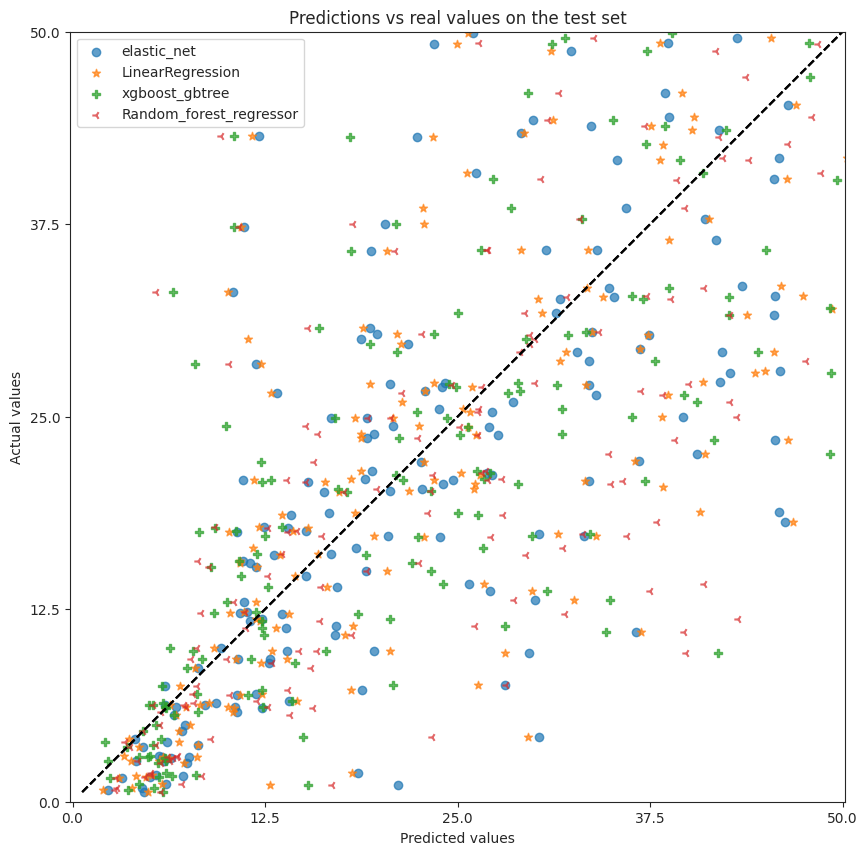

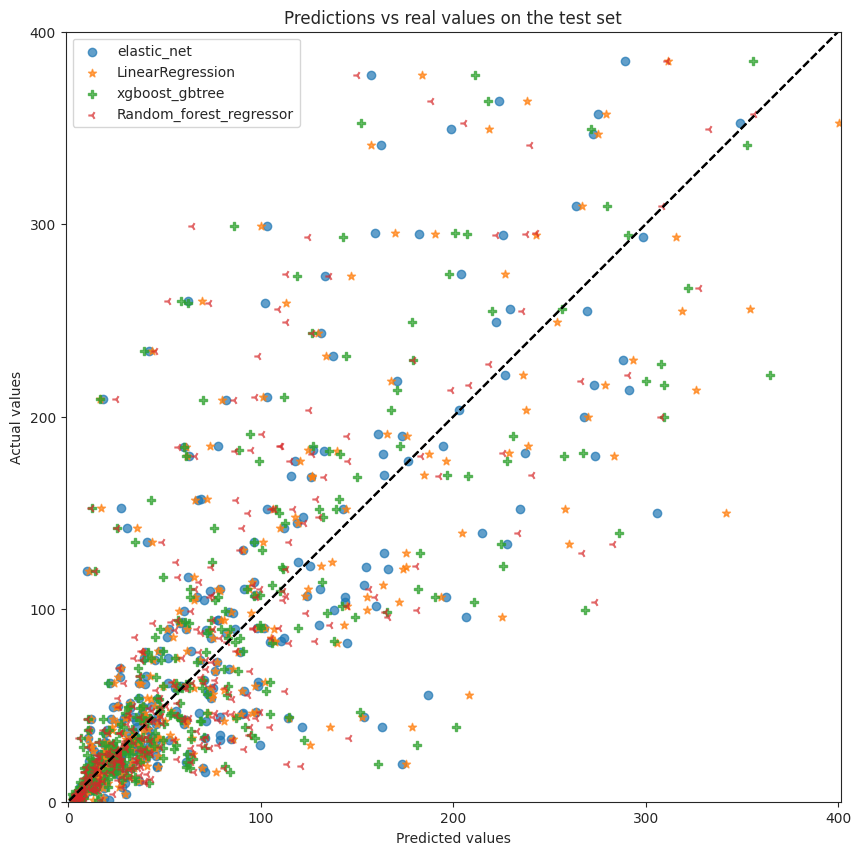

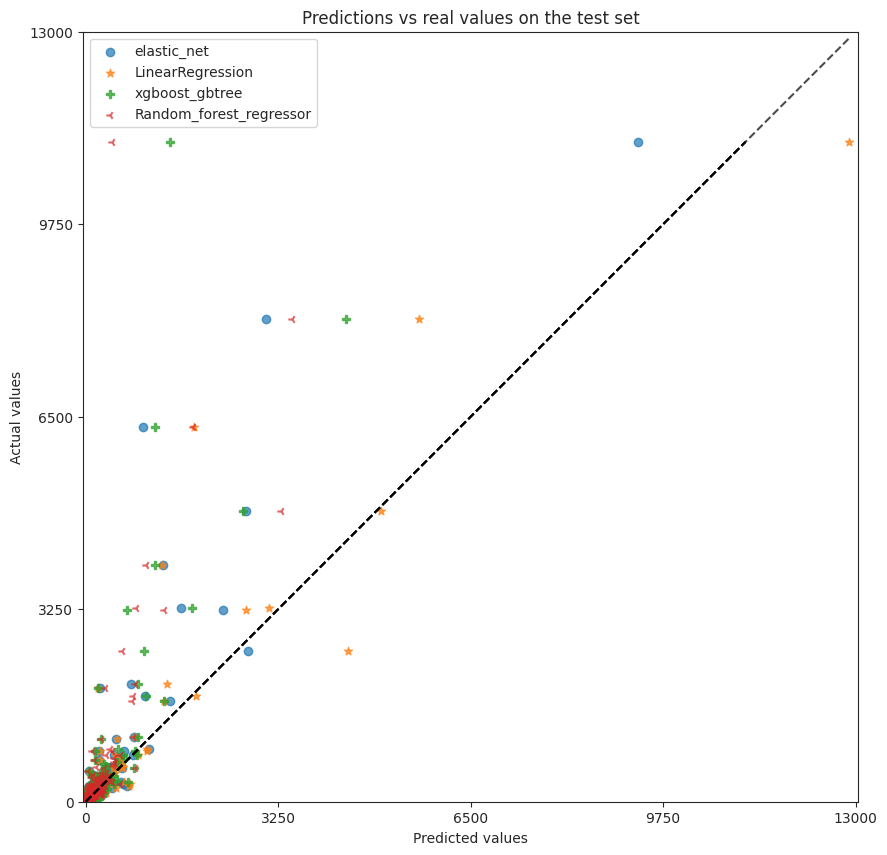

In [148]:
palette = sns.color_palette()
markers = ['o', '*', 'P', '3']

zooms = [
    [-5, 50, -5, 50],
    [-5, 400, -5, 400],
    [-500, 13000, -500, 13000],
]

for zoom in zooms:
    _, ax = plt.subplots(figsize=(10, 10))
    for n, model_name in enumerate(filenames.keys()):
        # displaying predictions vs real values
        model = eval(model_name)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test_sampled)
        _ = PredictionErrorDisplay.from_predictions(
            y_test_sampled, y_pred, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={
                "alpha": 0.7, 'color': palette[n], 'label': model_name,
                "marker": markers[n]
            }
        )
    ax.axis(zoom)
    ax.set_title("Predictions vs real values on the test set")
    ax.set_xlim(0, zoom[1])
    ax.set_xticks(np.linspace(0, zoom[1], 5))
    ax.set_ylim(0, zoom[3])
    ax.set_yticks(np.linspace(0, zoom[3], 5))
    ax.legend()
    plt.show()
    

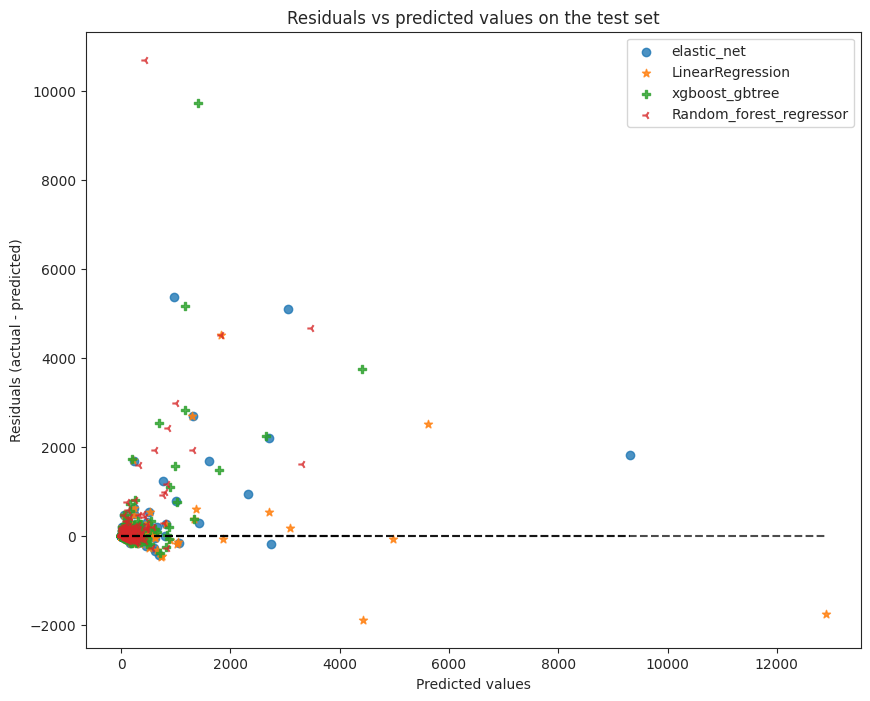

In [137]:
fig, ax = plt.subplots(figsize=(10,8))

for n, model_name in enumerate(filenames.keys()):
    # displaying predictions vs real values
    model = eval(model_name)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    _ = PredictionErrorDisplay.from_predictions(
        y_test, y_pred, kind="residual_vs_predicted",
        ax=ax, scatter_kwargs={
            "alpha": 0.8, 'color': palette[n], 'label': model_name,
            "marker": markers[n]
        }
    )
    ax.set_title("Residuals vs predicted values on the test set")
plt.legend()
plt.show()

No obvious pattern detected here. May be that once again, linear models behaves better for extreme values extrapolating better.

# 10.  [&#9650;](#toc0_) <a id='toc10_'></a>Adding ENERGYSTAR-Score to best models inputs

As linear regression models are quite similar, I will only evaluate the relevance of adding the ENERGY START Score on the elasticNET, And then I'm going to see if it makes a difference for the XGB Regressor.

## 10.1.  [&#9650;](#toc0_) <a id='toc10_1_'></a>Observing the ENERGSTAR-score

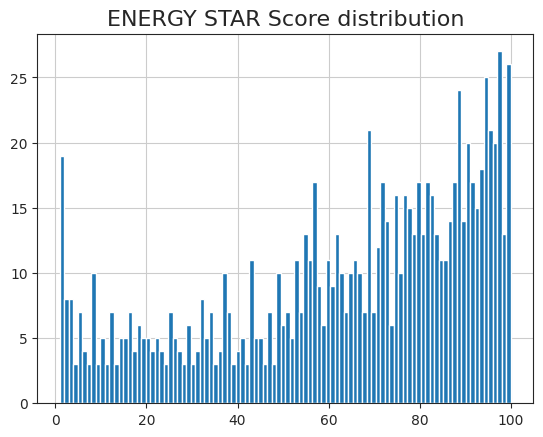

skewness: -0.6830835290738249


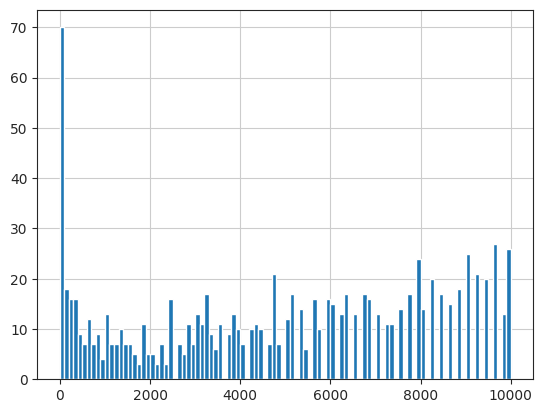

skewness: -0.05077023556617074


In [3]:
data.ENERGYSTARScore.hist(bins=100)
plt.title("ENERGY STAR Score distribution", size=16)
plt.show()
print(f"skewness: {data.ENERGYSTARScore.skew()}")

# Trying to reduce the skewness by squaring the feature.
square_transformer = FunctionTransformer(
    func=np.square, check_inverse=True
)

data["ENERGYSTARScore_squared"] = square_transformer.transform(data.ENERGYSTARScore)

data.ENERGYSTARScore_squared.hist(bins=100)
plt.show()
print(f"skewness: {data.ENERGYSTARScore_squared.skew()}")


In [277]:
data.ENERGYSTARScore.notnull().mean()

0.6518218623481782

## 10.2.  [&#9650;](#toc0_) <a id='toc10_2_'></a>Preparing the data for modelling

In [278]:
# Select properties with a score
new_data = data.loc[data.ENERGYSTARScore.notnull(), :]
display(new_data.shape)

# target and inputs
y = new_data.loc[:, pt.GHG_TARGET]
X = new_data.drop(pt.GHG_TARGET, axis=1)

display(y.head())
display(X.head())


(966, 82)

OSEBuildingID
1     249.98
2     295.86
3    2089.28
5     286.43
8     505.01
Name: TotalGHGEmissions, dtype: float64

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),ComplianceStatus,Outlier,GHGEmissionsIntensity,Age,ProportionPrincipalUseType,ProportionSecondaryUseType,ProportionThirdUseType,RiseType,AgeType,energies_sum,energy_ratio,SteamUseProportion,ElectricityProportion,NaturalGasProportion,PrimaryPropertyType_Hospital,PrimaryPropertyType_Hotel,PrimaryPropertyType_K12School,PrimaryPropertyType_Laboratory,PrimaryPropertyType_LargeOffice,PrimaryPropertyType_MedicalOffice,PrimaryPropertyType_MixedUseProperty,PrimaryPropertyType_Other,PrimaryPropertyType_RefrigeratedWarehouse,PrimaryPropertyType_ResidenceHall,PrimaryPropertyType_Restaurant,PrimaryPropertyType_RetailStore,PrimaryPropertyType_SelfStorageFacility,PrimaryPropertyType_SeniorCareCommunity,PrimaryPropertyType_SmallandMidSizedOffice,PrimaryPropertyType_SupermarketGroceryStore,PrimaryPropertyType_University,PrimaryPropertyType_Warehouse,PrimaryPropertyType_WorshipFacility,CouncilDistrictCode_2,CouncilDistrictCode_3,CouncilDistrictCode_4,CouncilDistrictCode_5,CouncilDistrictCode_6,CouncilDistrictCode_7,Electricity(MWh),GHGEmission_electricity_tons_CO2_eq,GHGEmission_gas_tons_CO2_eq,GHGEmission_steam_tons_CO2_eq,TotalGHGEmission_tons_CO2eq_theory,ENERGYSTARScore_squared
OSEBuildingID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,7,DOWNTOWN,47.61220,-122.33799,1927,1,12,88434,0,88434,Hotel,Hotel,88434.0,NaN,NaN,NaN,NaN,NaN,60.0,81.699997,84.300003,182.500000,189.000000,7226362.5,7456910.0,2003882.00,3946027.0,1276453.0,Compliant,NaN,2.83,96,1.000000,NaN,NaN,Medium,Very_old,7226362.00,1.0,0.28,0.55,0.18,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1156.514361,27.509757,67.792419,154.677872,249.980048,3600.0
2,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,7,DOWNTOWN,47.61317,-122.33393,1996,1,11,103566,15064,88502,"Hotel, Parking, Restaurant",Hotel,83880.0,Parking,15064.0,Restaurant,4622.0,NaN,61.0,94.800003,97.900002,176.100006,179.399994,8387933.0,8664479.0,0.00,3242851.0,5145082.0,Compliant,NaN,2.86,27,0.809918,0.145453,0.044629,Medium,Modern,8387933.00,1.0,0.00,0.39,0.61,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,950.425264,22.607560,273.255305,0.000000,295.862865,3721.0
3,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,7,DOWNTOWN,47.61393,-122.33810,1969,1,41,956110,196718,759392,Hotel,Hotel,756493.0,NaN,NaN,NaN,NaN,NaN,43.0,96.000000,97.699997,241.899994,244.100006,72587024.0,73937112.0,21566554.00,49526664.0,1493800.0,Compliant,NaN,2.19,54,0.791220,NaN,NaN,High,Old,72587018.00,1.0,0.30,0.68,0.02,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,14515.434936,345.275515,79.335718,1664.703152,2089.314386,1849.0
5,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,7,DOWNTOWN,47.61412,-122.33664,1926,1,10,61320,0,61320,Hotel,Hotel,61320.0,NaN,NaN,NaN,NaN,NaN,56.0,110.800003,113.300003,216.199997,224.000000,6794584.0,6946800.5,2214446.25,2768924.0,1811213.0,Compliant,NaN,4.67,97,1.000000,NaN,NaN,Medium,Very_old,6794583.25,1.0,0.33,0.41,0.27,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [279]:
test_size = 0.2
seed = 2

X_train, X_test, y_train, y_test = train_test_split(
    X, y, shuffle=True, test_size=test_size, random_state=seed
)


## 10.3.  [&#9650;](#toc0_) <a id='toc10_3_'></a>Preparing the pre-processors

As the training and test sets have changed, I will have to retrain best models without the Energy Star Score to get baselines, and then add it to evaluate its usefulness.

So 3 pre-processors are to be defined (pp, pp_w (Energy Star Score), pp_w_sq (Energy Star Score squared)).

In [280]:
# features with a skewed distribution
fts_to_transform = [
    'PropertyGFABuilding(s)',
    'NumberofBuildings',
    'NumberofFloors'
]
fts_to_scale_only = [
    'Age',
]
# Already pre_processed
fts_passthrough = [
    'PrimaryPropertyType_Hospital',
    'PrimaryPropertyType_Hotel',
    'PrimaryPropertyType_K12School',
    'PrimaryPropertyType_Laboratory',
    'PrimaryPropertyType_LargeOffice',
    'PrimaryPropertyType_MedicalOffice',
    'PrimaryPropertyType_MixedUseProperty',
    'PrimaryPropertyType_Other',
    'PrimaryPropertyType_RefrigeratedWarehouse',
    'PrimaryPropertyType_ResidenceHall',
    'PrimaryPropertyType_Restaurant',
    'PrimaryPropertyType_RetailStore',
    'PrimaryPropertyType_SelfStorageFacility',
    'PrimaryPropertyType_SeniorCareCommunity',
    'PrimaryPropertyType_SmallandMidSizedOffice',
    'PrimaryPropertyType_SupermarketGroceryStore',
    'PrimaryPropertyType_University',
    'PrimaryPropertyType_Warehouse',
    'PrimaryPropertyType_WorshipFacility',
    'SteamUseProportion',
    'ElectricityProportion',
    'NaturalGasProportion',
]

pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

pp = pre_processors[3]

#######
fts_to_scale_only = [
    'Age',
    'ENERGYSTARScore',
]

pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

pp_w = pre_processors[3]

#######
fts_to_scale_only = [
    'Age',
    'ENERGYSTARScore_squared',
]

pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

pp_w_sq = pre_processors[3]


display(pp, pp_w, pp_w_sq)

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(), ['Age']),
                                ('passthroug...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(),
                                 ['Age', 'ENERGYSTARSco...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors']),
                                ('min_max_scaler', MinMaxScaler(),
                                 ['Age', 'ENERGYSTARSco...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])

In [281]:
pre_processors = dict()
pre_processors['without_ENERGYSTARScore'] = pp
pre_processors['with_ENERGYSTARScore'] = pp_w
pre_processors['with_ENERGYSTARScore_squared'] = pp_w_sq

In [282]:
for pp in pre_processors:
    print(pp)

without_ENERGYSTARScore
with_ENERGYSTARScore
with_ENERGYSTARScore_squared


## 10.4.  [&#9650;](#toc0_) <a id='toc10_4_'></a>ElasticNET


 without_ENERGYSTARScore 
--------------------
--------------------
metric : R2
--------------------
Best parameter (CV score=0.660):
{'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 0.01}


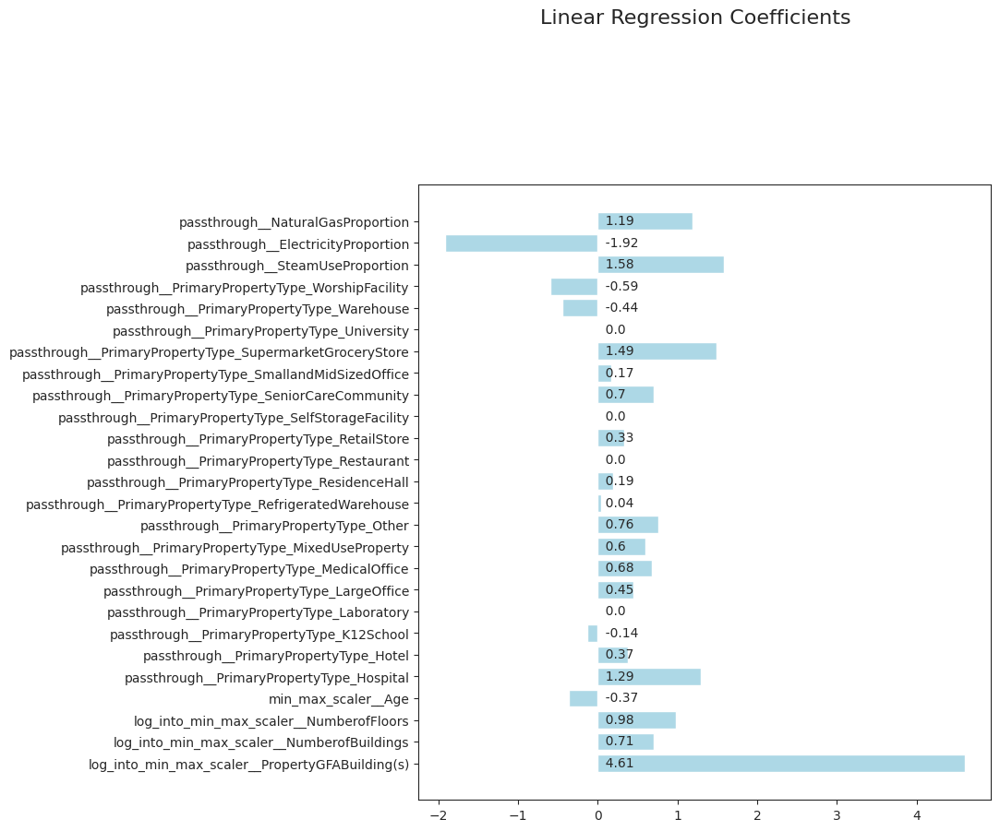

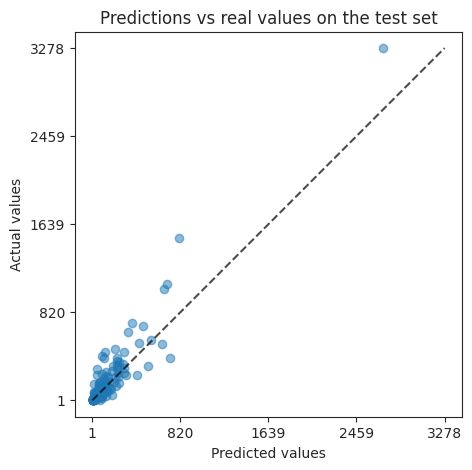

Cross-validation evaluation : 
    scores on folds:  [0.886 0.373 0.898 0.614 0.14 ]
    mean score:  0.582
    std score deviation:  0.294

Train score : 0.57276

Test score : 0.86137
--------------------
metric : MAE
--------------------
Best parameter (CV score=-93.861):
{'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 1e-05}


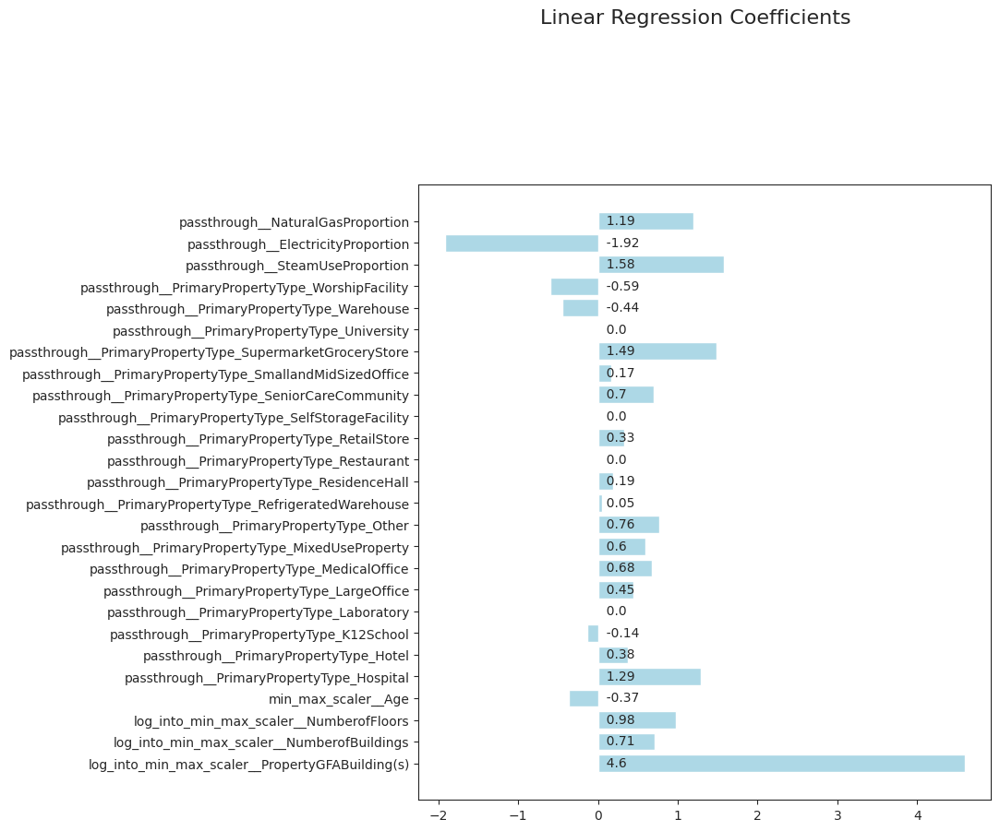

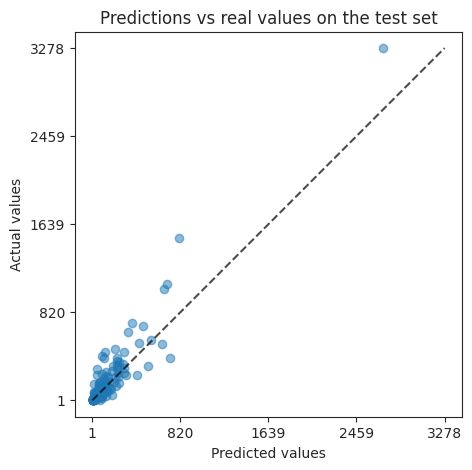

Cross-validation evaluation : 
    scores on folds:  [ 95.42   95.903  59.856  54.871 156.928]
    mean score:  92.596
    std score deviation:  36.476

Train score : 88.90313

Test score : 53.1984
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-506.212):
{'regressor__elastic_net__alpha': 0.003593813663804626, 'regressor__elastic_net__l1_ratio': 0.01}


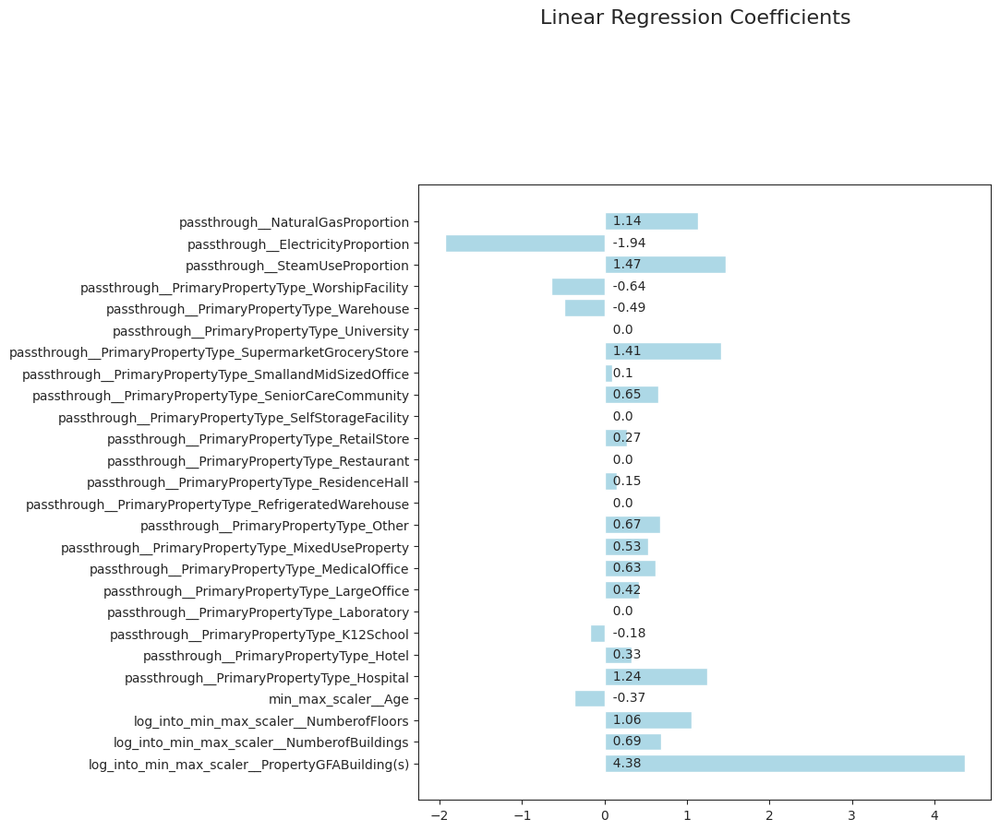

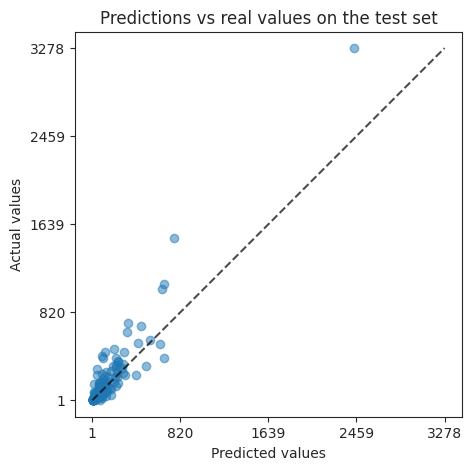

Cross-validation evaluation : 
    scores on folds:  [ 312.319  483.214  297.221  201.644 1284.401]
    mean score:  515.76
    std score deviation:  394.888

Train score : 648.19323

Test score : 122.32574

 with_ENERGYSTARScore 
--------------------
--------------------
metric : R2
--------------------
Best parameter (CV score=0.754):
{'regressor__elastic_net__alpha': 0.0021544346900318843, 'regressor__elastic_net__l1_ratio': 0.01}


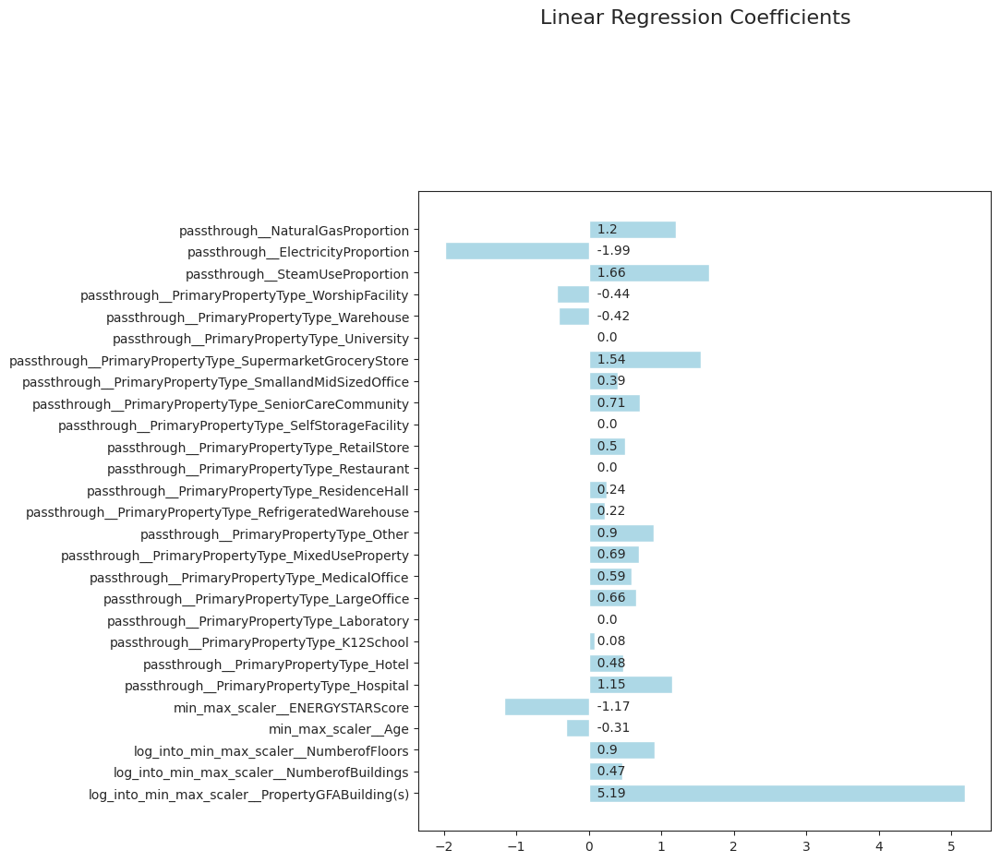

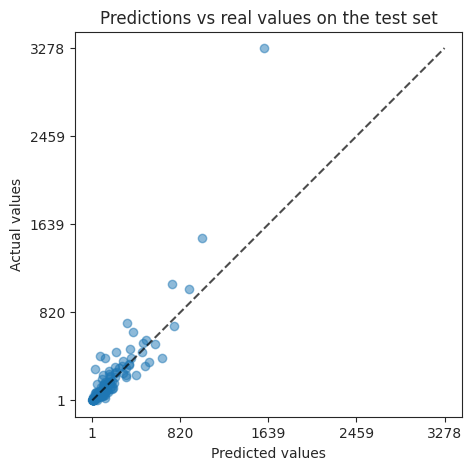

Cross-validation evaluation : 
    scores on folds:  [0.966 0.352 0.987 0.564 0.312]
    mean score:  0.636
    std score deviation:  0.291

Train score : 0.66912

Test score : 0.76295
--------------------
metric : MAE
--------------------
Best parameter (CV score=-76.028):
{'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 0.01}


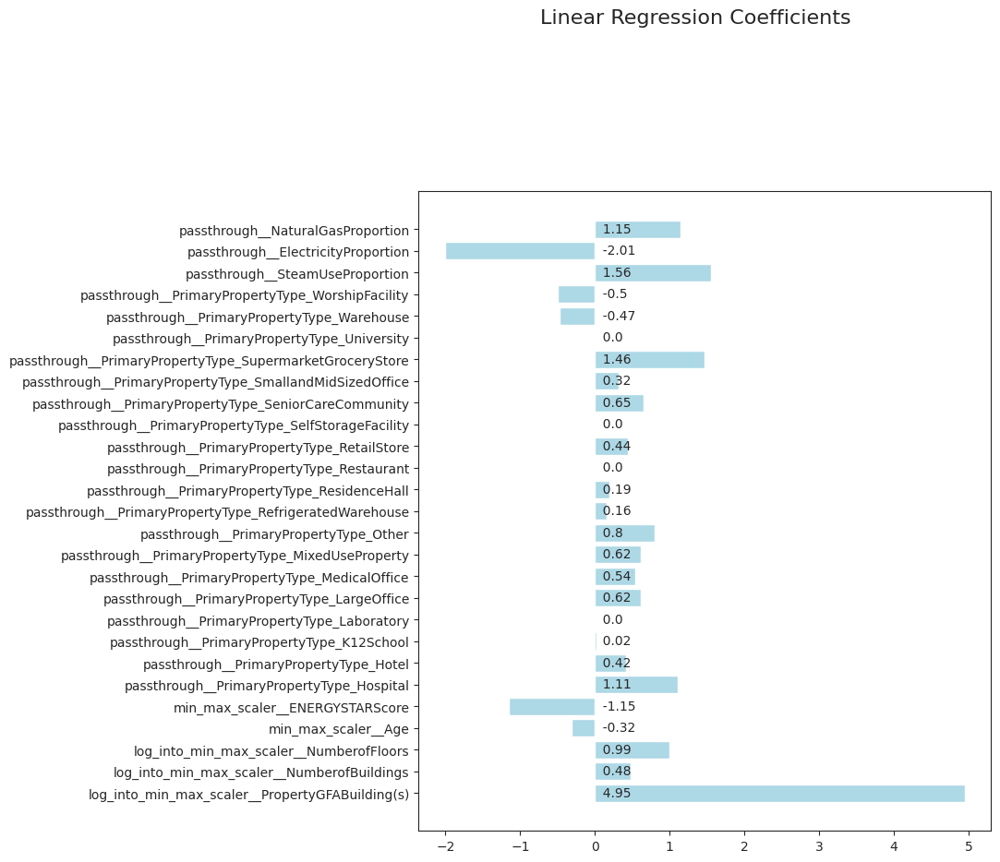

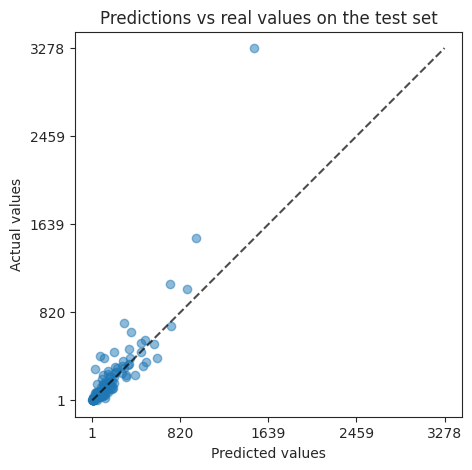

Cross-validation evaluation : 
    scores on folds:  [ 56.785  86.971  30.956  52.199 141.481]
    mean score:  73.678
    std score deviation:  38.33

Train score : 72.87983

Test score : 47.85585
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-427.833):
{'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 0.01}


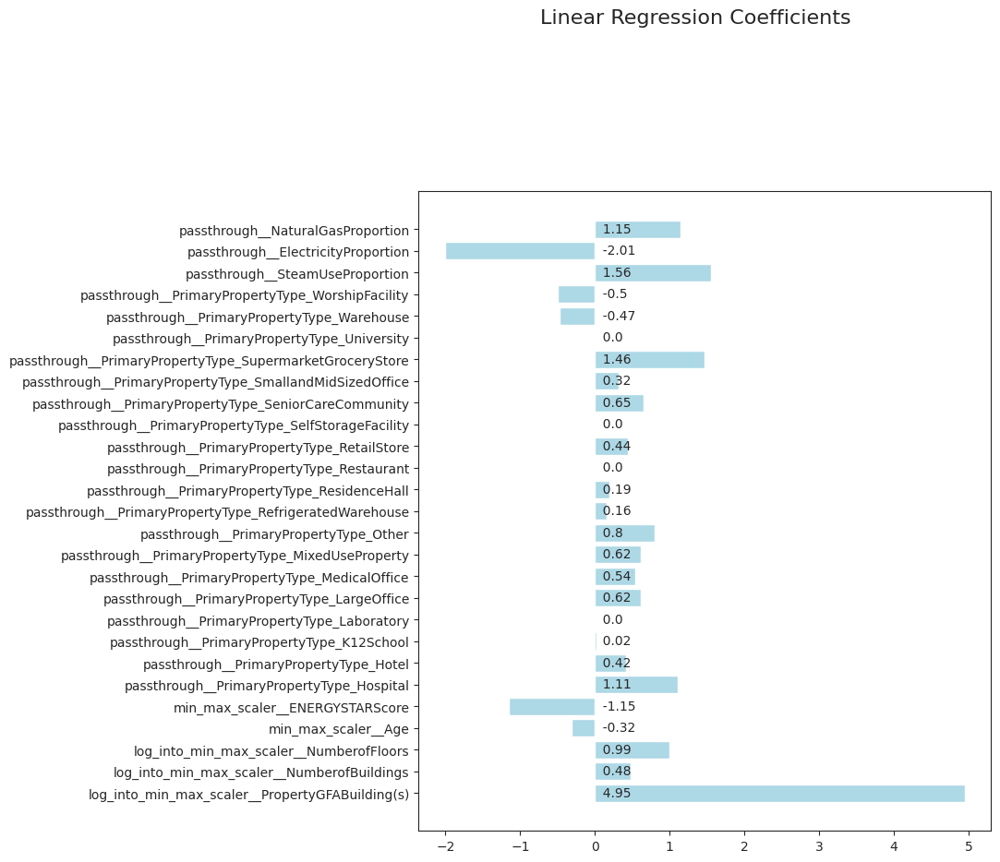

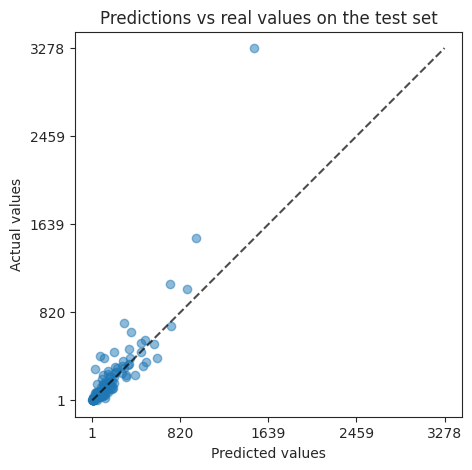

Cross-validation evaluation : 
    scores on folds:  [ 191.734  488.039   56.6    202.616 1164.755]
    mean score:  420.749
    std score deviation:  397.67

Train score : 571.85044

Test score : 152.90439

 with_ENERGYSTARScore_squared 
--------------------
--------------------
metric : R2
--------------------
Best parameter (CV score=0.741):
{'regressor__elastic_net__alpha': 0.0021544346900318843, 'regressor__elastic_net__l1_ratio': 0.01}


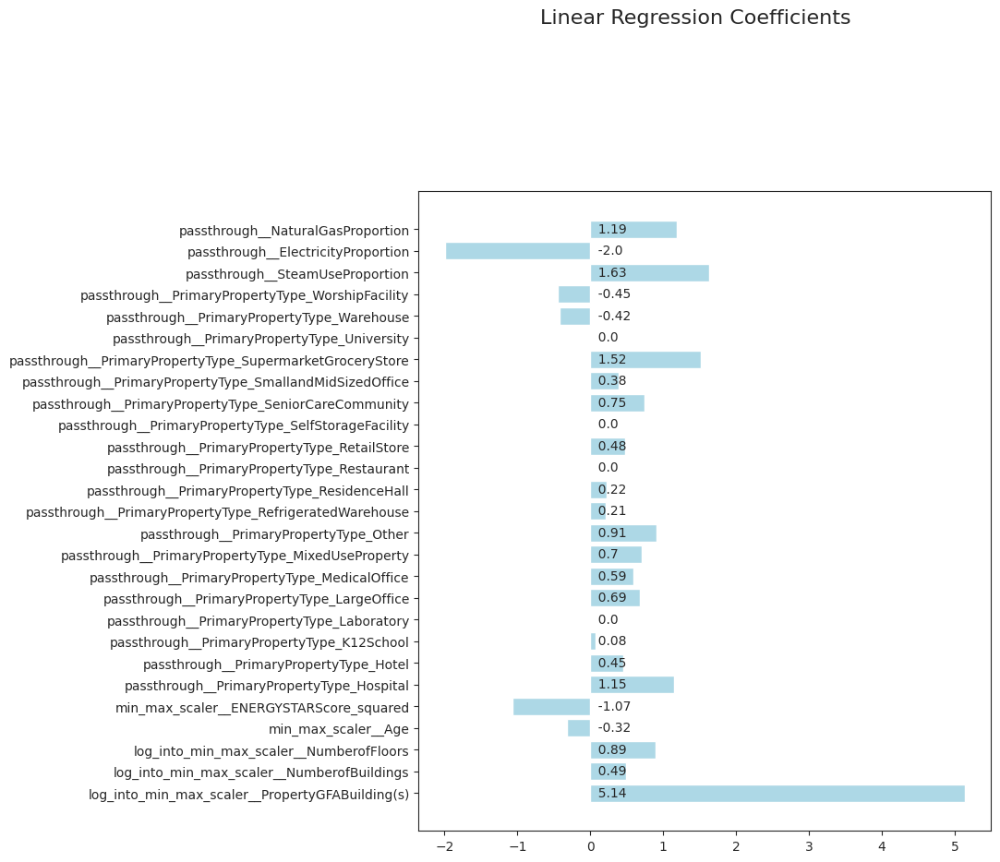

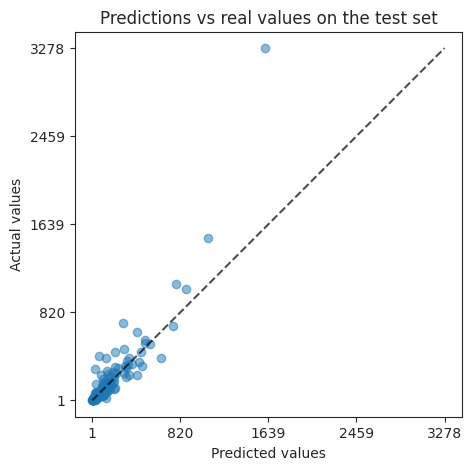

Cross-validation evaluation : 
    scores on folds:  [0.92  0.362 0.984 0.626 0.275]
    mean score:  0.634
    std score deviation:  0.285

Train score : 0.65183

Test score : 0.76754
--------------------
metric : MAE
--------------------
Best parameter (CV score=-78.480):
{'regressor__elastic_net__alpha': 0.0016681005372000592, 'regressor__elastic_net__l1_ratio': 0.01}


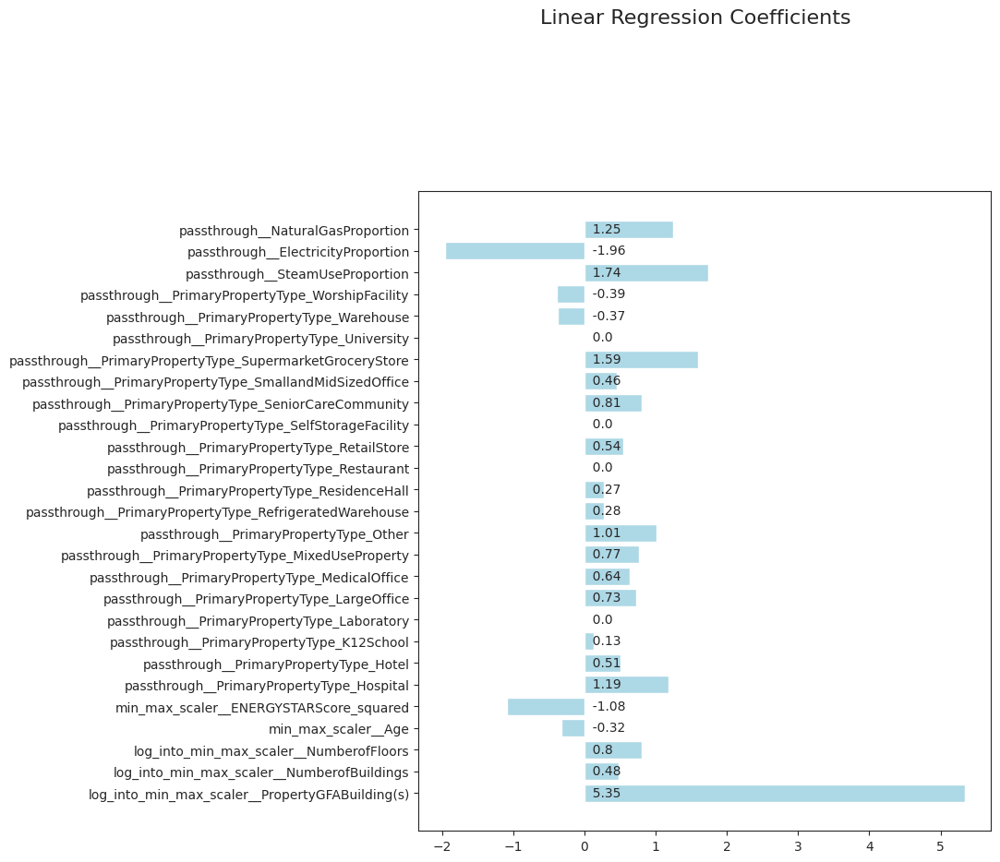

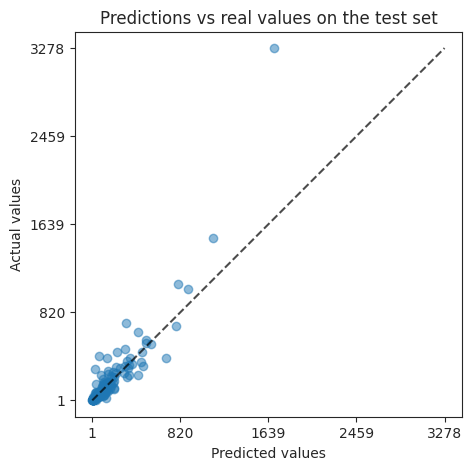

Cross-validation evaluation : 
    scores on folds:  [ 80.488  82.39   36.556  47.574 133.332]
    mean score:  76.068
    std score deviation:  33.799

Train score : 70.58381

Test score : 45.85465
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-448.930):
{'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 1e-05}


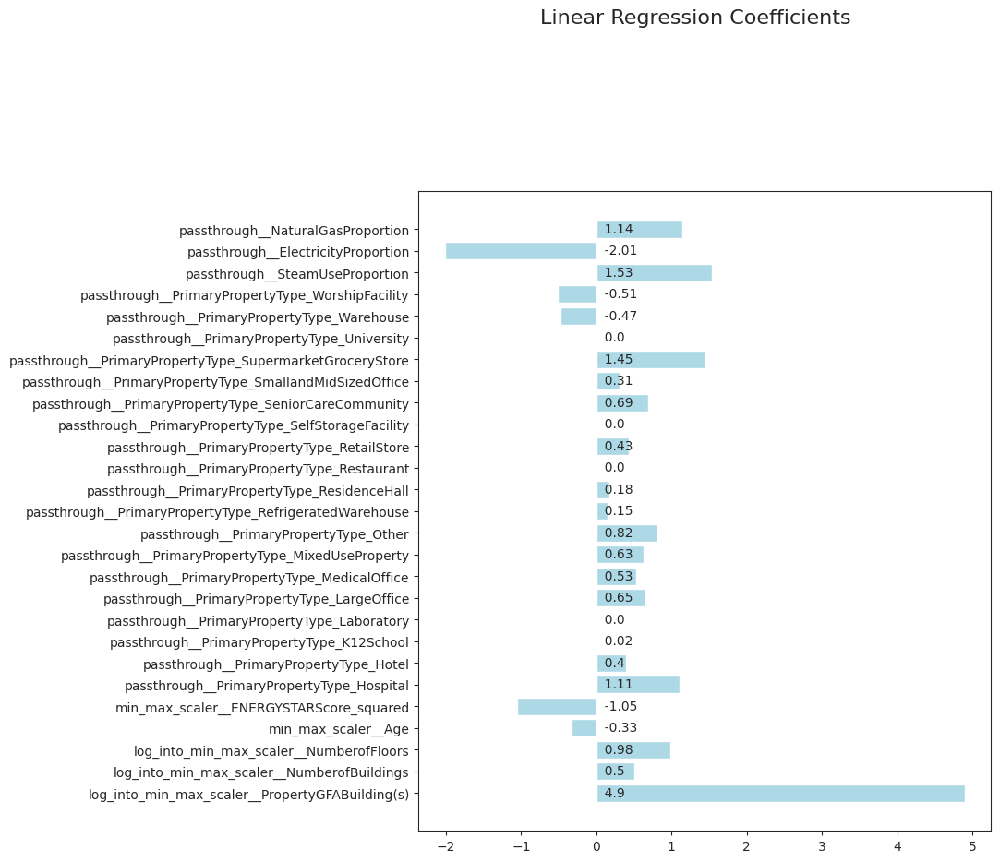

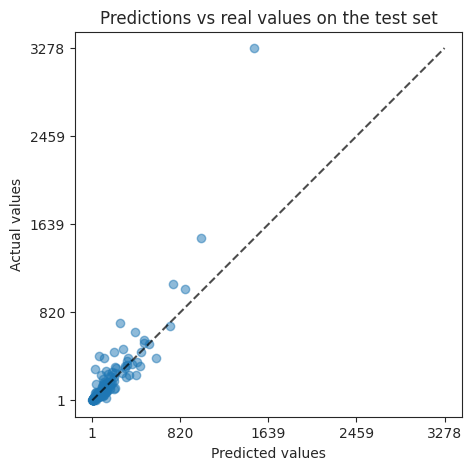

Cross-validation evaluation : 
    scores on folds:  [ 255.59   484.557  106.033  190.414 1191.393]
    mean score:  445.598
    std score deviation:  393.511

Train score : 582.50245

Test score : 151.91771


In [283]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False
save_model = False

regressor_name = "elastic_net"
results = []

for pp in pre_processors:
    print(f"\n {pp} \n" + '-'*20)
    # Create the model
    first_step_model = Pipeline(
        [
            ("pre_processor", pre_processors[pp]),
            ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
        ]
    )

    # Add target transformation
    model = TransformedTargetRegressor(
        regressor=first_step_model,
        transformer=log_transformer
    )

    # Define the metric for the grid search and the evaluation.
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)
            
        #Gridsearch   
        param_name_alpha = "regressor__" + regressor_name + "__alpha"
        param_name_l1_ratio = "regressor__" + regressor_name + "__l1_ratio"
        param_grid = [
            {
                param_name_alpha: np.logspace(-3, -2, 10),
                param_name_l1_ratio: np.logspace(-5, -2, 3)
            }
        ]
        n_folds = 5

        search = GridSearchCV(
            model, param_grid=param_grid,
            scoring=metric.scoring_alias, cv=n_folds
        )
        search.fit(X_train, y_train)
        print("Best parameter (CV score=%0.3f):" % search.best_score_)
        print(search.best_params_)

        hyperparameters = search.best_params_
        # Extract and fit the best model
        model = search.best_estimator_
        start = timer()
        model.fit(X_train, y_train)
        end = timer()
        computation_time = end - start
        
        # Predict
        pred_train = model.predict(X_train)
        pred_test = model.predict(X_test)

        if show_plot:
            # Observing the coefficients of the regression model
            ds.linearRegressionSummary(
                model.regressor_[regressor_name], 
                model.regressor_[:-1].get_feature_names_out()
            )

            # displaying predictions vs real values
            _, ax = plt.subplots(figsize=(5, 5))
            _ = PredictionErrorDisplay.from_predictions(
                y_test, pred_test, kind="actual_vs_predicted",
                ax=ax, scatter_kwargs={"alpha": 0.5}
            )
            ax.set_title("Predictions vs real values on the test set")
            plt.show()

        if show_regressor_input:
            # displaying the inputs after the preprocessing stage
            pre_processed_inputs = pd.DataFrame(
                model.regressor_[:-1].transform(X_train), 
                index=X_train.index,
                columns=model.regressor_[:-1].get_feature_names_out()
            )
            display(pre_processed_inputs)   

        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0,
                silent=silent
            )    

        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")

        # add to results
        results.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                "elastic_net",
                "mixed_log_min_max",
                pp,
                metric.name,
                'log',
                model          
            ]
        )



In [284]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"input_type",
"metric",
"target_transformer",
"model"
]

df_results = pd.DataFrame(
results, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results.sort_values(['metric', 'CV_train_score_mean'])

CV_train_score_mean  \
metric pre_processor     regressor   target_transformer                        
MAE    mixed_log_min_max elastic_net log                              73.678   
                                     log                              76.068   
                                     log                              92.596   
R2     mixed_log_min_max elastic_net log                               0.582   
                                     log                               0.634   
                                     log                               0.636   
RMSE   mixed_log_min_max elastic_net log                             420.749   
                                     log                             445.598   
                                     log                             515.760   

                                                         CV_train_score_std  \
metric pre_processor     regressor   target_transformer                       
MAE    mixed_log_min_max elastic_net log                             38.330   
                                     log                             33.799   
                                     log                             36.476   
R2     mixed_log_min_max elastic_net log                              0.294   
                                     log                              0.285   
                                     log                              0.291   
RMSE   mixed_log_min_max elastic_net log                            397.670   
                                     log                            393.511   
                                     log                            394.888   

                                                         test_score  \
metric pre_processor     regressor   target_transformer               
MAE    mixed_log_min_max elastic_net log                   47.85585   
                                     log                   45.85465   
                                     log                   53.19840   
R2     mixed_log_min_max elastic_net log                    0.86137   
                                     log                    0.76754   
                                     log                    0.76295   
RMSE   mixed_log_min_max elastic_net log                  152.90439   
                                     log                  151.91771   
                                     log                  122.32574   

                                                         computation_time  \
metric pre_processor     regressor   target_transformer                     
MAE    mixed_log_min_max elastic_net log                         0.035653   
                                     log                         0.026366   
                                     log                         0.017522   
R2     mixed_log_min_max elastic_net log                         0.015412   
                                     log                         0.026650   
                                     log                         0.056919   
RMSE   mixed_log_min_max elastic_net log                         0.022627   
                                     log                         0.026808   
                                     log                         0.026515   

                                                                                                                                             hyperparameters  \
metric pre_processor     regressor   target_transformer                                                                                                        
MAE    mixed_log_min_max elastic_net log                  {'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 0.01}   
                                     log                  {'regressor__elastic_net__alpha': 0.0016681005372000592, 'regressor__elastic_net__l1_ratio': 0.01}   
                                    

## 10.5.  [&#9650;](#toc0_) <a id='toc10_5_'></a>Xgboost regressor

In [285]:
# Get the Xgboost regressor correct settings.
reg = xgboost_gbtree.regressor[-1]
reg

XGBRegressor(base_score=None, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.7, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             n_estimators=67, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)


 without_ENERGYSTARScore 

Cross-validation evaluation : 
    scores on folds:  [0.078 0.898 0.731 0.923 0.652]
    mean score:  0.656
    std score deviation:  0.306


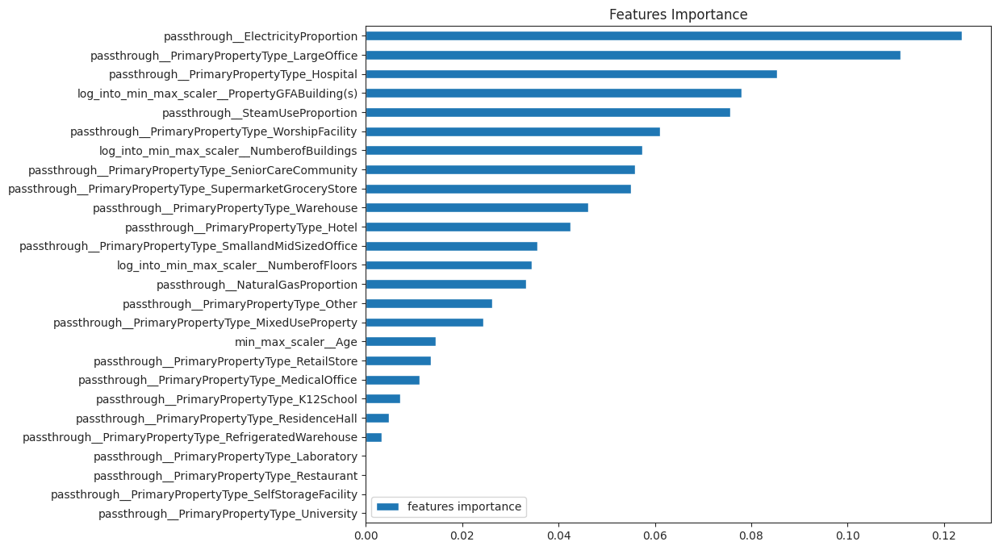

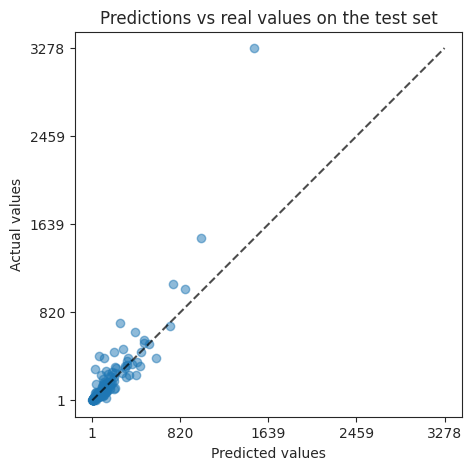

Cross-validation evaluation : 
    scores on folds:  [199.933  84.072  41.897  81.901  55.087]
    mean score:  92.578
    std score deviation:  56.01


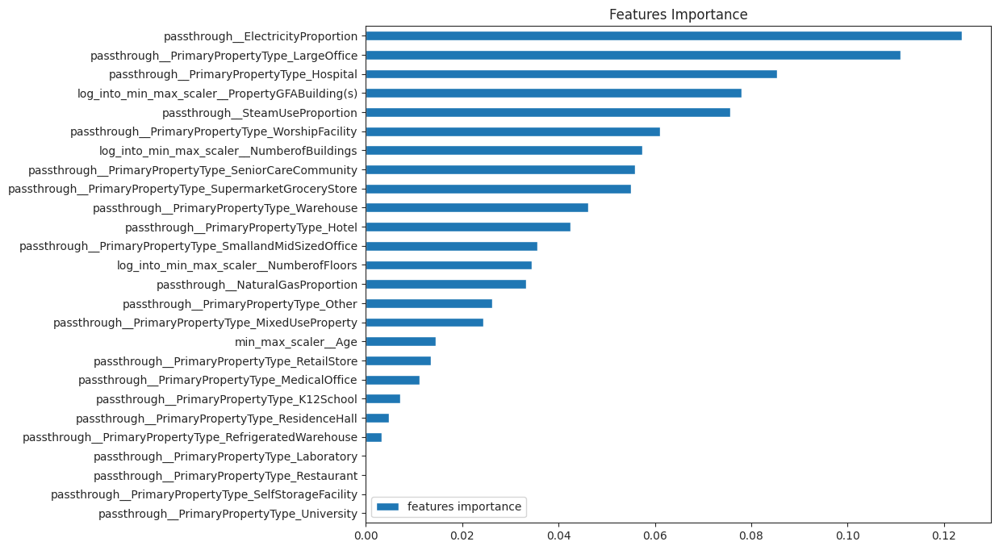

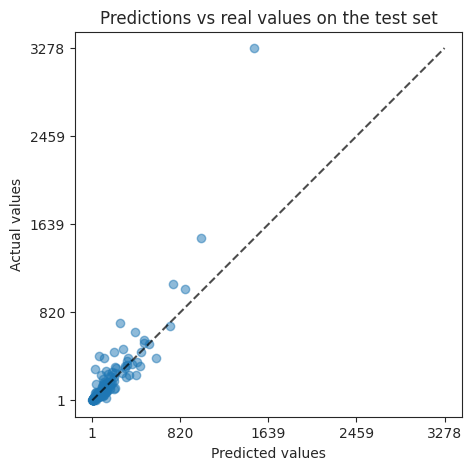

Cross-validation evaluation : 
    scores on folds:  [1401.741  329.395   87.123  321.727  145.381]
    mean score:  457.073
    std score deviation:  481.878


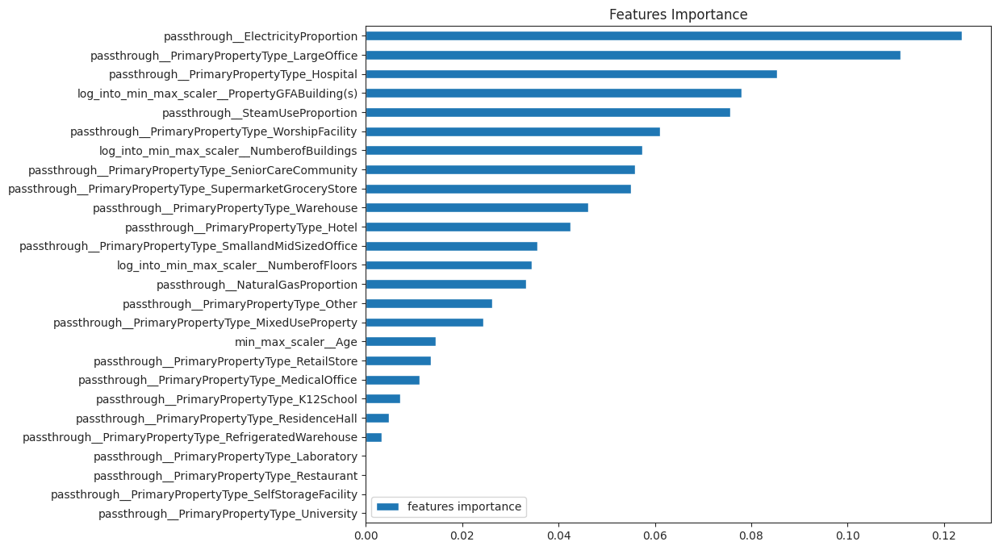

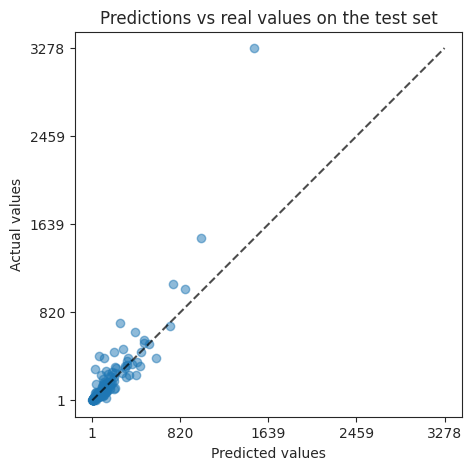


 with_ENERGYSTARScore 

Cross-validation evaluation : 
    scores on folds:  [0.093 0.671 0.756 0.907 0.712]
    mean score:  0.628
    std score deviation:  0.279


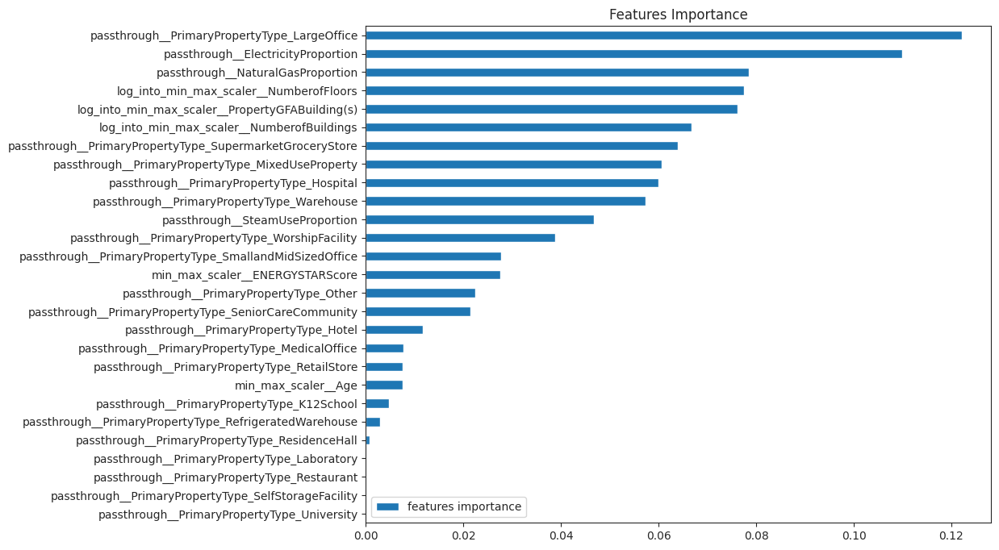

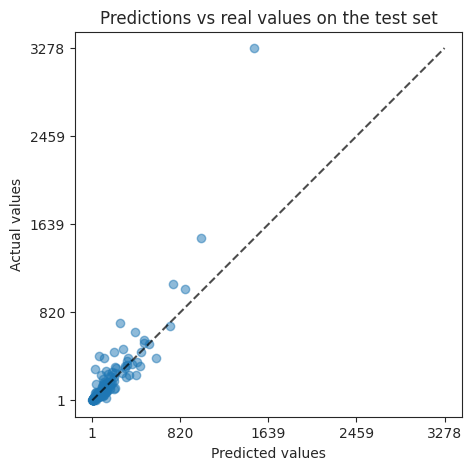

Cross-validation evaluation : 
    scores on folds:  [197.984 102.514  38.649  83.768  48.271]
    mean score:  94.237
    std score deviation:  56.823


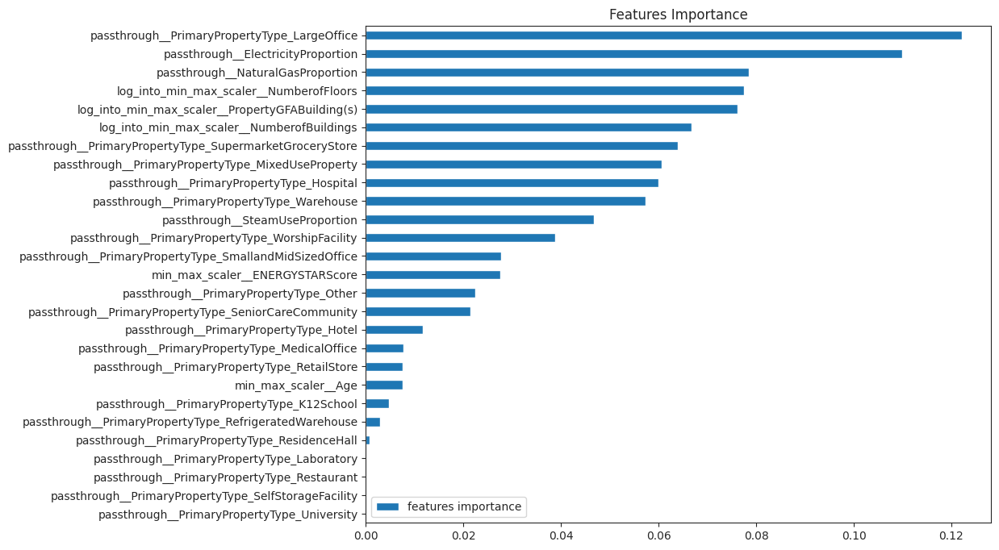

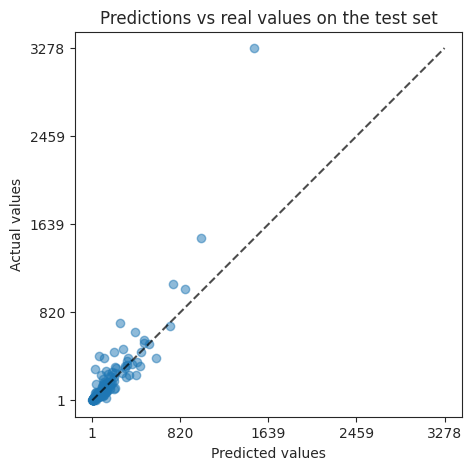

Cross-validation evaluation : 
    scores on folds:  [1390.435  590.928   82.922  352.712  132.124]
    mean score:  509.824
    std score deviation:  475.739


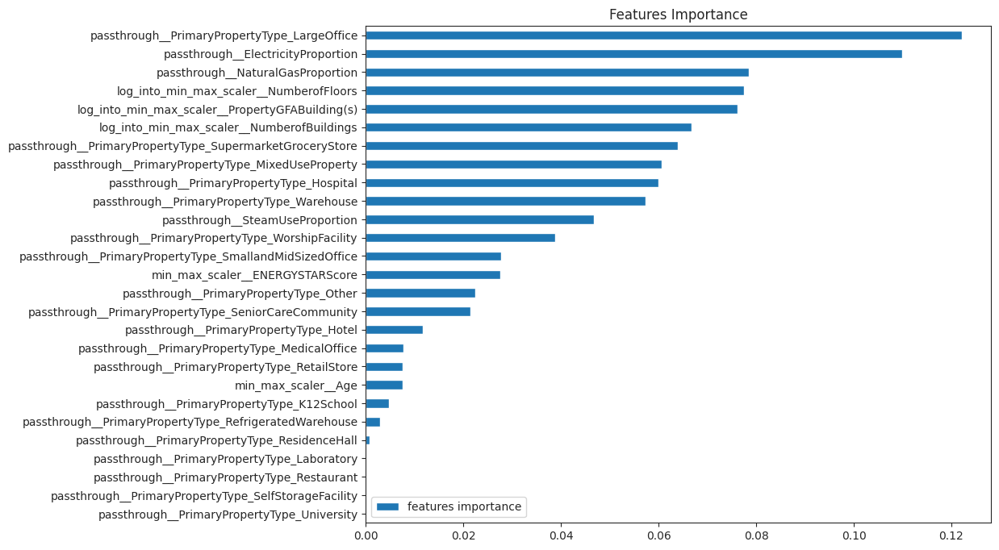

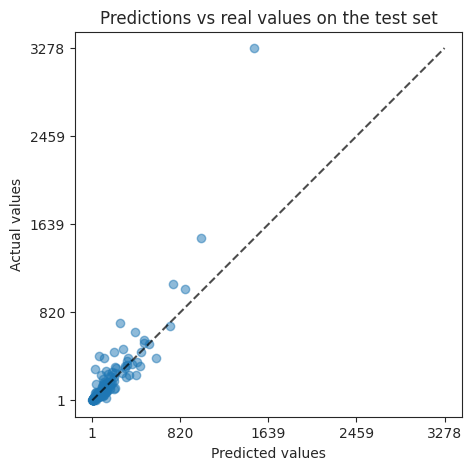


 with_ENERGYSTARScore_squared 

Cross-validation evaluation : 
    scores on folds:  [0.093 0.671 0.756 0.907 0.712]
    mean score:  0.628
    std score deviation:  0.279


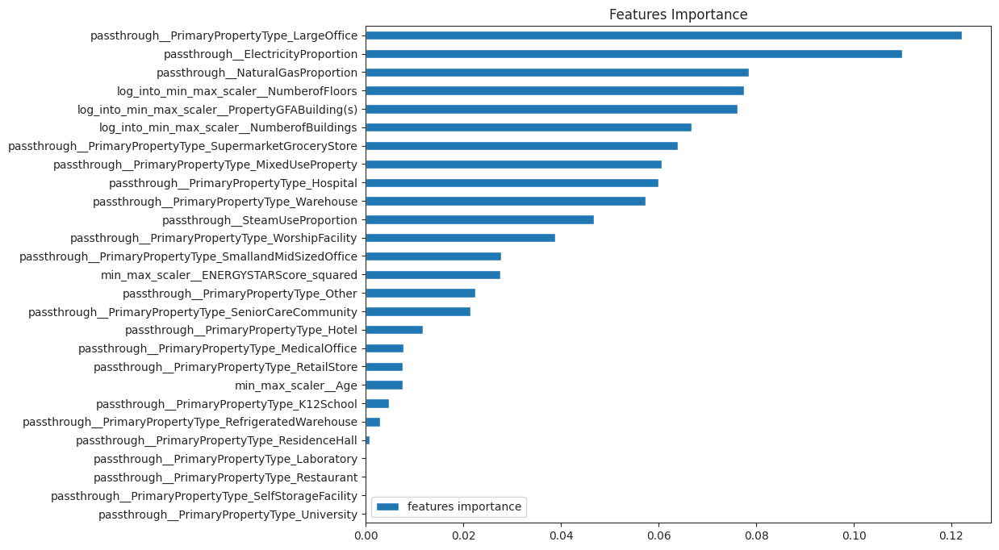

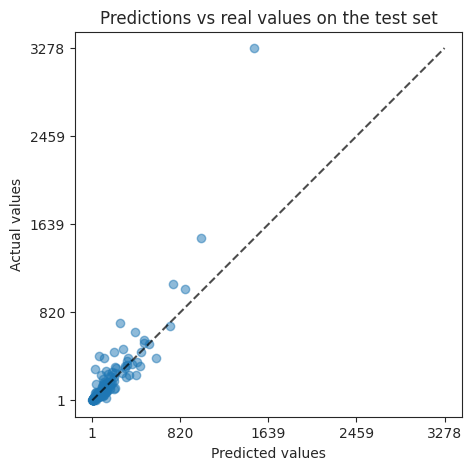

Cross-validation evaluation : 
    scores on folds:  [197.984 102.514  38.649  83.768  48.271]
    mean score:  94.237
    std score deviation:  56.823


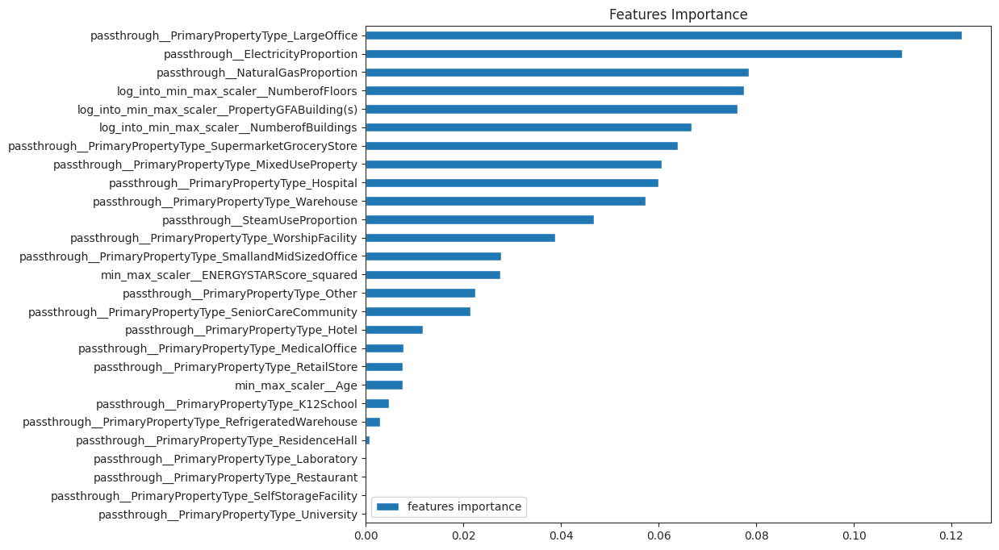

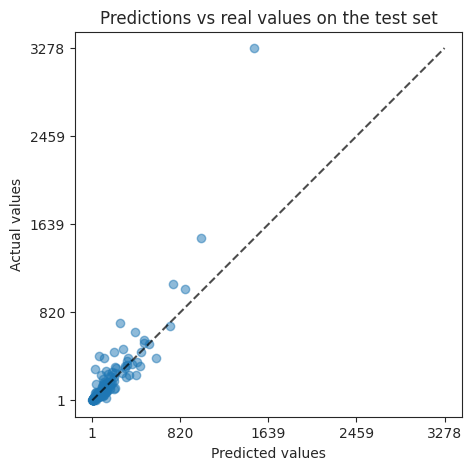

Cross-validation evaluation : 
    scores on folds:  [1390.435  590.928   82.922  352.712  132.124]
    mean score:  509.824
    std score deviation:  475.739


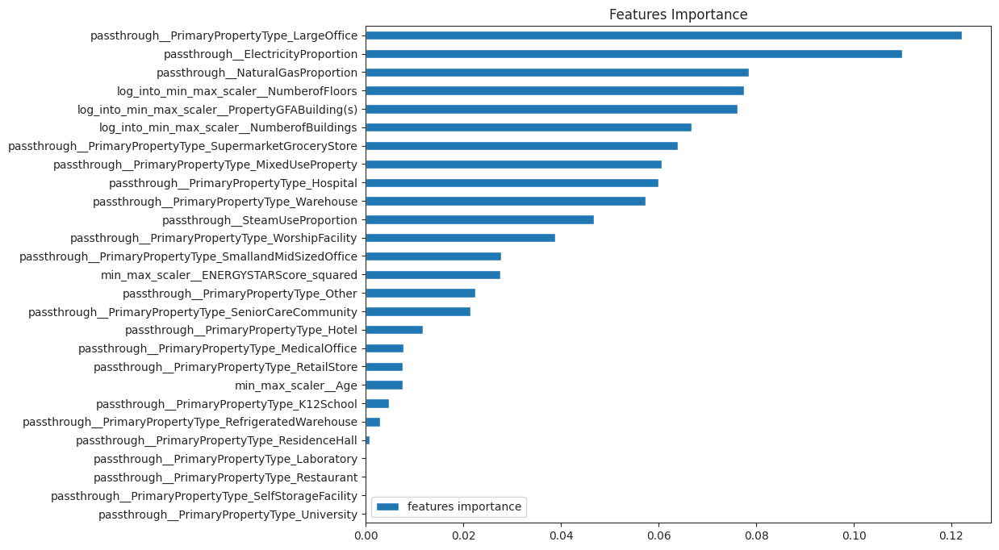

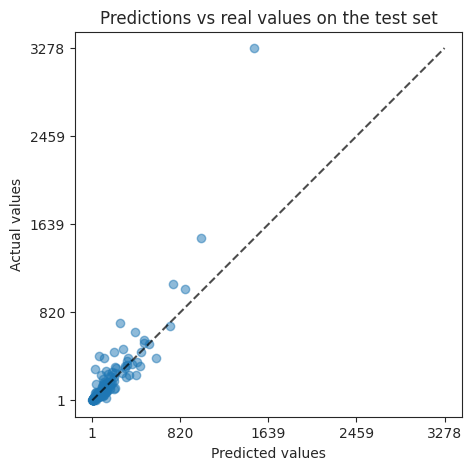

In [286]:
for pp in pre_processors: # adding ENERGYSTAR Score via the pre-processor
    print(f'\n {pp} \n')
    
    reg_part = Pipeline(
        [
            ('pre_processor', pre_processors[pp]),
            ('regressor', reg),
        ]
    )

    full_model = TransformedTargetRegressor(
        regressor=reg_part,
        transformer=log_transformer
    )

    for i, metric in metrics.iterrows():
        cv_output = ds.CV_evaluation(
            full_model, X_train, y_train,
            scoring=metric.scoring_alias
        )
        
        start = timer()
        full_model.fit(X_train, y_train)
        end = timer()
        computation_time = end - start
        
        y_pred = full_model.predict(X_test)
        
        fi = pd.DataFrame(
            data=full_model.regressor_[-1].feature_importances_, 
            index=full_model.regressor_[0].get_feature_names_out(),
            columns=['features importance']
        )

        (   fi
            .sort_values('features importance',ascending=True)
            .plot(kind="barh", figsize=(10,8), title='Features Importance')
        )
        plt.show()

        # displaying predictions vs real values
        _, ax = plt.subplots(figsize=(5, 5))
        _ = PredictionErrorDisplay.from_predictions(
            y_test, pred_test, kind="actual_vs_predicted",
            ax=ax, scatter_kwargs={"alpha": 0.5}
        )
        ax.set_title("Predictions vs real values on the test set")
        plt.show()
        
        # Compute and print scores on train and test sets.
        y_pred_train = full_model.predict(X_train)
        score_train = apply_score_func(metric, y_train, y_pred_train)
        score_test = apply_score_func(metric, y_test, y_pred)
        
        
        results.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                'None',
                cv_output[0],
                score_train,
                "xgboost_gbtree",
                "mixed_log_min_max",
                pp,
                metric.name,
                'log',
                full_model          
            ]
        )

## 10.6.  [&#9650;](#toc0_) <a id='toc10_6_'></a>Dummy regressor for comparison

In [287]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
fine_tuning = False
save_model = False

regressor_name = "Dummy_regressor"

for pp in pre_processors:
    print(f"\n {pp} \n" + '-'*20)
    # Create the model
    first_step_model = Pipeline(
        [
            ("pre_processor", pre_processors[pp]),
            ("dummy_regressor", DummyRegressor(strategy='mean')),
        ]
    )

    # Add target transformation
    model = TransformedTargetRegressor(
        regressor=first_step_model,
        transformer=log_transformer
    )

    # Define the metric for the grid search and the evaluation.
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)

        hyperparameters = "None"
        
        start = timer()
        model.fit(X_train, y_train)
        end = timer()
        computation_time = end - start

        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0,
                silent=silent
            )    
        
        # Predict
        pred_train = model.predict(X_train)
        pred_test = model.predict(X_test)
        
        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")

        # add to results
        results.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                "Dummy_regressor",
                "mixed_log_min_max",
                pp,
                metric.name,
                'log',
                model          
            ]
        )



 without_ENERGYSTARScore 
--------------------
--------------------
metric : R2
--------------------
Cross-validation evaluation : 
    scores on folds:  [-0.034 -0.045 -0.038 -0.055 -0.018]
    mean score:  -0.038
    std score deviation:  0.012

Train score : -0.02576

Test score : -0.08818
--------------------
metric : MAE
--------------------
Cross-validation evaluation : 
    scores on folds:  [265.701 159.392 179.92  110.999 218.468]
    mean score:  186.896
    std score deviation:  52.483

Train score : 186.85063

Test score : 120.12184
--------------------
metric : RMSE
--------------------
Cross-validation evaluation : 
    scores on folds:  [1324.465  611.667  788.856  322.691 1385.032]
    mean score:  886.542
    std score deviation:  410.681

Train score : 977.11697

Test score : 312.11524

 with_ENERGYSTARScore 
--------------------
--------------------
metric : R2
--------------------
Cross-validation evaluation : 
    scores on folds:  [-0.034 -0.045 -0.038 -0.055 -0.

In [288]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"input_type",
"metric",
"target_transformer",
"model"
]

df_results = pd.DataFrame(
results, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results.sort_values(['metric', 'CV_train_score_mean'])

CV_train_score_mean  \
metric pre_processor     regressor       target_transformer                        
MAE    mixed_log_min_max elastic_net     log                              73.678   
                                         log                              76.068   
                         xgboost_gbtree  log                              92.578   
                         elastic_net     log                              92.596   
                         xgboost_gbtree  log                              94.237   
                                         log                              94.237   
                         Dummy_regressor log                             186.896   
                                         log                             186.896   
                                         log                             186.896   
R2     mixed_log_min_max Dummy_regressor log                              -0.038   
                                         log                              -0.038   
                                         log                              -0.038   
                         elastic_net     log                               0.582   
                         xgboost_gbtree  log                               0.628   
                                         log                               0.628   
                         elastic_net     log                               0.634   
                                         log                               0.636   
                         xgboost_gbtree  log                               0.656   
RMSE   mixed_log_min_max elastic_net     log                             420.749   
                                         log                             445.598   
                         xgboost_gbtree  log                             457.073   
                                         log                             509.824   
                                         log                             509.824   
                         elastic_net     log                             515.760   
                         Dummy_regressor log                             886.542   
                                         log                             886.542   
                                         log                             886.542   

                                                             CV_train_score_std  \
metric pre_processor     regressor       target_transformer                       
MAE    mixed_log_min_max elastic_net     log                             38.330   
                                         log                             33.799   
                         xgboost_gbtree  log                             56.010   
                         elastic_net     log                             36.476   
                         xgboost_gbtree  log                             56.823   
                                         log                             56.823   
                         Dummy_regressor log                             52.483   
                                         log                             52.483   
                                         log                             52.483   
R2     mixed_log_min_max Dummy_regressor log                              0.012   
                                         log                              0.012   
                                         log                              0.012   
                         elastic_net     log                              0.294   
                         xgboost_gbtree  log                              0.279   
                                         log                              0.279   
                         elastic_net     log                              0.285   
                                         log                              0.291   
                         xgboost_gbtree  log   

## 10.7.  [&#9650;](#toc0_) <a id='toc10_7_'></a>Comparing models and observing the effect of the ENERGY STAR Score

### 10.7.1.  [&#9650;](#toc0_) <a id='toc10_7_1_'></a>Training time

In [106]:
df_results = df_results.reset_index()

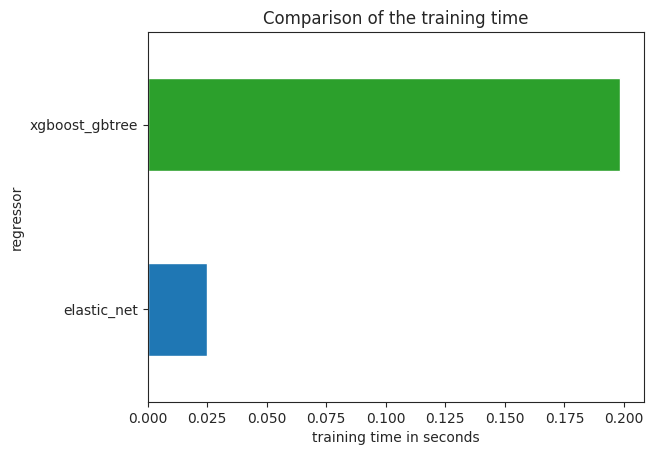

In [107]:
# Plotting training times
palette = sns.color_palette()
(
    df_results
    .query("metric == 'MAE'")
    .loc[[4,10], :]
    .set_index('regressor')["computation_time"]
    .plot(
        kind='barh', xlabel="training time in seconds",
        title="Comparison of the training time", color=[palette[0], palette[2]]    
    )
)
plt.show()

### 10.7.2.  [&#9650;](#toc0_) <a id='toc10_7_2_'></a>Scores comparison and improvement thanks to the Energy Star Score?

In [121]:
df_results = pd.DataFrame(
results, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
(
    df_results.sort_values(['metric', 'CV_train_score_mean'])
    .head(6)
)

CV_train_score_mean  \
metric pre_processor     regressor      target_transformer                        
MAE    mixed_log_min_max elastic_net    log                              73.678   
                                        log                              76.068   
                         xgboost_gbtree log                              92.578   
                         elastic_net    log                              92.596   
                         xgboost_gbtree log                              94.237   
                                        log                              94.237   

                                                            CV_train_score_std  \
metric pre_processor     regressor      target_transformer                       
MAE    mixed_log_min_max elastic_net    log                             38.330   
                                        log                             33.799   
                         xgboost_gbtree log                             56.010   
                         elastic_net    log                             36.476   
                         xgboost_gbtree log                             56.823   
                                        log                             56.823   

                                                            test_score  \
metric pre_processor     regressor      target_transformer               
MAE    mixed_log_min_max elastic_net    log                   47.85585   
                                        log                   45.85465   
                         xgboost_gbtree log                   48.47896   
                         elastic_net    log                   53.19840   
                         xgboost_gbtree log                   50.19798   
                                        log                   50.19798   

                                                            computation_time  \
metric pre_processor     regressor      target_transformer                     
MAE    mixed_log_min_max elastic_net    log                         0.024806   
                                        log                         0.063901   
                         xgboost_gbtree log                         0.198362   
                         elastic_net    log                         0.020927   
                         xgboost_gbtree log                         0.240652   
                                        log                         0.239919   

                                                                                                                                                hyperparameters  \
metric pre_processor     regressor      target_transformer                                                                                                        
MAE    mixed_log_min_max elastic_net    log                  {'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 0.01}   
                                        log                  {'regressor__elastic_net__alpha': 0.0016681005372000592, 'regressor__elastic_net__l1_ratio': 0.01}   
                         xgboost_gbtree log                                                                                                                None   
                         elastic_net    log                 {'regressor__elastic_net__alpha': 0.0027825594022071257, 'regressor__elastic_net__l1_ratio': 1e-05}   
                         xgboost_gbtree log                                                                                                                None   
                                        log                                                                                                                None   

                                                                                           fold_scores  \
metric pre_processor     regressor      target_transformer                                   

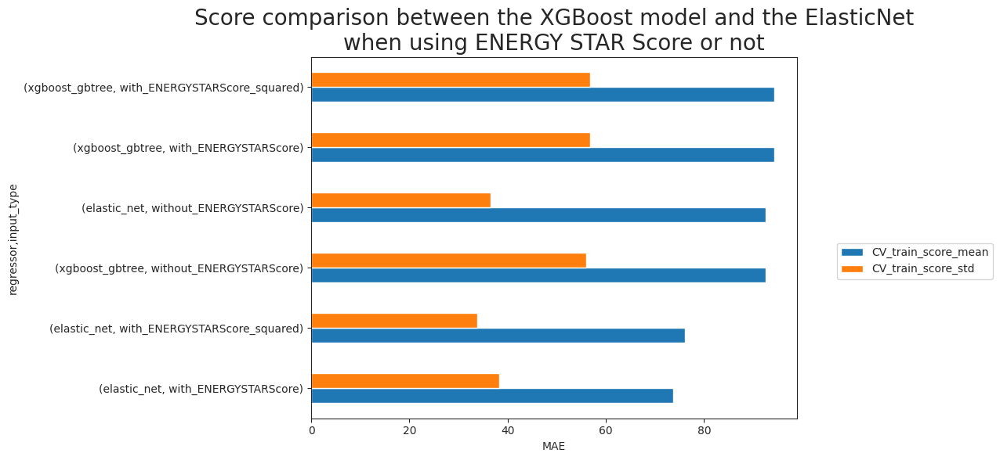

In [133]:
ax = (
    df_results.sort_values(['metric', 'CV_train_score_mean'])
    .head(6)
    .reset_index()
    .set_index(
        [
            "regressor",
            "input_type"
        ]
    ).loc[:,['CV_train_score_mean', "CV_train_score_std"]]
    .plot(
        kind='barh', xlabel="MAE", figsize=(8,6),
        title=(
            "Score comparison between the XGBoost model and the ElasticNet\n"
            "when using ENERGY STAR Score or not"
        )
    )
)
ax.legend(bbox_to_anchor=(1.07, 0.5))
ax.title.set_size(20)

plt.show()

In [ ]:
# Reset index and erase the energy star score squared which did not improve
# anything.
df_results = (
    df_results.reset_index()
    .query("input_type != 'with_ENERGYSTARScore_squared'")
)

In [ ]:
# regroup dummy regressor scores for each metric.
dummy = df_results.query("regressor == 'Dummy_regressor'").iloc[:3, :]


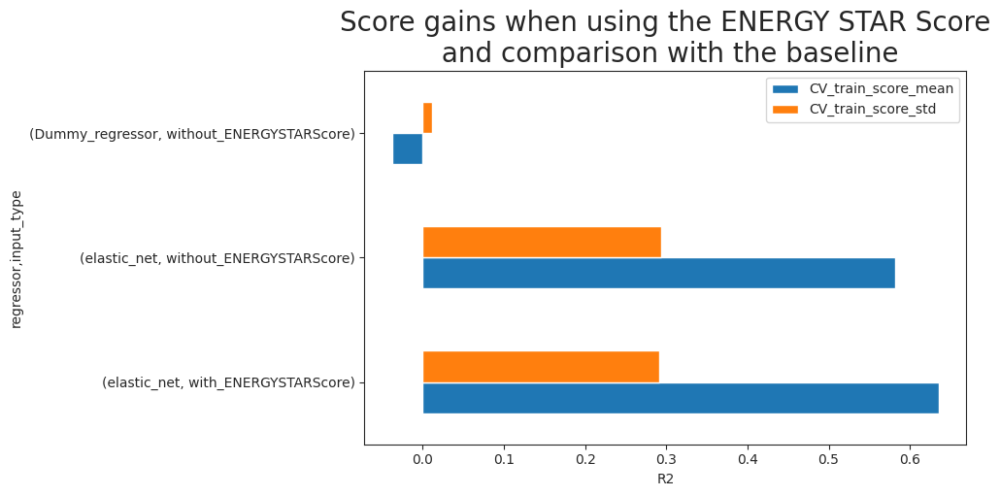

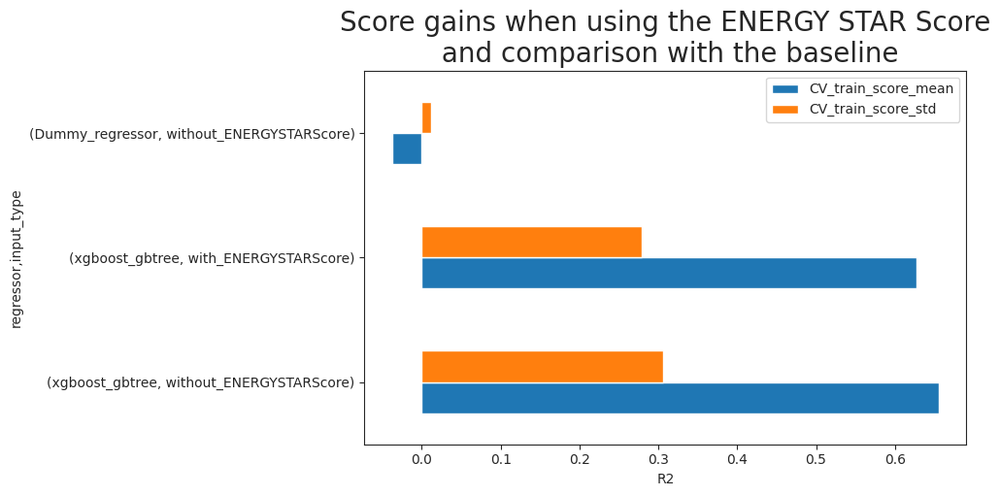

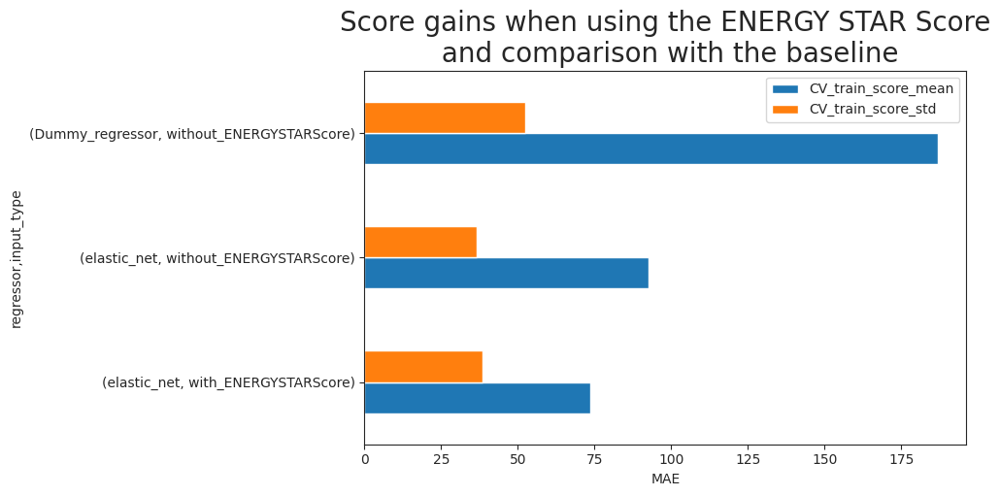

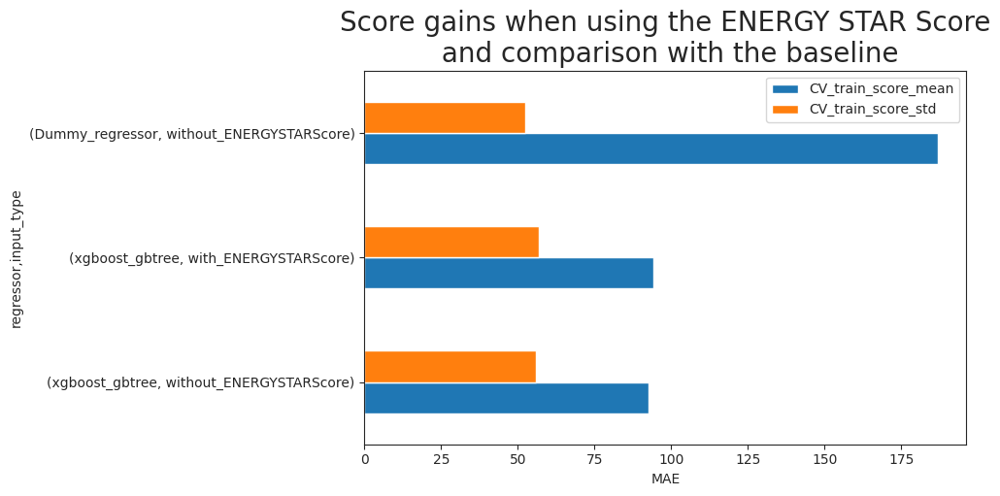

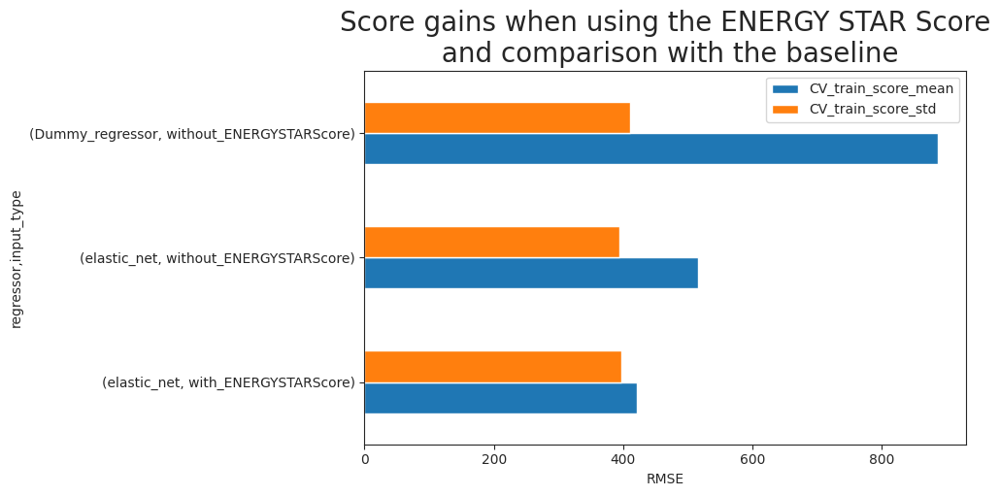

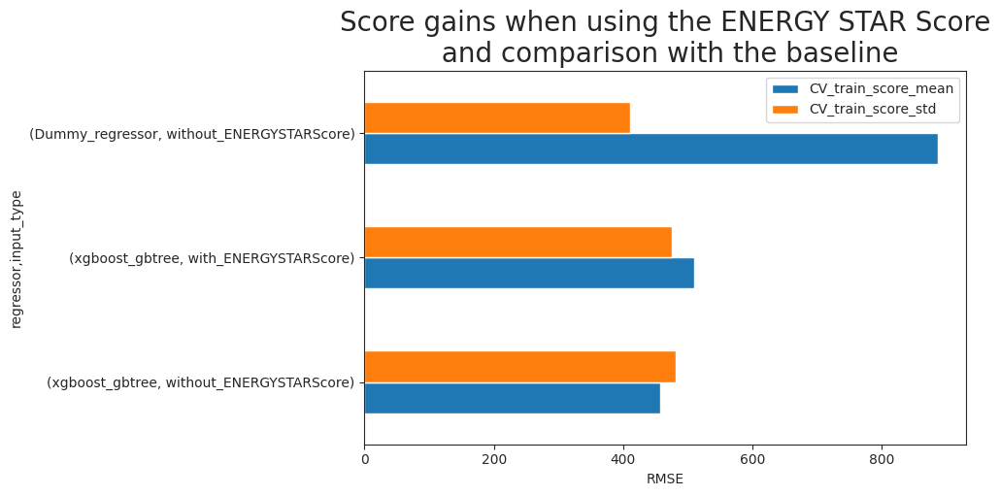

In [112]:
from itertools import product
# Reset index and erase the energy star score squared which did not improve
# anything.
df_results = (
    df_results.reset_index()
    .query("input_type != 'with_ENERGYSTARScore_squared'")
)
# regroup dummy regressor scores for each metric.
dummy = df_results.query("regressor == 'Dummy_regressor'").iloc[:3, :]

for metric_name, regr in product(
    metrics.index, ["elastic_net", "xgboost_gbtree"]
):
    # Select scores per (metric and regressor) and sort it in the right manner
    tdf = (
        df_results
        .query("metric == @metric_name and regressor == @regr")
        .sort_values(['CV_train_score_mean'])
    )
    if metric_name == "R2":
        tdf = tdf.sort_values('CV_train_score_mean', ascending=False)
    
    # Add the dummy regressor score of that metric
    tdf = pd.concat([tdf, dummy.query("metric == @metric_name")], axis=0)
    # Plot the scores
    ax = (
        tdf
        .set_index(["regressor", "input_type"])
        .loc[:, ['CV_train_score_mean', 'CV_train_score_std']]
        .plot(
            kind='barh', figsize=(8,5), xlabel=f"{metric_name}",
            title=(
                f"Score gains when using the ENERGY STAR Score\n and " 
                f"comparison with the baseline"
            )
        )
    )
    ax.title.set_size(20)

    

This showed that adding the ENERGYSTARScore helped improve the performance of the ElasticNet substantially. the MAE went from 92.6 tons CO2 eq to 73,7 which is the best score obtained. 

Nevertheless, It seems that it messes with the xgboost Regressor and has a deleterious effect (need to retune the model?).

# 11.  [&#9650;](#toc0_) <a id='toc11_'></a>The Chosen model : log/minMax pre-processing + ElasticNet + log target transformer.

In [191]:
1 - 73.7/92.6

0.20410367170626342

For this model which already was the best performer, The error decreased by 20,4% when adding the EnergyStar Score to the inputs.



In [5]:
73.7/186.9

0.39432851792402357

It is now only 39,4% of the baseline's MAE

# 12.  [&#9650;](#toc0_) <a id='toc12_'></a> Adding total energy consumption predictions to inputs.

In [136]:
pred = pd.read_csv("energy_consumption_predictions.csv", index_col=0)
pred.head()

,energy_consumption_prediction
OSEBuildingID,
1,6.360855e+06
2,9.072000e+06
3,5.809002e+07
5,5.359084e+06
8,9.936924e+06


In [155]:
pred.shape

(966, 1)

In [156]:
# adding prediction to inputs
X = X.join(pred, validate="1:1")

In [157]:
# Splitting
test_size = 0.2
seed = 2

X_train, X_test, y_train, y_test = train_test_split(
    X, y, shuffle=True, test_size=test_size, random_state=seed
)

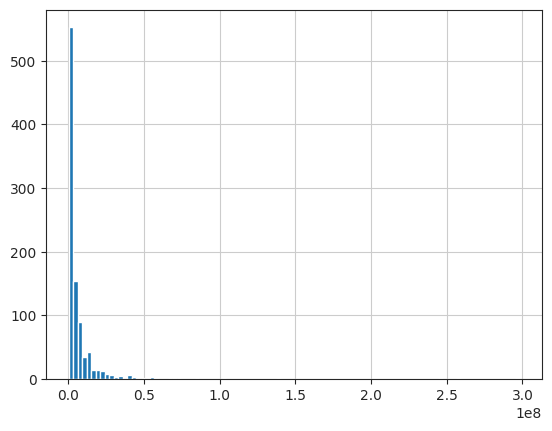

In [158]:
X.energy_consumption_prediction.hist(bins=100)
plt.show()

As the predictions distribution is skewed, I pre-process them with a log transformation.

In [159]:
# features with a skewed distribution
fts_to_transform = [
    'PropertyGFABuilding(s)',
    'NumberofBuildings',
    'NumberofFloors',
    'energy_consumption_prediction',
]
fts_to_scale_only = [
    'Age',
    'ENERGYSTARScore'
]
# Already pre_processed
fts_passthrough = [
    'PrimaryPropertyType_Hospital',
    'PrimaryPropertyType_Hotel',
    'PrimaryPropertyType_K12School',
    'PrimaryPropertyType_Laboratory',
    'PrimaryPropertyType_LargeOffice',
    'PrimaryPropertyType_MedicalOffice',
    'PrimaryPropertyType_MixedUseProperty',
    'PrimaryPropertyType_Other',
    'PrimaryPropertyType_RefrigeratedWarehouse',
    'PrimaryPropertyType_ResidenceHall',
    'PrimaryPropertyType_Restaurant',
    'PrimaryPropertyType_RetailStore',
    'PrimaryPropertyType_SelfStorageFacility',
    'PrimaryPropertyType_SeniorCareCommunity',
    'PrimaryPropertyType_SmallandMidSizedOffice',
    'PrimaryPropertyType_SupermarketGroceryStore',
    'PrimaryPropertyType_University',
    'PrimaryPropertyType_Warehouse',
    'PrimaryPropertyType_WorshipFacility',
    'SteamUseProportion',
    'ElectricityProportion',
    'NaturalGasProportion',
]

pre_processors = define_pre_processors_according_to_inputs(
    fts_to_transform=fts_to_transform,
    fts_to_scale_only=fts_to_scale_only,
    fts_passthrough=fts_passthrough
)

pp = pre_processors[3]
pre_processors = {"energy_pred + energy_star_score": pp}
pre_processors['energy_pred + energy_star_score']

ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                 Pipeline(steps=[('log_transformer',
                                                  FunctionTransformer(feature_names_out='one-to-one',
                                                                      func=<ufunc 'log1p'>,
                                                                      inverse_func=<ufunc 'expm1'>)),
                                                 ('min_max_scaler',
                                                  MinMaxScaler())]),
                                 ['PropertyGFABuilding(s)', 'NumberofBuildings',
                                  'NumberofFloors',
                                  'energy_consumption_prediction']),
                                ('min_max_scaler', MinM...
                                  'PrimaryPropertyType_RetailStore',
                                  'PrimaryPropertyType_SelfStorageFacility',
                                  'PrimaryPropertyType_SeniorCareCommunity',
                                  'PrimaryPropertyType_SmallandMidSizedOffice',
                                  'PrimaryPropertyType_SupermarketGroceryStore',
                                  'PrimaryPropertyType_University',
                                  'PrimaryPropertyType_Warehouse',
                                  'PrimaryPropertyType_WorshipFacility',
                                  'SteamUseProportion', 'ElectricityProportion',
                                  'NaturalGasProportion'])])


 energy_pred + energy_star_score 
--------------------
--------------------
metric : R2
--------------------
Best parameter (CV score=0.748):
{'regressor__elastic_net__alpha': 0.003593813663804626, 'regressor__elastic_net__l1_ratio': 0.01}


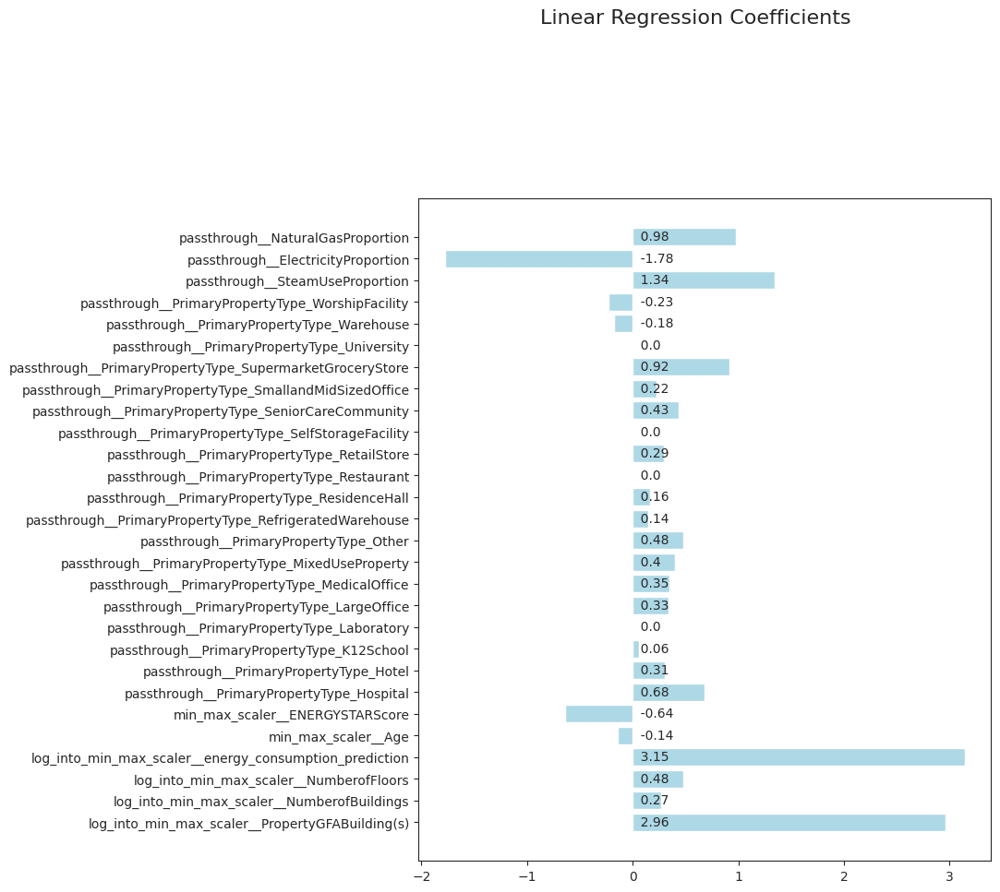

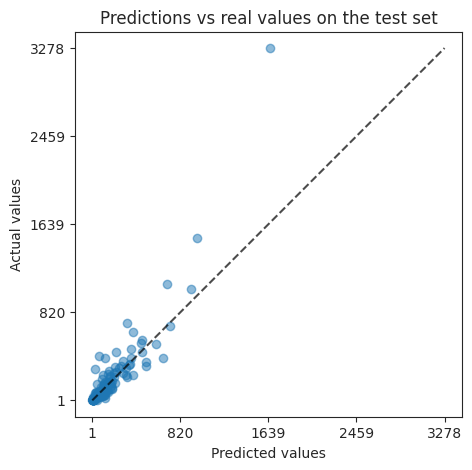

Cross-validation evaluation : 
    scores on folds:  [0.978 0.352 0.972 0.55  0.314]
    mean score:  0.633
    std score deviation:  0.29

Train score : 0.66679

Test score : 0.76822
--------------------
metric : MAE
--------------------
Best parameter (CV score=-76.822):
{'regressor__elastic_net__alpha': 0.004641588833612777, 'regressor__elastic_net__l1_ratio': 0.01}


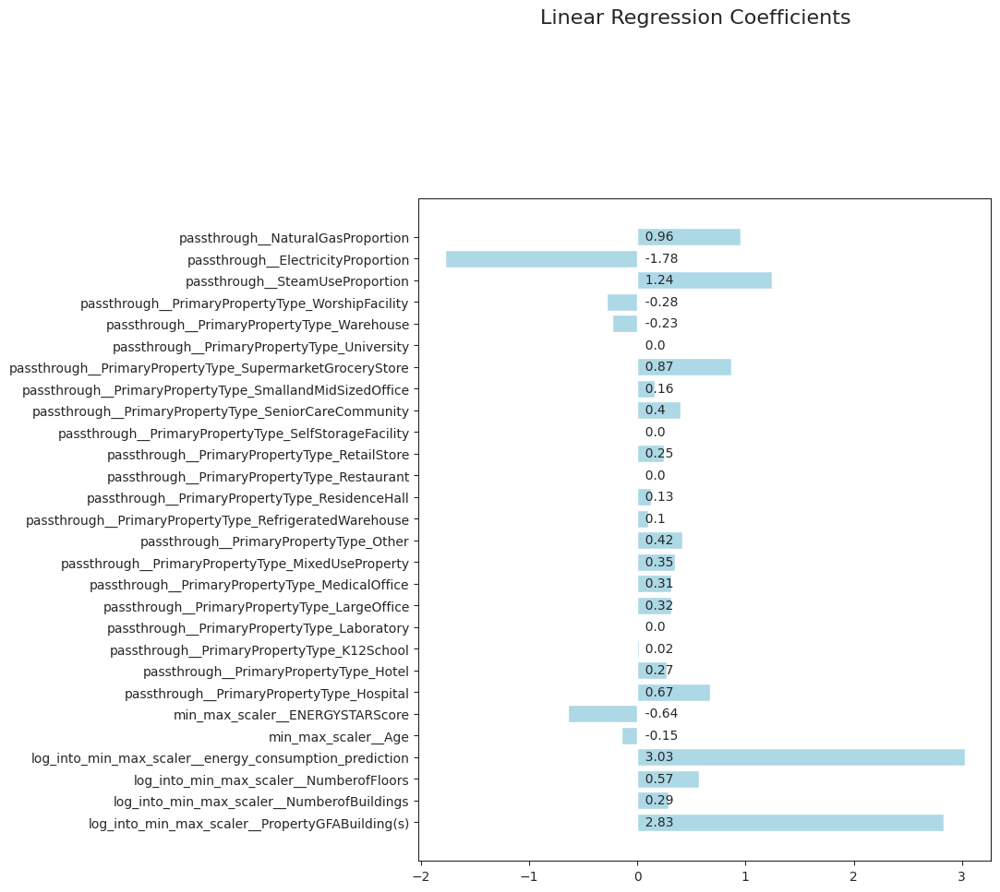

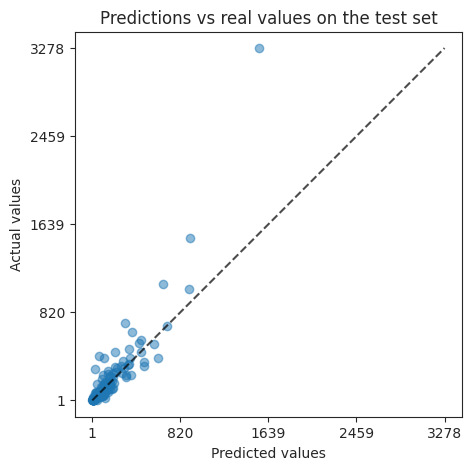

Cross-validation evaluation : 
    scores on folds:  [ 56.437  87.15   33.099  53.414 141.688]
    mean score:  74.358
    std score deviation:  37.84

Train score : 74.1126

Test score : 48.08781
--------------------
metric : RMSE
--------------------
Best parameter (CV score=-431.705):
{'regressor__elastic_net__alpha': 0.004641588833612777, 'regressor__elastic_net__l1_ratio': 0.01}


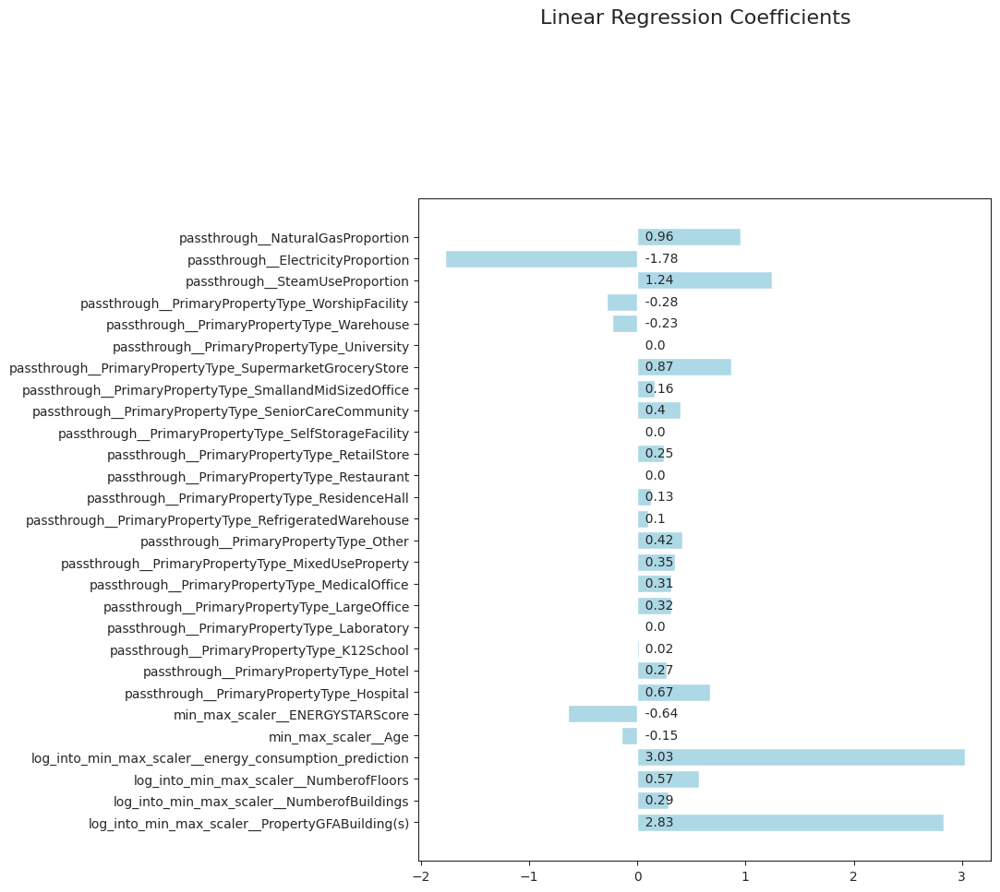

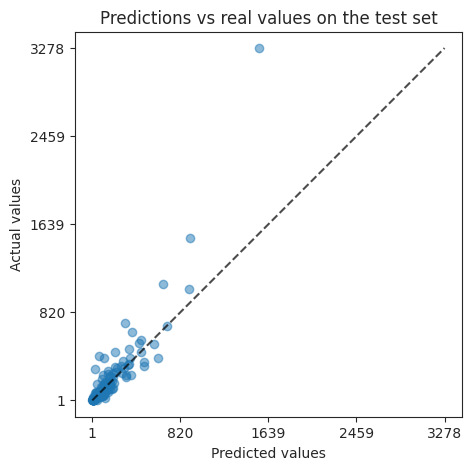

Cross-validation evaluation : 
    scores on folds:  [ 228.621  488.532   70.29   206.248 1162.796]
    mean score:  431.297
    std score deviation:  389.979

Train score : 575.13218

Test score : 151.53914


In [160]:
show_plot = True
show_scores = True
show_regressor_input = False
silent = False
save_model = False

regressor_name = "elastic_net"

for pp in pre_processors:
    print(f"\n {pp} \n" + '-'*20)
    # Create the model
    first_step_model = Pipeline(
        [
            ("pre_processor", pre_processors[pp]),
            ("elastic_net", ElasticNet(random_state=0, max_iter=100_000)),
        ]
    )

    # Add target transformation
    model = TransformedTargetRegressor(
        regressor=first_step_model,
        transformer=log_transformer
    )

    # Define the metric for the grid search and the evaluation.
    for i, metric in metrics.iterrows():
        if show_scores:
            print('-'*20)
            print(f"metric : {metric.name}")
            print('-'*20)
            
        #Gridsearch   
        param_name_alpha = "regressor__" + regressor_name + "__alpha"
        param_name_l1_ratio = "regressor__" + regressor_name + "__l1_ratio"
        param_grid = [
            {
                param_name_alpha: np.logspace(-3, -2, 10),
                param_name_l1_ratio: np.logspace(-5, -2, 3)
            }
        ]
        n_folds = 5

        search = GridSearchCV(
            model, param_grid=param_grid,
            scoring=metric.scoring_alias, cv=n_folds
        )
        search.fit(X_train, y_train)
        print("Best parameter (CV score=%0.3f):" % search.best_score_)
        print(search.best_params_)

        hyperparameters = search.best_params_
        # Extract and fit the best model
        model = search.best_estimator_
        start = timer()
        model.fit(X_train, y_train)
        end = timer()
        computation_time = end - start
        
        # Predict
        pred_train = model.predict(X_train)
        pred_test = model.predict(X_test)

        if show_plot:
            # Observing the coefficients of the regression model
            ds.linearRegressionSummary(
                model.regressor_[regressor_name], 
                model.regressor_[:-1].get_feature_names_out()
            )

            # displaying predictions vs real values
            _, ax = plt.subplots(figsize=(5, 5))
            _ = PredictionErrorDisplay.from_predictions(
                y_test, pred_test, kind="actual_vs_predicted",
                ax=ax, scatter_kwargs={"alpha": 0.5}
            )
            ax.set_title("Predictions vs real values on the test set")
            plt.show()

        if show_regressor_input:
            # displaying the inputs after the preprocessing stage
            pre_processed_inputs = pd.DataFrame(
                model.regressor_[:-1].transform(X_train), 
                index=X_train.index,
                columns=model.regressor_[:-1].get_feature_names_out()
            )
            display(pre_processed_inputs)   

        # CV evaluation
        cv_output = ds.CV_evaluation(
            model, X_train, y_train, k=5,
                scoring=metric.scoring_alias, seed=0,
                silent=silent
            )    

        # Compute and print scores on train and test sets.
        score_train = apply_score_func(metric, y_train, pred_train)
        score_test = apply_score_func(metric, y_test, pred_test)
        if show_scores:
            print(f"\nTrain score : {score_train}")
            print(f"\nTest score : {score_test}")

        # add to results
        results.append(
            [
                cv_output[1],
                cv_output[2],
                score_test,
                computation_time,
                hyperparameters,
                cv_output[0],
                score_train,
                "elastic_net",
                "mixed_log_min_max",
                pp,
                metric.name,
                'log',
                model          
            ]
        )



In [162]:
# Create the results dataframe
cols = [
"CV_train_score_mean",
"CV_train_score_std",
"test_score",
"computation_time",
"hyperparameters",
"fold_scores",
"train_score",
"regressor",
"pre_processor",
"input_type",
"metric",
"target_transformer",
"model"
]

df_results = pd.DataFrame(
results, columns=cols
).set_index(["metric", "pre_processor", "regressor", "target_transformer"])           
    
df_results.sort_values(['metric', 'CV_train_score_mean'])

CV_train_score_mean  \
metric pre_processor     regressor       target_transformer                        
MAE    mixed_log_min_max elastic_net     log                              73.678   
                                         log                              74.358   
                                         log                              76.068   
                         xgboost_gbtree  log                              92.578   
                         elastic_net     log                              92.596   
                         xgboost_gbtree  log                              94.237   
                                         log                              94.237   
                         Dummy_regressor log                             186.896   
                                         log                             186.896   
                                         log                             186.896   
R2     mixed_log_min_max Dummy_regressor log                              -0.038   
                                         log                              -0.038   
                                         log                              -0.038   
                         elastic_net     log                               0.582   
                         xgboost_gbtree  log                               0.628   
                                         log                               0.628   
                         elastic_net     log                               0.633   
                                         log                               0.634   
                                         log                               0.636   
                         xgboost_gbtree  log                               0.656   
RMSE   mixed_log_min_max elastic_net     log                             420.749   
                                         log                             431.297   
                                         log                             445.598   
                         xgboost_gbtree  log                             457.073   
                                         log                             509.824   
                                         log                             509.824   
                         elastic_net     log                             515.760   
                         Dummy_regressor log                             886.542   
                                         log                             886.542   
                                         log                             886.542   

                                                             CV_train_score_std  \
metric pre_processor     regressor       target_transformer                       
MAE    mixed_log_min_max elastic_net     log                             38.330   
                                         log                             37.840   
                                         log                             33.799   
                         xgboost_gbtree  log                             56.010   
                         elastic_net     log                             36.476   
                         xgboost_gbtree  log                             56.823   
                                         log                             56.823   
                         Dummy_regressor log                             52.483   
                                         log                             52.483   
                                         log                             52.483   
R2     mixed_log_min_max Dummy_regressor log                              0.012   
                                         log                              0.012   
                                         log                              0.012   
                         elastic_net     log                              0.294   
                         xgboost_gbtree  log

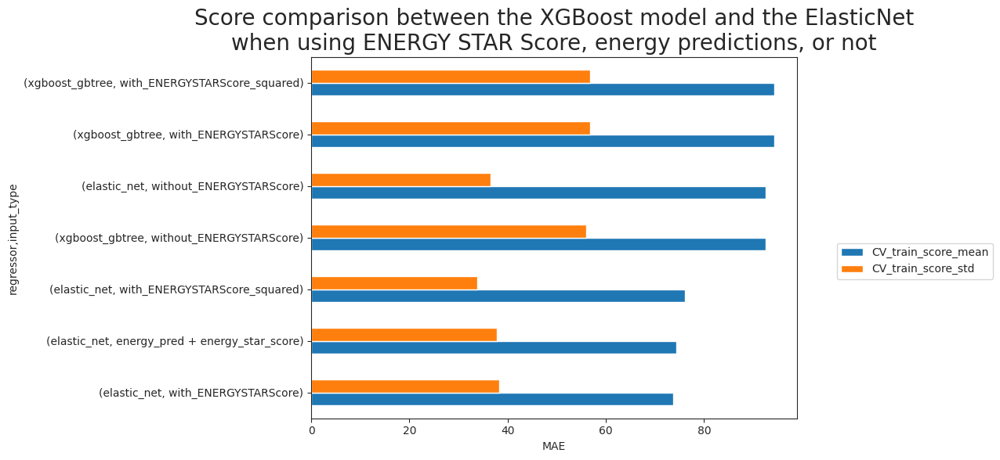

In [165]:
ax = (
    df_results.sort_values(['metric', 'CV_train_score_mean'])
    .head(7)
    .reset_index()
    .set_index(
        [
            "regressor",
            "input_type"
        ]
    ).loc[:,['CV_train_score_mean', "CV_train_score_std"]]
    .plot(
        kind='barh', xlabel="MAE", figsize=(8,6),
        title=(
            "Score comparison between the XGBoost model and the ElasticNet\n"
            "when using ENERGY STAR Score, energy predictions, or not"
        )
    )
)
ax.legend(bbox_to_anchor=(1.07, 0.5))
ax.title.set_size(20)

plt.show()

It did not improve the score.

In the regression coefficients' plot, we can see that the energy predictions soaks up weights from the GFA (probably because highly correlated). Adding this feature was not relevant.

# 13.  [&#9650;](#toc0_) <a id='toc13_'></a>Model explainability with SHAP (Bonus/first exporation)

In [167]:
import shap 
#load JS vis in the notebook
shap.initjs() 

## 13.1.  [&#9650;](#toc0_) <a id='toc13_1_'></a>ElasticNet

In [210]:
# Get the full elasticnet model
model = (
    df_results
    .query('input_type =="with_ENERGYSTARScore"')
    .query('regressor =="elastic_net"')
    .query('metric == "MAE"')
    .model.values[0]
)
model

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                                        'PrimaryPropertyType_Warehouse',
                                                                                        'PrimaryPropertyType_WorshipFacility',
                                                                                        'SteamUseProportion',
                                                                                        'ElectricityProportion',
                                                                                        'NaturalGasProportion'])])),
                                                     ('elastic_net',
                                                      ElasticNet(alpha=0.0027825594022071257,
                                                                 l1_ratio=0.01,
                                                                 max_iter=100000,
                                                                 random_state=0))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

In [211]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [212]:
# Pre-processing separately
X_train_pp = model.regressor_[:-1].transform(X_train)

X_test_pp = pd.DataFrame(
    model.regressor_[:-1].transform(X_test),
    columns=model.regressor_[:-1].get_feature_names_out()
)

In [238]:
reg = model.regressor_[-1]

# Shap explanation and values of the test set
explainer = shap.LinearExplainer(reg, X_train_pp)
shap_values_expl = explainer(X_test_pp)
shap_values = explainer.shap_values(X_test_pp)

# Prediction of the elasticNet without target transformation.
y_pred_reg = pd.DataFrame(
    reg.predict(X_test_pp.values),
    index=y_test.index,
    columns=["y_pred_reg"]
)

### 13.1.1.  [&#9650;](#toc0_) <a id='toc13_1_1_'></a>Global explainability

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


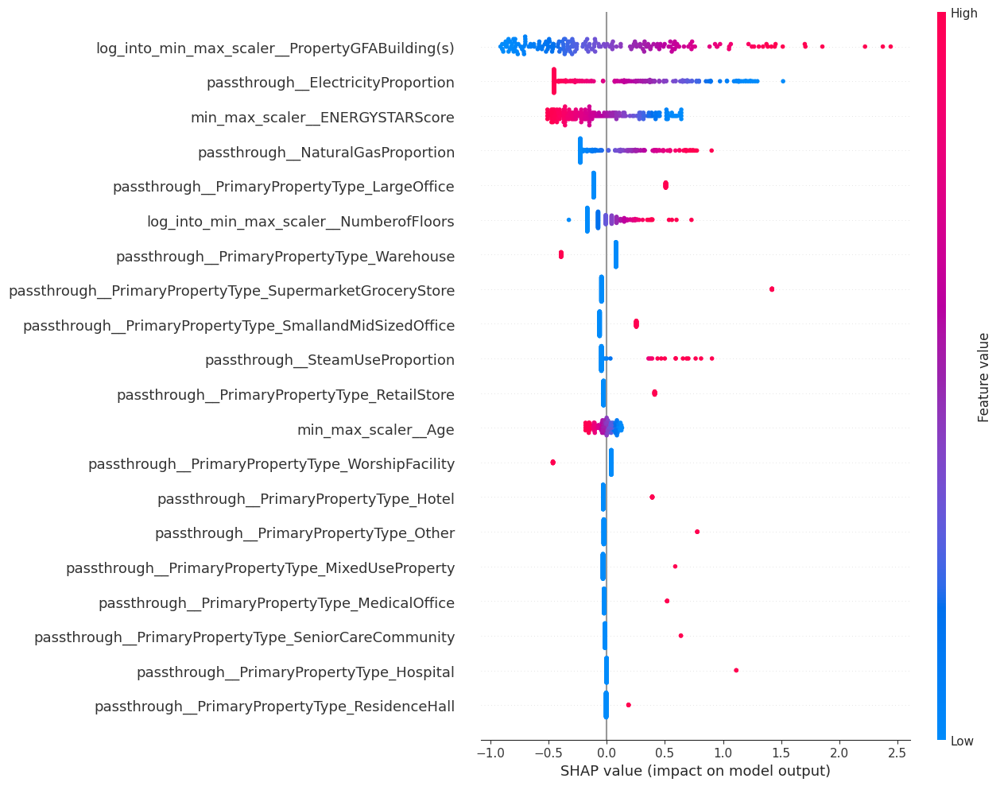

In [217]:
shap.summary_plot(shap_values, X_test_pp, plot_size=(13,10))

The most influencing features are the Buildings' GFA, the electricity and gas proportion use and the ENERGY Star Score. Number of floors is quite important too ranking 6th. It would deserve more attention (properties with 0 as a number of floor? discretization + ordinal feature?)

In [261]:
X_test_pp.columns

Index(['log_into_min_max_scaler__PropertyGFABuilding(s)',
       'log_into_min_max_scaler__NumberofBuildings',
       'log_into_min_max_scaler__NumberofFloors', 'min_max_scaler__Age',
       'min_max_scaler__ENERGYSTARScore',
       'passthrough__PrimaryPropertyType_Hospital',
       'passthrough__PrimaryPropertyType_Hotel',
       'passthrough__PrimaryPropertyType_K12School',
       'passthrough__PrimaryPropertyType_Laboratory',
       'passthrough__PrimaryPropertyType_LargeOffice',
       'passthrough__PrimaryPropertyType_MedicalOffice',
       'passthrough__PrimaryPropertyType_MixedUseProperty',
       'passthrough__PrimaryPropertyType_Other',
       'passthrough__PrimaryPropertyType_RefrigeratedWarehouse',
       'passthrough__PrimaryPropertyType_ResidenceHall',
       'passthrough__PrimaryPropertyType_Restaurant',
       'passthrough__PrimaryPropertyType_RetailStore',
       'passthrough__PrimaryPropertyType_SelfStorageFacility',
       'passthrough__PrimaryPropertyType_SeniorCare

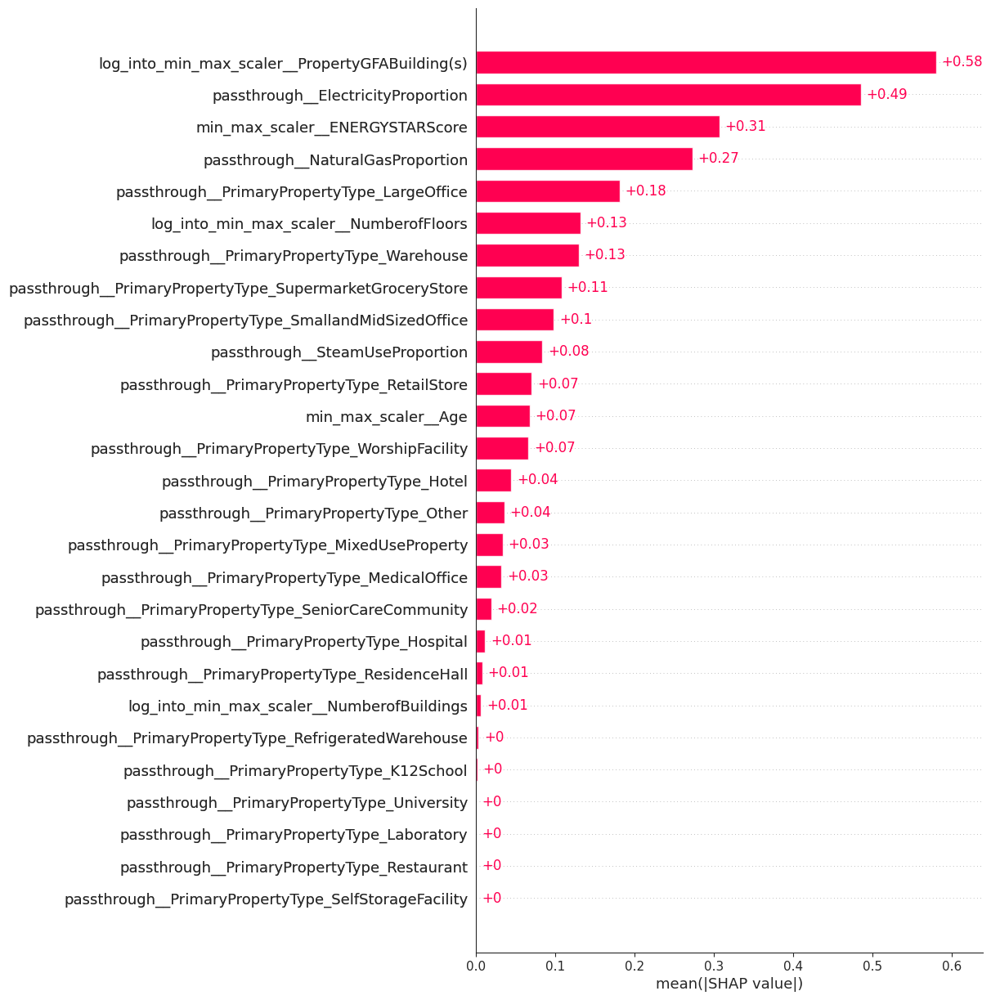

In [253]:
shap.plots.bar(shap_values_expl, max_display=30)

In [259]:
shap.force_plot(shap_values_expl)

### 13.1.2.  [&#9650;](#toc0_) <a id='toc13_1_2_'></a>Local visualization

#### 13.1.2.1.  [&#9650;](#toc0_) <a id='toc13_1_2_1_'></a>Random observation

In [225]:
obs_rank = 100
shap.force_plot(
    explainer.expected_value,
    shap_values[obs_rank,:],
    X_test_pp.iloc[obs_rank,:]
)

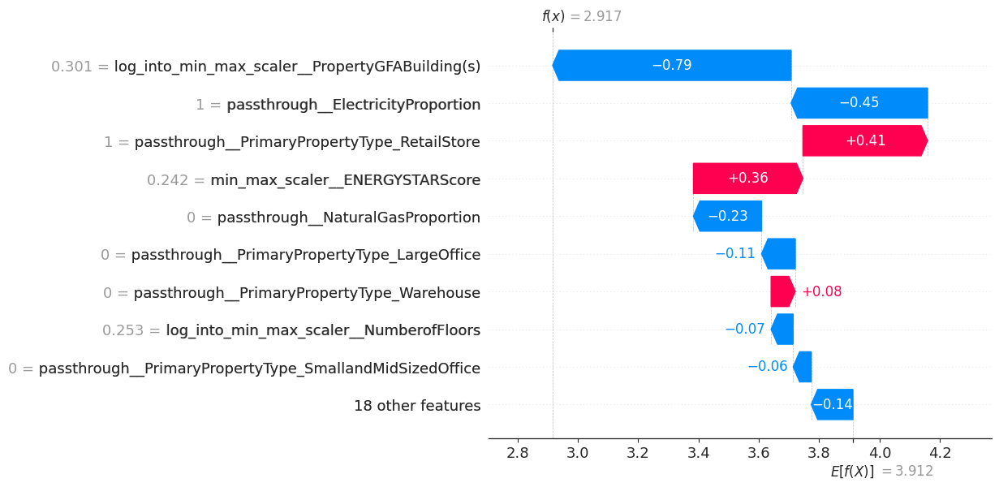

In [219]:
obs_rank = 100
shap.waterfall_plot(
    shap_values_expl[obs_rank,:],
)

In [224]:
# Checking if the value suggested by shapley values lead to the prediction
y_pred_reg[100]

2.9165745169066724

<AxesSubplot: ylabel='Frequency'>

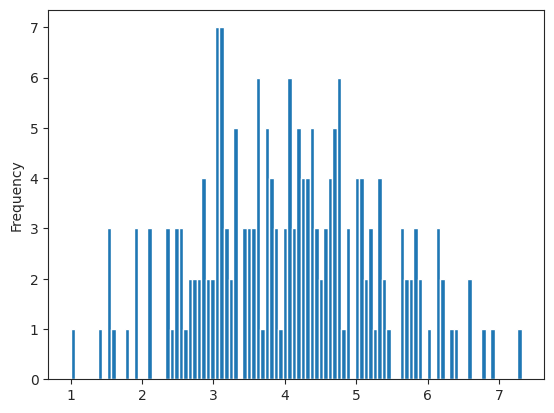

In [220]:
# checking the distribution of the predictions
pd.Series(y_pred_reg).plot(kind='hist', bins=100)

<AxesSubplot: ylabel='Frequency'>

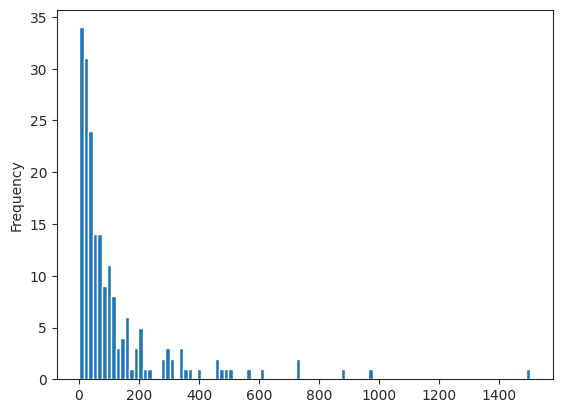

In [223]:
# Distribution in the original space
pd.Series(np.expm1(y_pred_reg)).plot(kind='hist', bins=100)

<AxesSubplot: ylabel='Frequency'>

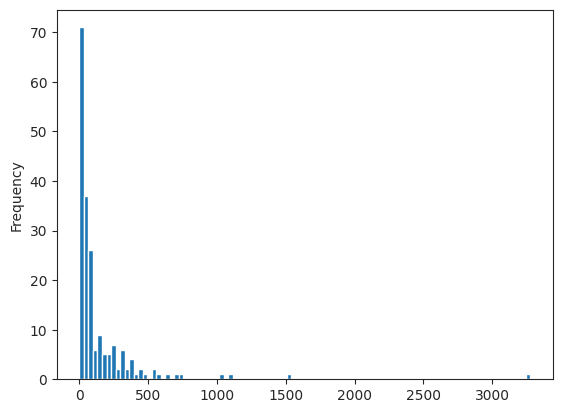

In [221]:
# Similarities with the real values
y_test.plot(kind='hist', bins=100)

#### 13.1.2.2.  [&#9650;](#toc0_) <a id='toc13_1_2_2_'></a>One of the worst prediction

In [233]:
worse_predictions = (
    pd.Series(abs(y_pred-y_test), name='dif')
    .to_frame()
    .query('dif > 100')
)
worse_predictions

,dif
OSEBuildingID,
414,164.928528
24857,344.704836
553,111.218362
437,109.622855
23071,1774.298295
475,266.694884
464,247.002871
49780,264.142660
40028,285.901602


In [247]:
y = y_pred_reg.reset_index()

In [254]:
y.loc[y.OSEBuildingID.isin(worse_predictions.index)].head(10)

,OSEBuildingID,y_pred_reg
7,414,6.001461
11,24857,4.239817
26,553,3.749307
29,437,4.527502
49,23071,7.316423
69,475,5.904558
73,464,5.339877
74,49780,3.311540
79,40028,4.670943
88,21443,4.588802


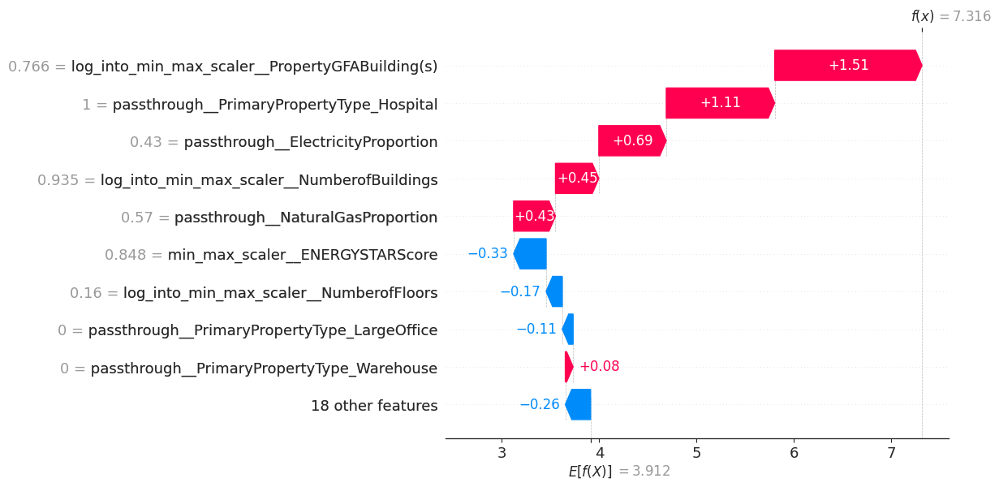

In [255]:
obs_rank = 49
shap.waterfall_plot(
    shap_values_expl[obs_rank,:],
)

In [270]:
np.expm1(y_pred_reg.iloc[49].values[0])

1503.8117048139377

In [271]:
data.loc[23071, pt.GHG_TARGET]

3278.11

In [272]:
np.expm1(8)

2979.9579870417283

If the prediction before inverse transformation was 8, the prediction would have been very good. The model reckon it was a high GHG emitter but under-estimated it.

## 13.2.  [&#9650;](#toc0_) <a id='toc13_2_'></a>XGB model

In [289]:
# Get the full elasticnet model
model = (
    df_results
    .query('input_type =="with_ENERGYSTARScore"')
    .query('regressor == "xgboost_gbtree"')
    .query('metric == "MAE"')
    .model.values[0]
)
model

TransformedTargetRegressor(regressor=Pipeline(steps=[('pre_processor',
                                                      ColumnTransformer(transformers=[('log_into_min_max_scaler',
                                                                                       Pipeline(steps=[('log_transformer',
                                                                                                        FunctionTransformer(feature_names_out='one-to-one',
                                                                                                                            func=<ufunc 'log1p'>,
                                                                                                                            inverse_func=<ufunc 'expm1'>)),
                                                                                                       ('min_max_scaler',
                                                                                                        MinMaxScaler())]),
                                                                                       ['PropertyGFABuilding(s)',
                                                                                        'NumberofBuildings',
                                                                                        'Nu...
                                                                   max_cat_threshold=None,
                                                                   max_cat_to_onehot=None,
                                                                   max_delta_step=None,
                                                                   max_depth=6,
                                                                   max_leaves=None,
                                                                   min_child_weight=1,
                                                                   missing=nan,
                                                                   monotone_constraints=None,
                                                                   n_estimators=67,
                                                                   n_jobs=None,
                                                                   num_parallel_tree=None,
                                                                   predictor=None,
                                                                   random_state=None, ...))]),
                           transformer=FunctionTransformer(feature_names_out='one-to-one',
                                                           func=<ufunc 'log1p'>,
                                                           inverse_func=<ufunc 'expm1'>))

In [290]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [291]:
# Pre-processing separately
X_train_pp = model.regressor_[:-1].transform(X_train)

X_test_pp = pd.DataFrame(
    model.regressor_[:-1].transform(X_test),
    columns=model.regressor_[:-1].get_feature_names_out()
)

In [292]:
reg = model.regressor_[-1]

# Shap explanation and values of the test set
explainer = shap.TreeExplainer(reg, X_train_pp)
shap_values_expl = explainer(X_test_pp)
shap_values = explainer.shap_values(X_test_pp)

# Prediction of the elasticNet without target transformation.
y_pred_reg = pd.DataFrame(
    reg.predict(X_test_pp.values),
    index=y_test.index,
    columns=["y_pred_reg"]
)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


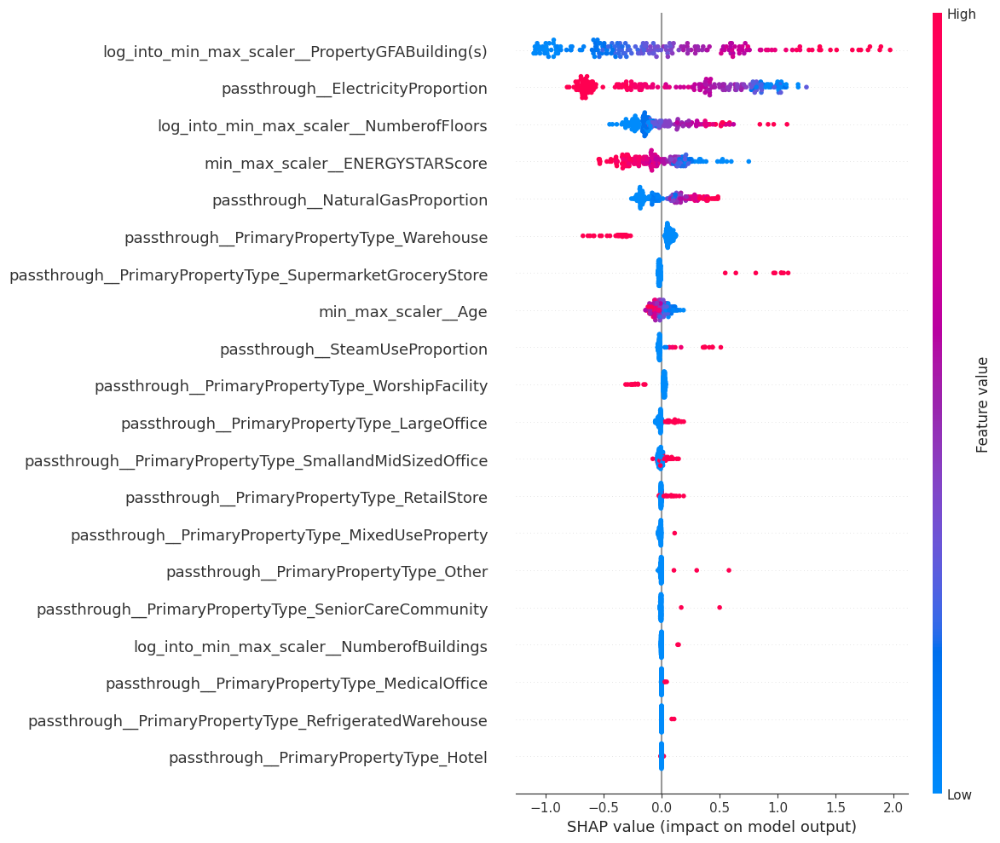

In [296]:
shap.summary_plot(shap_values_expl, plot_size=(12,10))

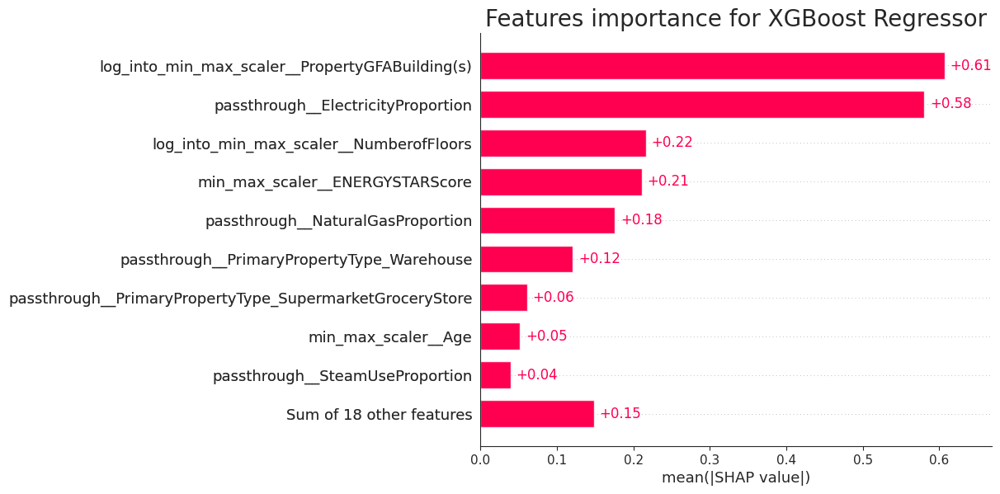

In [304]:
shap.plots.bar(shap_values_expl, show=False)
plt.title('Features importance for XGBoost Regressor', size=20)
plt.show()

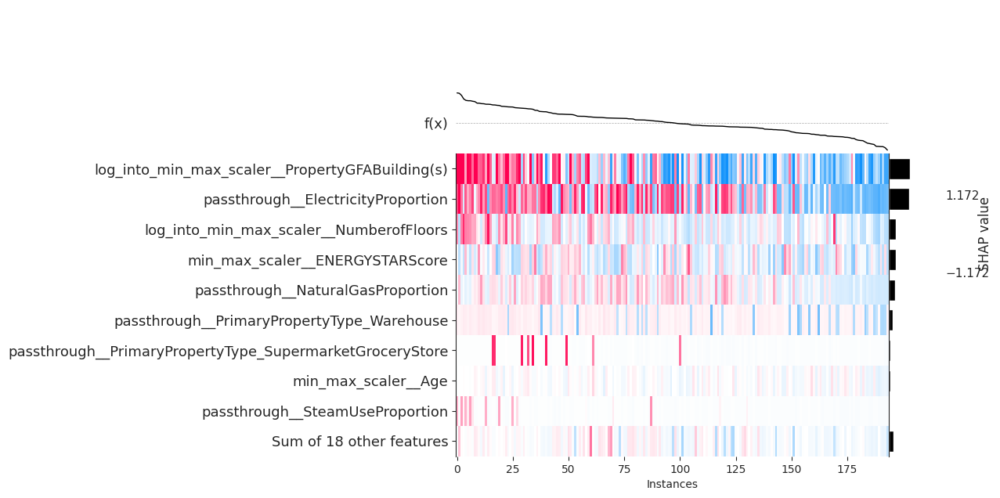

In [307]:
# heatmap ordering the prediction from the highest to the lowest.
shap.plots.heatmap(shap_values_expl, instance_order=shap_values_expl.sum(1))

In [298]:
X_test_pp.columns

Index(['log_into_min_max_scaler__PropertyGFABuilding(s)',
       'log_into_min_max_scaler__NumberofBuildings',
       'log_into_min_max_scaler__NumberofFloors', 'min_max_scaler__Age',
       'min_max_scaler__ENERGYSTARScore',
       'passthrough__PrimaryPropertyType_Hospital',
       'passthrough__PrimaryPropertyType_Hotel',
       'passthrough__PrimaryPropertyType_K12School',
       'passthrough__PrimaryPropertyType_Laboratory',
       'passthrough__PrimaryPropertyType_LargeOffice',
       'passthrough__PrimaryPropertyType_MedicalOffice',
       'passthrough__PrimaryPropertyType_MixedUseProperty',
       'passthrough__PrimaryPropertyType_Other',
       'passthrough__PrimaryPropertyType_RefrigeratedWarehouse',
       'passthrough__PrimaryPropertyType_ResidenceHall',
       'passthrough__PrimaryPropertyType_Restaurant',
       'passthrough__PrimaryPropertyType_RetailStore',
       'passthrough__PrimaryPropertyType_SelfStorageFacility',
       'passthrough__PrimaryPropertyType_SeniorCare

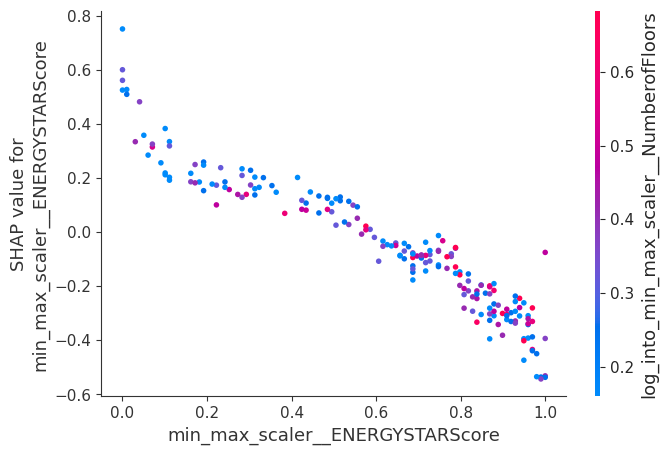

In [299]:
shap.dependence_plot("min_max_scaler__ENERGYSTARScore", shap_values, X_test_pp)

All interpretations from this section might be quite correct, but as we did not use CV, the test set might unluckily be of a great influence on the features importance. So one should interpret from this carefully.

Some way of doing it could be by following this [article](https://lucasramos-34338.medium.com/visualizing-variable-importance-using-shap-and-cross-validation-bd5075e9063a)